In [1]:
import math
import numpy as np
import pandas as pd
from sklearn.preprocessing import MinMaxScaler

import tensorflow as tf
from tensorflow import keras 

from tensorflow.python.keras import backend as K
import seaborn as sns

from tensorflow.python.keras.layers import Input, Dense,LSTM,GRU
from tensorflow.keras.models import Sequential
import matplotlib.pyplot as plt
from skopt import gbrt_minimize, gp_minimize
from skopt.utils import use_named_args
from skopt.space import Real, Categorical, Integer 
plt.style.use('fivethirtyeight')

In [2]:
df = pd.read_excel('oil_date.xlsx')
df.head()

,date,oil
0,2021-06-24,0.19
1,2021-06-25,0.57
2,2021-06-26,1.03
3,2021-06-27,1.38
4,2021-06-28,1.42


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 633 entries, 0 to 632
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   date    633 non-null    datetime64[ns]
 1   oil     633 non-null    float64       
dtypes: datetime64[ns](1), float64(1)
memory usage: 10.0 KB


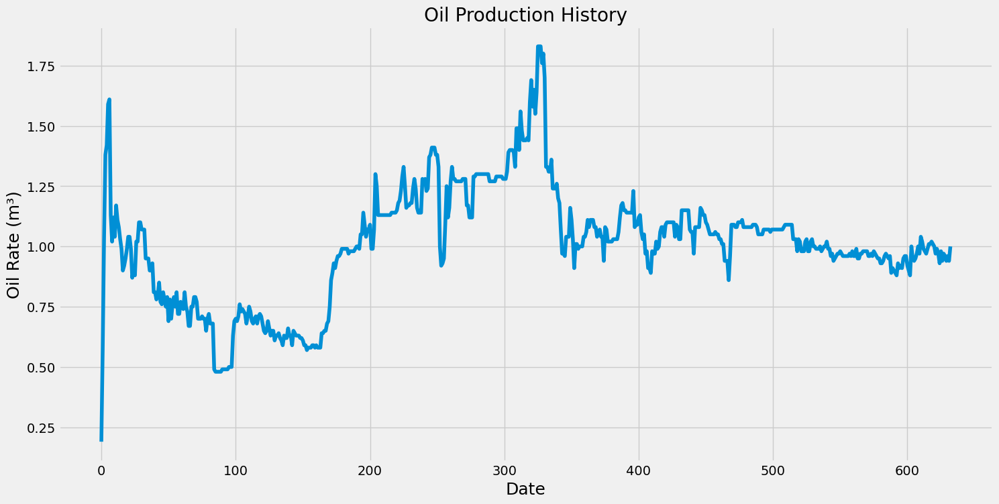

In [4]:
plt.figure(figsize=(16,8))
plt.title('Oil Production History')
plt.plot(df['oil'])
plt.xlabel('Date',fontsize=18)
plt.ylabel('Oil Rate (m³)',fontsize=18)
plt.show()

In [5]:
#Create a new dataframe with only the 'Close' column
data = df.filter(['oil'])
#Converting the dataframe to a numpy array
dataset = data.values
#Get /Compute the number of rows to train the model on
training_data_len = math.ceil( len(dataset) *.8) 

In [6]:
#Scale the all of the data to be values between 0 and 1 
scaler = MinMaxScaler(feature_range=(0, 1)) 
scaled_data = scaler.fit_transform(dataset)

In [7]:
#Create the scaled training data set 
train_data = scaled_data[0:training_data_len  , : ]
#Split the data into x_train and y_train data sets
x_train = []
y_train = []
for i in range(100,len(train_data)):
    x_train.append(train_data[i-100:i,0])
    y_train.append(train_data[i,0])

In [8]:
#Convert x_train and y_train to numpy arrays
x_train, y_train = np.array(x_train), np.array(y_train)

In [9]:
#Reshape the data into the shape accepted by the LSTM
x_train = np.reshape(x_train, (x_train.shape[0],x_train.shape[1],1))

In [10]:
print(x_train.shape)

(407, 100, 1)


In [11]:
'''
dim_learning_rate = Real(low=1e-4, high=1e-3, prior='log-uniform',
                         name='learning_rate')
dim_batch_size = Integer(low=16, high=32, name='batch_size')
dim_adam_decay = Real(low=1e-2,high=1e-1,name="decay")
dimensions = [dim_learning_rate,
              dim_batch_size,
              dim_decay,
             ]
default_parameters = [0.001, 15, 0.08]
'''

'\ndim_learning_rate = Real(low=1e-4, high=1e-3, prior=\'log-uniform\',\n                         name=\'learning_rate\')\ndim_batch_size = Integer(low=16, high=32, name=\'batch_size\')\ndim_adam_decay = Real(low=1e-2,high=1e-1,name="decay")\ndimensions = [dim_learning_rate,\n              dim_batch_size,\n              dim_decay,\n             ]\ndefault_parameters = [0.001, 15, 0.08]\n'

In [12]:
#Build the LSTM network model
#to have two LSTM layers with 50 neurons and two Dense layers, one with 25 neurons and the other with 1 neuron.
def LSTM_model(learning_rate,decay):
    model = Sequential()
    model.add(keras.layers.LSTM(64, input_shape = (x_train.shape[1], 1),kernel_regularizer= 'l2',  return_sequences=True))
    
    model.add(keras.layers.Dense(32,activation='selu'))
    model.add(keras.layers.Dense(1,activation='linear'))
    optimizer = keras.optimizers.Adam(learning_rate = 0.0007,decay = decay)
    model.compile(loss = 'mse', optimizer = optimizer, metrics=['accuracy'])
    model.summary()
    return model

In [13]:
def fitness(x):
    
    decay = x
    
    model = LSTM_model(learning_rate=0.0007,
                       decay = decay
                       )
    

    #named blackbox becuase it represents the structure
    blackbox = model.fit(x=x_train,
                        y=y_train,
                        epochs=50,
                        batch_size=16,
                        validation_split=0.25,
                        )
    #return the validation accuracy for the last epoch.
    accuracy = blackbox.history['val_loss'][-1]

    # Print the classification accuracy.
    print()
    print("loss: {0:.2%}".format(accuracy))
    print()
    
    plt.plot(blackbox.history['loss'], label='train')
    plt.plot(blackbox.history['val_loss'], label='test')
    plt.legend()
    plt.show()
    # Delete the Keras model with these hyper-parameters from memory.
    del model
    
    # Clear the Keras session, otherwise it will keep adding new
    # models to the same TensorFlow graph each time we create
    # a model with a different set of hyper-parameters.
    K.clear_session()
    tf.compat.v1.reset_default_graph()
    
    # the optimizer aims for the lowest score, so we return our negative accuracy
    return accuracy

0.01
Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_1 (LSTM)               (None, 100, 64)           16896     
                                                                 
 dense_2 (Dense)             (None, 100, 32)           2080      
                                                                 
 dense_3 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 166ms/step - loss: 0.1313 - accuracy: 2.5820e-04 - val_loss: 0.0490 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 117ms/step - loss: 0.0906 - accuracy: 0.0011 - val_loss: 0.0374 - val_accuracy: 0.0000e+00
Epoch 3/50
20

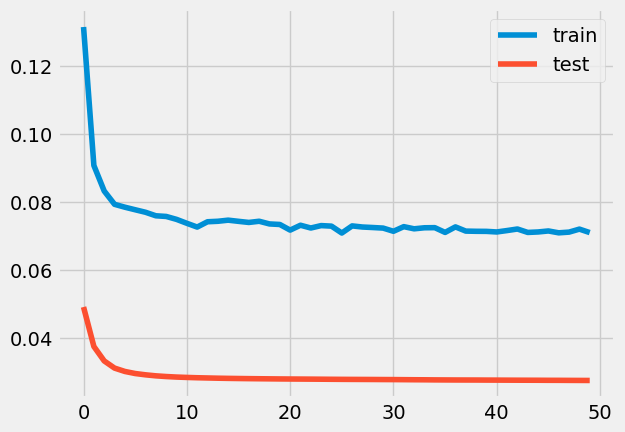

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 10s 225ms/step - loss: 0.1432 - accuracy: 2.8689e-05 - val_loss: 0.0598 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 165ms/step - loss: 0.0997 - accuracy: 3.2172e-04 - val_loss: 0.0451 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

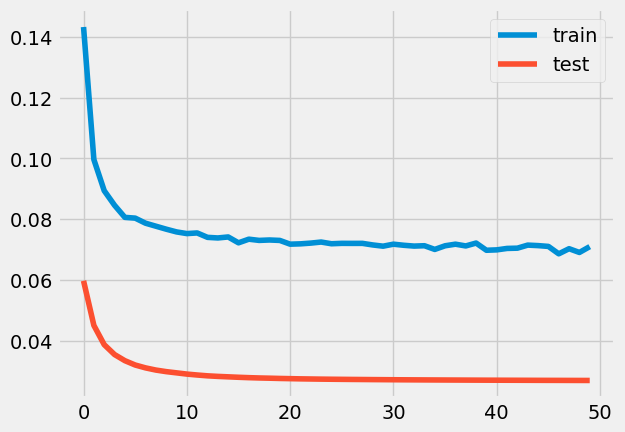

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 9s 212ms/step - loss: 0.1502 - accuracy: 6.5574e-05 - val_loss: 0.0604 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 138ms/step - loss: 0.1016 - accuracy: 7.3566e-04 - val_loss: 0.0455 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20

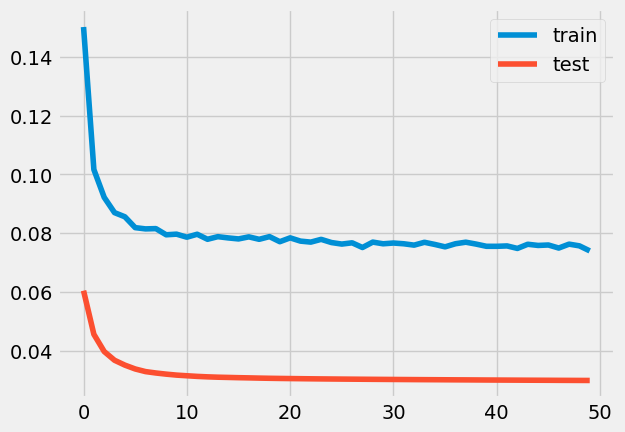

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 9s 194ms/step - loss: 0.2428 - accuracy: 0.0000e+00 - val_loss: 0.1532 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 136ms/step - loss: 0.1802 - accuracy: 0.0000e+00 - val_loss: 0.1262 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20

Epoch 50/50
20/20 [==============================] - 3s 153ms/step - loss: 0.0847 - accuracy: 9.8770e-04 - val_loss: 0.0408 - val_accuracy: 0.0000e+00

loss: 4.08%



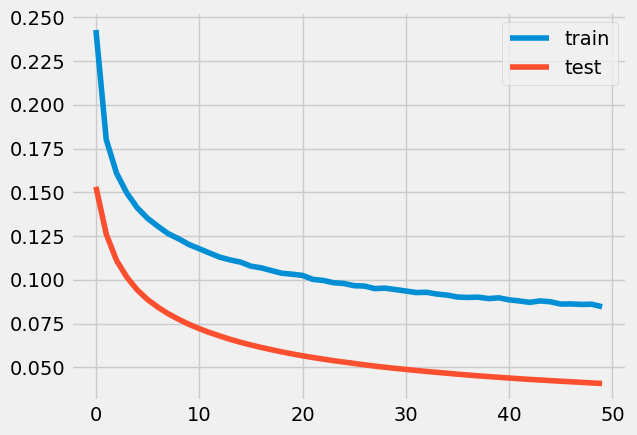

0.33229019969559304
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 10s 214ms/step - loss: 0.1643 - accuracy: 0.0000e+00 - val_loss: 0.0749 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 133ms/step - loss: 0.1115 - accuracy: 1.8033e-04 - val_loss: 0.0554 - val_accuracy: 0.0000

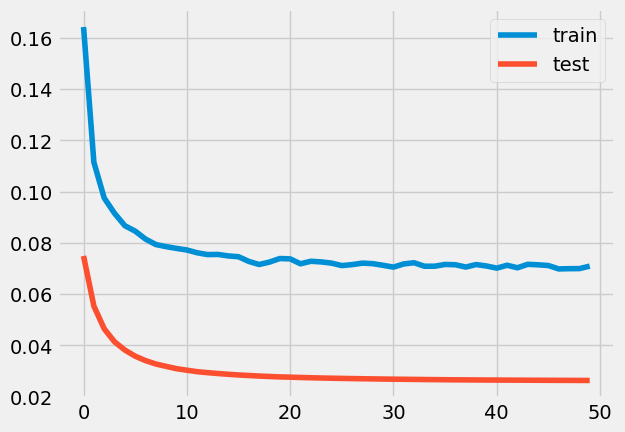

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 9s 191ms/step - loss: 0.2718 - accuracy: 0.0000e+00 - val_loss: 0.1632 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 132ms/step - loss: 0.1847 - accuracy: 0.0000e+00 - val_loss: 0.1265 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20

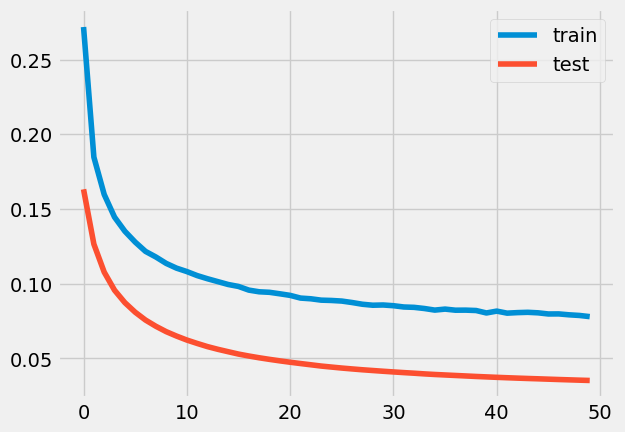

0.4103905779576185
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 52s 158ms/step - loss: 0.2060 - accuracy: 0.0000e+00 - val_loss: 0.1167 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 113ms/step - loss: 0.1498 - accuracy: 0.0000e+00 - val_loss: 0.0934 - val_accuracy: 0.0000e


loss: 3.13%



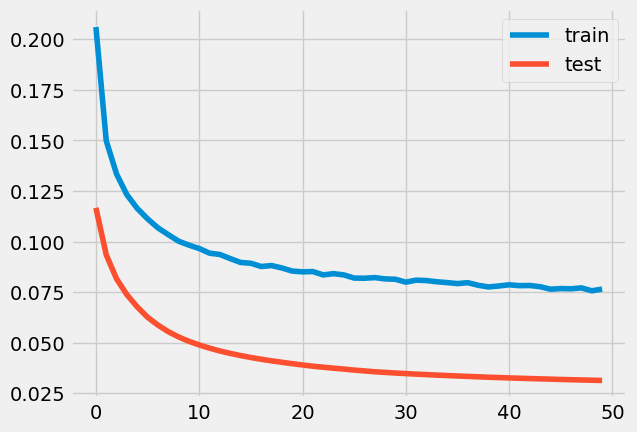

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 180ms/step - loss: 0.1750 - accuracy: 0.0000e+00 - val_loss: 0.0856 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 142ms/step - loss: 0.1206 - accuracy: 0.0000e+00 - val_loss: 0.0648 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20

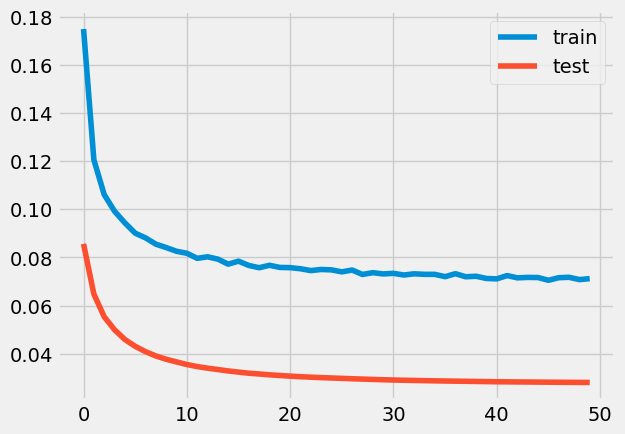

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 155ms/step - loss: 0.2544 - accuracy: 0.0000e+00 - val_loss: 0.1667 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 108ms/step - loss: 0.1935 - accuracy: 0.0000e+00 - val_loss: 0.1391 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20

Epoch 50/50
20/20 [==============================] - 2s 118ms/step - loss: 0.0874 - accuracy: 8.3811e-04 - val_loss: 0.0431 - val_accuracy: 0.0000e+00

loss: 4.31%



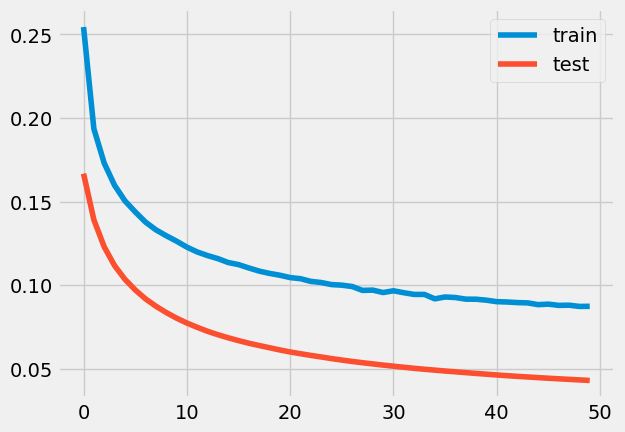

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 182ms/step - loss: 0.1223 - accuracy: 1.0041e-04 - val_loss: 0.0421 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 117ms/step - loss: 0.0843 - accuracy: 0.0015 - val_loss: 0.0332 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [==

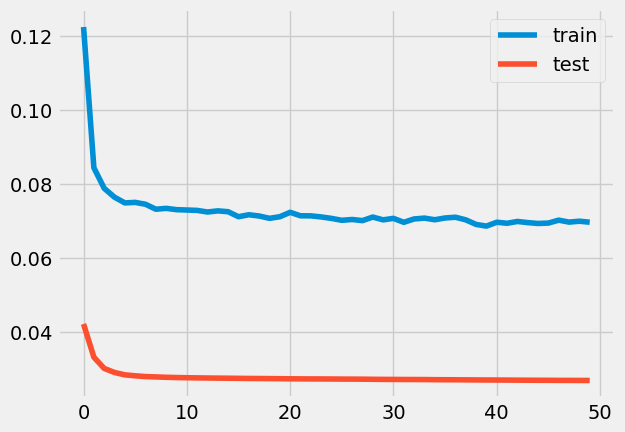

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 9s 243ms/step - loss: 0.1050 - accuracy: 0.0011 - val_loss: 0.0329 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 154ms/step - loss: 0.0783 - accuracy: 0.0034 - val_loss: 0.0285 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [======

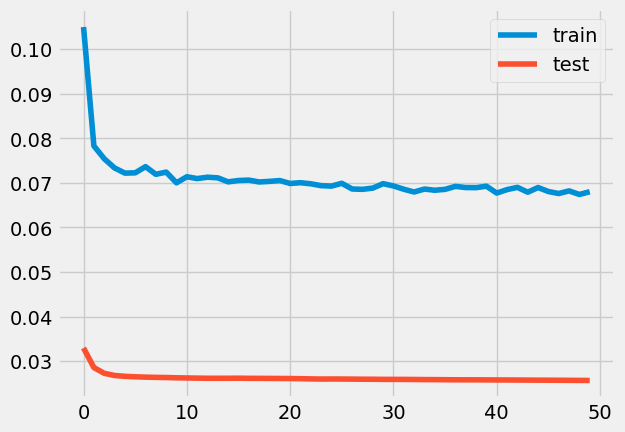

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 138ms/step - loss: 0.1284 - accuracy: 2.3770e-04 - val_loss: 0.0471 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 89ms/step - loss: 0.0897 - accuracy: 9.0779e-04 - val_loss: 0.0357 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 

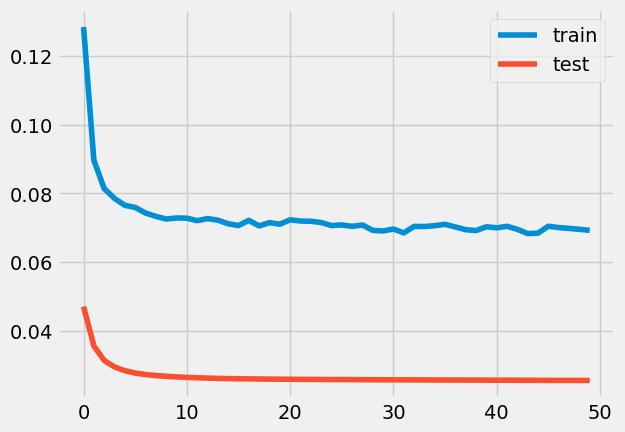

0.99826830979734
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 144ms/step - loss: 0.2694 - accuracy: 0.0000e+00 - val_loss: 0.1819 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 88ms/step - loss: 0.2042 - accuracy: 0.0000e+00 - val_loss: 0.1516 - val_accuracy: 0.0000e+00


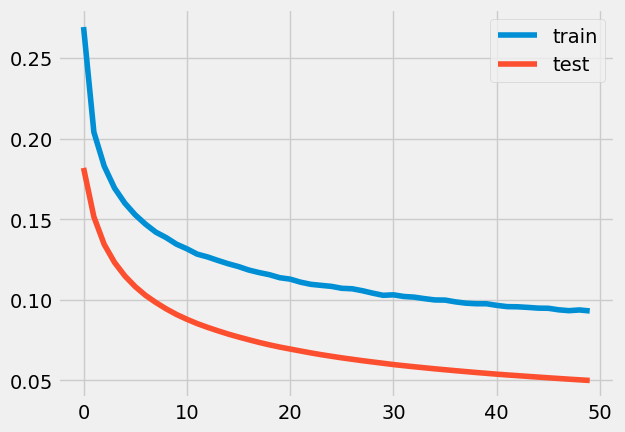

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 138ms/step - loss: 0.2606 - accuracy: 0.0000e+00 - val_loss: 0.1620 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 93ms/step - loss: 0.1856 - accuracy: 0.0000e+00 - val_loss: 0.1306 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 

Epoch 50/50
20/20 [==============================] - 2s 114ms/step - loss: 0.0841 - accuracy: 5.7377e-04 - val_loss: 0.0406 - val_accuracy: 0.0000e+00

loss: 4.06%



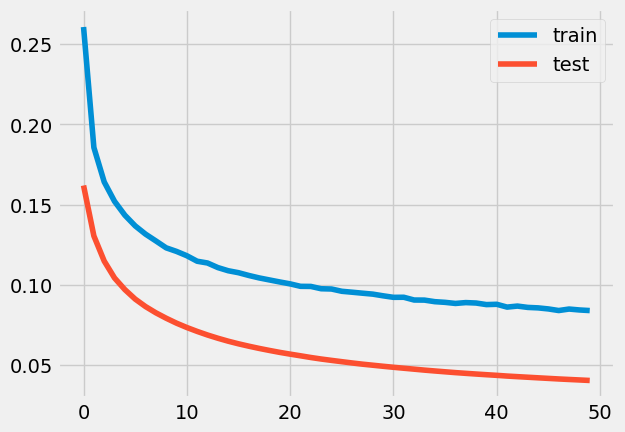

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 175ms/step - loss: 0.1575 - accuracy: 0.0000e+00 - val_loss: 0.0693 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 139ms/step - loss: 0.1068 - accuracy: 1.6189e-04 - val_loss: 0.0522 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20

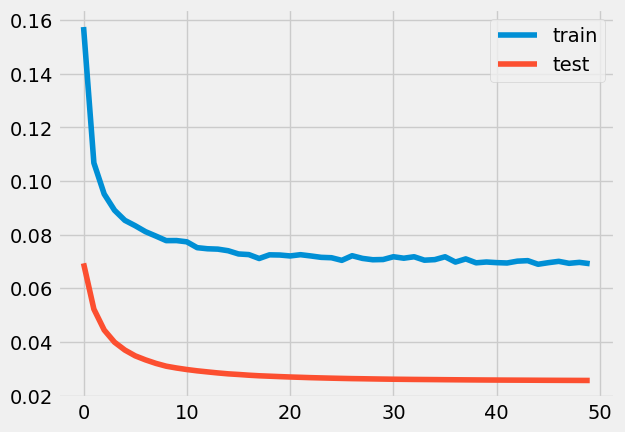

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 157ms/step - loss: 0.4302 - accuracy: 0.0000e+00 - val_loss: 0.3214 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 112ms/step - loss: 0.3248 - accuracy: 0.0000e+00 - val_loss: 0.2759 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20

Epoch 50/50
20/20 [==============================] - 2s 117ms/step - loss: 0.1403 - accuracy: 0.0000e+00 - val_loss: 0.0994 - val_accuracy: 0.0000e+00

loss: 9.94%



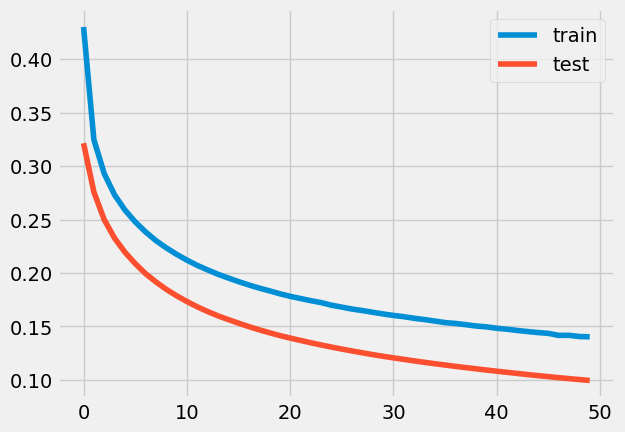

0.0006233411375069837
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 173ms/step - loss: 0.1867 - accuracy: 0.0000e+00 - val_loss: 0.1013 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 107ms/step - loss: 0.1373 - accuracy: 0.0000e+00 - val_loss: 0.0811 - val_accuracy: 0.000


loss: 3.03%



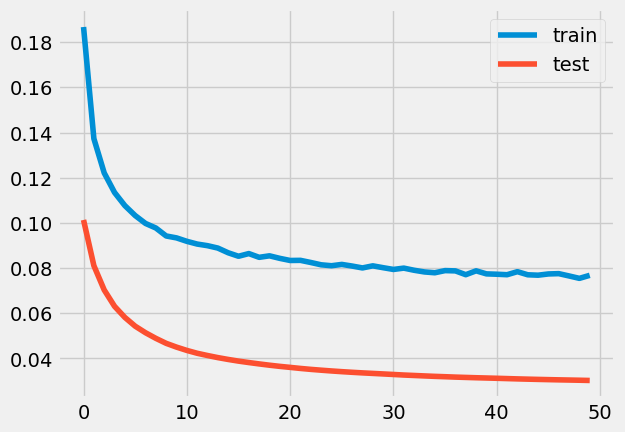

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 168ms/step - loss: 0.2055 - accuracy: 0.0000e+00 - val_loss: 0.1185 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 121ms/step - loss: 0.1491 - accuracy: 0.0000e+00 - val_loss: 0.0925 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20


loss: 3.03%



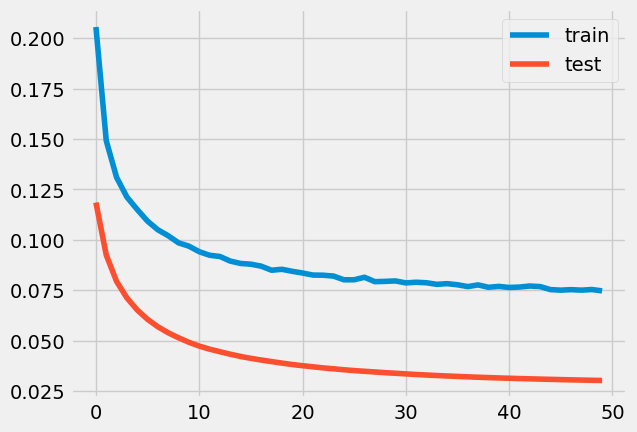

0.9973550090312815
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 150ms/step - loss: 0.1069 - accuracy: 4.7131e-05 - val_loss: 0.0318 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 101ms/step - loss: 0.0777 - accuracy: 0.0044 - val_loss: 0.0273 - val_accuracy: 0.0000e+00
E

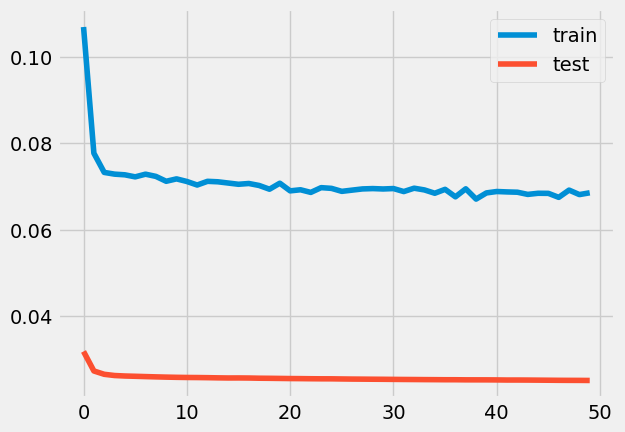

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 177ms/step - loss: 0.2719 - accuracy: 0.0000e+00 - val_loss: 0.1794 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 100ms/step - loss: 0.2045 - accuracy: 0.0000e+00 - val_loss: 0.1500 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20

Epoch 50/50
20/20 [==============================] - 3s 130ms/step - loss: 0.0977 - accuracy: 4.5902e-04 - val_loss: 0.0525 - val_accuracy: 0.0000e+00

loss: 5.25%



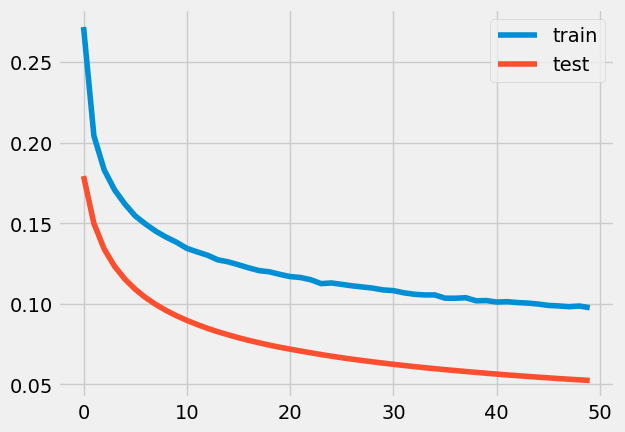

0.06432296605022524
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 190ms/step - loss: 0.1724 - accuracy: 0.0000e+00 - val_loss: 0.0791 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 115ms/step - loss: 0.1142 - accuracy: 0.0000e+00 - val_loss: 0.0580 - val_accuracy: 0.0000e

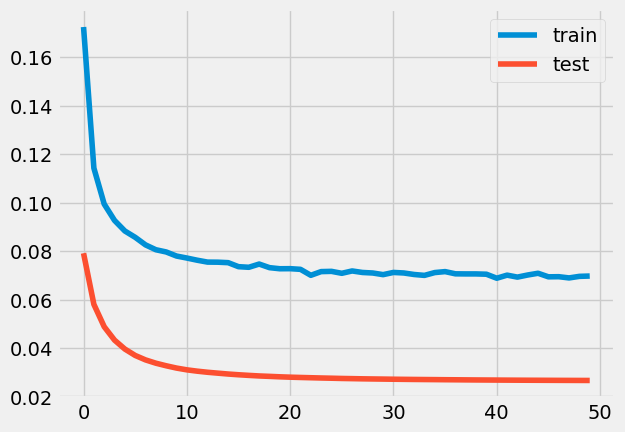

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 141ms/step - loss: 0.1447 - accuracy: 2.4590e-05 - val_loss: 0.0623 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 97ms/step - loss: 0.1032 - accuracy: 1.3320e-04 - val_loss: 0.0481 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 

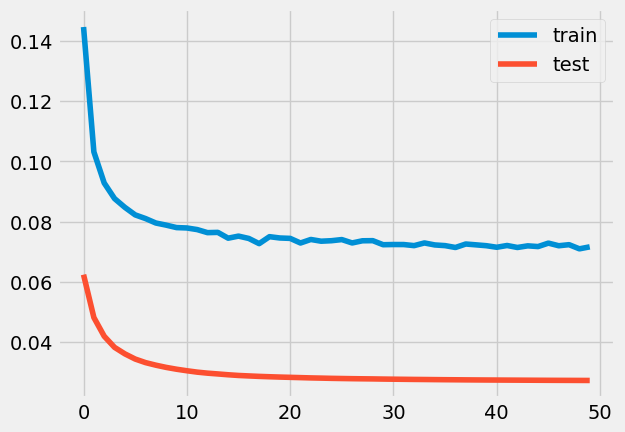

0.9456697752945435
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 9s 222ms/step - loss: 0.2267 - accuracy: 0.0000e+00 - val_loss: 0.1052 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 140ms/step - loss: 0.1310 - accuracy: 0.0000e+00 - val_loss: 0.0721 - val_accuracy: 0.0000e+

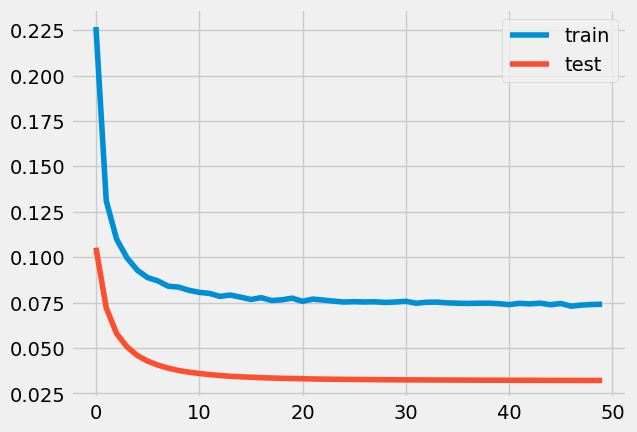

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 186ms/step - loss: 0.1879 - accuracy: 0.0000e+00 - val_loss: 0.1010 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 117ms/step - loss: 0.1356 - accuracy: 0.0000e+00 - val_loss: 0.0791 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20


loss: 3.04%



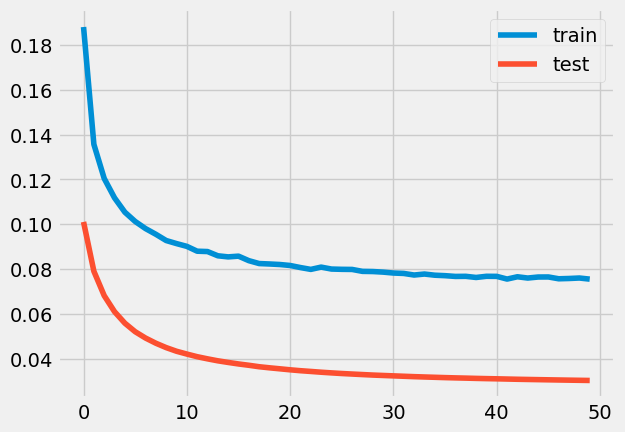

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 9s 194ms/step - loss: 0.3582 - accuracy: 0.0000e+00 - val_loss: 0.2441 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 113ms/step - loss: 0.2549 - accuracy: 0.0000e+00 - val_loss: 0.1979 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20

Epoch 50/50
20/20 [==============================] - 2s 100ms/step - loss: 0.0987 - accuracy: 3.3607e-04 - val_loss: 0.0546 - val_accuracy: 0.0000e+00

loss: 5.46%



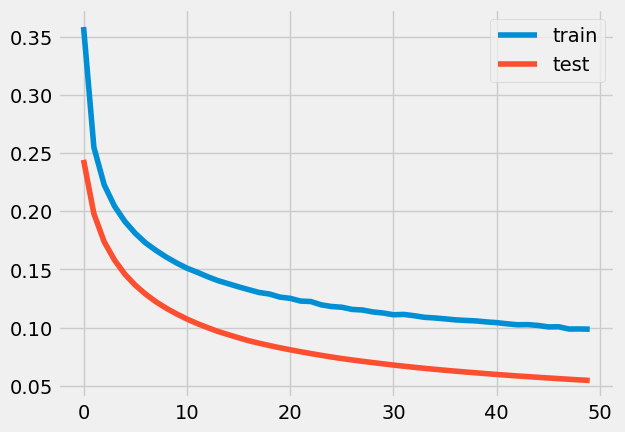

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 196ms/step - loss: 0.1248 - accuracy: 0.0000e+00 - val_loss: 0.0400 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 117ms/step - loss: 0.0834 - accuracy: 0.0050 - val_loss: 0.0313 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [==

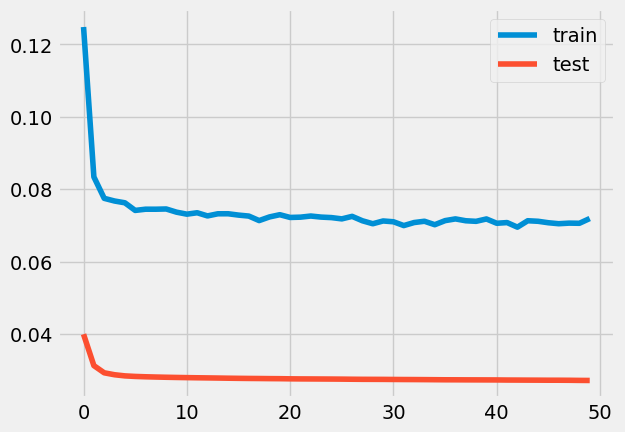

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 168ms/step - loss: 0.1389 - accuracy: 3.6885e-05 - val_loss: 0.0549 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 115ms/step - loss: 0.0937 - accuracy: 8.9754e-04 - val_loss: 0.0398 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20

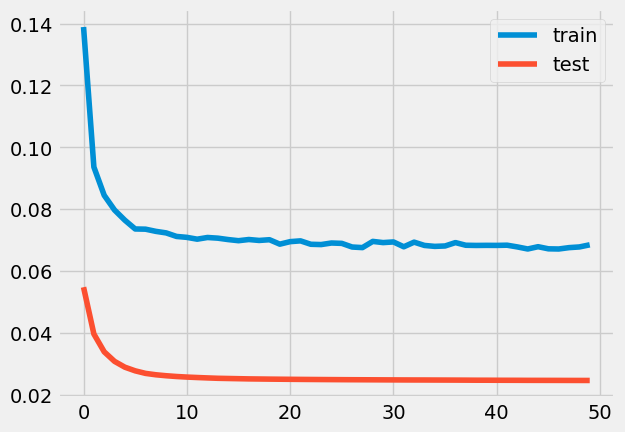

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 164ms/step - loss: 0.1797 - accuracy: 0.0000e+00 - val_loss: 0.0907 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 122ms/step - loss: 0.1267 - accuracy: 0.0000e+00 - val_loss: 0.0702 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20

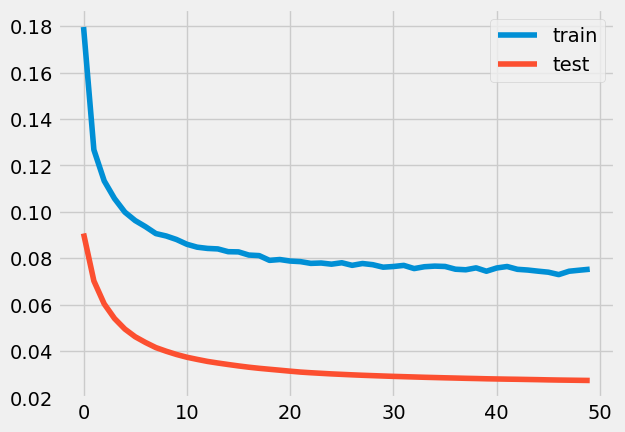

0.7743249069941197
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 12s 270ms/step - loss: 0.2452 - accuracy: 0.0000e+00 - val_loss: 0.1457 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 153ms/step - loss: 0.1713 - accuracy: 0.0000e+00 - val_loss: 0.1146 - val_accuracy: 0.0000e

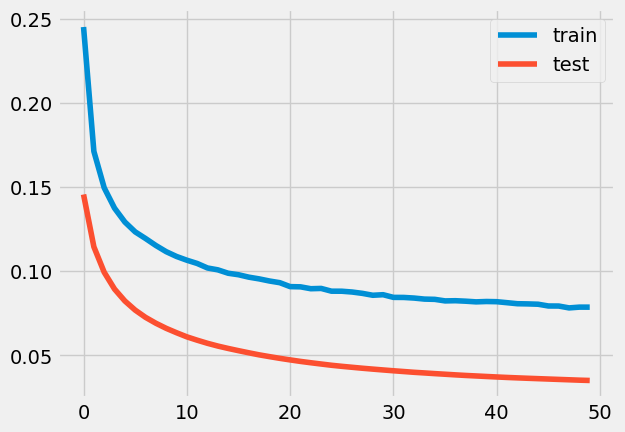

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 10s 249ms/step - loss: 0.1367 - accuracy: 2.3770e-04 - val_loss: 0.0531 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 187ms/step - loss: 0.0953 - accuracy: 0.0015 - val_loss: 0.0399 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=

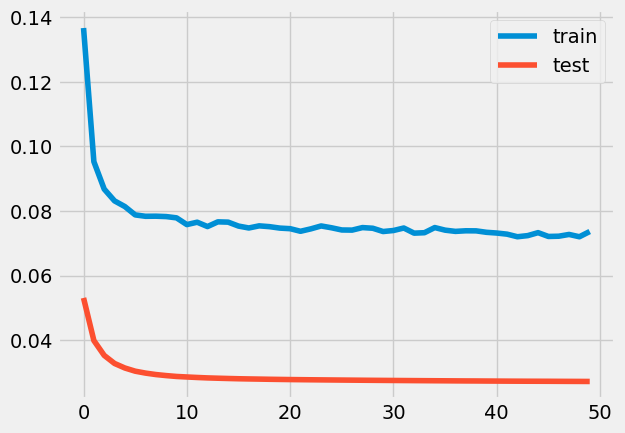

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 11s 247ms/step - loss: 0.2084 - accuracy: 0.0000e+00 - val_loss: 0.1139 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 173ms/step - loss: 0.1461 - accuracy: 0.0000e+00 - val_loss: 0.0886 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2


loss: 3.24%



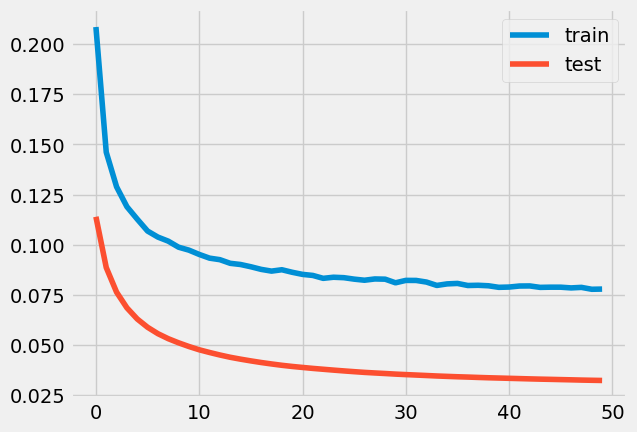

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 11s 259ms/step - loss: 0.1146 - accuracy: 0.0011 - val_loss: 0.0359 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 165ms/step - loss: 0.0808 - accuracy: 0.0035 - val_loss: 0.0296 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=====

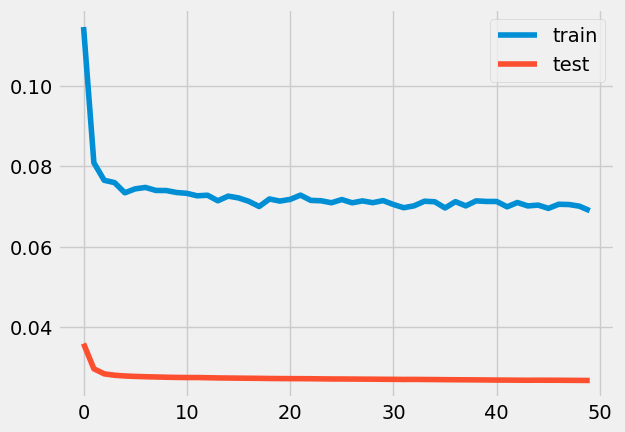

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 11s 254ms/step - loss: 0.2805 - accuracy: 0.0000e+00 - val_loss: 0.1812 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 157ms/step - loss: 0.2026 - accuracy: 0.0000e+00 - val_loss: 0.1477 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

Epoch 50/50
20/20 [==============================] - 3s 156ms/step - loss: 0.0889 - accuracy: 7.9713e-04 - val_loss: 0.0450 - val_accuracy: 0.0000e+00

loss: 4.50%



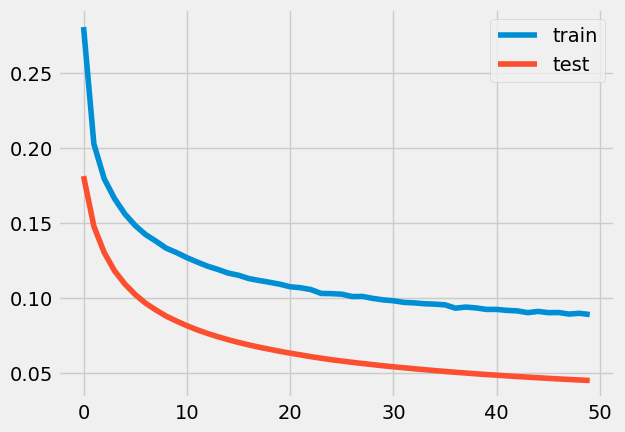

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 10s 226ms/step - loss: 0.0837 - accuracy: 0.0057 - val_loss: 0.0286 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 142ms/step - loss: 0.0766 - accuracy: 0.0060 - val_loss: 0.0280 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=====

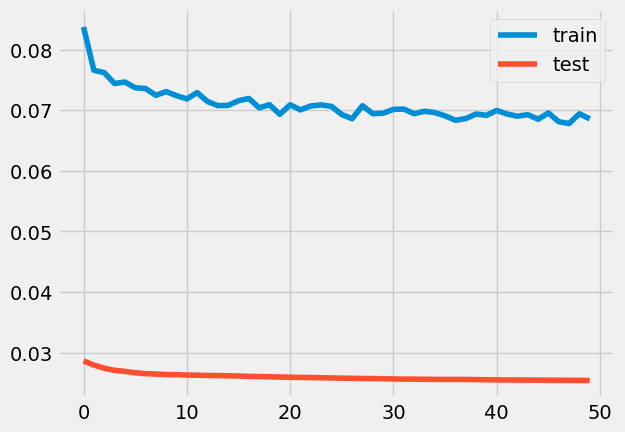

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 10s 227ms/step - loss: 0.1505 - accuracy: 0.0000e+00 - val_loss: 0.0637 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 147ms/step - loss: 0.1028 - accuracy: 2.3361e-04 - val_loss: 0.0476 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

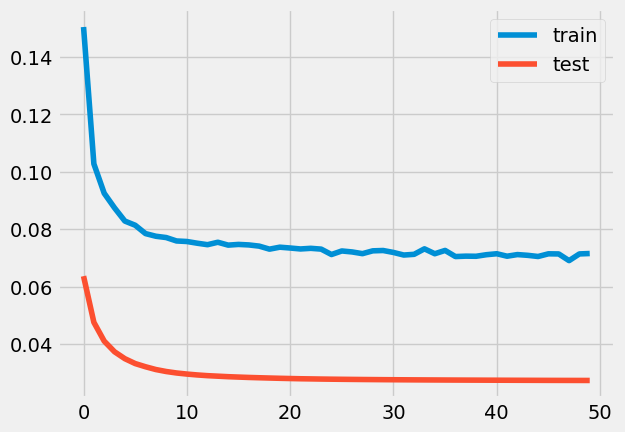

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 11s 238ms/step - loss: 0.3567 - accuracy: 0.0000e+00 - val_loss: 0.2564 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 153ms/step - loss: 0.2711 - accuracy: 0.0000e+00 - val_loss: 0.2198 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

Epoch 50/50
20/20 [==============================] - 3s 158ms/step - loss: 0.1331 - accuracy: 0.0000e+00 - val_loss: 0.0904 - val_accuracy: 0.0000e+00

loss: 9.04%



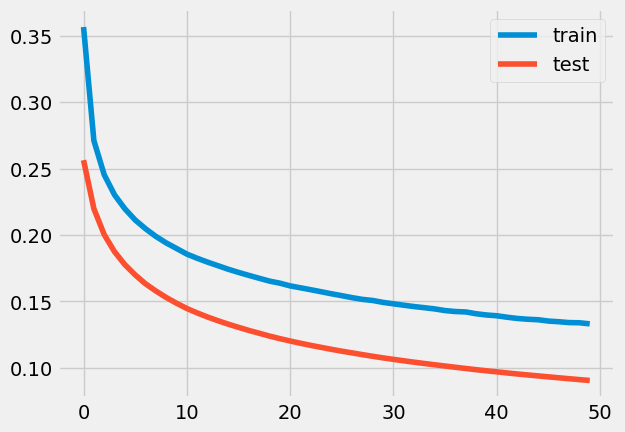

0.0018077646409078484
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 13s 235ms/step - loss: 0.3014 - accuracy: 0.0000e+00 - val_loss: 0.2036 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 163ms/step - loss: 0.2234 - accuracy: 0.0000e+00 - val_loss: 0.1698 - val_accuracy: 0.00

Epoch 50/50
20/20 [==============================] - 3s 159ms/step - loss: 0.1030 - accuracy: 1.3115e-04 - val_loss: 0.0594 - val_accuracy: 0.0000e+00

loss: 5.94%



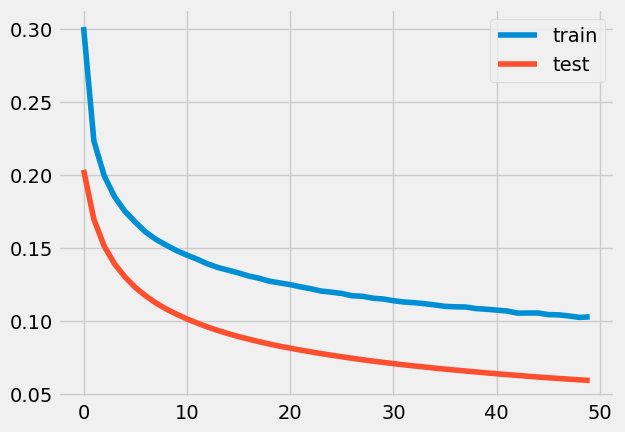

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 10s 241ms/step - loss: 0.2773 - accuracy: 0.0000e+00 - val_loss: 0.1679 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 165ms/step - loss: 0.1900 - accuracy: 0.0000e+00 - val_loss: 0.1347 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

20/20 [==============================] - 3s 138ms/step - loss: 0.0827 - accuracy: 9.2418e-04 - val_loss: 0.0391 - val_accuracy: 0.0000e+00

loss: 3.91%



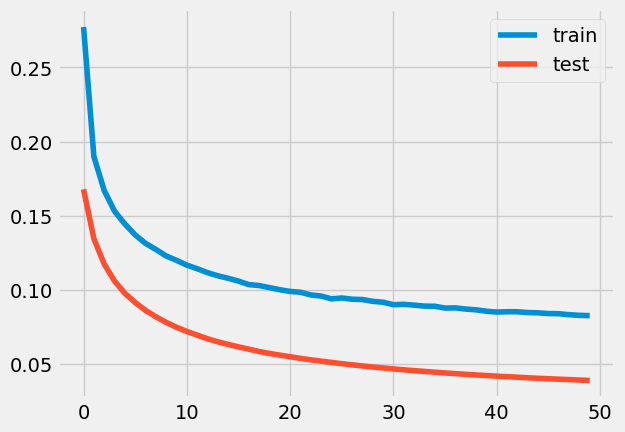

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 165ms/step - loss: 0.1767 - accuracy: 0.0000e+00 - val_loss: 0.0754 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 117ms/step - loss: 0.1096 - accuracy: 3.0738e-05 - val_loss: 0.0537 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20

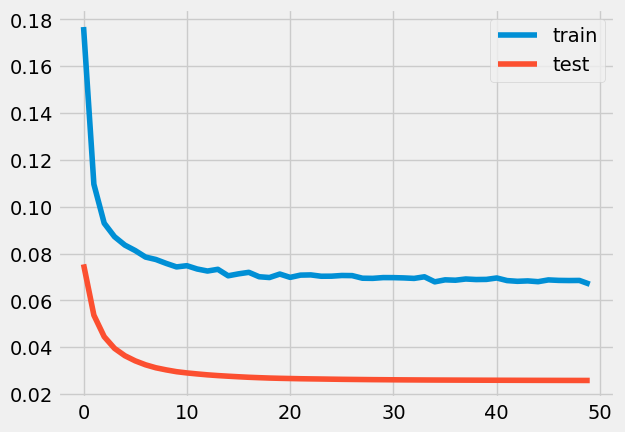

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 147ms/step - loss: 0.1789 - accuracy: 0.0000e+00 - val_loss: 0.0955 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 103ms/step - loss: 0.1316 - accuracy: 0.0000e+00 - val_loss: 0.0745 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20


loss: 2.88%



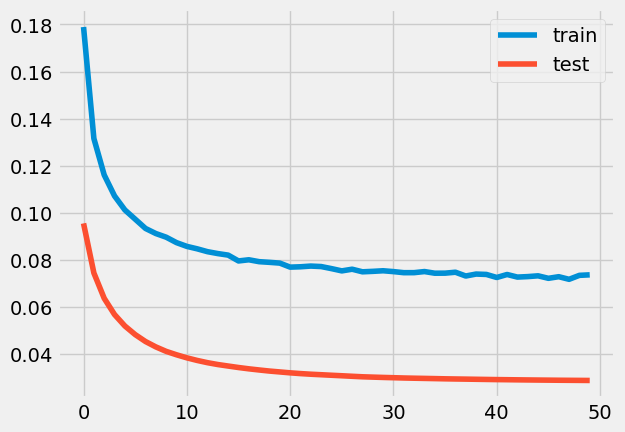

0.7404018530776044
0.005
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 158ms/step - loss: 0.2017 - accuracy: 0.0000e+00 - val_loss: 0.1125 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 108ms/step - loss: 0.1472 - accuracy: 0.0000e+00 - val_loss: 0.0910 - val_accuracy: 0.

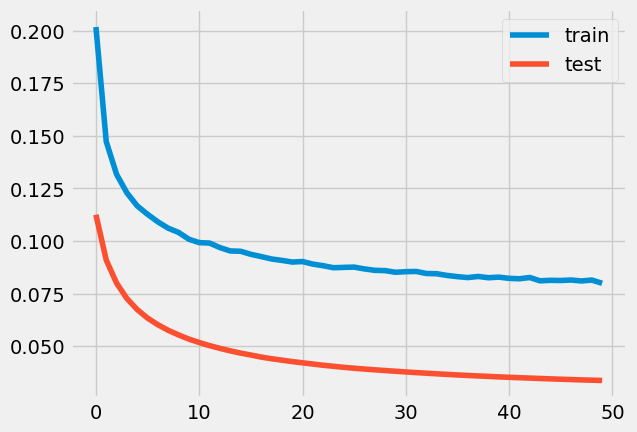

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 146ms/step - loss: 0.2021 - accuracy: 0.0000e+00 - val_loss: 0.1100 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 102ms/step - loss: 0.1420 - accuracy: 0.0000e+00 - val_loss: 0.0861 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20


loss: 3.00%



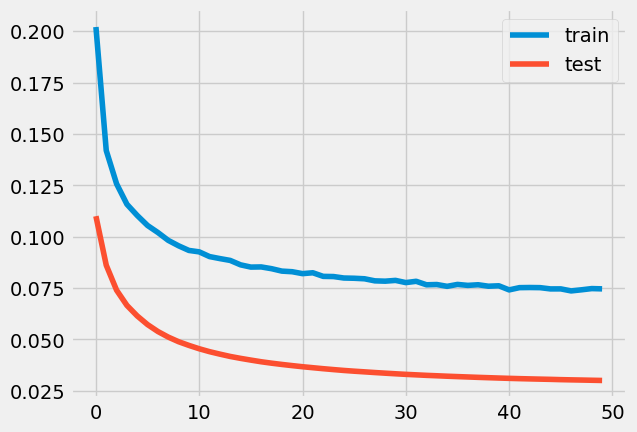

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 149ms/step - loss: 0.1709 - accuracy: 0.0000e+00 - val_loss: 0.0791 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 106ms/step - loss: 0.1157 - accuracy: 0.0000e+00 - val_loss: 0.0600 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20

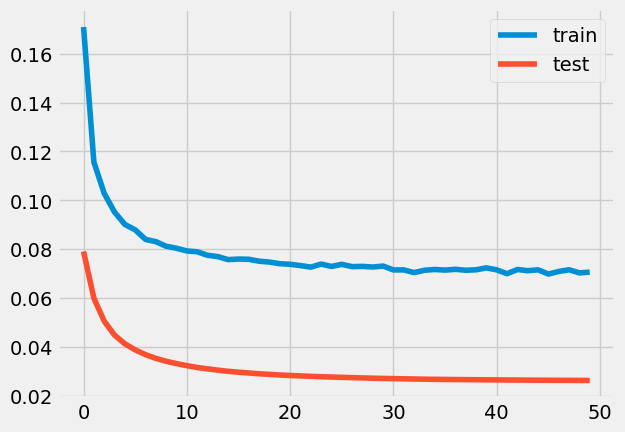

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 153ms/step - loss: 0.1358 - accuracy: 1.2295e-05 - val_loss: 0.0485 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 108ms/step - loss: 0.0902 - accuracy: 0.0013 - val_loss: 0.0366 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [==

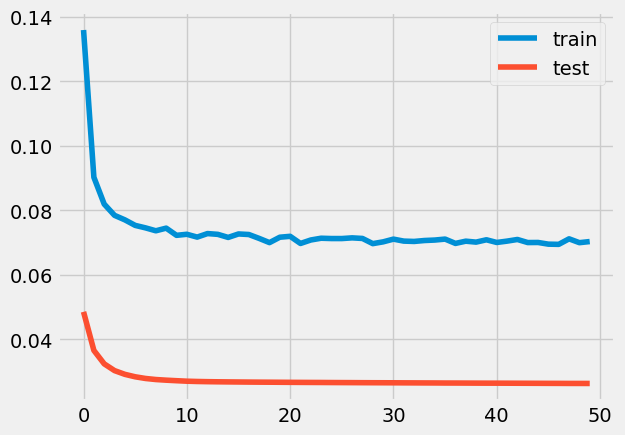

0.9929746818485646
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 158ms/step - loss: 0.1774 - accuracy: 0.0000e+00 - val_loss: 0.0772 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 117ms/step - loss: 0.1114 - accuracy: 1.4549e-04 - val_loss: 0.0558 - val_accuracy: 0.0000e+


loss: 2.65%



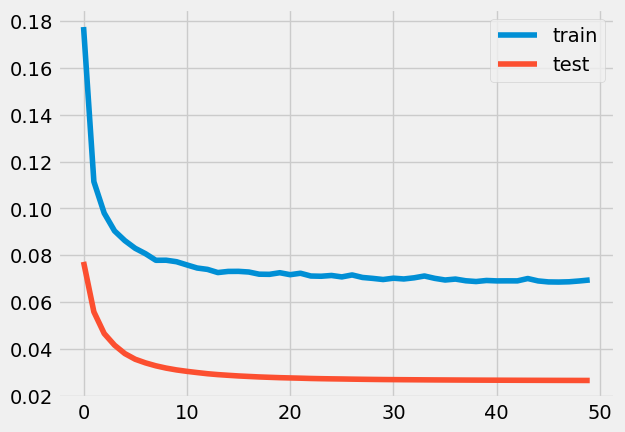

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 158ms/step - loss: 0.1777 - accuracy: 0.0000e+00 - val_loss: 0.0863 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 128ms/step - loss: 0.1221 - accuracy: 0.0000e+00 - val_loss: 0.0650 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20

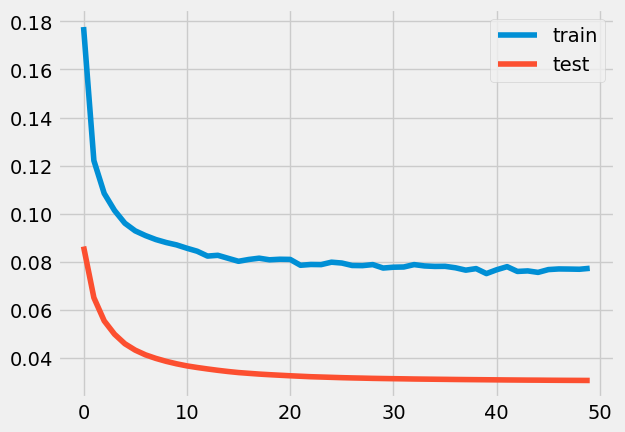

0.45280385846115406
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 160ms/step - loss: 0.3733 - accuracy: 0.0000e+00 - val_loss: 0.2782 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 116ms/step - loss: 0.2884 - accuracy: 0.0000e+00 - val_loss: 0.2381 - val_accuracy: 0.0000e

Epoch 50/50
20/20 [==============================] - 2s 113ms/step - loss: 0.1320 - accuracy: 0.0000e+00 - val_loss: 0.0908 - val_accuracy: 0.0000e+00

loss: 9.08%



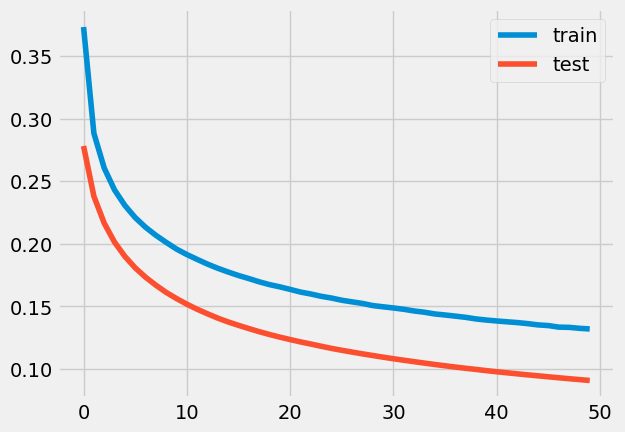

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 155ms/step - loss: 0.1699 - accuracy: 0.0000e+00 - val_loss: 0.0788 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 109ms/step - loss: 0.1136 - accuracy: 6.3525e-05 - val_loss: 0.0577 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20

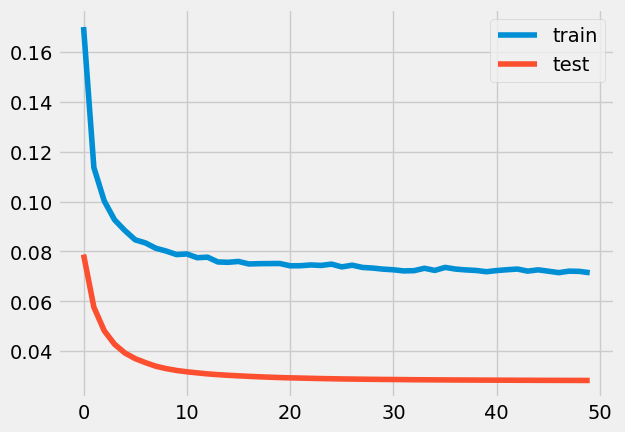

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 155ms/step - loss: 0.2551 - accuracy: 0.0000e+00 - val_loss: 0.1514 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 110ms/step - loss: 0.1757 - accuracy: 0.0000e+00 - val_loss: 0.1206 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20

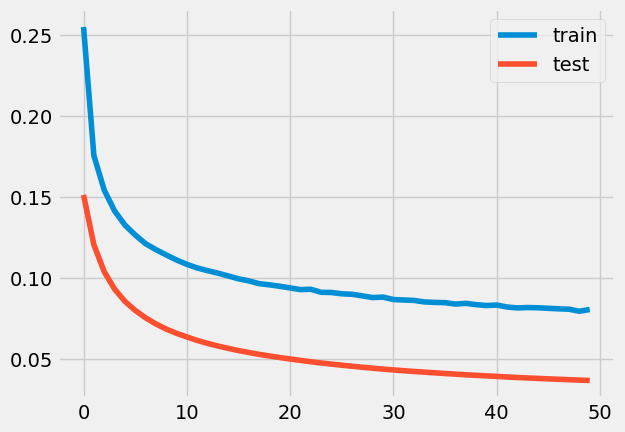

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 158ms/step - loss: 0.2901 - accuracy: 0.0000e+00 - val_loss: 0.1804 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 107ms/step - loss: 0.1982 - accuracy: 0.0000e+00 - val_loss: 0.1415 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20

20/20 [==============================] - 2s 112ms/step - loss: 0.0839 - accuracy: 0.0010 - val_loss: 0.0414 - val_accuracy: 0.0000e+00

loss: 4.14%



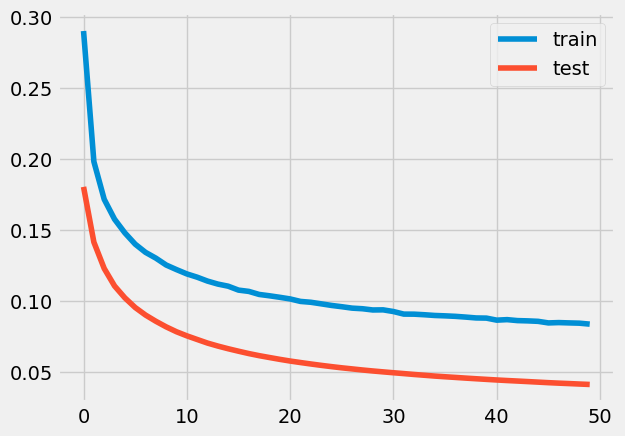

0.40442086965276586
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 152ms/step - loss: 0.3501 - accuracy: 0.0000e+00 - val_loss: 0.2441 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 104ms/step - loss: 0.2560 - accuracy: 0.0000e+00 - val_loss: 0.2025 - val_accuracy: 0.0000e

Epoch 50/50
20/20 [==============================] - 2s 115ms/step - loss: 0.1082 - accuracy: 0.0000e+00 - val_loss: 0.0662 - val_accuracy: 0.0000e+00

loss: 6.62%



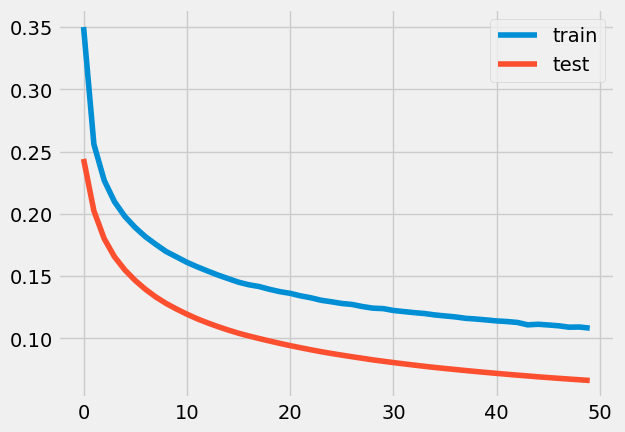

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 162ms/step - loss: 0.2417 - accuracy: 0.0000e+00 - val_loss: 0.1510 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 112ms/step - loss: 0.1779 - accuracy: 0.0000e+00 - val_loss: 0.1221 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20

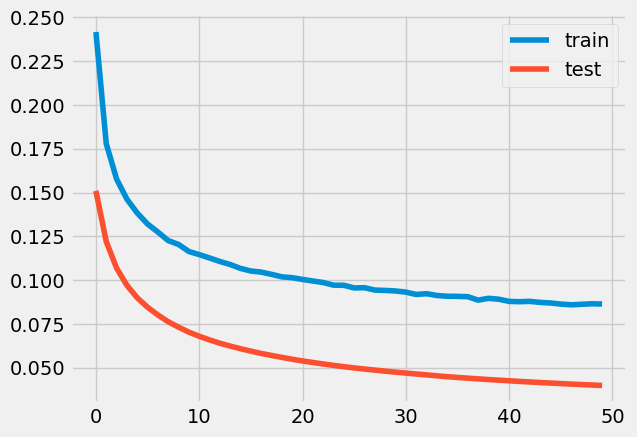

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 158ms/step - loss: 0.2043 - accuracy: 0.0000e+00 - val_loss: 0.1032 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 109ms/step - loss: 0.1343 - accuracy: 0.0000e+00 - val_loss: 0.0767 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20


loss: 2.97%



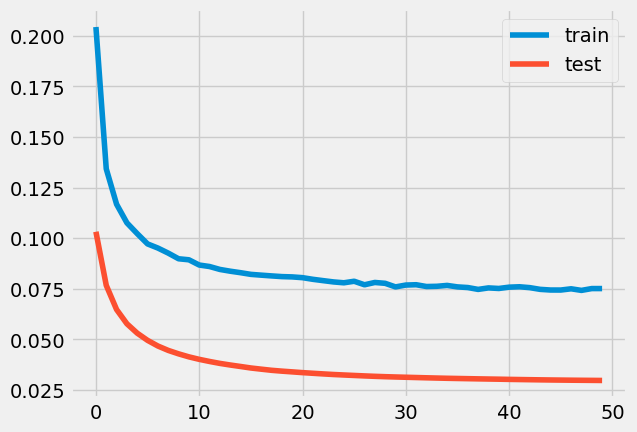

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 157ms/step - loss: 0.2117 - accuracy: 0.0000e+00 - val_loss: 0.1111 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 114ms/step - loss: 0.1420 - accuracy: 0.0000e+00 - val_loss: 0.0839 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20


loss: 3.00%



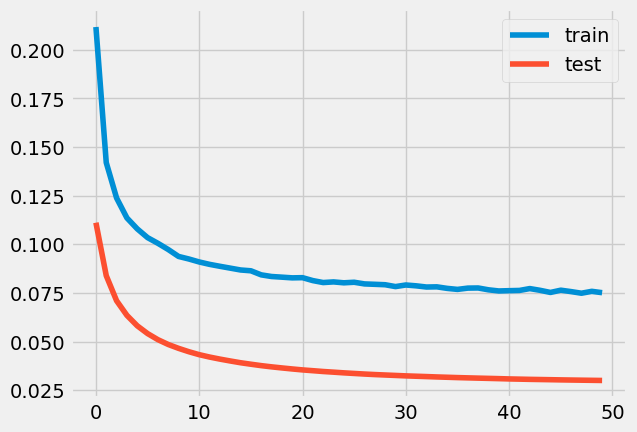

0.946080634011838
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 151ms/step - loss: 0.1344 - accuracy: 8.4016e-05 - val_loss: 0.0467 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 107ms/step - loss: 0.0887 - accuracy: 0.0018 - val_loss: 0.0349 - val_accuracy: 0.0000e+00
Ep

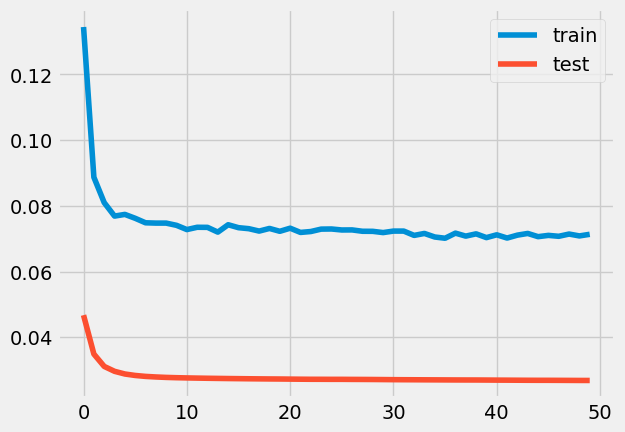

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 149ms/step - loss: 0.1423 - accuracy: 1.2090e-04 - val_loss: 0.0646 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 100ms/step - loss: 0.1064 - accuracy: 1.6598e-04 - val_loss: 0.0507 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20

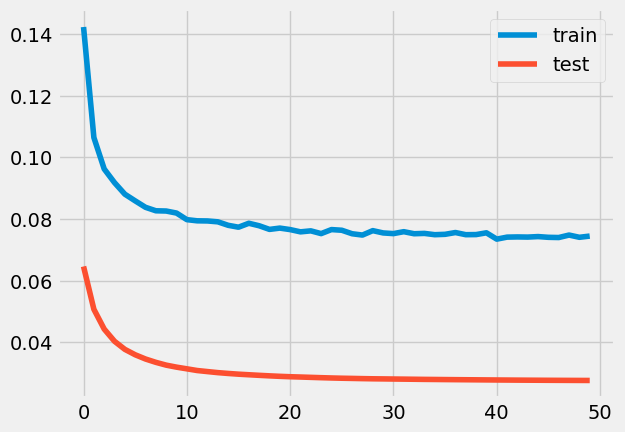

0.8657448803500726
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 158ms/step - loss: 0.2317 - accuracy: 0.0000e+00 - val_loss: 0.1447 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 107ms/step - loss: 0.1733 - accuracy: 0.0000e+00 - val_loss: 0.1176 - val_accuracy: 0.0000e+

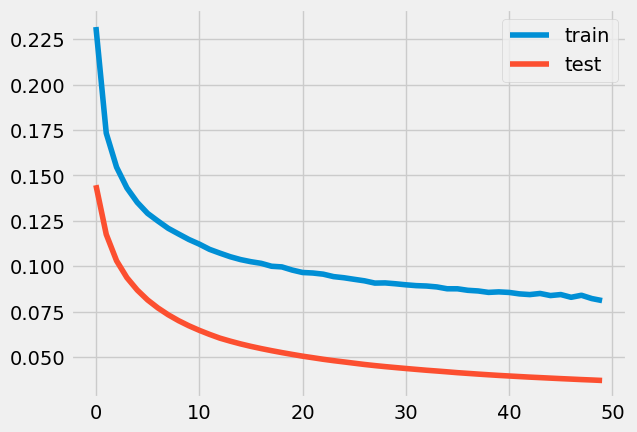

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 159ms/step - loss: 0.2714 - accuracy: 0.0000e+00 - val_loss: 0.1649 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 113ms/step - loss: 0.1850 - accuracy: 0.0000e+00 - val_loss: 0.1296 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20

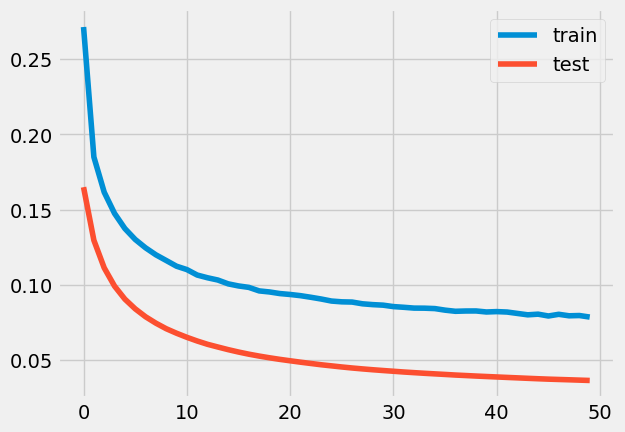

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 164ms/step - loss: 0.1783 - accuracy: 0.0000e+00 - val_loss: 0.0801 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 119ms/step - loss: 0.1154 - accuracy: 1.5779e-04 - val_loss: 0.0583 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20

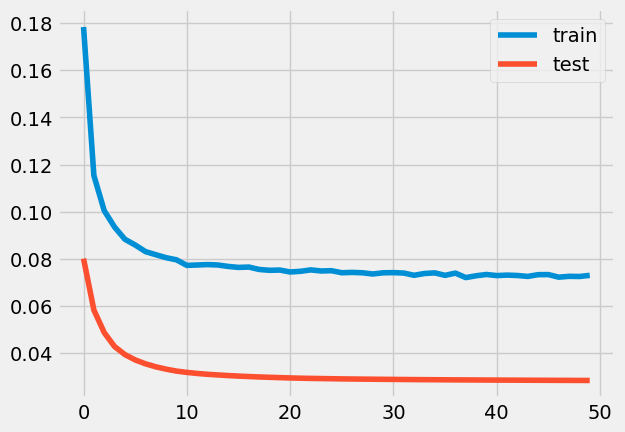

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 160ms/step - loss: 0.2049 - accuracy: 0.0000e+00 - val_loss: 0.1167 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 112ms/step - loss: 0.1481 - accuracy: 0.0000e+00 - val_loss: 0.0916 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20


loss: 3.01%



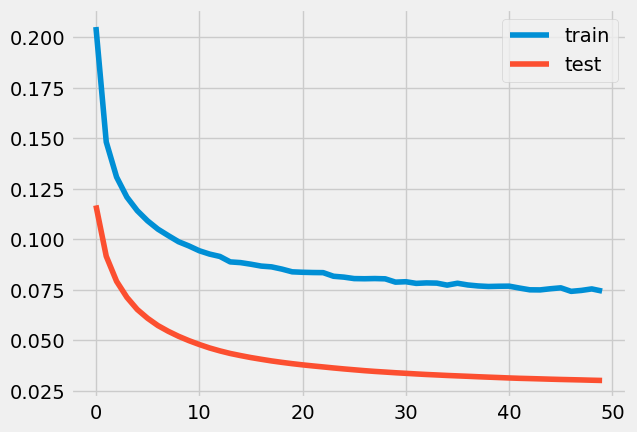

0.7194890569888672
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 169ms/step - loss: 0.1715 - accuracy: 0.0000e+00 - val_loss: 0.0758 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 112ms/step - loss: 0.1108 - accuracy: 1.3730e-04 - val_loss: 0.0548 - val_accuracy: 0.0000e+

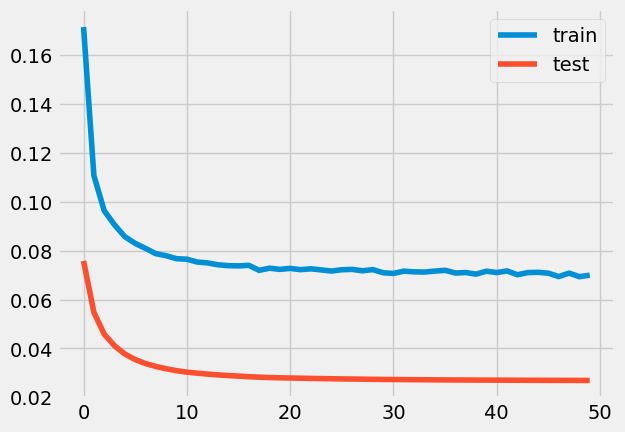

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 157ms/step - loss: 0.2397 - accuracy: 0.0000e+00 - val_loss: 0.1375 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 117ms/step - loss: 0.1626 - accuracy: 0.0000e+00 - val_loss: 0.1061 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20


loss: 3.28%



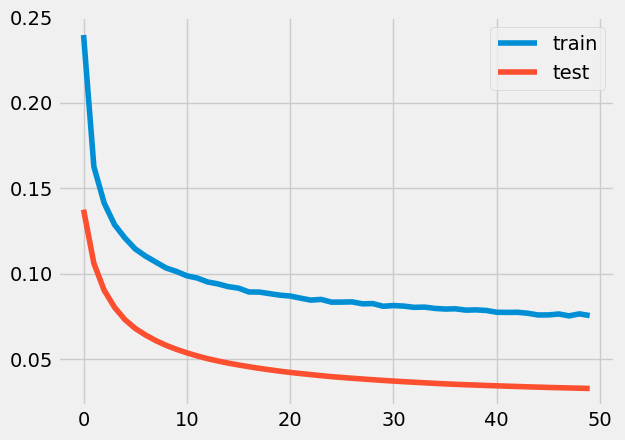

0.30708973548828056
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 146ms/step - loss: 0.0977 - accuracy: 0.0014 - val_loss: 0.0308 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 98ms/step - loss: 0.0775 - accuracy: 0.0046 - val_loss: 0.0299 - val_accuracy: 0.0000e+00
Epoch

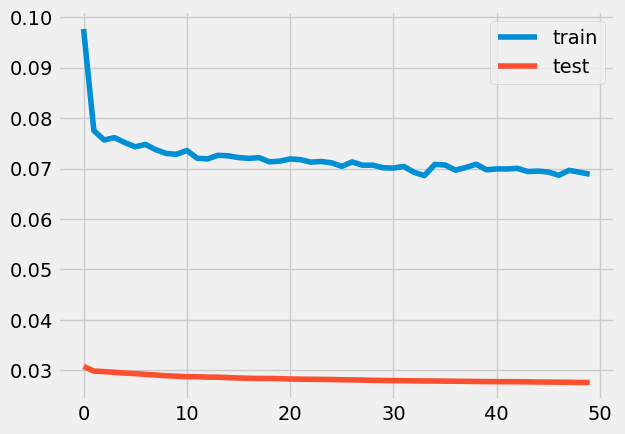

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 146ms/step - loss: 0.3372 - accuracy: 0.0000e+00 - val_loss: 0.2412 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 98ms/step - loss: 0.2543 - accuracy: 0.0000e+00 - val_loss: 0.2015 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 

Epoch 50/50
20/20 [==============================] - 2s 103ms/step - loss: 0.1090 - accuracy: 0.0000e+00 - val_loss: 0.0672 - val_accuracy: 0.0000e+00

loss: 6.72%



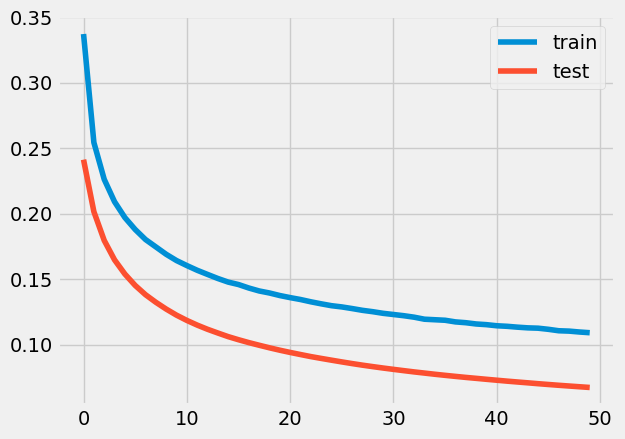

0.00036291044118532117
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 158ms/step - loss: 0.2392 - accuracy: 0.0000e+00 - val_loss: 0.1490 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 106ms/step - loss: 0.1743 - accuracy: 0.0000e+00 - val_loss: 0.1183 - val_accuracy: 0.00

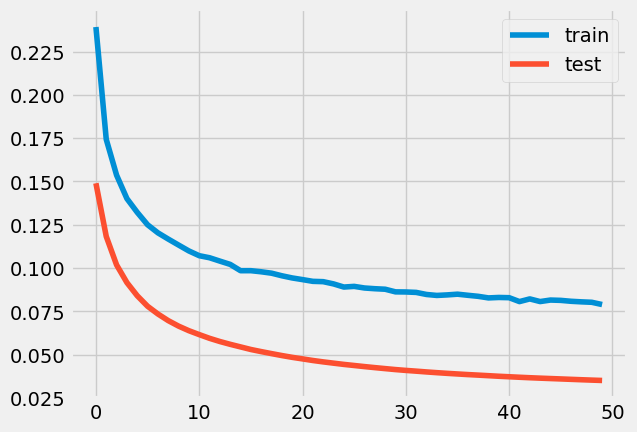

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 159ms/step - loss: 0.2048 - accuracy: 0.0000e+00 - val_loss: 0.1147 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 109ms/step - loss: 0.1481 - accuracy: 0.0000e+00 - val_loss: 0.0918 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20


loss: 3.22%



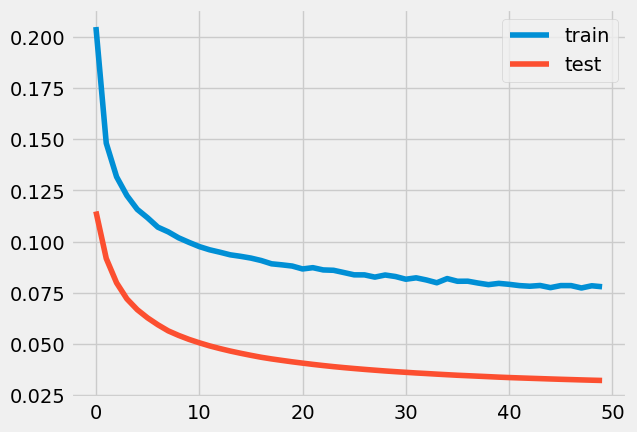

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 155ms/step - loss: 0.1347 - accuracy: 2.2951e-04 - val_loss: 0.0537 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 116ms/step - loss: 0.0950 - accuracy: 7.3156e-04 - val_loss: 0.0406 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20

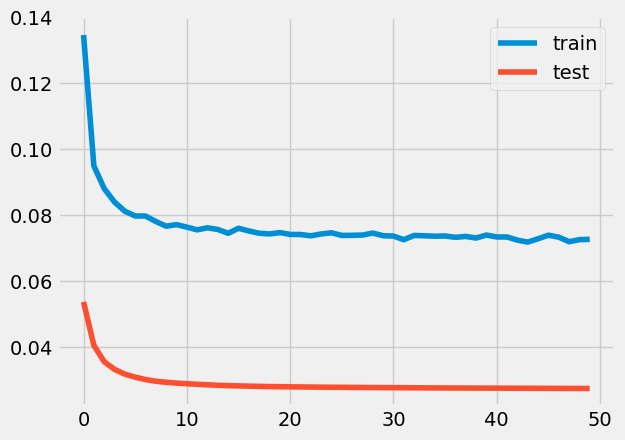

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 155ms/step - loss: 0.1986 - accuracy: 0.0000e+00 - val_loss: 0.1038 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 114ms/step - loss: 0.1378 - accuracy: 0.0000e+00 - val_loss: 0.0808 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20


loss: 2.91%



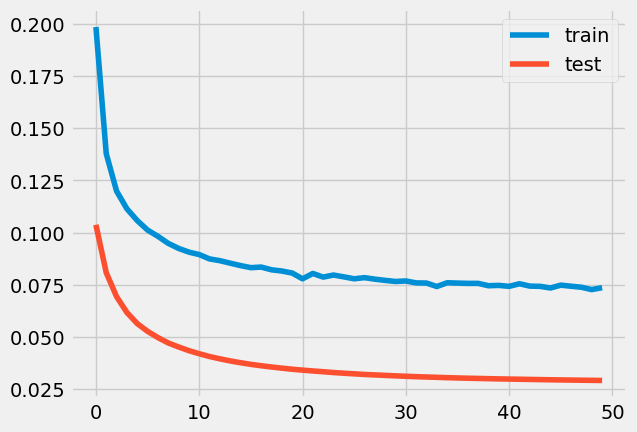

0.7231987497345926
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 164ms/step - loss: 0.2747 - accuracy: 0.0000e+00 - val_loss: 0.1823 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 112ms/step - loss: 0.2058 - accuracy: 0.0000e+00 - val_loss: 0.1501 - val_accuracy: 0.0000e+

Epoch 50/50
20/20 [==============================] - 2s 122ms/step - loss: 0.0981 - accuracy: 5.4918e-04 - val_loss: 0.0510 - val_accuracy: 0.0000e+00

loss: 5.10%



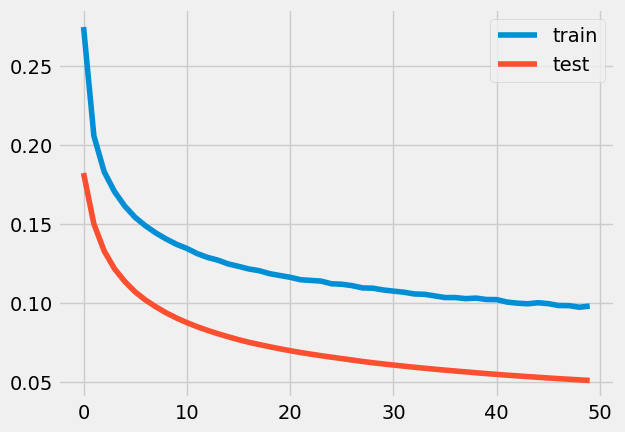

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 207ms/step - loss: 0.1878 - accuracy: 0.0000e+00 - val_loss: 0.0961 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 106ms/step - loss: 0.1296 - accuracy: 0.0000e+00 - val_loss: 0.0714 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20

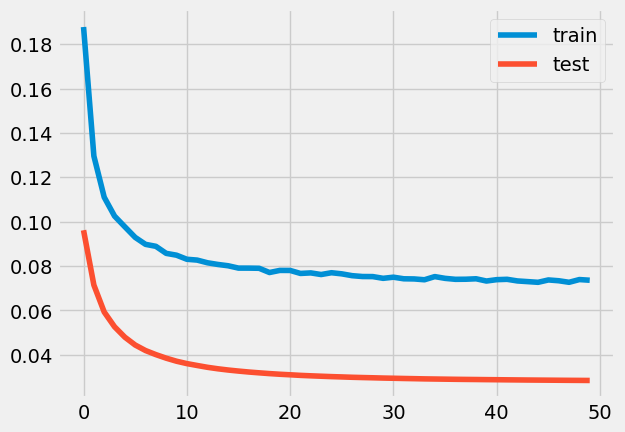

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 178ms/step - loss: 0.2266 - accuracy: 0.0000e+00 - val_loss: 0.1244 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 121ms/step - loss: 0.1538 - accuracy: 0.0000e+00 - val_loss: 0.0960 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20


loss: 3.48%



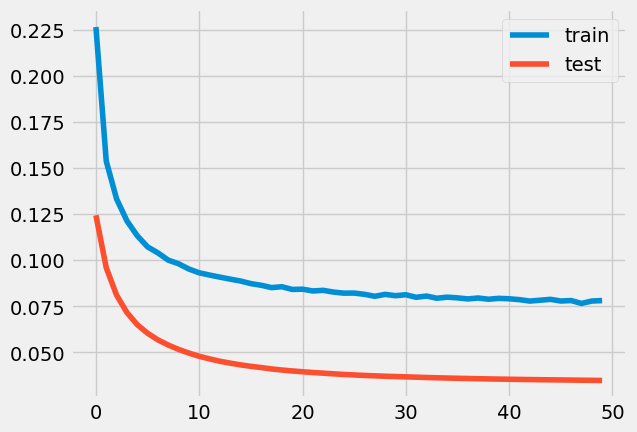

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 152ms/step - loss: 0.1934 - accuracy: 0.0000e+00 - val_loss: 0.1025 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 110ms/step - loss: 0.1364 - accuracy: 0.0000e+00 - val_loss: 0.0800 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20


loss: 2.81%



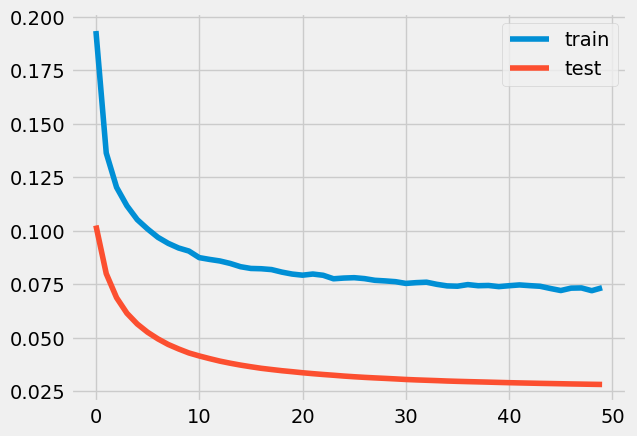

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 13s 271ms/step - loss: 0.2287 - accuracy: 0.0000e+00 - val_loss: 0.1234 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 183ms/step - loss: 0.1506 - accuracy: 0.0000e+00 - val_loss: 0.0932 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2


loss: 3.13%



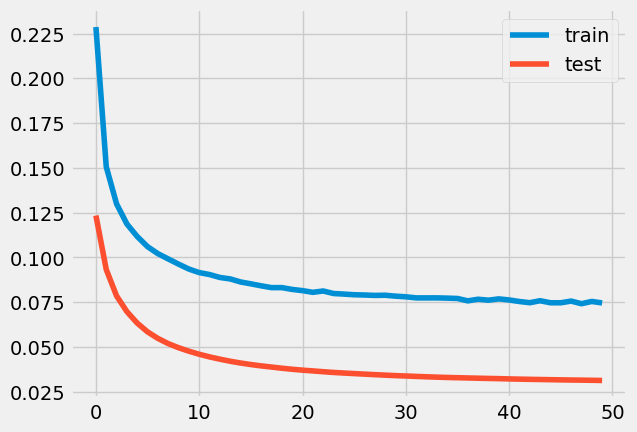

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 165ms/step - loss: 0.1129 - accuracy: 0.0012 - val_loss: 0.0381 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 102ms/step - loss: 0.0846 - accuracy: 0.0039 - val_loss: 0.0318 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [======

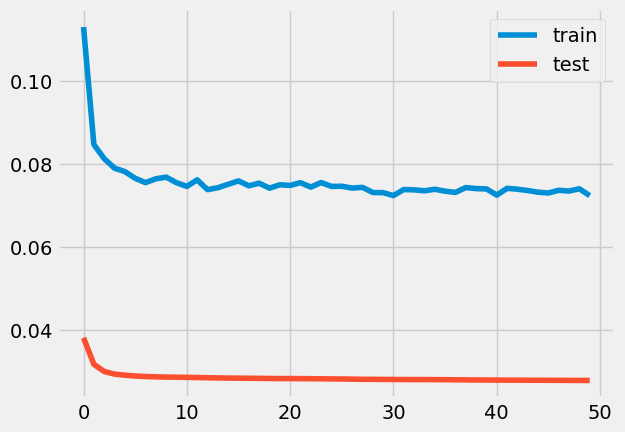

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 10s 191ms/step - loss: 0.1821 - accuracy: 0.0000e+00 - val_loss: 0.0850 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 167ms/step - loss: 0.1186 - accuracy: 0.0000e+00 - val_loss: 0.0628 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

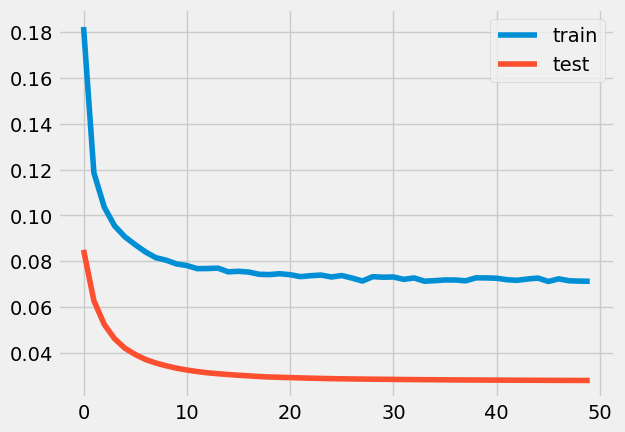

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 10s 235ms/step - loss: 0.1855 - accuracy: 0.0000e+00 - val_loss: 0.0945 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 144ms/step - loss: 0.1294 - accuracy: 0.0000e+00 - val_loss: 0.0730 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2


loss: 2.80%



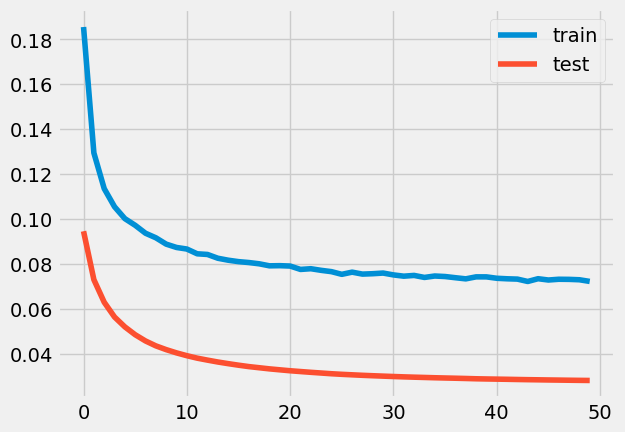

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 169ms/step - loss: 0.2073 - accuracy: 0.0000e+00 - val_loss: 0.1038 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 107ms/step - loss: 0.1344 - accuracy: 0.0000e+00 - val_loss: 0.0750 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20

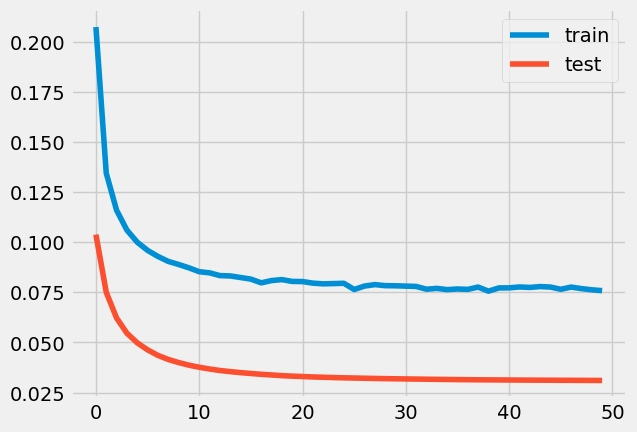

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 185ms/step - loss: 0.2011 - accuracy: 0.0000e+00 - val_loss: 0.1124 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 116ms/step - loss: 0.1447 - accuracy: 0.0000e+00 - val_loss: 0.0874 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20


loss: 2.99%



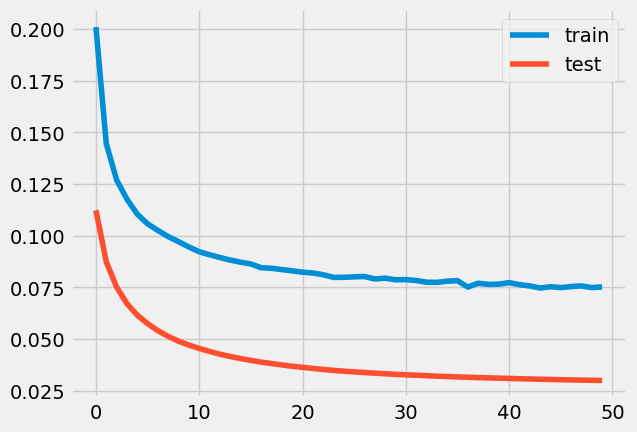

0.0025
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 134ms/step - loss: 0.2784 - accuracy: 0.0000e+00 - val_loss: 0.1881 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 92ms/step - loss: 0.2109 - accuracy: 0.0000e+00 - val_loss: 0.1581 - val_accuracy: 0.0000e+00
Epoch 3/50

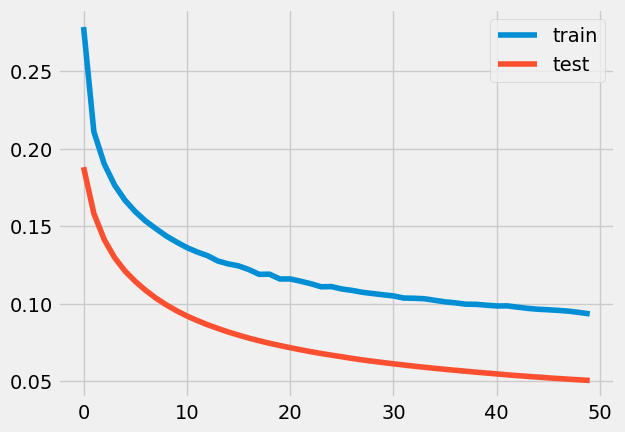

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 134ms/step - loss: 0.1766 - accuracy: 0.0000e+00 - val_loss: 0.0832 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 93ms/step - loss: 0.1186 - accuracy: 0.0000e+00 - val_loss: 0.0624 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 

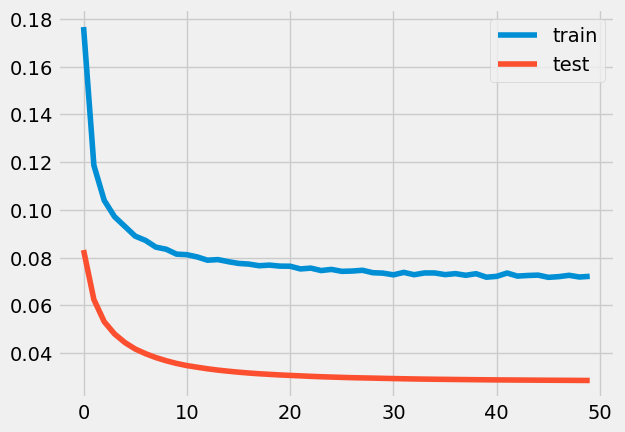

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 12s 276ms/step - loss: 0.2181 - accuracy: 0.0000e+00 - val_loss: 0.1260 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 134ms/step - loss: 0.1561 - accuracy: 0.0000e+00 - val_loss: 0.0997 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

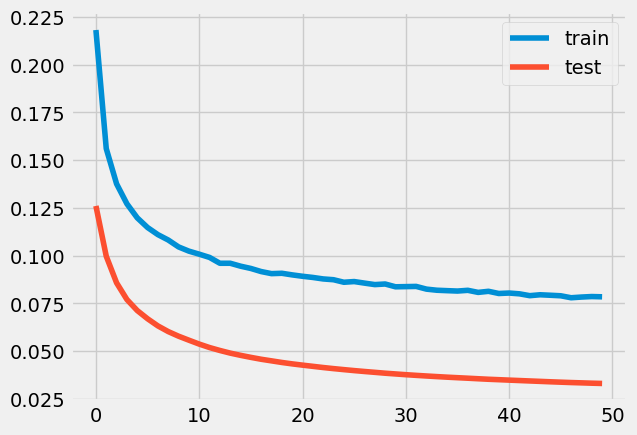

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 155ms/step - loss: 0.2677 - accuracy: 0.0000e+00 - val_loss: 0.1579 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 106ms/step - loss: 0.1793 - accuracy: 0.0000e+00 - val_loss: 0.1210 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20

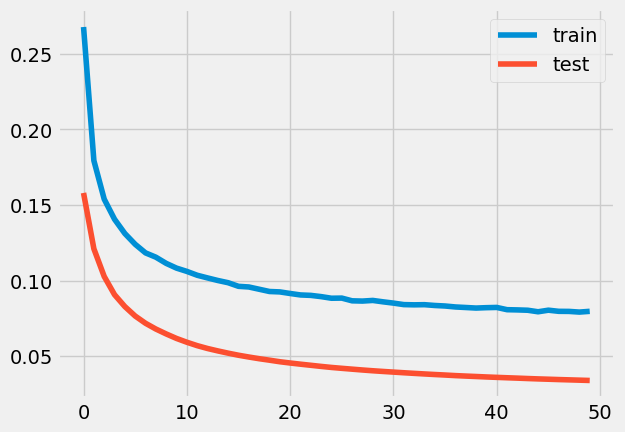

0.746933114009551
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 157ms/step - loss: 0.1344 - accuracy: 3.0533e-04 - val_loss: 0.0523 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 116ms/step - loss: 0.0948 - accuracy: 0.0012 - val_loss: 0.0405 - val_accuracy: 0.0000e+00
Ep

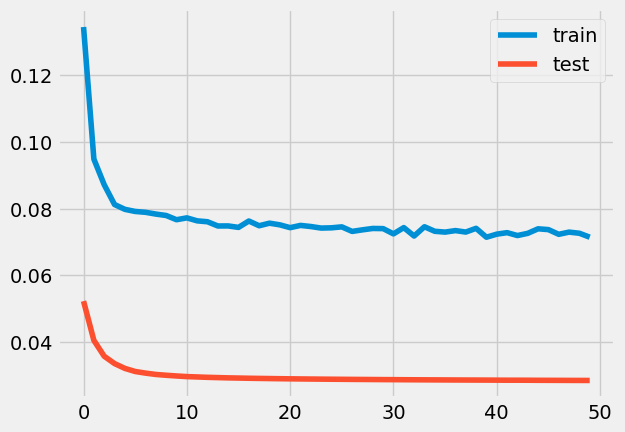

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 158ms/step - loss: 0.1913 - accuracy: 0.0000e+00 - val_loss: 0.1013 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 115ms/step - loss: 0.1341 - accuracy: 0.0000e+00 - val_loss: 0.0776 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20


loss: 2.83%



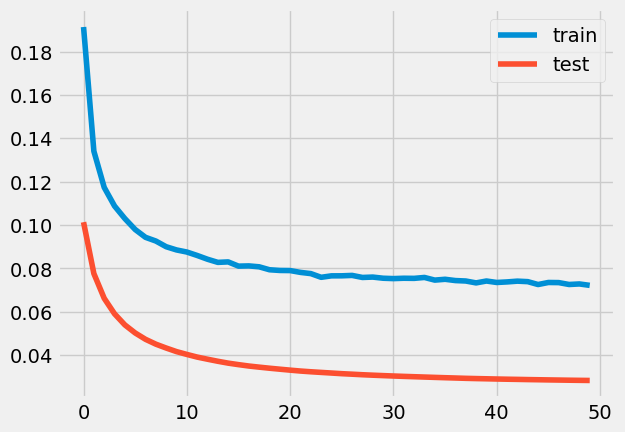

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 10s 197ms/step - loss: 0.2687 - accuracy: 0.0000e+00 - val_loss: 0.1746 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 130ms/step - loss: 0.1985 - accuracy: 0.0000e+00 - val_loss: 0.1433 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

Epoch 50/50
20/20 [==============================] - 3s 133ms/step - loss: 0.0896 - accuracy: 6.2500e-04 - val_loss: 0.0463 - val_accuracy: 0.0000e+00

loss: 4.63%



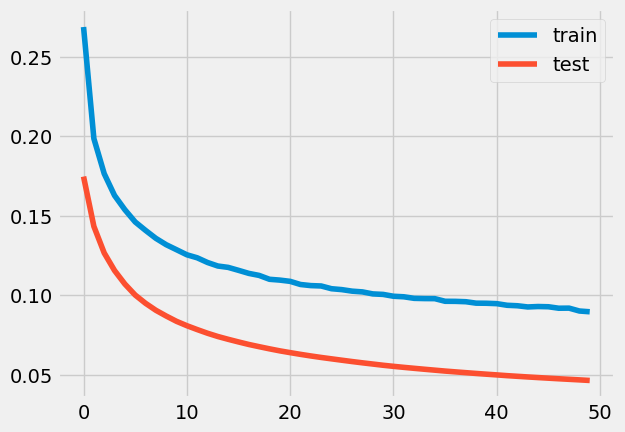

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 180ms/step - loss: 0.2587 - accuracy: 0.0000e+00 - val_loss: 0.1493 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 135ms/step - loss: 0.1726 - accuracy: 0.0000e+00 - val_loss: 0.1137 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20


loss: 3.29%



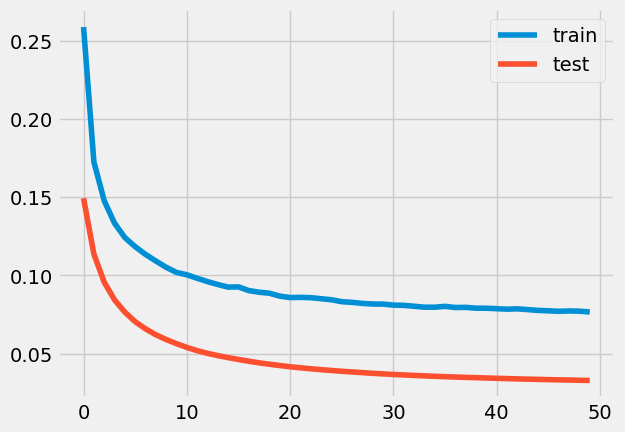

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 182ms/step - loss: 0.1993 - accuracy: 0.0000e+00 - val_loss: 0.1063 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 110ms/step - loss: 0.1388 - accuracy: 0.0000e+00 - val_loss: 0.0822 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20


loss: 3.05%



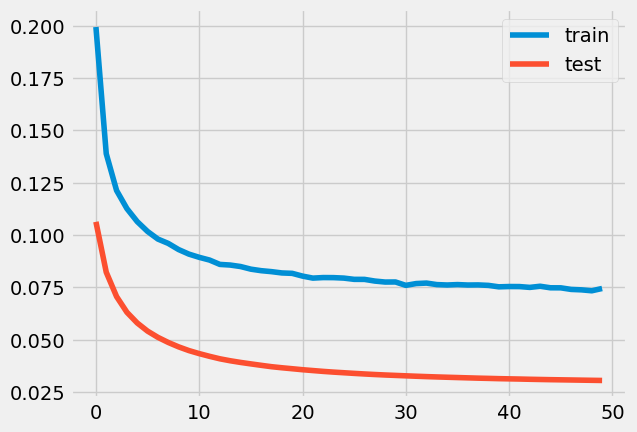

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 173ms/step - loss: 0.1213 - accuracy: 4.4262e-04 - val_loss: 0.0412 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 131ms/step - loss: 0.0879 - accuracy: 0.0029 - val_loss: 0.0331 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [==

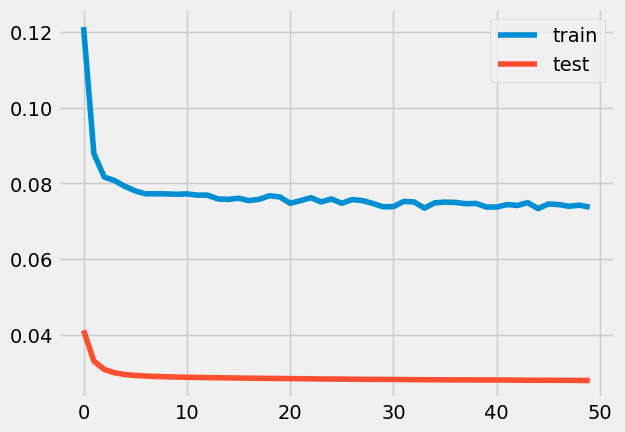

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 212ms/step - loss: 0.1357 - accuracy: 6.1475e-06 - val_loss: 0.0559 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 124ms/step - loss: 0.0981 - accuracy: 8.1967e-04 - val_loss: 0.0430 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20

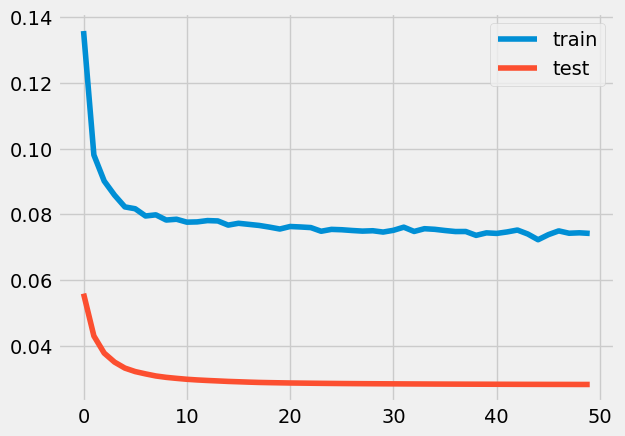

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 11s 206ms/step - loss: 0.2348 - accuracy: 0.0000e+00 - val_loss: 0.1442 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 140ms/step - loss: 0.1719 - accuracy: 0.0000e+00 - val_loss: 0.1180 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

20/20 [==============================] - 3s 136ms/step - loss: 0.0818 - accuracy: 0.0014 - val_loss: 0.0373 - val_accuracy: 0.0000e+00

loss: 3.73%



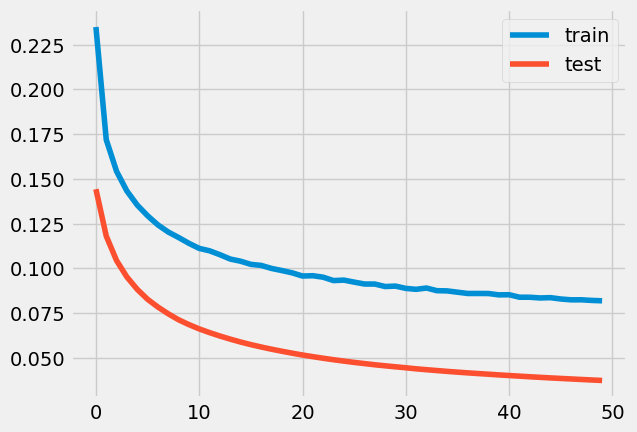

0.026892787557944674
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 9s 218ms/step - loss: 0.1716 - accuracy: 0.0000e+00 - val_loss: 0.0782 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 147ms/step - loss: 0.1135 - accuracy: 1.8238e-04 - val_loss: 0.0569 - val_accuracy: 0.0000

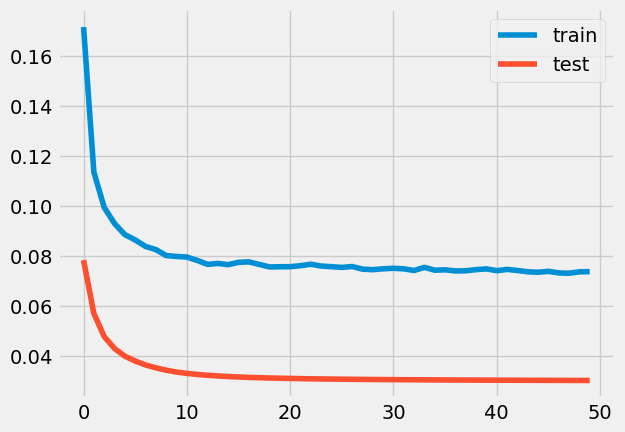

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 12s 235ms/step - loss: 0.2943 - accuracy: 0.0000e+00 - val_loss: 0.2003 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 153ms/step - loss: 0.2202 - accuracy: 0.0000e+00 - val_loss: 0.1659 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

Epoch 50/50
20/20 [==============================] - 3s 146ms/step - loss: 0.0934 - accuracy: 4.4262e-04 - val_loss: 0.0497 - val_accuracy: 0.0000e+00

loss: 4.97%



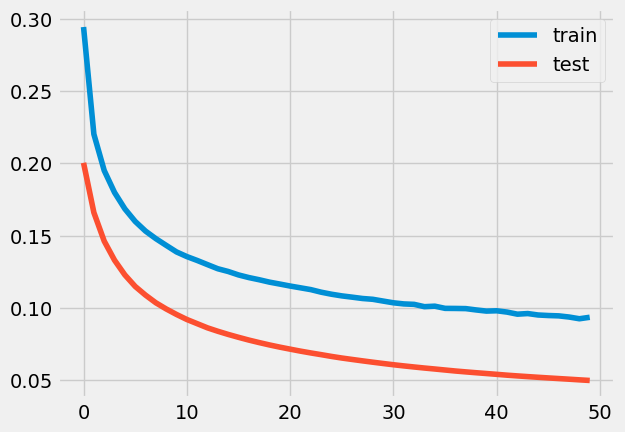

0.0003839914590875574
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 186ms/step - loss: 0.1390 - accuracy: 4.0984e-05 - val_loss: 0.0563 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 126ms/step - loss: 0.0984 - accuracy: 0.0013 - val_loss: 0.0437 - val_accuracy: 0.0000e+0

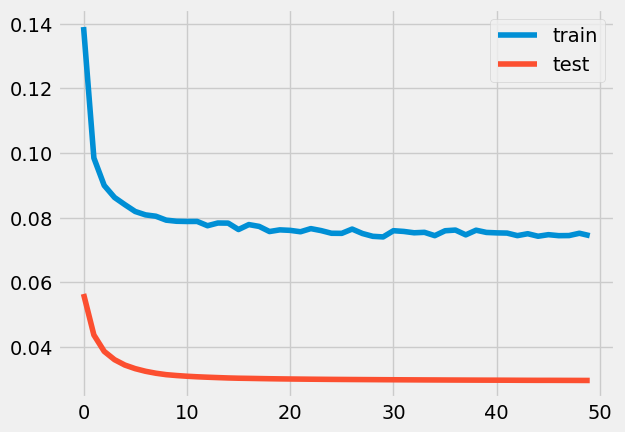

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 11s 266ms/step - loss: 0.1668 - accuracy: 0.0000e+00 - val_loss: 0.0725 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 160ms/step - loss: 0.1068 - accuracy: 4.7131e-05 - val_loss: 0.0524 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

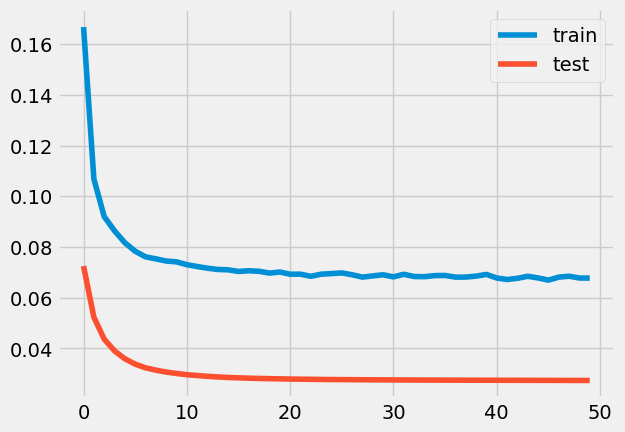

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 11s 292ms/step - loss: 0.1588 - accuracy: 0.0000e+00 - val_loss: 0.0734 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 187ms/step - loss: 0.1103 - accuracy: 3.0738e-05 - val_loss: 0.0559 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

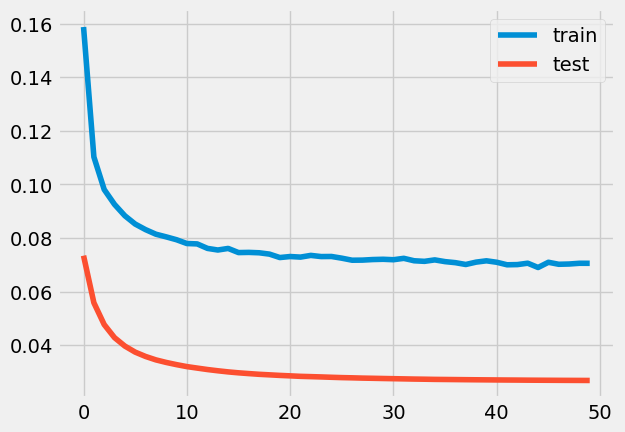

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 9s 179ms/step - loss: 0.1673 - accuracy: 0.0000e+00 - val_loss: 0.0869 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 131ms/step - loss: 0.1230 - accuracy: 0.0000e+00 - val_loss: 0.0679 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20

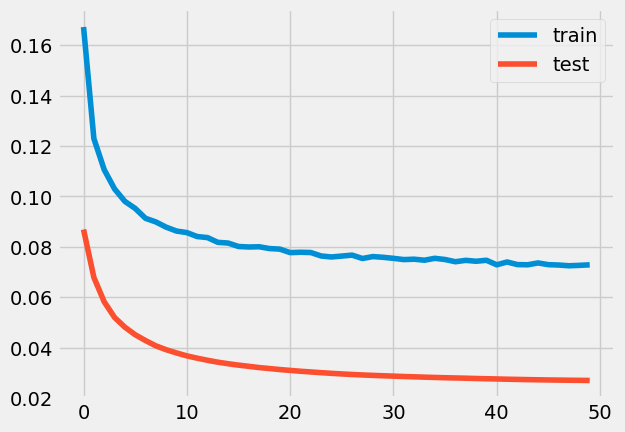

0.961916903769993
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 184ms/step - loss: 0.2568 - accuracy: 0.0000e+00 - val_loss: 0.1594 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 137ms/step - loss: 0.1829 - accuracy: 0.0000e+00 - val_loss: 0.1277 - val_accuracy: 0.0000e+0

20/20 [==============================] - 3s 130ms/step - loss: 0.0828 - accuracy: 0.0020 - val_loss: 0.0392 - val_accuracy: 0.0000e+00

loss: 3.92%



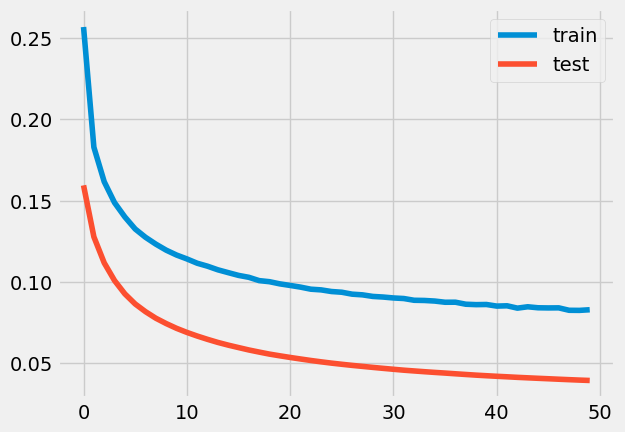

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 9s 202ms/step - loss: 0.0896 - accuracy: 0.0030 - val_loss: 0.0263 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 142ms/step - loss: 0.0754 - accuracy: 0.0048 - val_loss: 0.0255 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [======

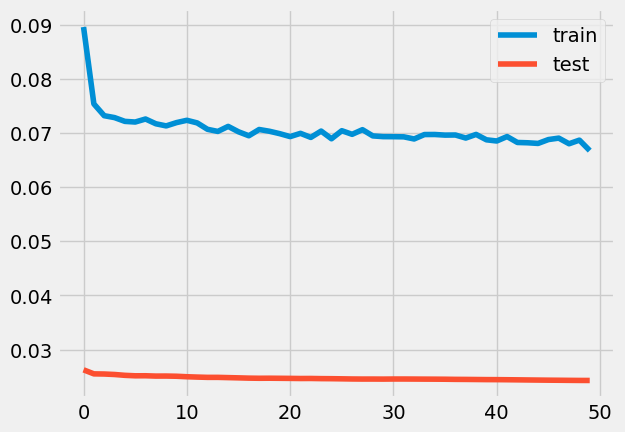

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 9s 231ms/step - loss: 0.1376 - accuracy: 2.7664e-04 - val_loss: 0.0563 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 154ms/step - loss: 0.0976 - accuracy: 7.4180e-04 - val_loss: 0.0435 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20

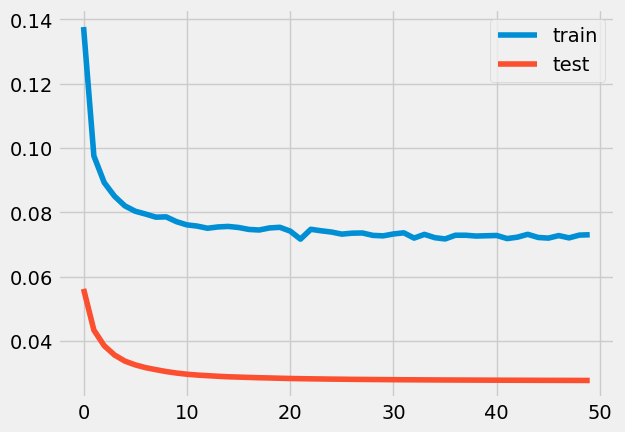

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 206ms/step - loss: 0.1212 - accuracy: 1.6189e-04 - val_loss: 0.0433 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 140ms/step - loss: 0.0876 - accuracy: 0.0023 - val_loss: 0.0338 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [==

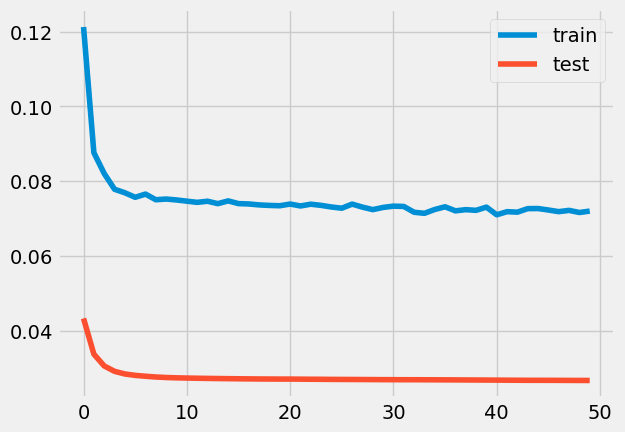

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 9s 199ms/step - loss: 0.1004 - accuracy: 0.0043 - val_loss: 0.0326 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 133ms/step - loss: 0.0787 - accuracy: 0.0041 - val_loss: 0.0313 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [======

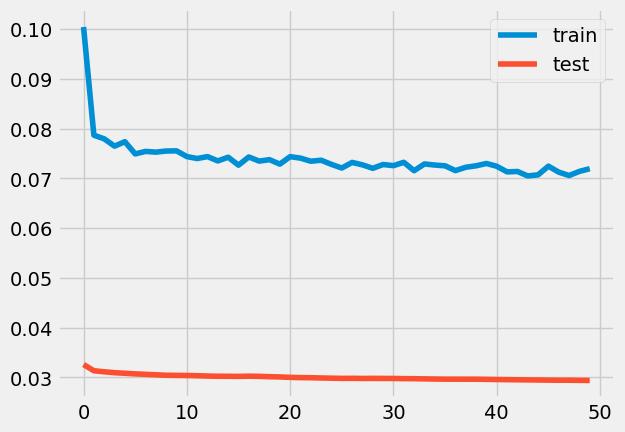

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 9s 197ms/step - loss: 0.1911 - accuracy: 0.0000e+00 - val_loss: 0.1020 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 133ms/step - loss: 0.1371 - accuracy: 0.0000e+00 - val_loss: 0.0801 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20


loss: 2.91%



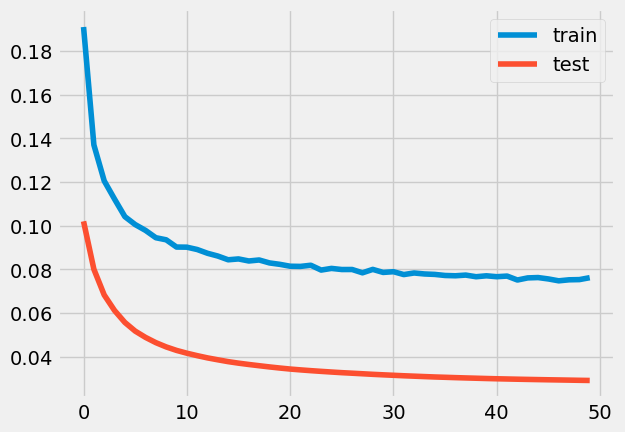

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 9s 199ms/step - loss: 0.1227 - accuracy: 1.0041e-04 - val_loss: 0.0421 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 129ms/step - loss: 0.0875 - accuracy: 0.0045 - val_loss: 0.0347 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [==

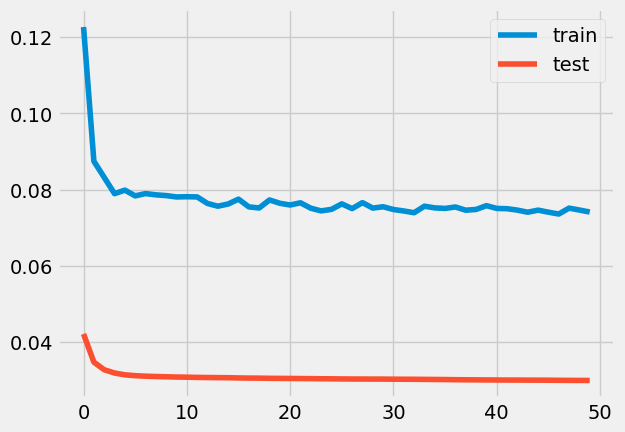

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 176ms/step - loss: 0.2186 - accuracy: 0.0000e+00 - val_loss: 0.1182 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 105ms/step - loss: 0.1460 - accuracy: 0.0000e+00 - val_loss: 0.0895 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20


loss: 2.76%



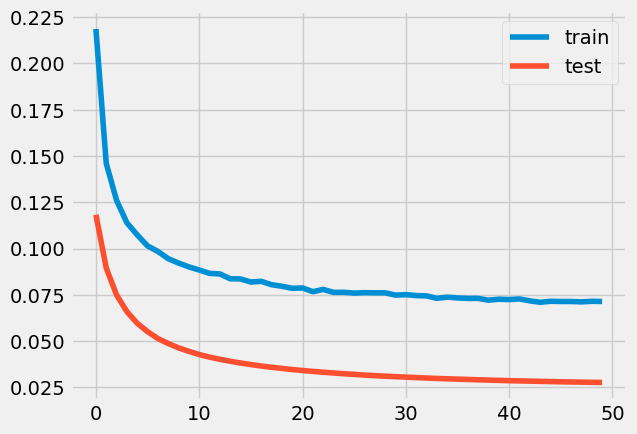

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 10s 205ms/step - loss: 0.1243 - accuracy: 2.5000e-04 - val_loss: 0.0460 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 140ms/step - loss: 0.0901 - accuracy: 0.0010 - val_loss: 0.0361 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=

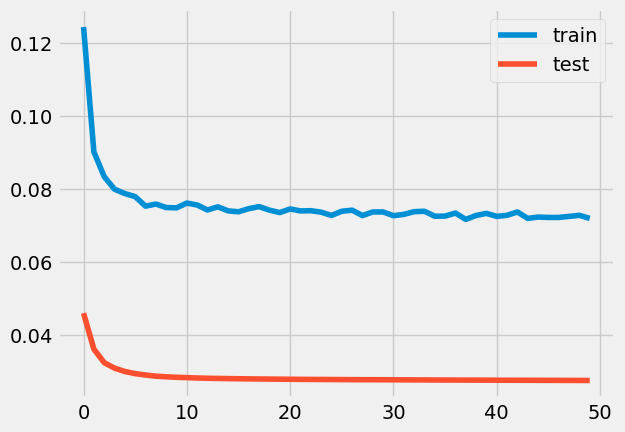

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 9s 229ms/step - loss: 0.0867 - accuracy: 0.0047 - val_loss: 0.0284 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 147ms/step - loss: 0.0767 - accuracy: 0.0047 - val_loss: 0.0281 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [======

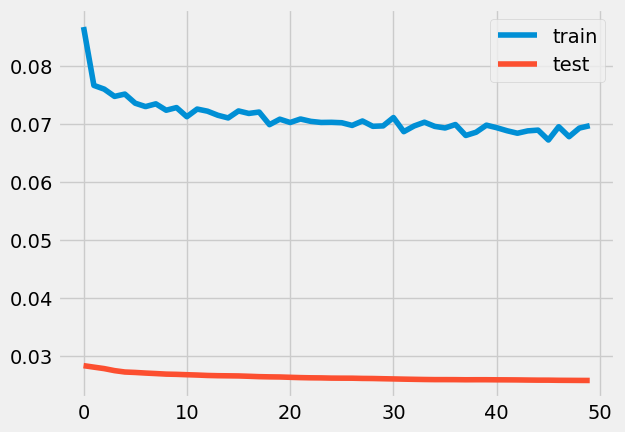

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 10s 216ms/step - loss: 0.2162 - accuracy: 0.0000e+00 - val_loss: 0.1250 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 142ms/step - loss: 0.1550 - accuracy: 0.0000e+00 - val_loss: 0.0987 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2


loss: 3.18%



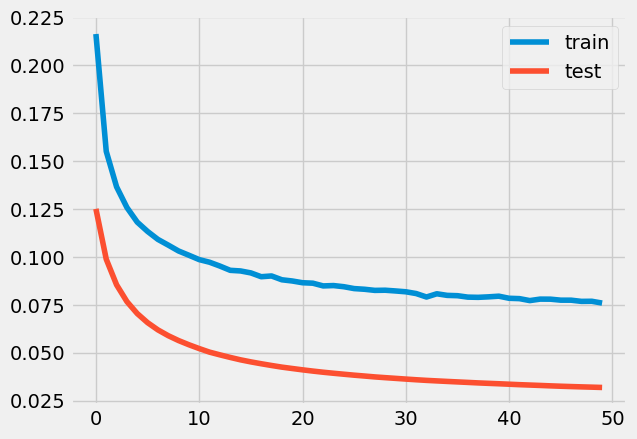

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 204ms/step - loss: 0.1954 - accuracy: 0.0000e+00 - val_loss: 0.1034 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 136ms/step - loss: 0.1355 - accuracy: 0.0000e+00 - val_loss: 0.0789 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20


loss: 2.72%



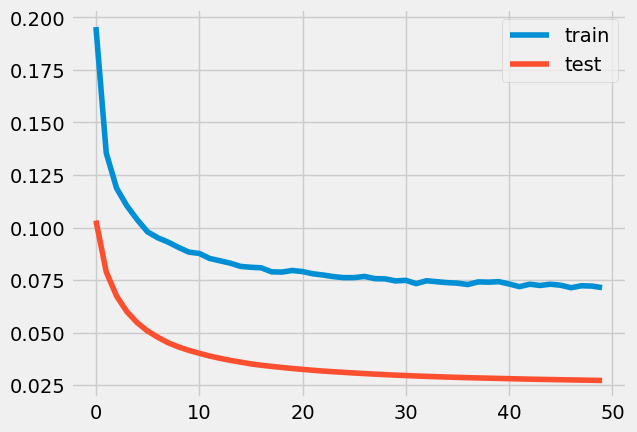

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 9s 217ms/step - loss: 0.1915 - accuracy: 0.0000e+00 - val_loss: 0.0998 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 140ms/step - loss: 0.1347 - accuracy: 0.0000e+00 - val_loss: 0.0786 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20


loss: 3.00%



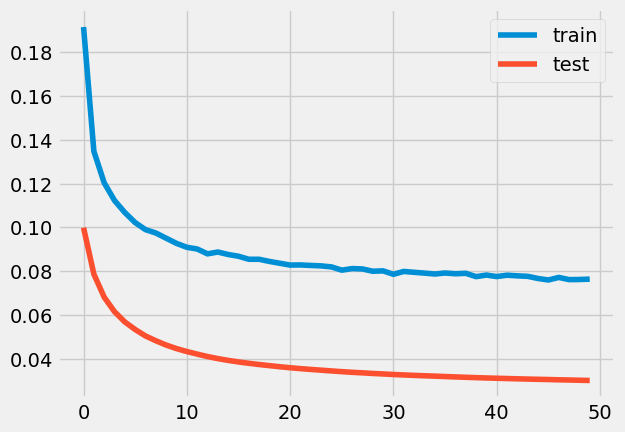

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 10s 214ms/step - loss: 0.1766 - accuracy: 0.0000e+00 - val_loss: 0.0883 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 140ms/step - loss: 0.1244 - accuracy: 0.0000e+00 - val_loss: 0.0674 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

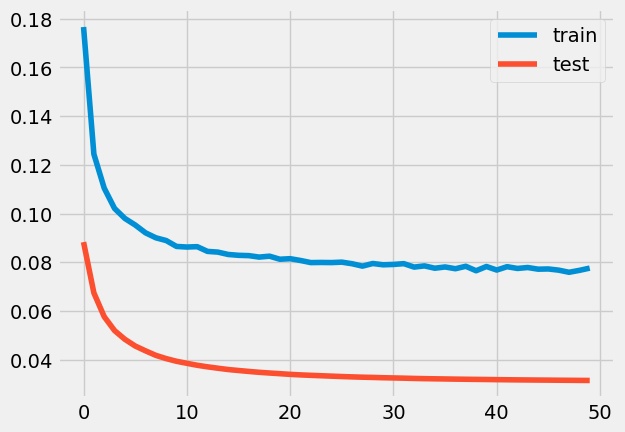

0.5767763892124853
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 7s 168ms/step - loss: 0.3213 - accuracy: 0.0000e+00 - val_loss: 0.2105 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 118ms/step - loss: 0.2272 - accuracy: 0.0000e+00 - val_loss: 0.1728 - val_accuracy: 0.0000e+

Epoch 50/50
20/20 [==============================] - 3s 146ms/step - loss: 0.0925 - accuracy: 5.0205e-04 - val_loss: 0.0494 - val_accuracy: 0.0000e+00

loss: 4.94%



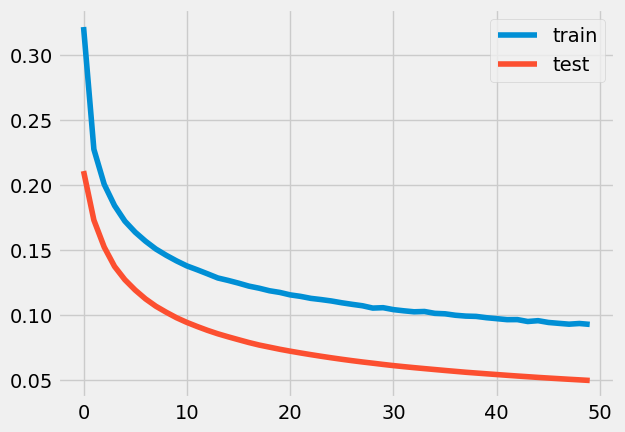

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 9s 212ms/step - loss: 0.1741 - accuracy: 0.0000e+00 - val_loss: 0.0833 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 145ms/step - loss: 0.1189 - accuracy: 0.0000e+00 - val_loss: 0.0635 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20

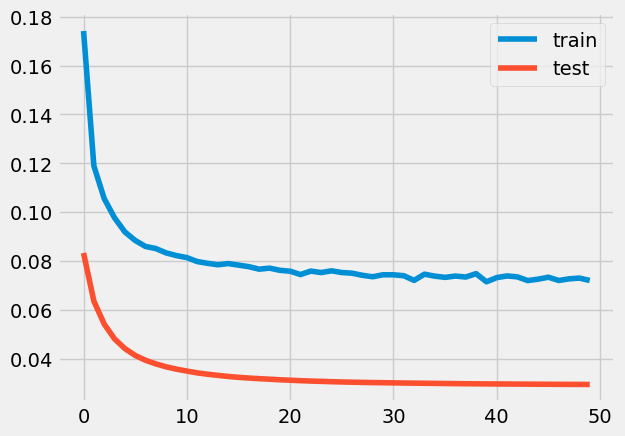

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 10s 207ms/step - loss: 0.2037 - accuracy: 0.0000e+00 - val_loss: 0.1097 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 151ms/step - loss: 0.1429 - accuracy: 0.0000e+00 - val_loss: 0.0853 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2


loss: 3.26%



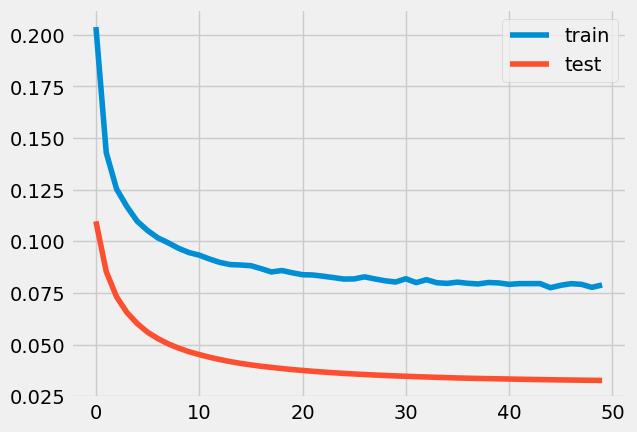

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 13s 302ms/step - loss: 0.0821 - accuracy: 0.0046 - val_loss: 0.0290 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 208ms/step - loss: 0.0766 - accuracy: 0.0046 - val_loss: 0.0276 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=====

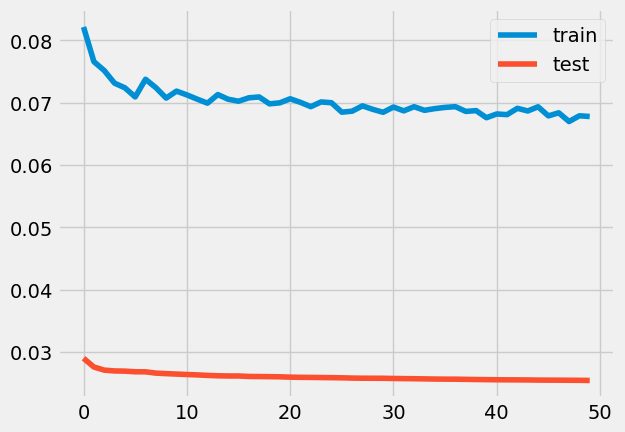

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 14s 394ms/step - loss: 0.1741 - accuracy: 0.0000e+00 - val_loss: 0.0858 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 5s 253ms/step - loss: 0.1225 - accuracy: 0.0000e+00 - val_loss: 0.0658 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

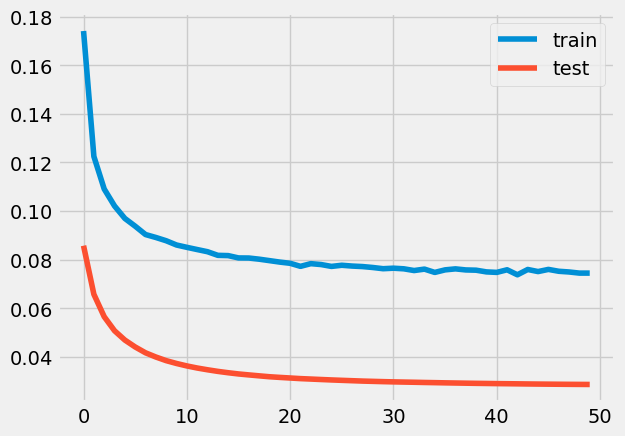

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 13s 290ms/step - loss: 0.1851 - accuracy: 0.0000e+00 - val_loss: 0.0982 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 179ms/step - loss: 0.1339 - accuracy: 0.0000e+00 - val_loss: 0.0772 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2


loss: 2.88%



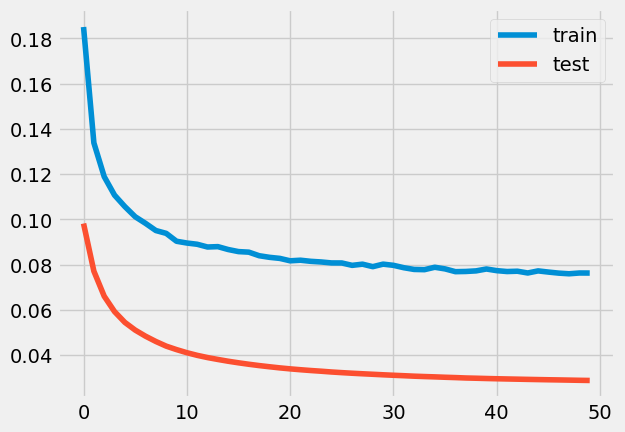

0.9312881233383455
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 13s 299ms/step - loss: 0.2348 - accuracy: 0.0000e+00 - val_loss: 0.1274 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 168ms/step - loss: 0.1531 - accuracy: 0.0000e+00 - val_loss: 0.0956 - val_accuracy: 0.0000e


loss: 2.96%



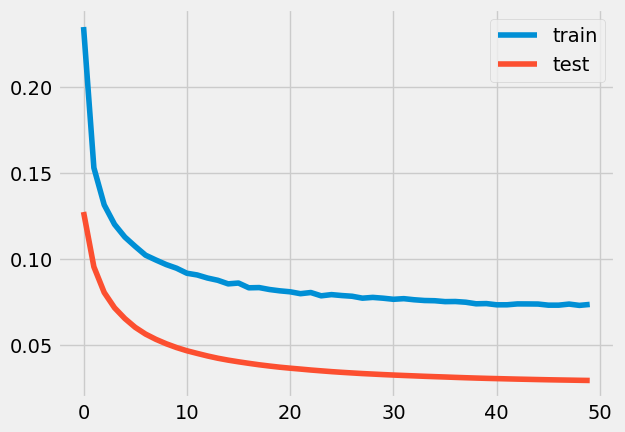

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 13s 263ms/step - loss: 0.1849 - accuracy: 0.0000e+00 - val_loss: 0.0767 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 159ms/step - loss: 0.1084 - accuracy: 6.9672e-05 - val_loss: 0.0533 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

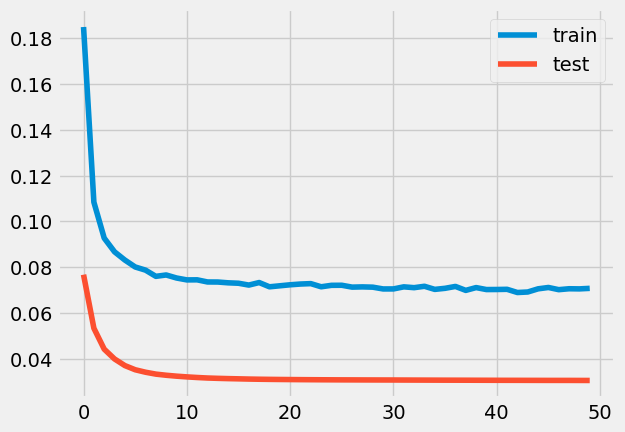

0.7080257569886748
0.00125
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 19s 345ms/step - loss: 0.1460 - accuracy: 1.2705e-04 - val_loss: 0.0607 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 200ms/step - loss: 0.1005 - accuracy: 4.1803e-04 - val_loss: 0.0461 - val_accuracy:


loss: 2.88%



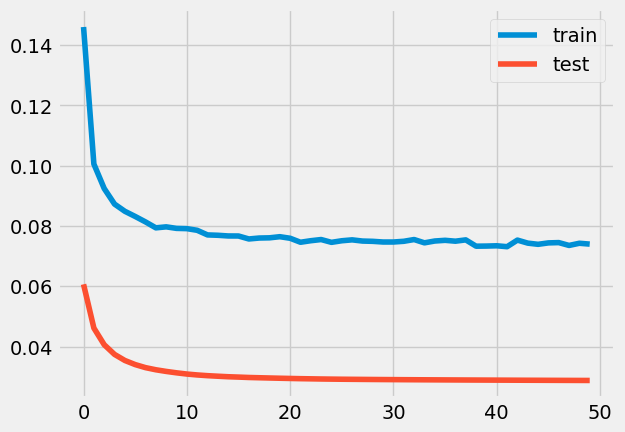

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 14s 326ms/step - loss: 0.1883 - accuracy: 0.0000e+00 - val_loss: 0.0927 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 175ms/step - loss: 0.1285 - accuracy: 0.0000e+00 - val_loss: 0.0703 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

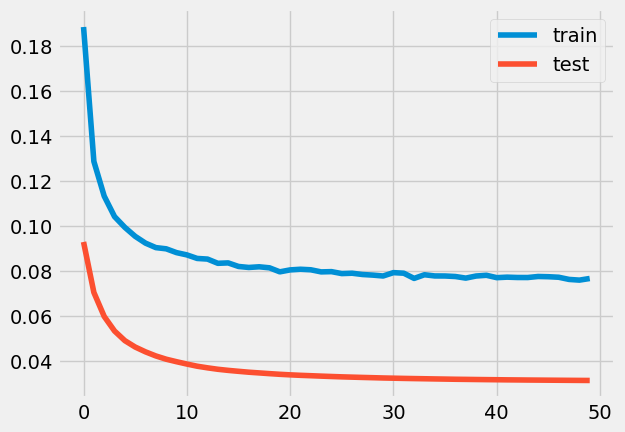

0.14682190834628264
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 18s 389ms/step - loss: 0.0871 - accuracy: 0.0033 - val_loss: 0.0290 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 5s 244ms/step - loss: 0.0758 - accuracy: 0.0051 - val_loss: 0.0289 - val_accuracy: 0.0000e+00
Epo

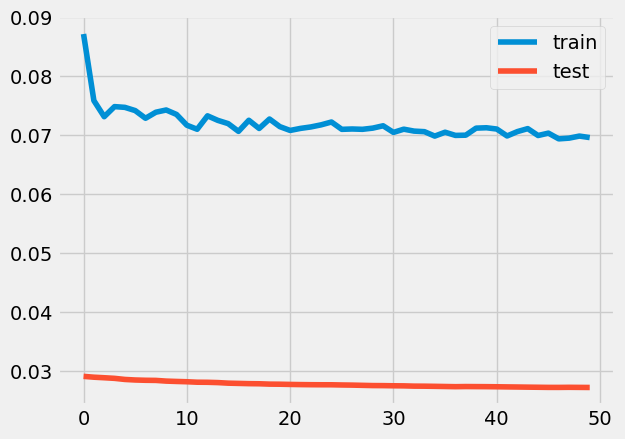

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 18s 396ms/step - loss: 0.2050 - accuracy: 0.0000e+00 - val_loss: 0.1069 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 5s 262ms/step - loss: 0.1368 - accuracy: 0.0000e+00 - val_loss: 0.0806 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2


loss: 2.90%



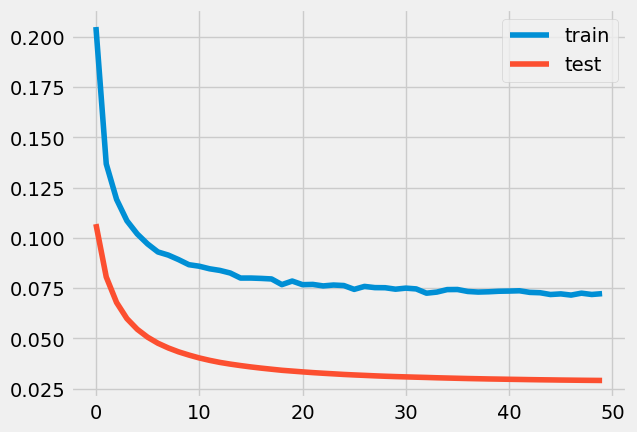

0.21932993766201223
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 15s 313ms/step - loss: 0.2596 - accuracy: 0.0000e+00 - val_loss: 0.1681 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 210ms/step - loss: 0.1945 - accuracy: 0.0000e+00 - val_loss: 0.1398 - val_accuracy: 0.0000

Epoch 50/50
20/20 [==============================] - 5s 234ms/step - loss: 0.0924 - accuracy: 4.4057e-04 - val_loss: 0.0469 - val_accuracy: 0.0000e+00

loss: 4.69%



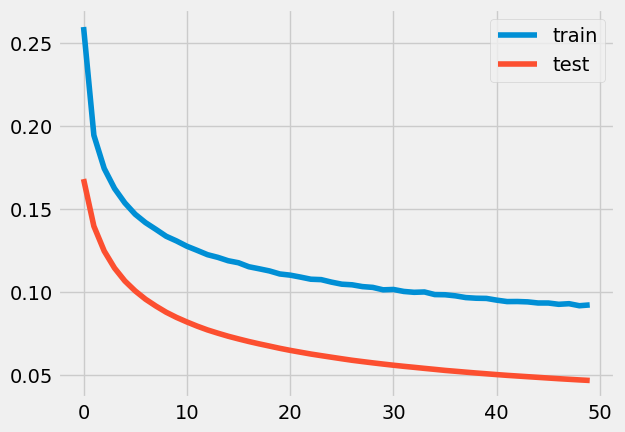

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 16s 371ms/step - loss: 0.2932 - accuracy: 0.0000e+00 - val_loss: 0.2025 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 217ms/step - loss: 0.2248 - accuracy: 0.0000e+00 - val_loss: 0.1716 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

Epoch 50/50
20/20 [==============================] - 4s 178ms/step - loss: 0.1092 - accuracy: 1.0246e-04 - val_loss: 0.0643 - val_accuracy: 0.0000e+00

loss: 6.43%



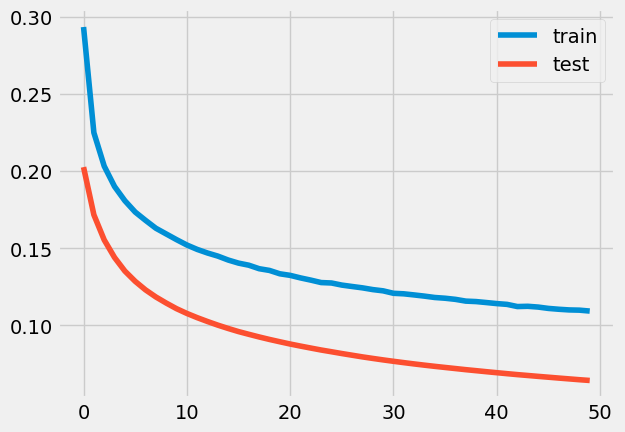

9.220238192499188e-07
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 12s 260ms/step - loss: 0.1648 - accuracy: 0.0000e+00 - val_loss: 0.0712 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 150ms/step - loss: 0.1068 - accuracy: 6.7623e-05 - val_loss: 0.0528 - val_accuracy: 0.00

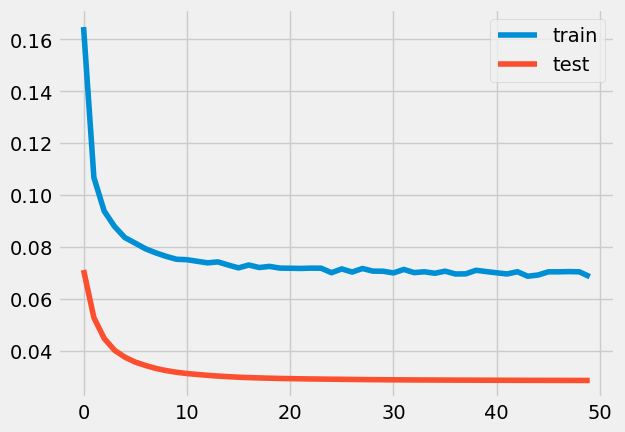

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 14s 303ms/step - loss: 0.1349 - accuracy: 0.0000e+00 - val_loss: 0.0591 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 180ms/step - loss: 0.1005 - accuracy: 4.7541e-04 - val_loss: 0.0458 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

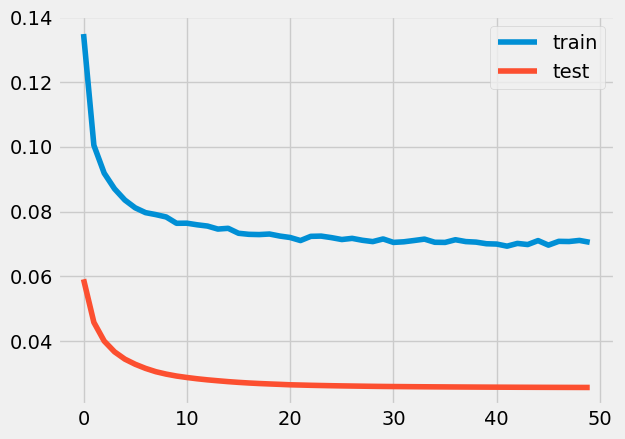

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 12s 268ms/step - loss: 0.1984 - accuracy: 0.0000e+00 - val_loss: 0.0977 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 166ms/step - loss: 0.1298 - accuracy: 0.0000e+00 - val_loss: 0.0729 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

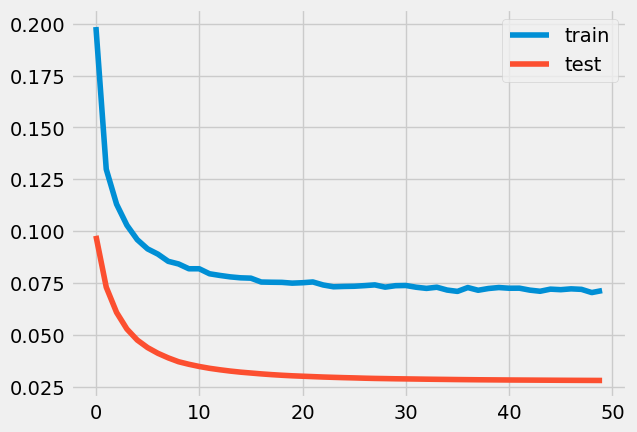

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 13s 243ms/step - loss: 0.1157 - accuracy: 5.9426e-04 - val_loss: 0.0349 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 174ms/step - loss: 0.0807 - accuracy: 0.0045 - val_loss: 0.0303 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=

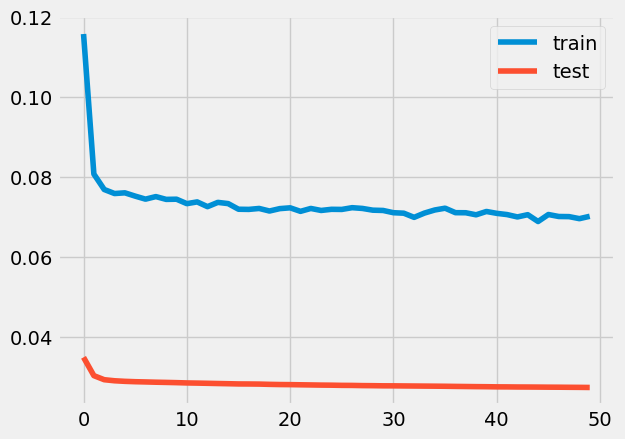

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 11s 261ms/step - loss: 0.1780 - accuracy: 0.0000e+00 - val_loss: 0.0802 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 165ms/step - loss: 0.1141 - accuracy: 4.3033e-05 - val_loss: 0.0577 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

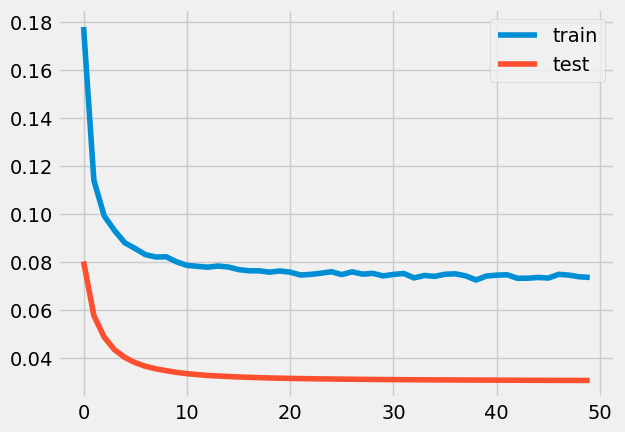

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 12s 265ms/step - loss: 0.1760 - accuracy: 0.0000e+00 - val_loss: 0.0839 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 184ms/step - loss: 0.1190 - accuracy: 0.0000e+00 - val_loss: 0.0636 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

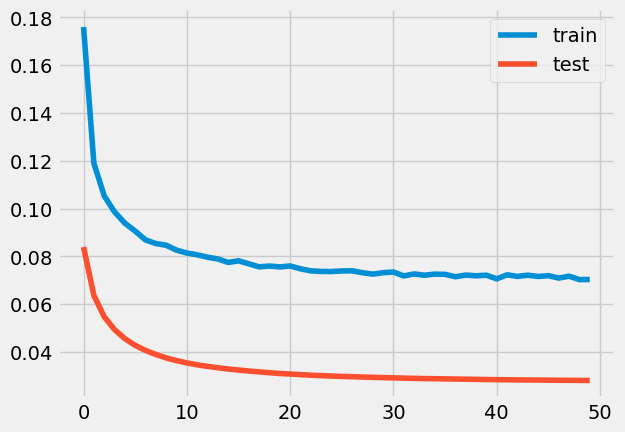

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 12s 260ms/step - loss: 0.3151 - accuracy: 0.0000e+00 - val_loss: 0.2136 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 163ms/step - loss: 0.2305 - accuracy: 0.0000e+00 - val_loss: 0.1769 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

Epoch 50/50
20/20 [==============================] - 3s 170ms/step - loss: 0.1025 - accuracy: 1.9262e-04 - val_loss: 0.0600 - val_accuracy: 0.0000e+00

loss: 6.00%



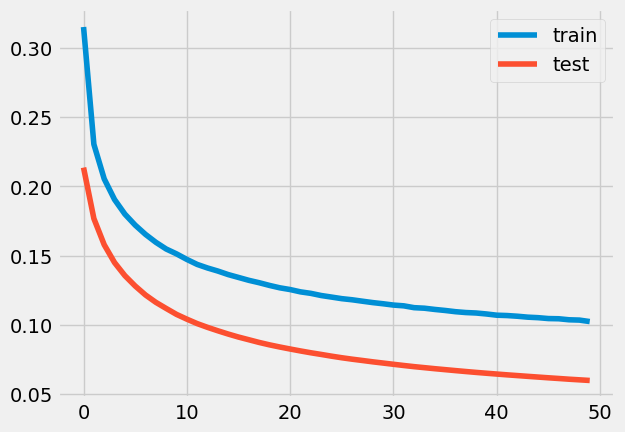

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 10s 228ms/step - loss: 0.1589 - accuracy: 2.4590e-05 - val_loss: 0.0691 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 157ms/step - loss: 0.1088 - accuracy: 3.1352e-04 - val_loss: 0.0514 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

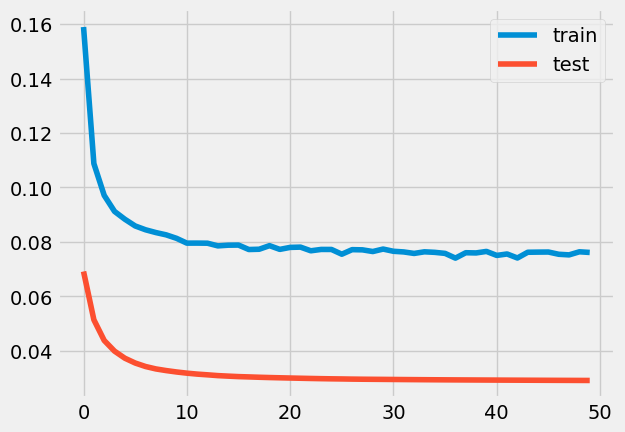

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 12s 273ms/step - loss: 0.1599 - accuracy: 0.0000e+00 - val_loss: 0.0720 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 163ms/step - loss: 0.1109 - accuracy: 1.8648e-04 - val_loss: 0.0549 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

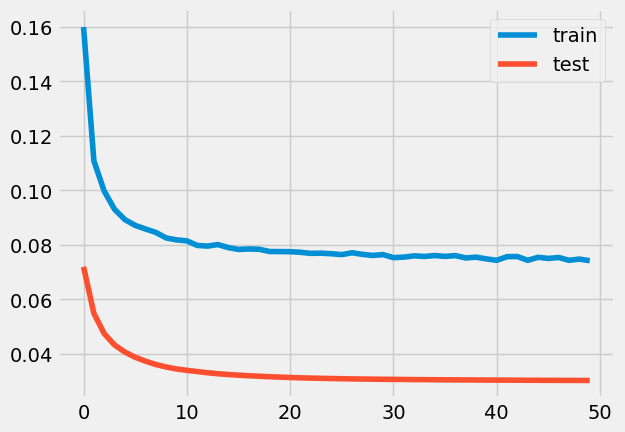

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 12s 247ms/step - loss: 0.2640 - accuracy: 0.0000e+00 - val_loss: 0.1568 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 156ms/step - loss: 0.1818 - accuracy: 0.0000e+00 - val_loss: 0.1250 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

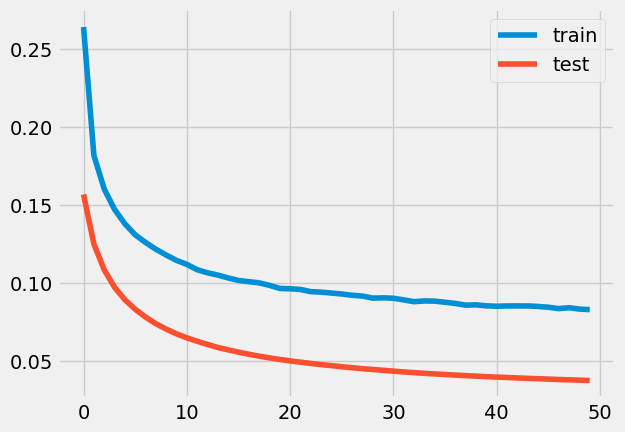

0.003030927149398233
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 13s 269ms/step - loss: 0.3360 - accuracy: 0.0000e+00 - val_loss: 0.2403 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 178ms/step - loss: 0.2546 - accuracy: 0.0000e+00 - val_loss: 0.2030 - val_accuracy: 0.000

Epoch 50/50
20/20 [==============================] - 3s 169ms/step - loss: 0.1215 - accuracy: 0.0000e+00 - val_loss: 0.0797 - val_accuracy: 0.0000e+00

loss: 7.97%



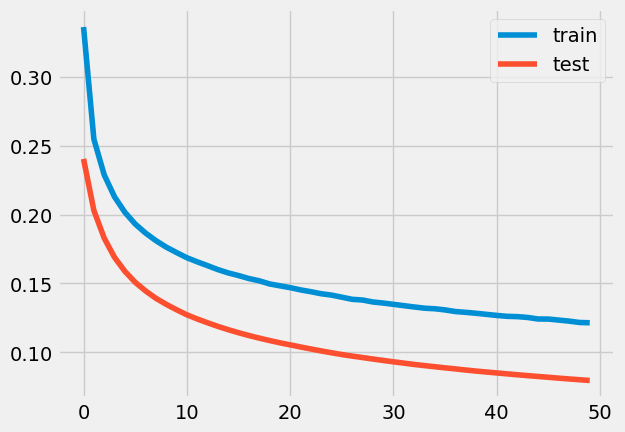

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 15s 291ms/step - loss: 0.1675 - accuracy: 0.0000e+00 - val_loss: 0.0748 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 189ms/step - loss: 0.1122 - accuracy: 2.5000e-04 - val_loss: 0.0564 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

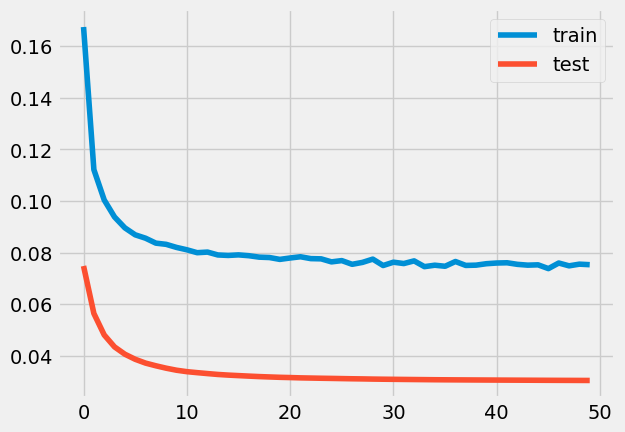

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 19s 392ms/step - loss: 0.1182 - accuracy: 8.9344e-04 - val_loss: 0.0396 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 5s 255ms/step - loss: 0.0837 - accuracy: 0.0028 - val_loss: 0.0326 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=

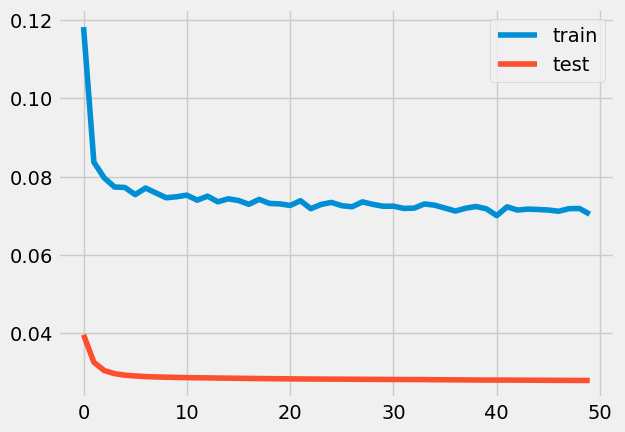

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 12s 269ms/step - loss: 0.2835 - accuracy: 0.0000e+00 - val_loss: 0.1620 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 188ms/step - loss: 0.1806 - accuracy: 0.0000e+00 - val_loss: 0.1208 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2


loss: 3.52%



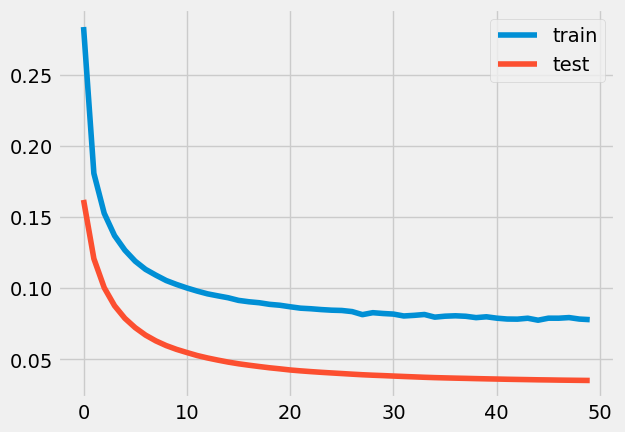

0.0030614528581102696
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 11s 264ms/step - loss: 0.3026 - accuracy: 0.0000e+00 - val_loss: 0.2108 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 184ms/step - loss: 0.2302 - accuracy: 0.0000e+00 - val_loss: 0.1780 - val_accuracy: 0.00

Epoch 50/50
20/20 [==============================] - 4s 180ms/step - loss: 0.1026 - accuracy: 0.0000e+00 - val_loss: 0.0600 - val_accuracy: 0.0000e+00

loss: 6.00%



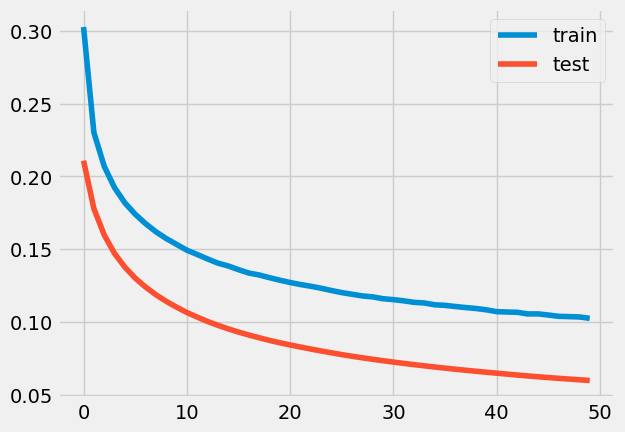

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 11s 269ms/step - loss: 0.1275 - accuracy: 6.9672e-05 - val_loss: 0.0491 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 202ms/step - loss: 0.0921 - accuracy: 8.9344e-04 - val_loss: 0.0377 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

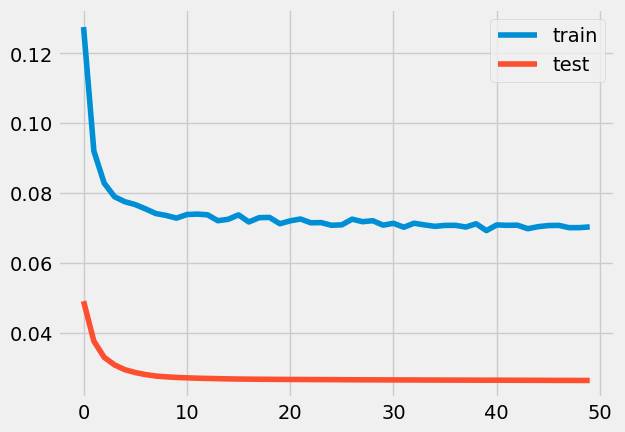

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 12s 286ms/step - loss: 0.2024 - accuracy: 0.0000e+00 - val_loss: 0.0957 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 5s 227ms/step - loss: 0.1266 - accuracy: 0.0000e+00 - val_loss: 0.0688 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

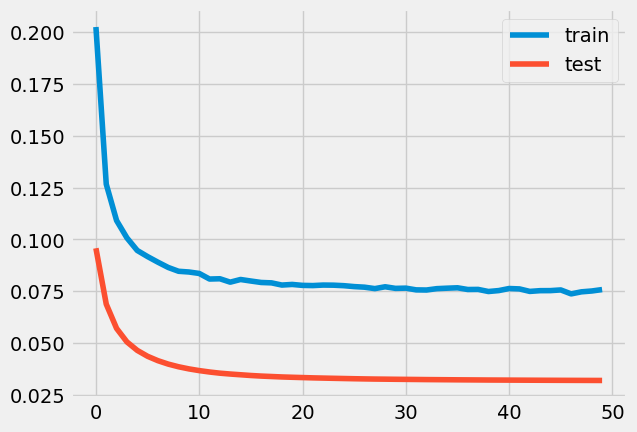

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 14s 302ms/step - loss: 0.1689 - accuracy: 0.0000e+00 - val_loss: 0.0775 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 183ms/step - loss: 0.1127 - accuracy: 8.1967e-05 - val_loss: 0.0572 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

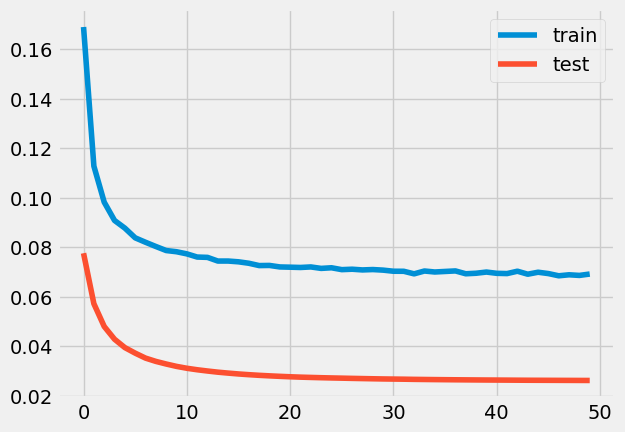

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 16s 320ms/step - loss: 0.2490 - accuracy: 0.0000e+00 - val_loss: 0.1510 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 199ms/step - loss: 0.1770 - accuracy: 0.0000e+00 - val_loss: 0.1188 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

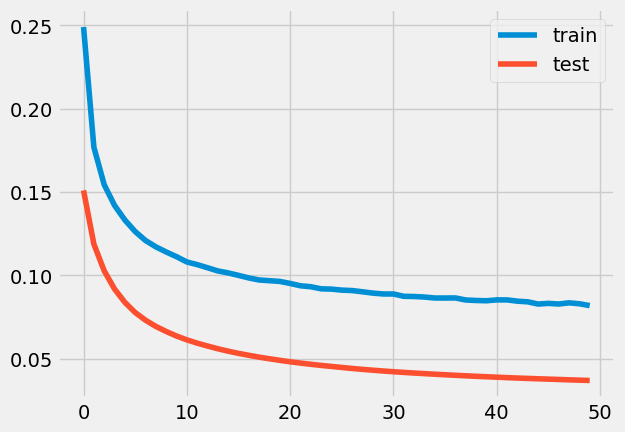

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 16s 273ms/step - loss: 0.2379 - accuracy: 0.0000e+00 - val_loss: 0.1436 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 219ms/step - loss: 0.1695 - accuracy: 0.0000e+00 - val_loss: 0.1143 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

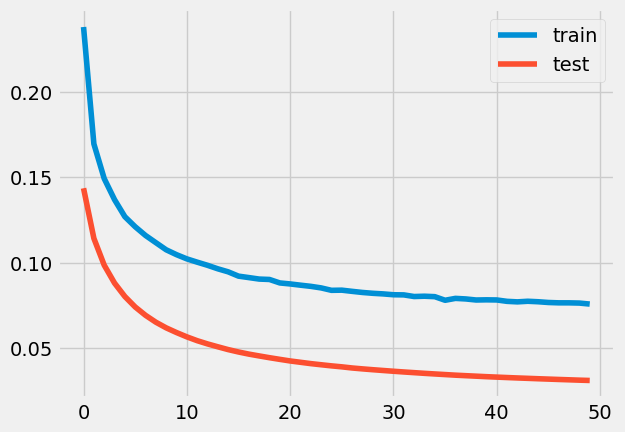

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 13s 296ms/step - loss: 0.1808 - accuracy: 0.0000e+00 - val_loss: 0.0919 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 189ms/step - loss: 0.1261 - accuracy: 0.0000e+00 - val_loss: 0.0703 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

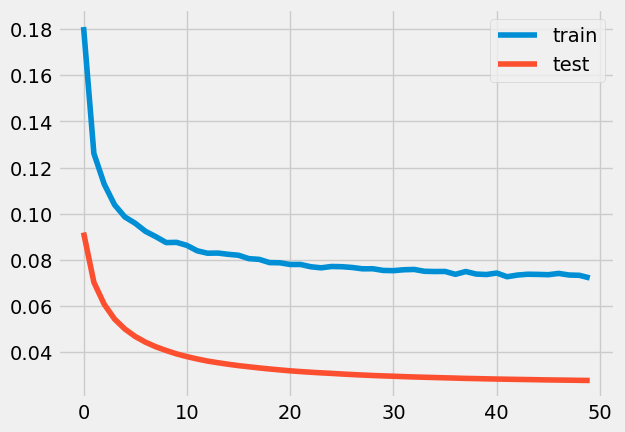

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 13s 302ms/step - loss: 0.2220 - accuracy: 0.0000e+00 - val_loss: 0.1350 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 194ms/step - loss: 0.1641 - accuracy: 0.0000e+00 - val_loss: 0.1088 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

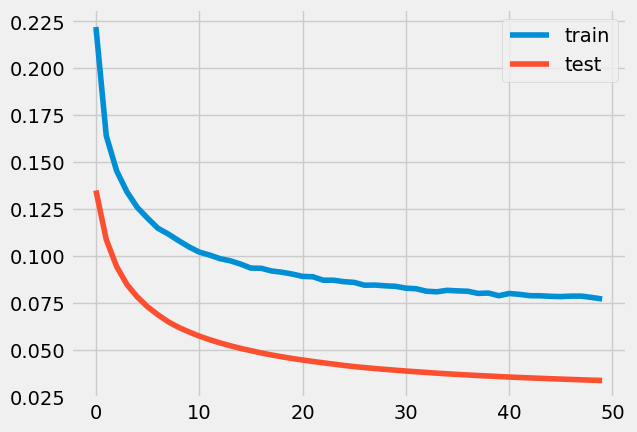

0.008234794592118002
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 12s 267ms/step - loss: 0.2498 - accuracy: 0.0000e+00 - val_loss: 0.1524 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 175ms/step - loss: 0.1796 - accuracy: 0.0000e+00 - val_loss: 0.1235 - val_accuracy: 0.000

20/20 [==============================] - 3s 172ms/step - loss: 0.0842 - accuracy: 0.0014 - val_loss: 0.0379 - val_accuracy: 0.0000e+00

loss: 3.79%



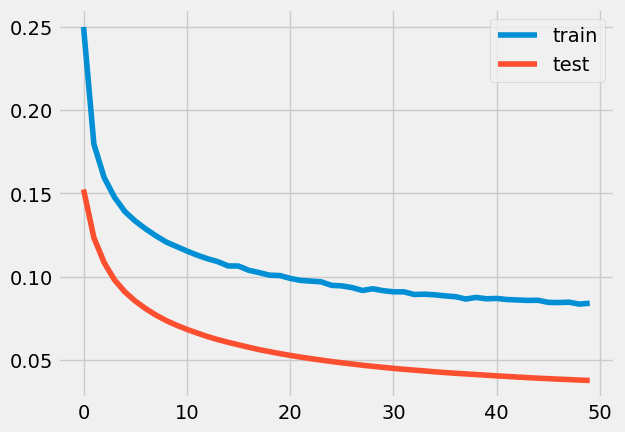

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 11s 244ms/step - loss: 0.1228 - accuracy: 1.3525e-04 - val_loss: 0.0435 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 155ms/step - loss: 0.0876 - accuracy: 0.0021 - val_loss: 0.0343 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=

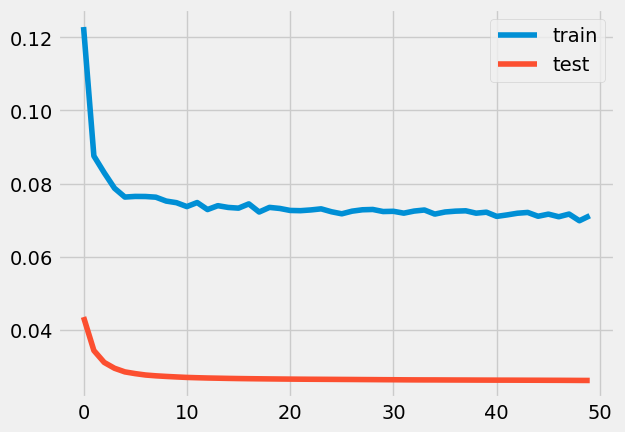

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 12s 258ms/step - loss: 0.4054 - accuracy: 0.0000e+00 - val_loss: 0.2814 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 154ms/step - loss: 0.2820 - accuracy: 0.0000e+00 - val_loss: 0.2254 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

Epoch 50/50
20/20 [==============================] - 4s 194ms/step - loss: 0.0930 - accuracy: 2.3770e-04 - val_loss: 0.0517 - val_accuracy: 0.0000e+00

loss: 5.17%



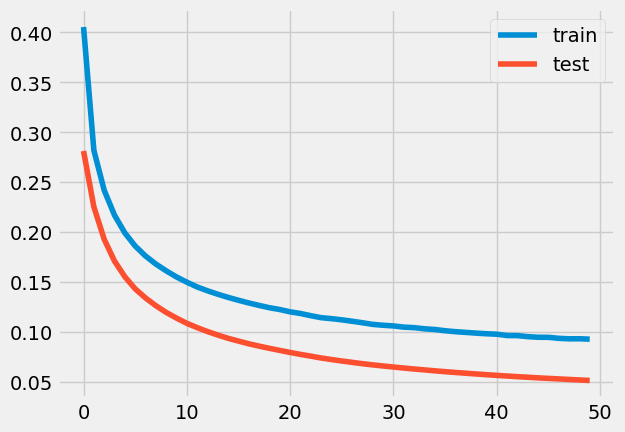

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 14s 302ms/step - loss: 0.1655 - accuracy: 0.0000e+00 - val_loss: 0.0708 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 176ms/step - loss: 0.1063 - accuracy: 2.0492e-04 - val_loss: 0.0507 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

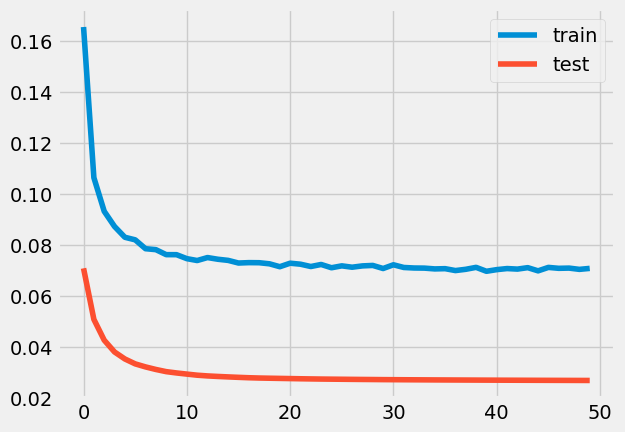

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 14s 306ms/step - loss: 0.1980 - accuracy: 0.0000e+00 - val_loss: 0.1057 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 159ms/step - loss: 0.1372 - accuracy: 0.0000e+00 - val_loss: 0.0813 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2


loss: 2.91%



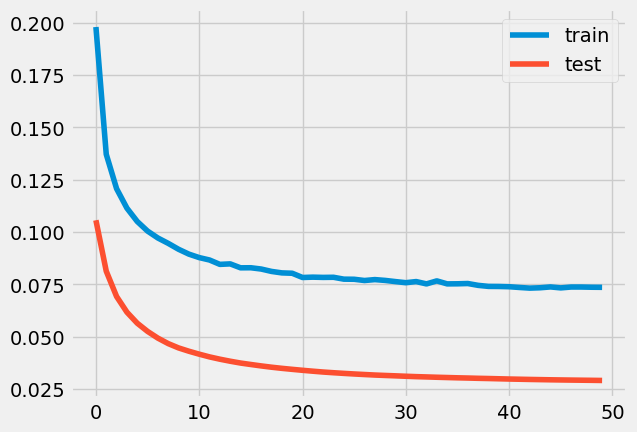

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 12s 277ms/step - loss: 0.2107 - accuracy: 0.0000e+00 - val_loss: 0.1140 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 180ms/step - loss: 0.1436 - accuracy: 0.0000e+00 - val_loss: 0.0882 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2


loss: 2.80%



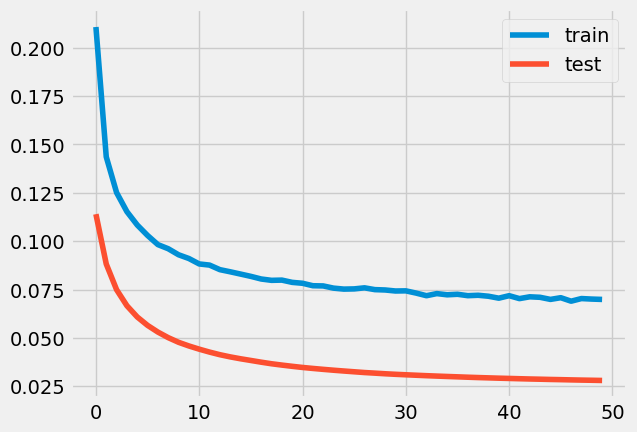

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 15s 356ms/step - loss: 0.2607 - accuracy: 0.0000e+00 - val_loss: 0.1611 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 195ms/step - loss: 0.1829 - accuracy: 0.0000e+00 - val_loss: 0.1280 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

20/20 [==============================] - 3s 173ms/step - loss: 0.0803 - accuracy: 0.0012 - val_loss: 0.0376 - val_accuracy: 0.0000e+00

loss: 3.76%



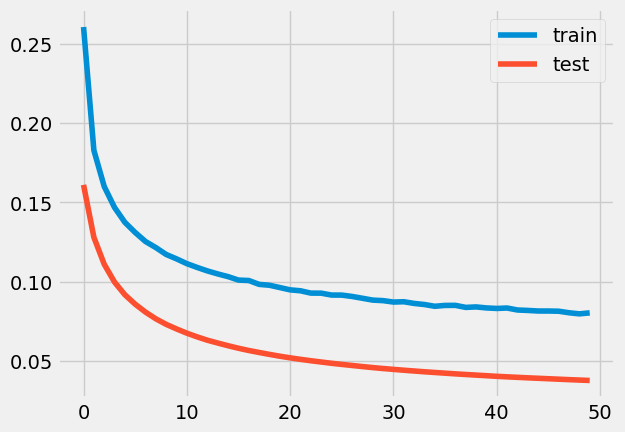

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 12s 278ms/step - loss: 0.1432 - accuracy: 4.9180e-05 - val_loss: 0.0594 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 5s 248ms/step - loss: 0.1006 - accuracy: 5.6557e-04 - val_loss: 0.0457 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

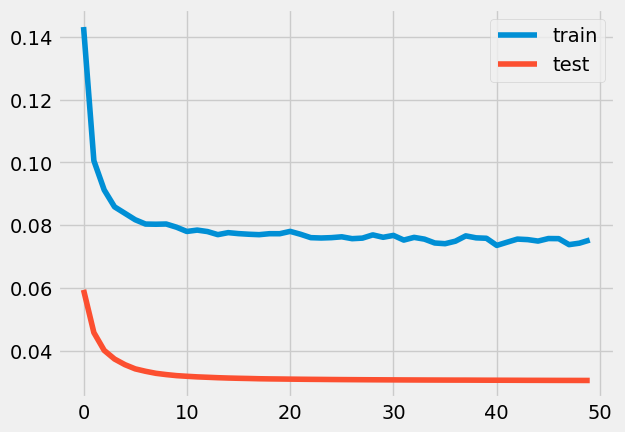

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 17s 351ms/step - loss: 0.2918 - accuracy: 0.0000e+00 - val_loss: 0.1886 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 204ms/step - loss: 0.2097 - accuracy: 0.0000e+00 - val_loss: 0.1540 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

Epoch 50/50
20/20 [==============================] - 3s 154ms/step - loss: 0.0958 - accuracy: 5.6967e-04 - val_loss: 0.0506 - val_accuracy: 0.0000e+00

loss: 5.06%



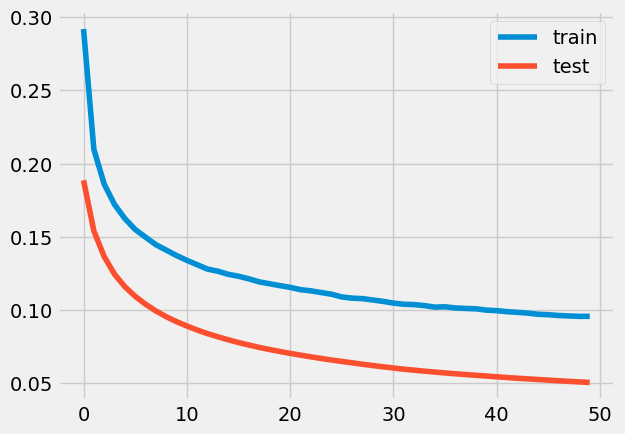

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 12s 293ms/step - loss: 0.2675 - accuracy: 0.0000e+00 - val_loss: 0.1629 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 203ms/step - loss: 0.1862 - accuracy: 0.0000e+00 - val_loss: 0.1298 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

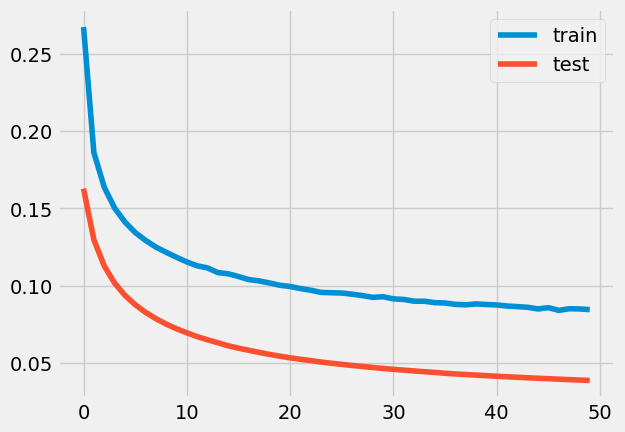

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 11s 233ms/step - loss: 0.2285 - accuracy: 0.0000e+00 - val_loss: 0.1249 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 153ms/step - loss: 0.1514 - accuracy: 0.0000e+00 - val_loss: 0.0929 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2


loss: 3.02%



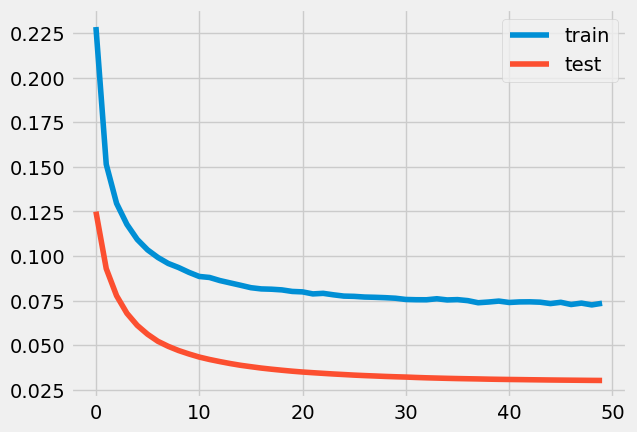

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 12s 311ms/step - loss: 0.1810 - accuracy: 0.0000e+00 - val_loss: 0.0883 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 158ms/step - loss: 0.1223 - accuracy: 0.0000e+00 - val_loss: 0.0654 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

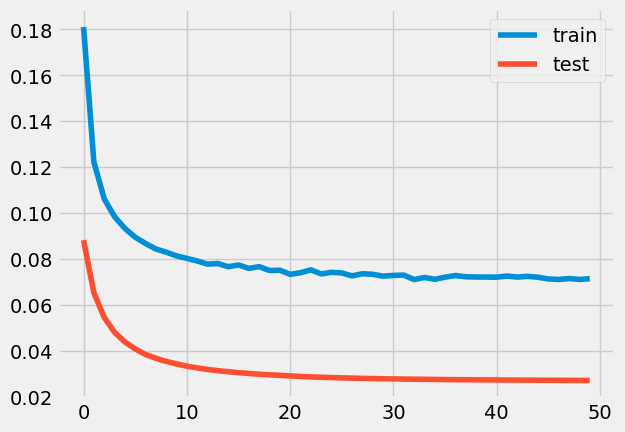

0.000625
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 13s 262ms/step - loss: 0.4133 - accuracy: 0.0000e+00 - val_loss: 0.3000 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 179ms/step - loss: 0.3014 - accuracy: 0.0000e+00 - val_loss: 0.2481 - val_accuracy: 0.0000e+00
Epoch 

Epoch 50/50
20/20 [==============================] - 4s 192ms/step - loss: 0.1148 - accuracy: 0.0000e+00 - val_loss: 0.0746 - val_accuracy: 0.0000e+00

loss: 7.46%



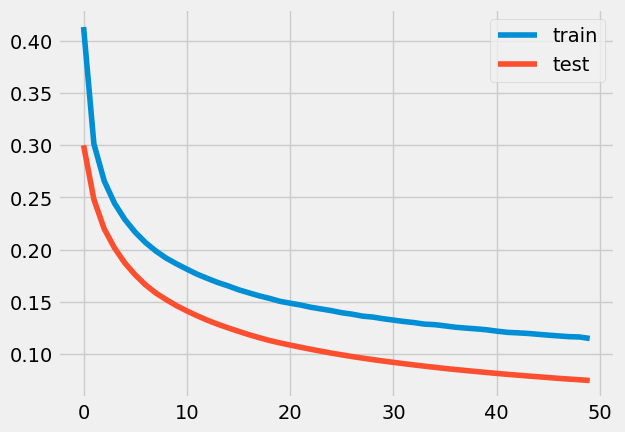

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 12s 279ms/step - loss: 0.1188 - accuracy: 5.3074e-04 - val_loss: 0.0390 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 184ms/step - loss: 0.0841 - accuracy: 0.0035 - val_loss: 0.0318 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=

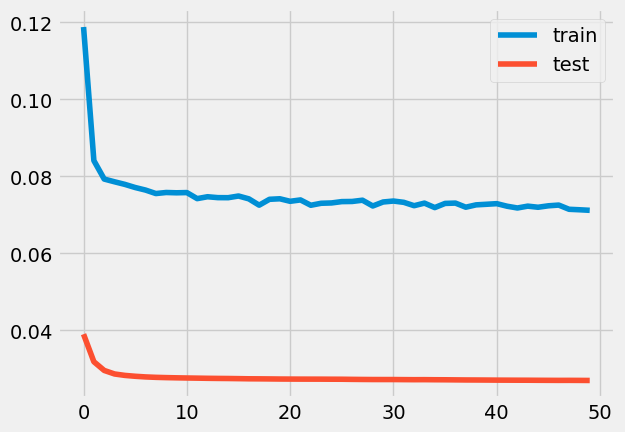

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 13s 304ms/step - loss: 0.3851 - accuracy: 0.0000e+00 - val_loss: 0.2855 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 203ms/step - loss: 0.2922 - accuracy: 0.0000e+00 - val_loss: 0.2404 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

Epoch 50/50
20/20 [==============================] - 4s 213ms/step - loss: 0.1202 - accuracy: 0.0000e+00 - val_loss: 0.0786 - val_accuracy: 0.0000e+00

loss: 7.86%



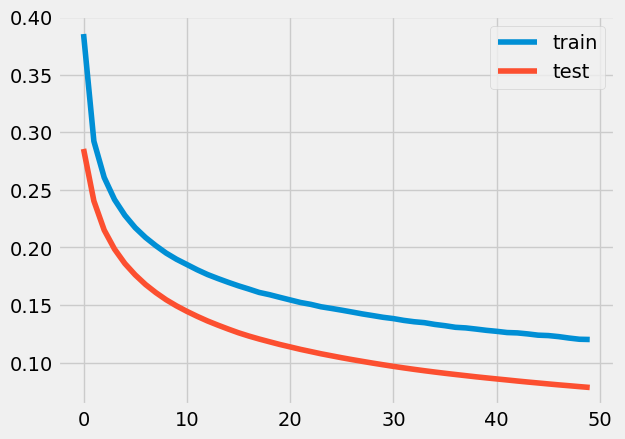

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 13s 284ms/step - loss: 0.2164 - accuracy: 0.0000e+00 - val_loss: 0.1144 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 189ms/step - loss: 0.1428 - accuracy: 0.0000e+00 - val_loss: 0.0849 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

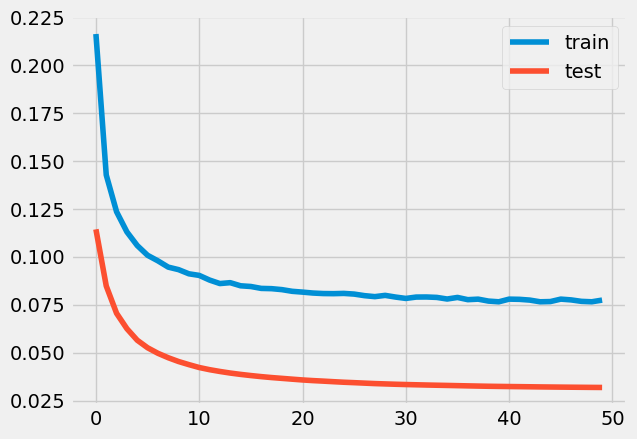

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 12s 246ms/step - loss: 0.2334 - accuracy: 0.0000e+00 - val_loss: 0.1355 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 162ms/step - loss: 0.1625 - accuracy: 0.0000e+00 - val_loss: 0.1062 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2


loss: 3.11%



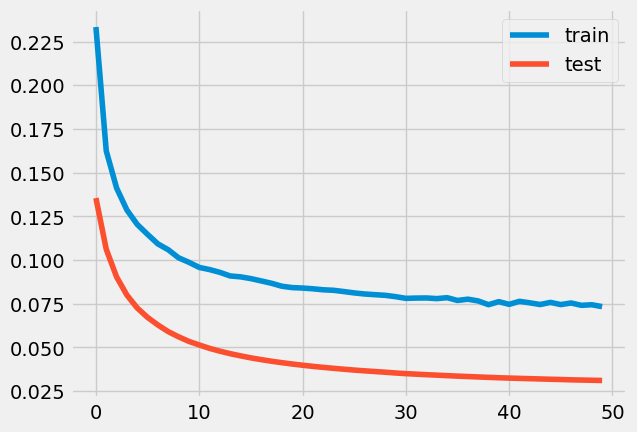

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 12s 248ms/step - loss: 0.1527 - accuracy: 0.0000e+00 - val_loss: 0.0732 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 154ms/step - loss: 0.1112 - accuracy: 3.6885e-05 - val_loss: 0.0574 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

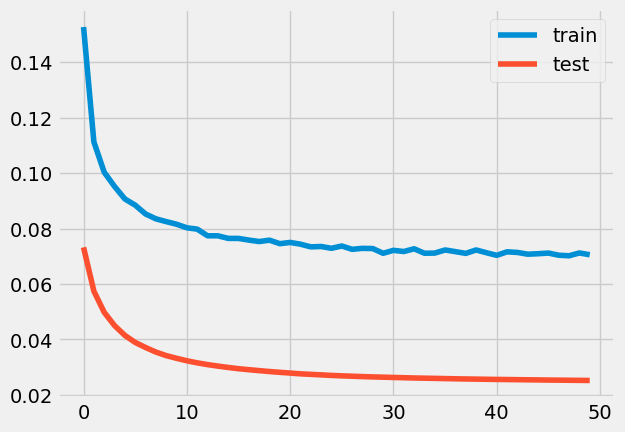

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 11s 242ms/step - loss: 0.1900 - accuracy: 0.0000e+00 - val_loss: 0.1029 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 142ms/step - loss: 0.1374 - accuracy: 0.0000e+00 - val_loss: 0.0822 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2


loss: 3.03%



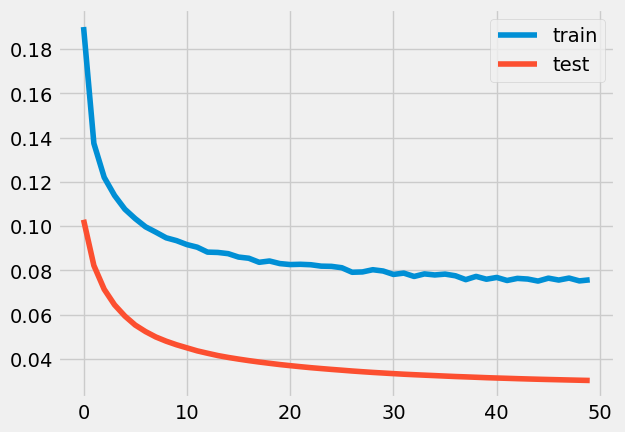

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 10s 229ms/step - loss: 0.1391 - accuracy: 0.0000e+00 - val_loss: 0.0526 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 3s 145ms/step - loss: 0.0945 - accuracy: 0.0011 - val_loss: 0.0407 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=

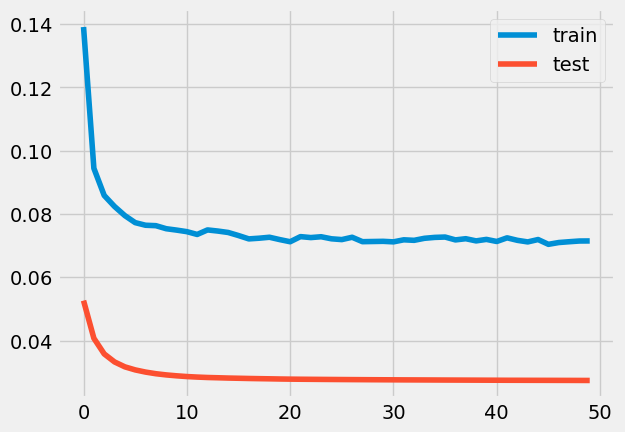

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 18s 354ms/step - loss: 0.2300 - accuracy: 0.0000e+00 - val_loss: 0.1193 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 219ms/step - loss: 0.1438 - accuracy: 0.0000e+00 - val_loss: 0.0855 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2


loss: 2.95%



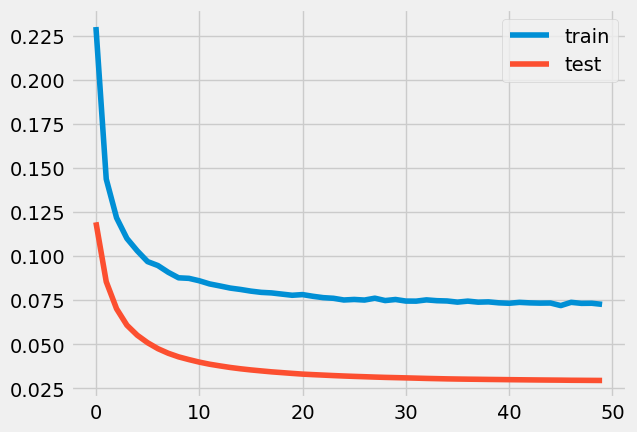

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 16s 331ms/step - loss: 0.1675 - accuracy: 0.0000e+00 - val_loss: 0.0792 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 225ms/step - loss: 0.1148 - accuracy: 2.8689e-05 - val_loss: 0.0589 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

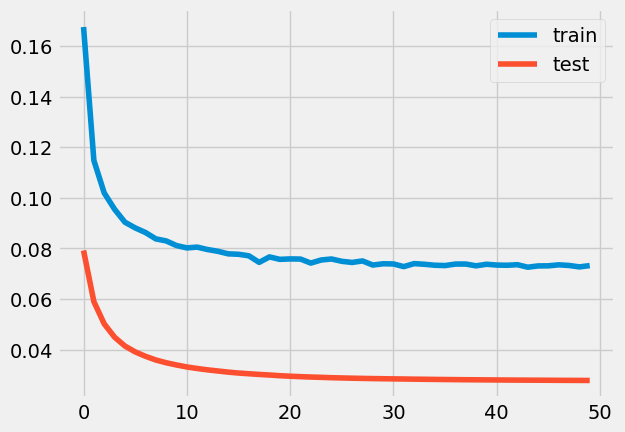

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 16s 317ms/step - loss: 0.2235 - accuracy: 0.0000e+00 - val_loss: 0.1241 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 199ms/step - loss: 0.1528 - accuracy: 0.0000e+00 - val_loss: 0.0953 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2


loss: 3.34%



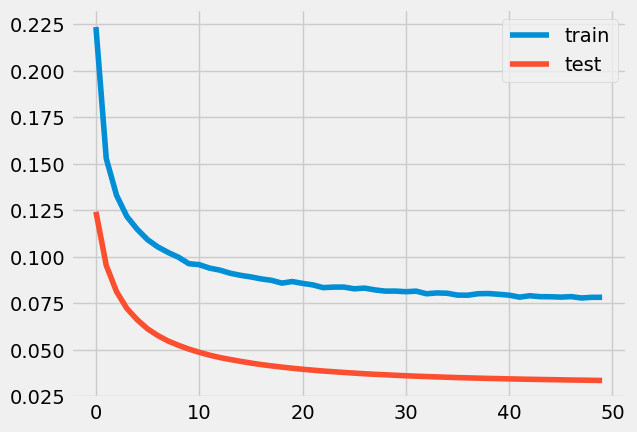

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 15s 327ms/step - loss: 0.1950 - accuracy: 0.0000e+00 - val_loss: 0.0985 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 200ms/step - loss: 0.1325 - accuracy: 0.0000e+00 - val_loss: 0.0751 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

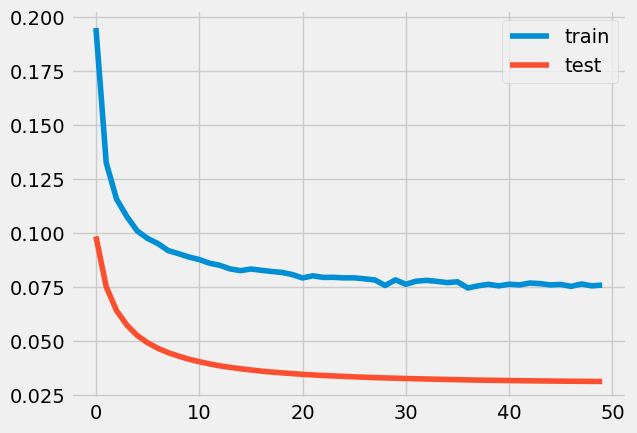

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 17s 307ms/step - loss: 0.1914 - accuracy: 0.0000e+00 - val_loss: 0.1061 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 196ms/step - loss: 0.1404 - accuracy: 0.0000e+00 - val_loss: 0.0848 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2


loss: 3.08%



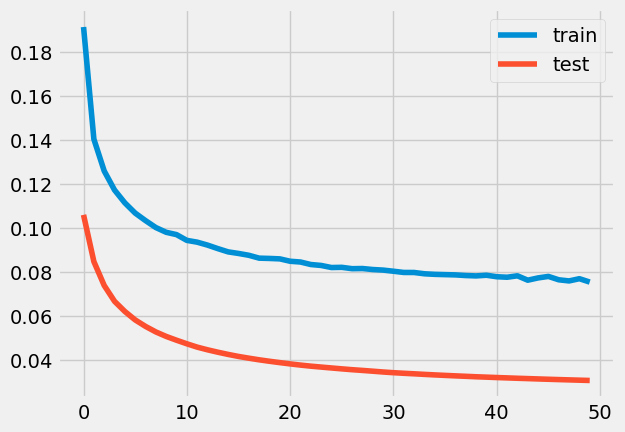

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 14s 310ms/step - loss: 0.2150 - accuracy: 0.0000e+00 - val_loss: 0.1203 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 186ms/step - loss: 0.1502 - accuracy: 0.0000e+00 - val_loss: 0.0926 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2


loss: 3.24%



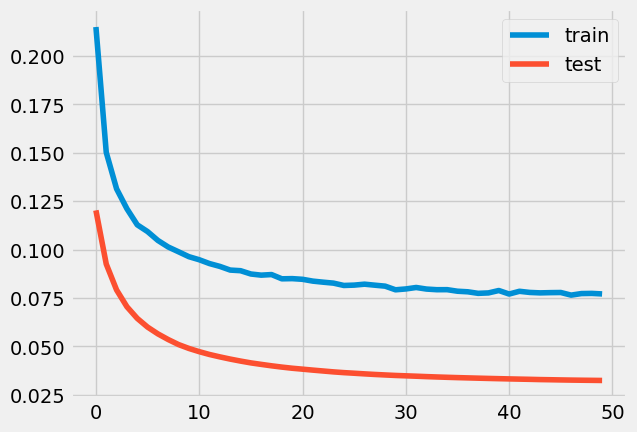

0.07356932565932997
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 16s 330ms/step - loss: 0.1754 - accuracy: 0.0000e+00 - val_loss: 0.0838 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 210ms/step - loss: 0.1190 - accuracy: 1.6393e-05 - val_loss: 0.0619 - val_accuracy: 0.0000


loss: 2.82%



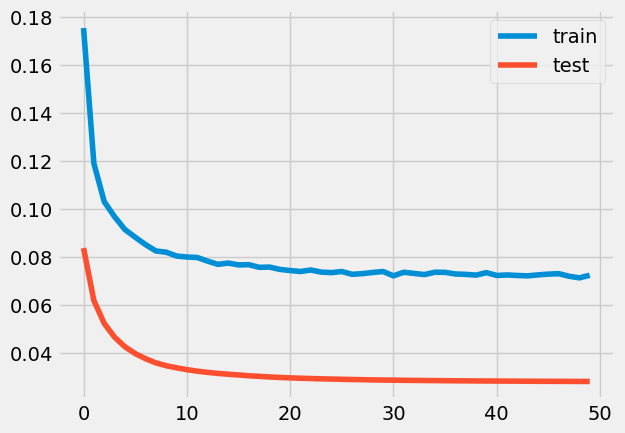

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 18s 342ms/step - loss: 0.3379 - accuracy: 0.0000e+00 - val_loss: 0.2240 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 201ms/step - loss: 0.2338 - accuracy: 0.0000e+00 - val_loss: 0.1767 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

Epoch 50/50
20/20 [==============================] - 5s 226ms/step - loss: 0.0917 - accuracy: 5.9836e-04 - val_loss: 0.0494 - val_accuracy: 0.0000e+00

loss: 4.94%



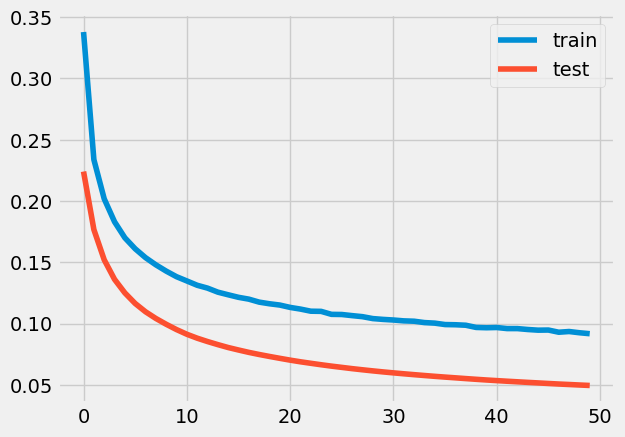

1.8357817092512934e-15
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 15s 336ms/step - loss: 0.1932 - accuracy: 0.0000e+00 - val_loss: 0.1028 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 5s 231ms/step - loss: 0.1357 - accuracy: 0.0000e+00 - val_loss: 0.0799 - val_accuracy: 0.0


loss: 3.11%



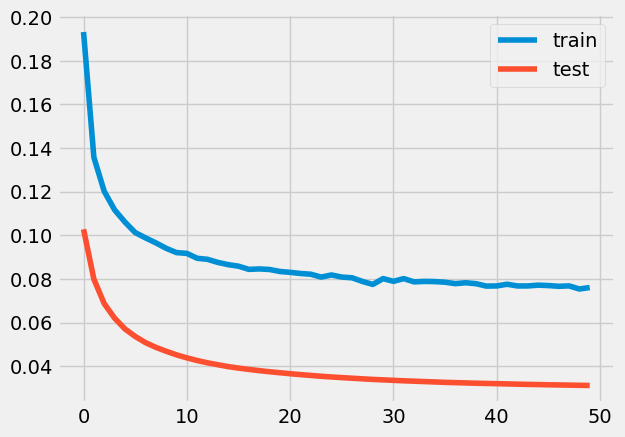

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 17s 346ms/step - loss: 0.1900 - accuracy: 0.0000e+00 - val_loss: 0.0969 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 221ms/step - loss: 0.1305 - accuracy: 0.0000e+00 - val_loss: 0.0743 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2


loss: 3.02%



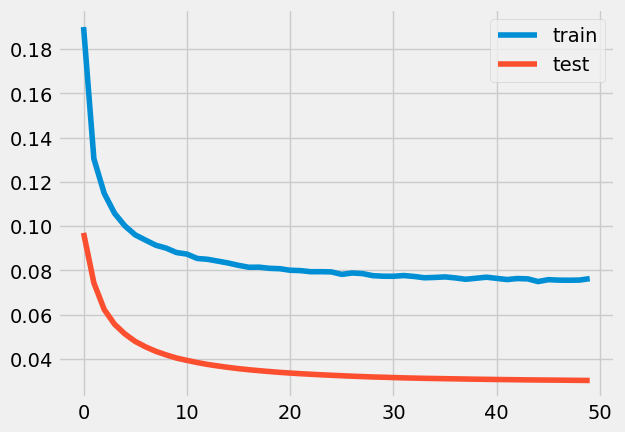

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 17s 375ms/step - loss: 0.2261 - accuracy: 0.0000e+00 - val_loss: 0.1144 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 5s 229ms/step - loss: 0.1418 - accuracy: 0.0000e+00 - val_loss: 0.0847 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2


loss: 3.10%



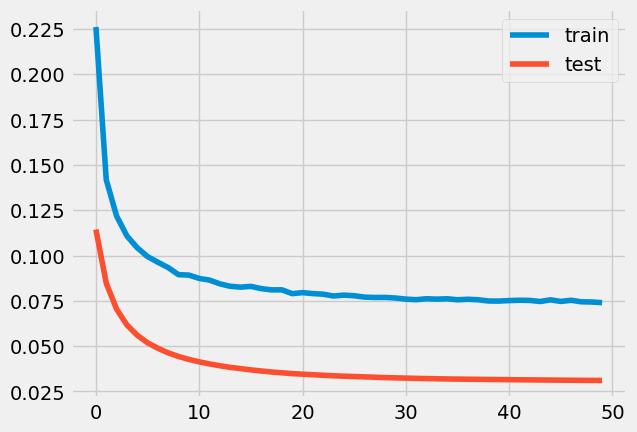

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 16s 339ms/step - loss: 0.1010 - accuracy: 0.0025 - val_loss: 0.0320 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 211ms/step - loss: 0.0779 - accuracy: 0.0058 - val_loss: 0.0298 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=====

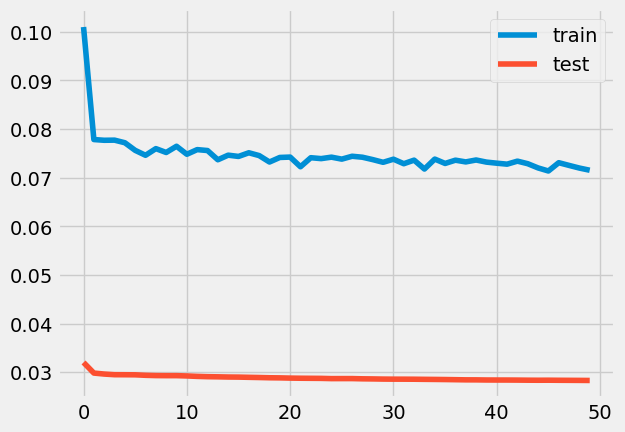

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 14s 298ms/step - loss: 0.2660 - accuracy: 0.0000e+00 - val_loss: 0.1741 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 190ms/step - loss: 0.1975 - accuracy: 0.0000e+00 - val_loss: 0.1434 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

Epoch 50/50
20/20 [==============================] - 5s 230ms/step - loss: 0.0902 - accuracy: 5.7377e-04 - val_loss: 0.0471 - val_accuracy: 0.0000e+00

loss: 4.71%



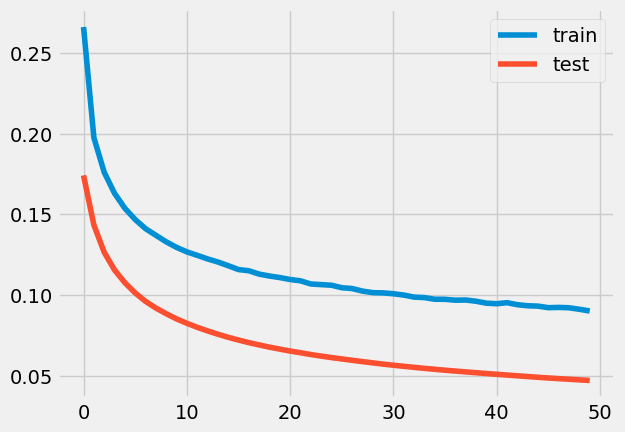

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 20s 374ms/step - loss: 0.2162 - accuracy: 0.0000e+00 - val_loss: 0.1202 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 225ms/step - loss: 0.1506 - accuracy: 0.0000e+00 - val_loss: 0.0945 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

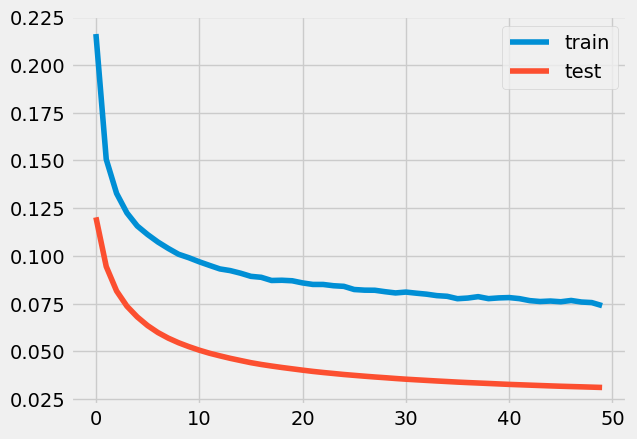

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 15s 333ms/step - loss: 0.1095 - accuracy: 8.4426e-04 - val_loss: 0.0351 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 215ms/step - loss: 0.0819 - accuracy: 0.0038 - val_loss: 0.0300 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=

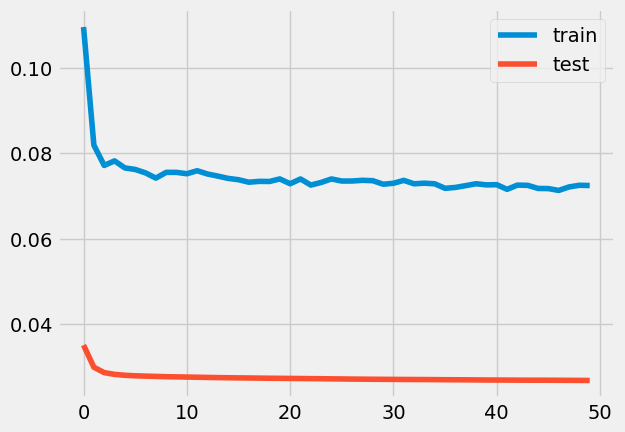

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 17s 334ms/step - loss: 0.2777 - accuracy: 0.0000e+00 - val_loss: 0.1793 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 213ms/step - loss: 0.2024 - accuracy: 0.0000e+00 - val_loss: 0.1471 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

Epoch 50/50
20/20 [==============================] - 4s 221ms/step - loss: 0.0957 - accuracy: 4.7131e-04 - val_loss: 0.0503 - val_accuracy: 0.0000e+00

loss: 5.03%



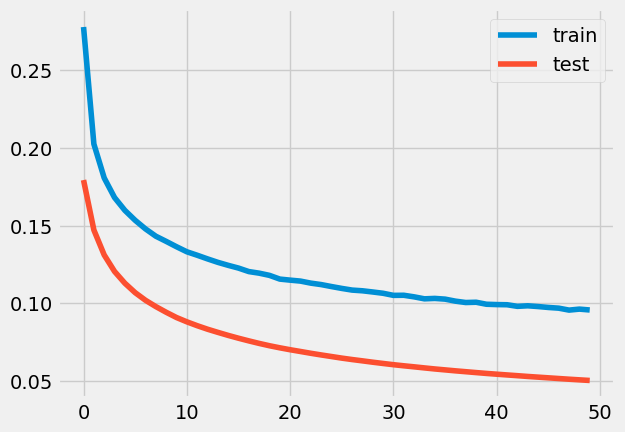

5.1361117521229134e-17
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 15s 335ms/step - loss: 0.1879 - accuracy: 0.0000e+00 - val_loss: 0.1019 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 215ms/step - loss: 0.1363 - accuracy: 0.0000e+00 - val_loss: 0.0813 - val_accuracy: 0.0


loss: 2.99%



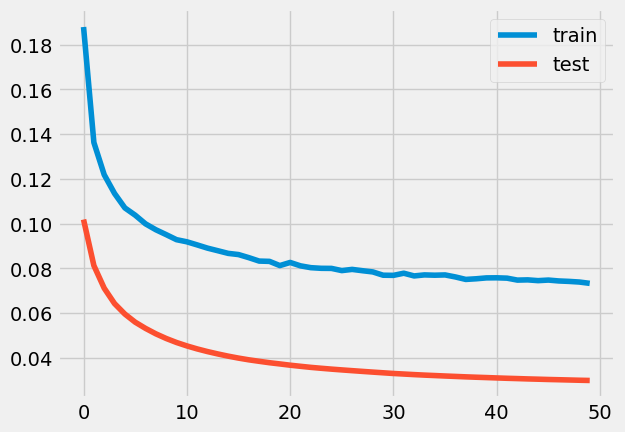

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 16s 354ms/step - loss: 0.1943 - accuracy: 0.0000e+00 - val_loss: 0.0966 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 5s 229ms/step - loss: 0.1288 - accuracy: 0.0000e+00 - val_loss: 0.0726 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

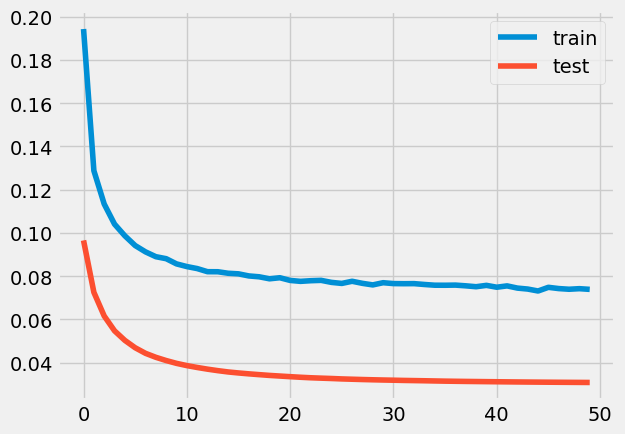

0.21652651006738932
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 14s 358ms/step - loss: 0.2177 - accuracy: 0.0000e+00 - val_loss: 0.1224 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 5s 233ms/step - loss: 0.1490 - accuracy: 0.0000e+00 - val_loss: 0.0919 - val_accuracy: 0.0000


loss: 2.87%



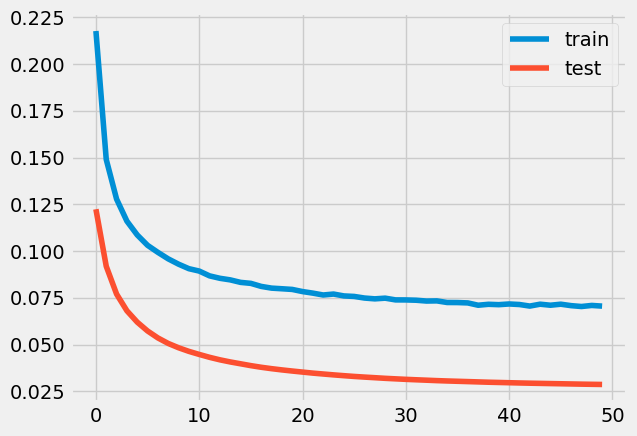

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 15s 352ms/step - loss: 0.2170 - accuracy: 0.0000e+00 - val_loss: 0.1198 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 212ms/step - loss: 0.1492 - accuracy: 0.0000e+00 - val_loss: 0.0923 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2


loss: 3.20%



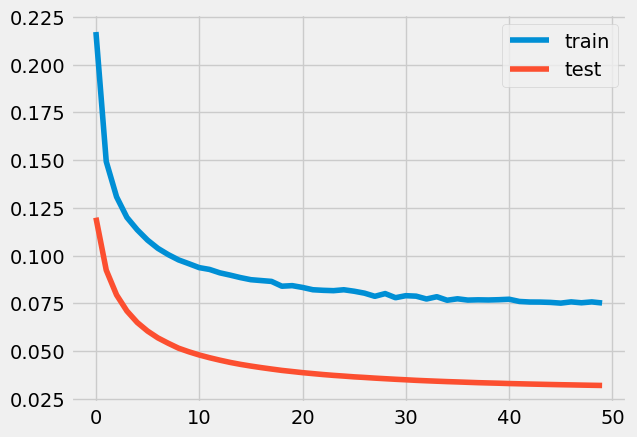

0.005402534601229491
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 15s 318ms/step - loss: 0.1832 - accuracy: 0.0000e+00 - val_loss: 0.0894 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 200ms/step - loss: 0.1234 - accuracy: 0.0000e+00 - val_loss: 0.0674 - val_accuracy: 0.000


loss: 3.00%



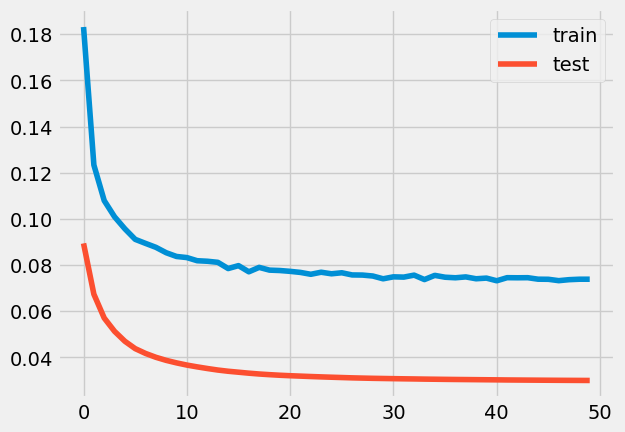

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 16s 319ms/step - loss: 0.2191 - accuracy: 0.0000e+00 - val_loss: 0.1238 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 195ms/step - loss: 0.1533 - accuracy: 0.0000e+00 - val_loss: 0.0968 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

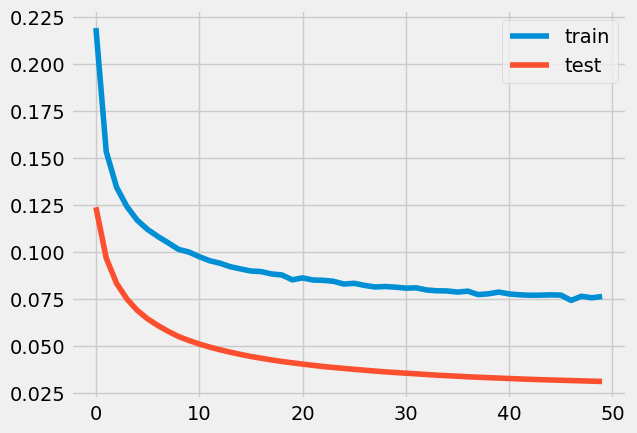

0.15065671282714152
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 14s 311ms/step - loss: 0.1620 - accuracy: 0.0000e+00 - val_loss: 0.0701 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 197ms/step - loss: 0.1088 - accuracy: 2.0902e-04 - val_loss: 0.0529 - val_accuracy: 0.0000


loss: 2.69%



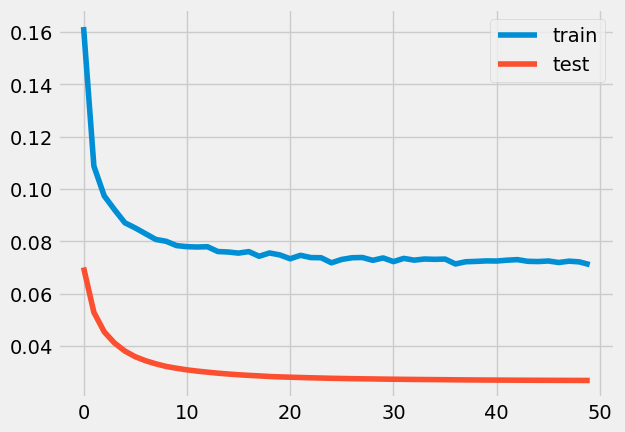

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 13s 306ms/step - loss: 0.2230 - accuracy: 0.0000e+00 - val_loss: 0.1280 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 191ms/step - loss: 0.1573 - accuracy: 0.0000e+00 - val_loss: 0.1007 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2


loss: 3.21%



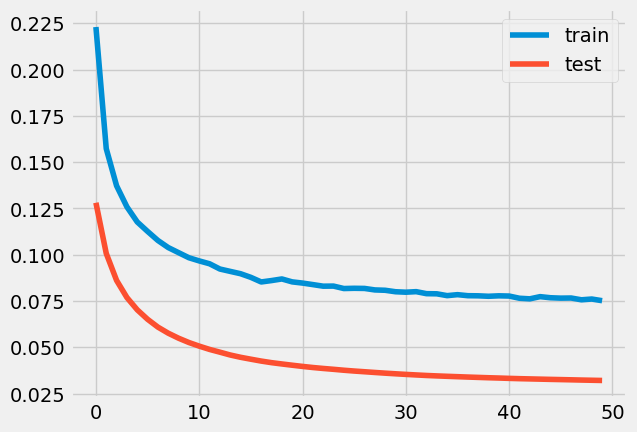

0.00024593869466783293
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 14s 308ms/step - loss: 0.3299 - accuracy: 0.0000e+00 - val_loss: 0.2356 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 189ms/step - loss: 0.2518 - accuracy: 0.0000e+00 - val_loss: 0.1998 - val_accuracy: 0.0

Epoch 50/50
20/20 [==============================] - 4s 191ms/step - loss: 0.1188 - accuracy: 0.0000e+00 - val_loss: 0.0758 - val_accuracy: 0.0000e+00

loss: 7.58%



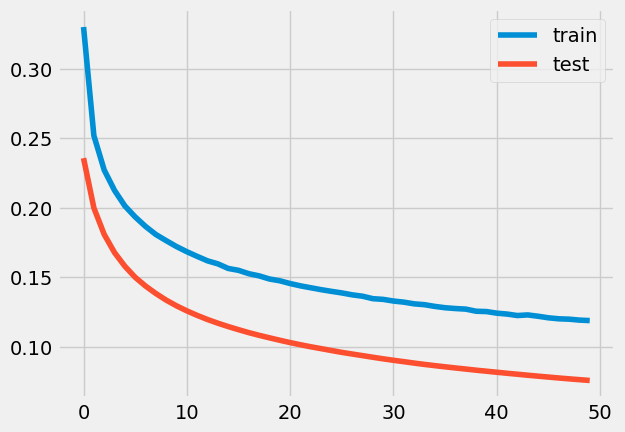

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 12s 276ms/step - loss: 0.2058 - accuracy: 0.0000e+00 - val_loss: 0.1142 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 176ms/step - loss: 0.1453 - accuracy: 0.0000e+00 - val_loss: 0.0882 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2


loss: 2.99%



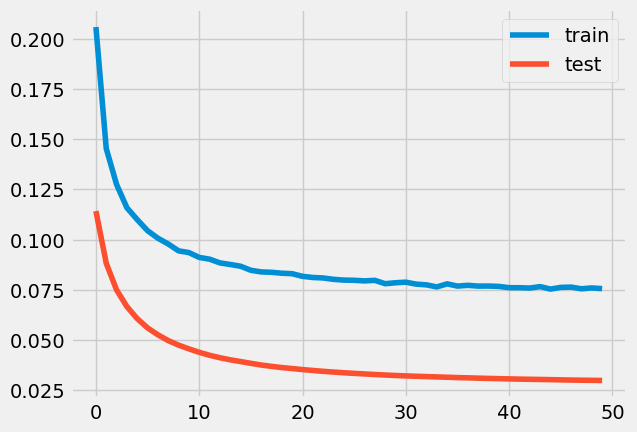

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 16s 344ms/step - loss: 0.2141 - accuracy: 0.0000e+00 - val_loss: 0.1282 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 219ms/step - loss: 0.1580 - accuracy: 0.0000e+00 - val_loss: 0.1027 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

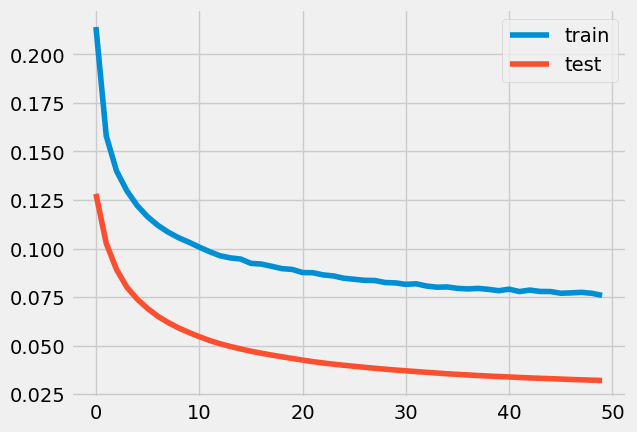

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 15s 310ms/step - loss: 0.1901 - accuracy: 0.0000e+00 - val_loss: 0.0995 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 180ms/step - loss: 0.1351 - accuracy: 0.0000e+00 - val_loss: 0.0781 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2


loss: 2.96%



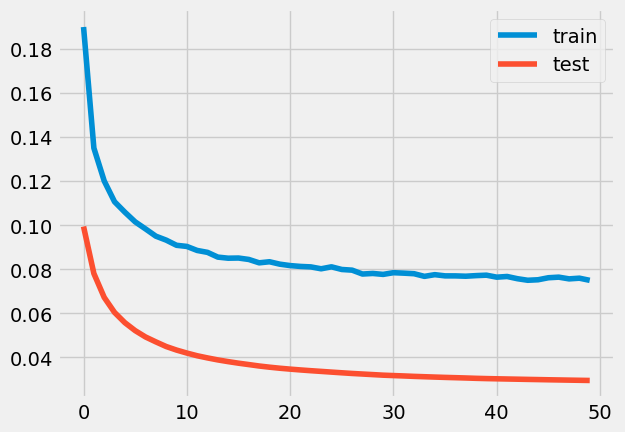

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 14s 285ms/step - loss: 0.2043 - accuracy: 0.0000e+00 - val_loss: 0.1088 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 179ms/step - loss: 0.1397 - accuracy: 0.0000e+00 - val_loss: 0.0839 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2


loss: 3.02%



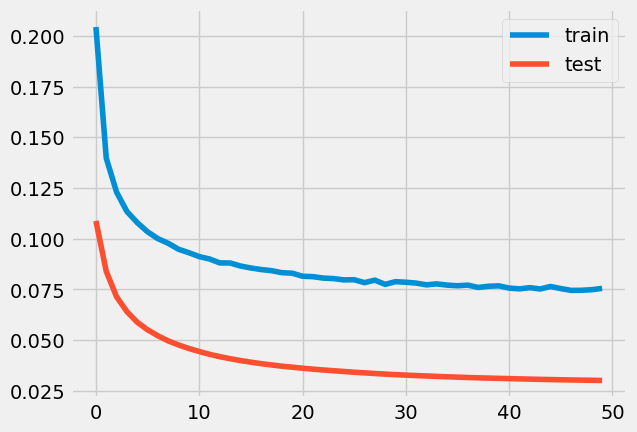

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 15s 314ms/step - loss: 0.2438 - accuracy: 0.0000e+00 - val_loss: 0.1395 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 193ms/step - loss: 0.1650 - accuracy: 0.0000e+00 - val_loss: 0.1082 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

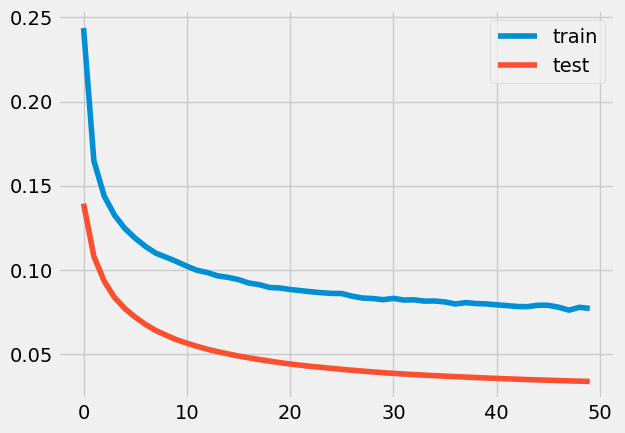

0.0023344605742737215
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 16s 314ms/step - loss: 0.1509 - accuracy: 0.0000e+00 - val_loss: 0.0650 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 219ms/step - loss: 0.1040 - accuracy: 2.2131e-04 - val_loss: 0.0493 - val_accuracy: 0.00

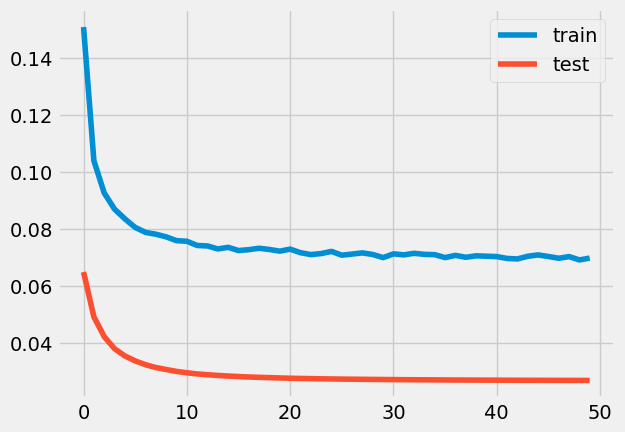

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 15s 343ms/step - loss: 0.2537 - accuracy: 0.0000e+00 - val_loss: 0.1460 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 5s 234ms/step - loss: 0.1685 - accuracy: 0.0000e+00 - val_loss: 0.1101 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

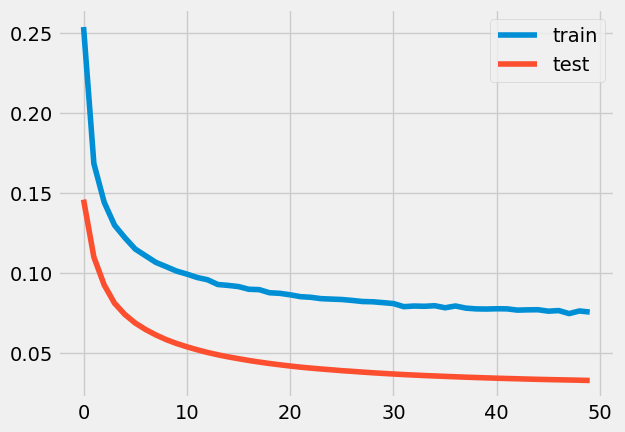

6.039972910597009e-05
0.0003125
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 14s 314ms/step - loss: 0.2662 - accuracy: 0.0000e+00 - val_loss: 0.1802 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 214ms/step - loss: 0.2059 - accuracy: 0.0000e+00 - val_loss: 0.1518 - val_accu

Epoch 50/50
20/20 [==============================] - 5s 227ms/step - loss: 0.1017 - accuracy: 2.7049e-04 - val_loss: 0.0571 - val_accuracy: 0.0000e+00

loss: 5.71%



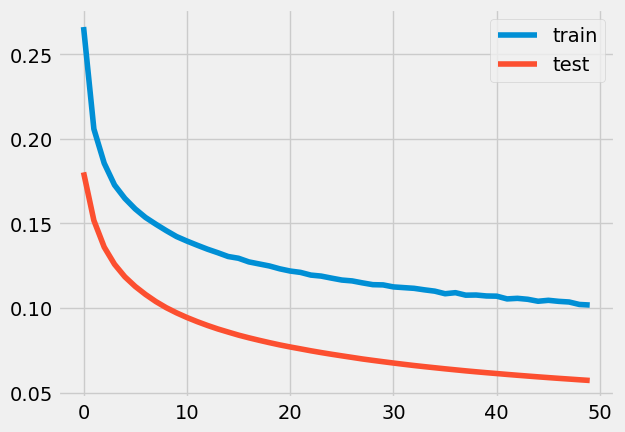

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 15s 345ms/step - loss: 0.2123 - accuracy: 0.0000e+00 - val_loss: 0.1131 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 223ms/step - loss: 0.1419 - accuracy: 0.0000e+00 - val_loss: 0.0856 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2


loss: 2.81%



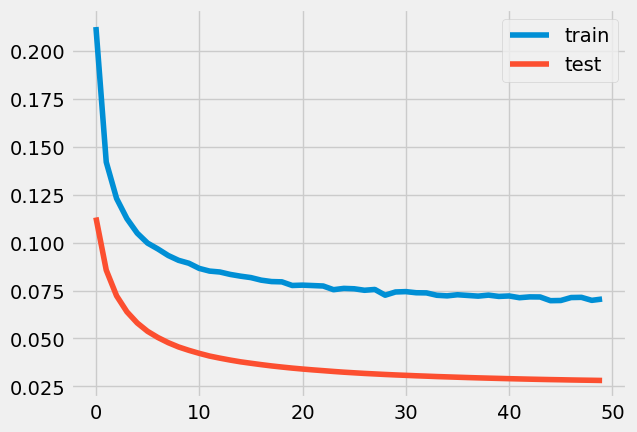

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 16s 338ms/step - loss: 0.2420 - accuracy: 0.0000e+00 - val_loss: 0.1511 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 208ms/step - loss: 0.1787 - accuracy: 0.0000e+00 - val_loss: 0.1241 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

Epoch 50/50
20/20 [==============================] - 4s 221ms/step - loss: 0.0831 - accuracy: 9.4467e-04 - val_loss: 0.0394 - val_accuracy: 0.0000e+00

loss: 3.94%



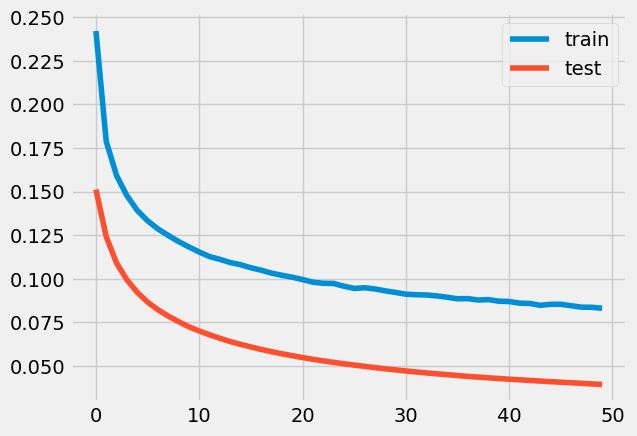

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 15s 303ms/step - loss: 0.2849 - accuracy: 0.0000e+00 - val_loss: 0.1808 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 185ms/step - loss: 0.2023 - accuracy: 0.0000e+00 - val_loss: 0.1469 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

Epoch 50/50
20/20 [==============================] - 4s 198ms/step - loss: 0.0902 - accuracy: 7.9098e-04 - val_loss: 0.0457 - val_accuracy: 0.0000e+00

loss: 4.57%



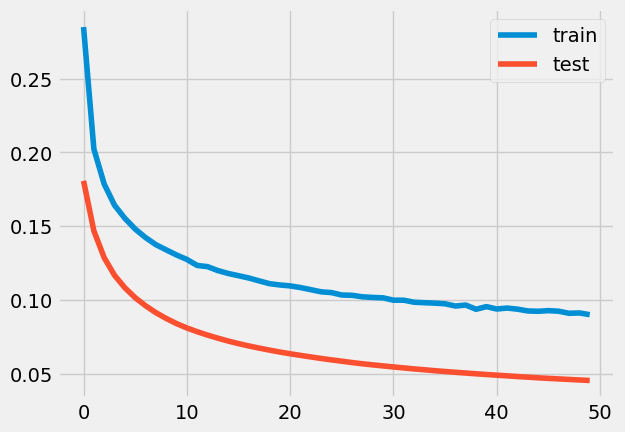

1.9800287798015695e-09
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 15s 309ms/step - loss: 0.1120 - accuracy: 6.6393e-04 - val_loss: 0.0384 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 184ms/step - loss: 0.0831 - accuracy: 0.0033 - val_loss: 0.0321 - val_accuracy: 0.0000e

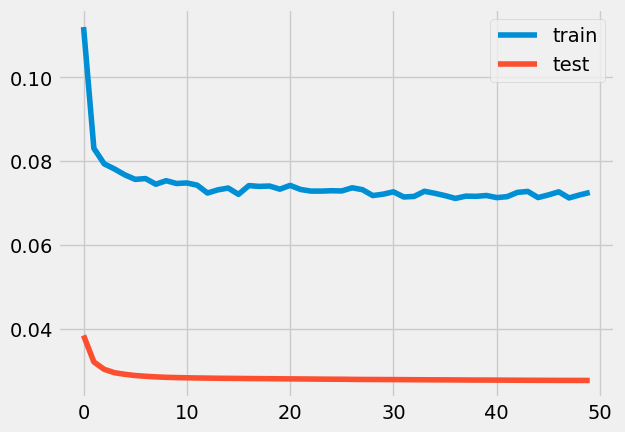

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 16s 342ms/step - loss: 0.1465 - accuracy: 0.0000e+00 - val_loss: 0.0572 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 205ms/step - loss: 0.0956 - accuracy: 6.7008e-04 - val_loss: 0.0420 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

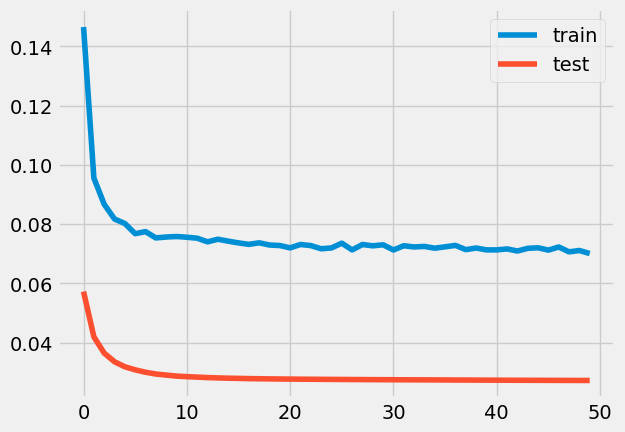

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 19s 343ms/step - loss: 0.1305 - accuracy: 1.8852e-04 - val_loss: 0.0465 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 5s 234ms/step - loss: 0.0904 - accuracy: 0.0029 - val_loss: 0.0371 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [=

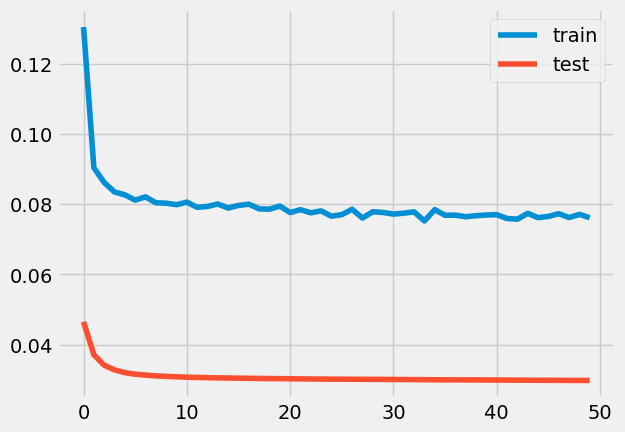

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 17s 328ms/step - loss: 0.1570 - accuracy: 0.0000e+00 - val_loss: 0.0701 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 4s 223ms/step - loss: 0.1074 - accuracy: 2.0492e-05 - val_loss: 0.0516 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

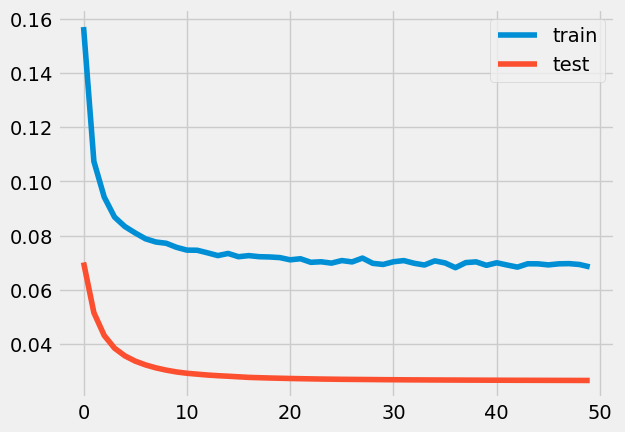

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 14s 336ms/step - loss: 0.1389 - accuracy: 3.2787e-05 - val_loss: 0.0592 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 5s 228ms/step - loss: 0.1003 - accuracy: 5.9221e-04 - val_loss: 0.0460 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

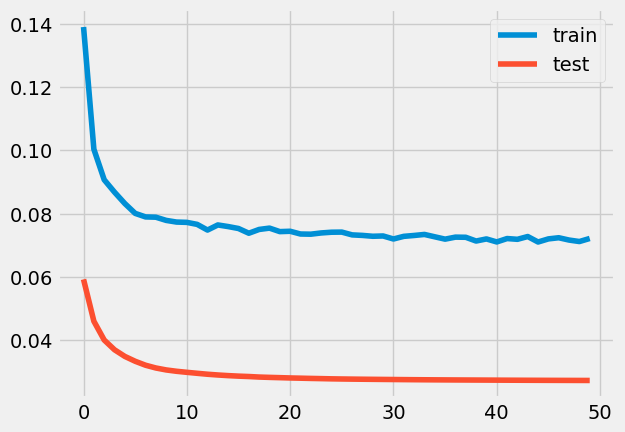

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 14s 327ms/step - loss: 0.1927 - accuracy: 0.0000e+00 - val_loss: 0.0891 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 5s 232ms/step - loss: 0.1204 - accuracy: 0.0000e+00 - val_loss: 0.0638 - val_accuracy: 0.0000e+00
Epoch 3/50
20/2

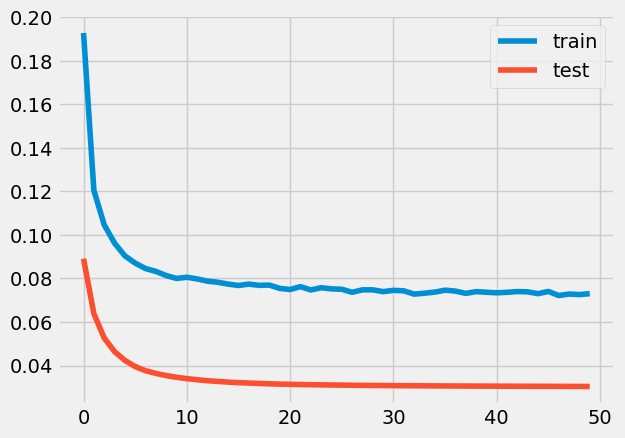

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 8s 162ms/step - loss: 0.2249 - accuracy: 0.0000e+00 - val_loss: 0.1191 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 96ms/step - loss: 0.1452 - accuracy: 0.0000e+00 - val_loss: 0.0880 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 

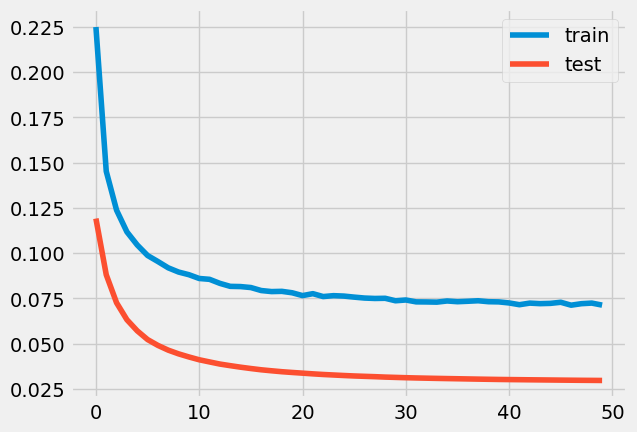

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 108ms/step - loss: 0.3197 - accuracy: 0.0000e+00 - val_loss: 0.2201 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 69ms/step - loss: 0.2358 - accuracy: 0.0000e+00 - val_loss: 0.1817 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 

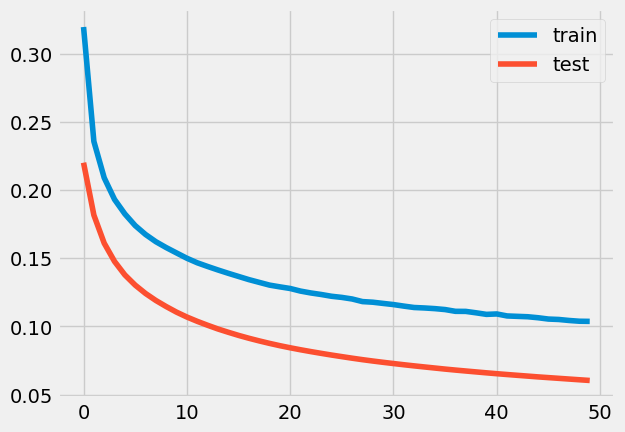

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 114ms/step - loss: 0.1205 - accuracy: 7.5820e-05 - val_loss: 0.0439 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 80ms/step - loss: 0.0895 - accuracy: 0.0022 - val_loss: 0.0352 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [===

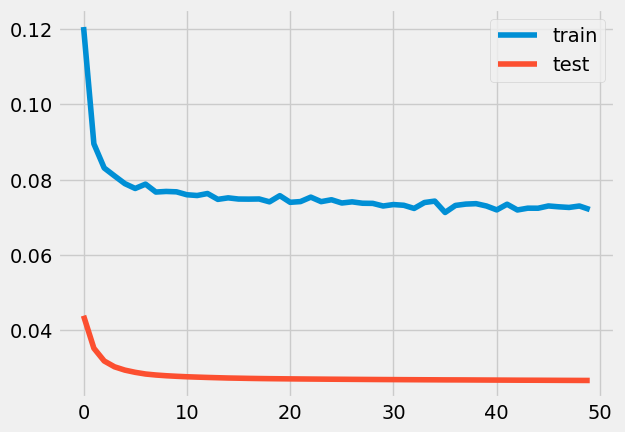

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 120ms/step - loss: 0.3042 - accuracy: 0.0000e+00 - val_loss: 0.2017 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 79ms/step - loss: 0.2199 - accuracy: 0.0000e+00 - val_loss: 0.1653 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 

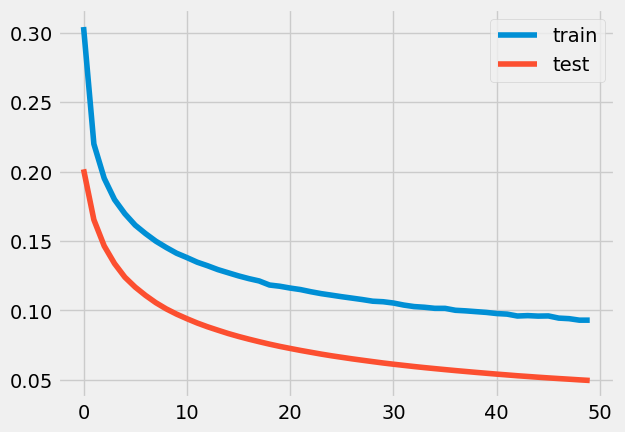

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 133ms/step - loss: 0.4307 - accuracy: 0.0000e+00 - val_loss: 0.3256 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 83ms/step - loss: 0.3283 - accuracy: 0.0000e+00 - val_loss: 0.2789 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 

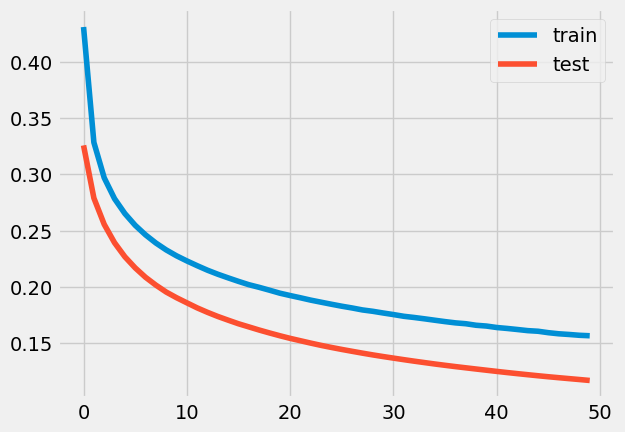

1.1815955438993305e-94
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 117ms/step - loss: 0.1260 - accuracy: 8.1557e-04 - val_loss: 0.0408 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 85ms/step - loss: 0.0847 - accuracy: 0.0026 - val_loss: 0.0329 - val_accuracy: 0.0000e+0

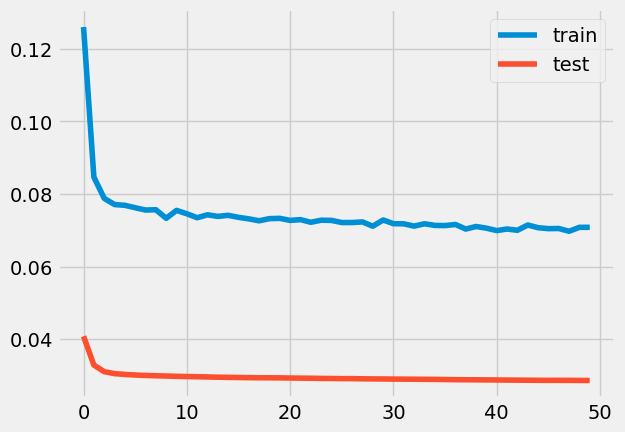

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 128ms/step - loss: 0.1586 - accuracy: 0.0000e+00 - val_loss: 0.0661 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 81ms/step - loss: 0.1039 - accuracy: 3.7295e-04 - val_loss: 0.0491 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 

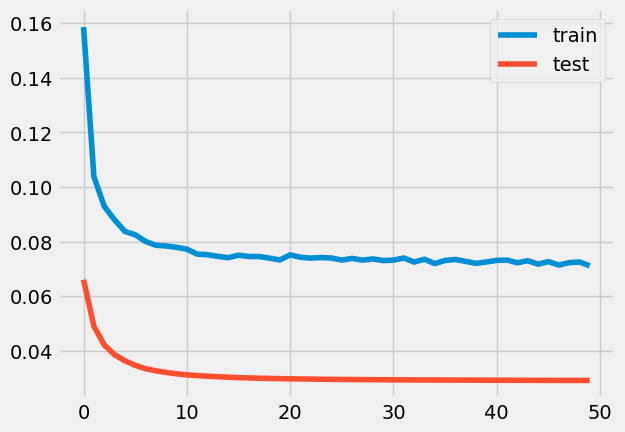

0.20006542674326247
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 120ms/step - loss: 0.0897 - accuracy: 0.0041 - val_loss: 0.0278 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 80ms/step - loss: 0.0755 - accuracy: 0.0054 - val_loss: 0.0277 - val_accuracy: 0.0000e+00
Epoch

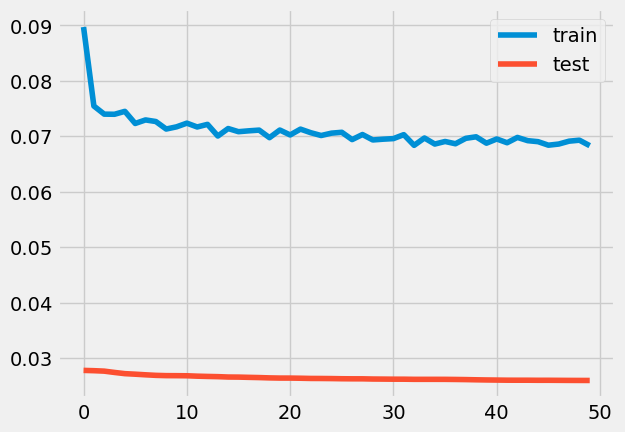

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 107ms/step - loss: 0.2216 - accuracy: 0.0000e+00 - val_loss: 0.1230 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 74ms/step - loss: 0.1507 - accuracy: 0.0000e+00 - val_loss: 0.0929 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 

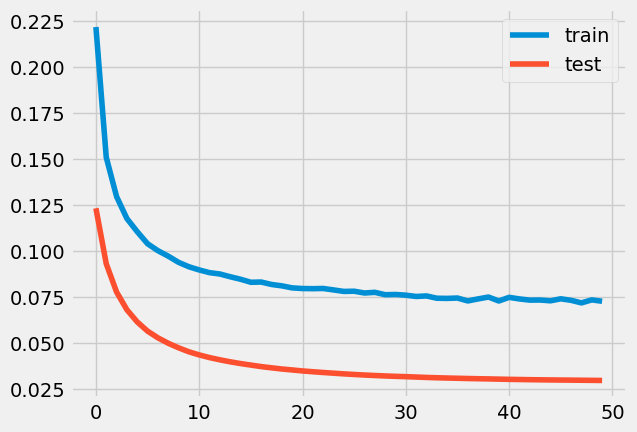

1.6986399674296882e-05
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 106ms/step - loss: 0.1771 - accuracy: 0.0000e+00 - val_loss: 0.0819 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 68ms/step - loss: 0.1162 - accuracy: 6.1475e-05 - val_loss: 0.0591 - val_accuracy: 0.000

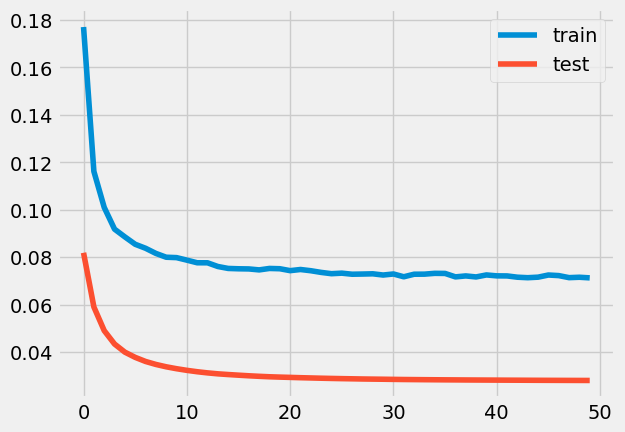

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 119ms/step - loss: 0.2030 - accuracy: 0.0000e+00 - val_loss: 0.1124 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 73ms/step - loss: 0.1437 - accuracy: 0.0000e+00 - val_loss: 0.0880 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 

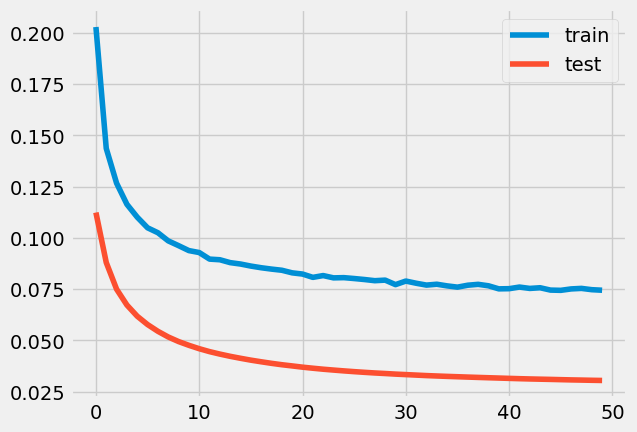

0.0005916625906805701
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 122ms/step - loss: 0.1281 - accuracy: 2.5205e-04 - val_loss: 0.0484 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 81ms/step - loss: 0.0926 - accuracy: 0.0010 - val_loss: 0.0376 - val_accuracy: 0.0000e+00

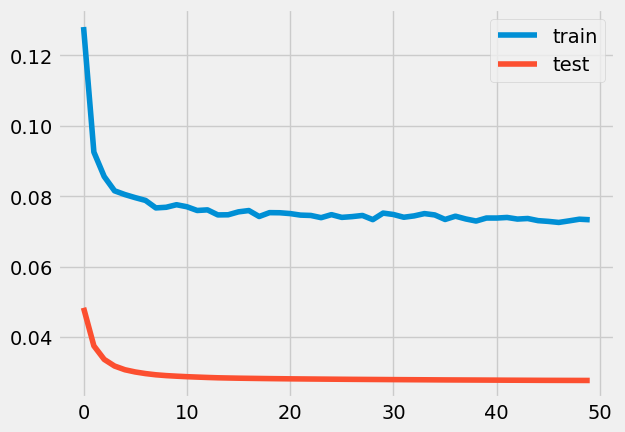

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 119ms/step - loss: 0.1421 - accuracy: 8.6066e-05 - val_loss: 0.0528 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 75ms/step - loss: 0.0951 - accuracy: 9.3033e-04 - val_loss: 0.0396 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 

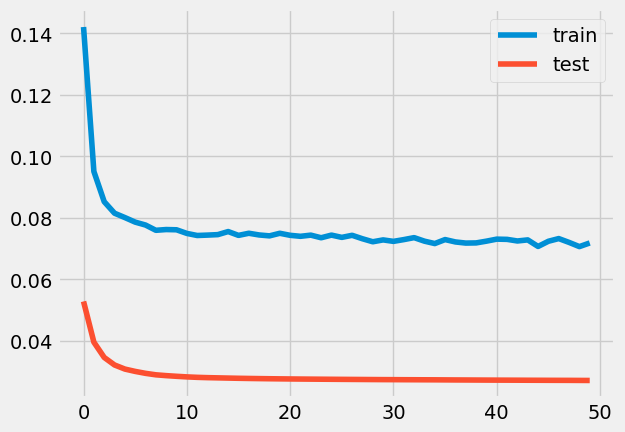

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 114ms/step - loss: 0.1307 - accuracy: 1.1475e-04 - val_loss: 0.0460 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 77ms/step - loss: 0.0860 - accuracy: 0.0015 - val_loss: 0.0335 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [===

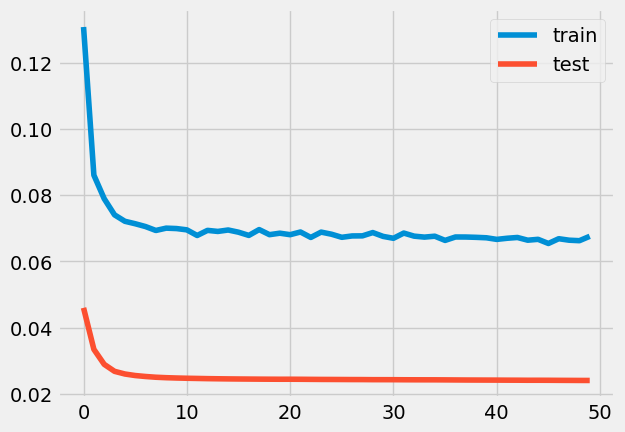

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 115ms/step - loss: 0.2468 - accuracy: 0.0000e+00 - val_loss: 0.1316 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 72ms/step - loss: 0.1549 - accuracy: 0.0000e+00 - val_loss: 0.0968 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 

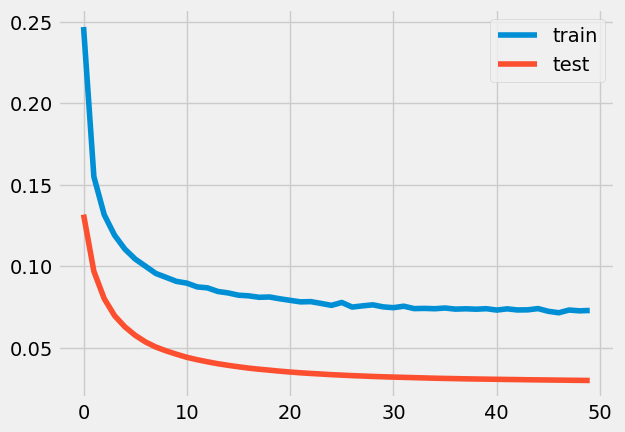

1.4125118311276029e-08
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 118ms/step - loss: 0.2560 - accuracy: 0.0000e+00 - val_loss: 0.1601 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 71ms/step - loss: 0.1840 - accuracy: 0.0000e+00 - val_loss: 0.1296 - val_accuracy: 0.000

20/20 [==============================] - 2s 76ms/step - loss: 0.0843 - accuracy: 8.5451e-04 - val_loss: 0.0408 - val_accuracy: 0.0000e+00

loss: 4.08%



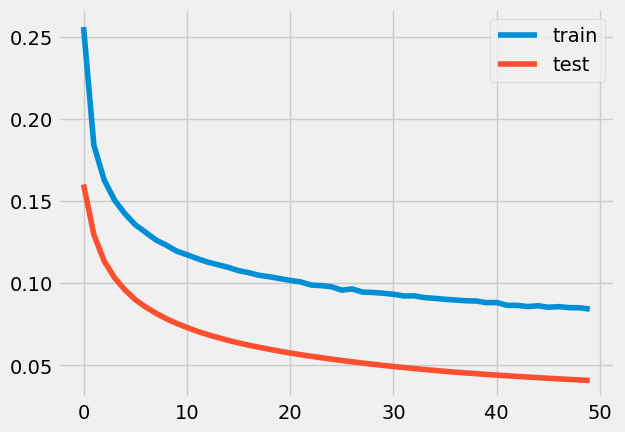

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 111ms/step - loss: 0.1691 - accuracy: 0.0000e+00 - val_loss: 0.0876 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 65ms/step - loss: 0.1257 - accuracy: 2.2541e-05 - val_loss: 0.0696 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 

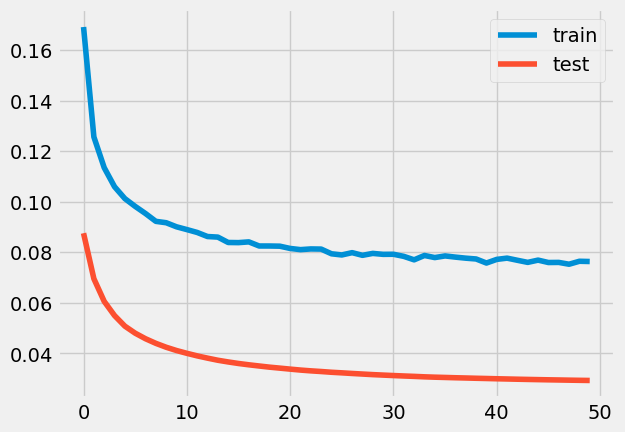

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 125ms/step - loss: 0.2757 - accuracy: 0.0000e+00 - val_loss: 0.1697 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 75ms/step - loss: 0.1911 - accuracy: 0.0000e+00 - val_loss: 0.1338 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 

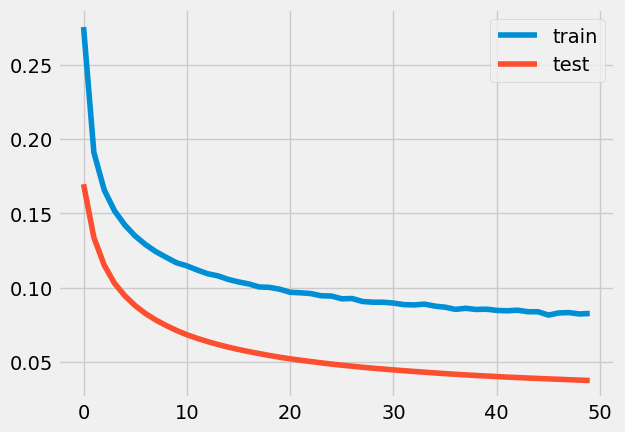

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 116ms/step - loss: 0.2177 - accuracy: 0.0000e+00 - val_loss: 0.1301 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 72ms/step - loss: 0.1605 - accuracy: 0.0000e+00 - val_loss: 0.1049 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 


loss: 3.55%



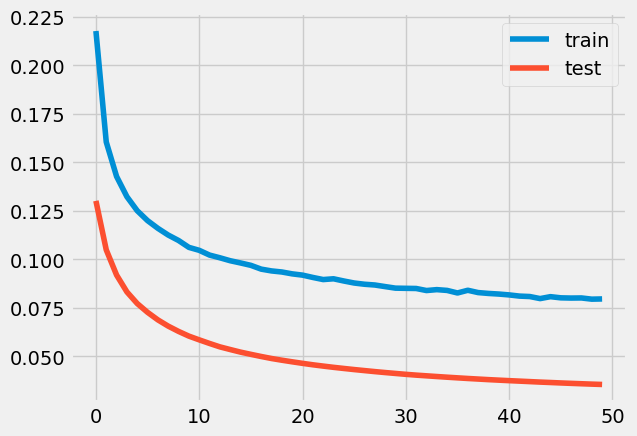

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 127ms/step - loss: 0.2991 - accuracy: 0.0000e+00 - val_loss: 0.2021 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 85ms/step - loss: 0.2226 - accuracy: 0.0000e+00 - val_loss: 0.1691 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 

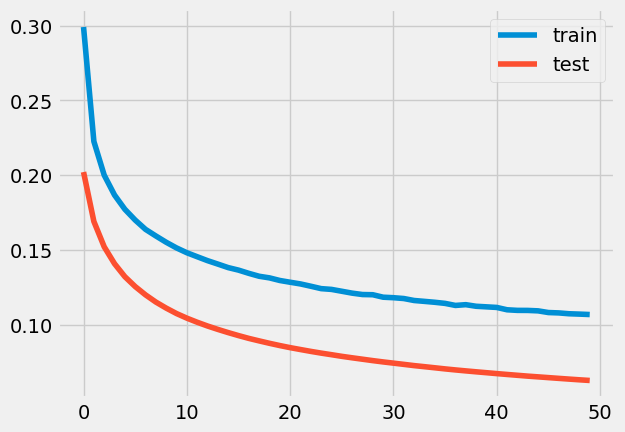

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 130ms/step - loss: 0.4702 - accuracy: 0.0000e+00 - val_loss: 0.3590 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 85ms/step - loss: 0.3547 - accuracy: 0.0000e+00 - val_loss: 0.3053 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 

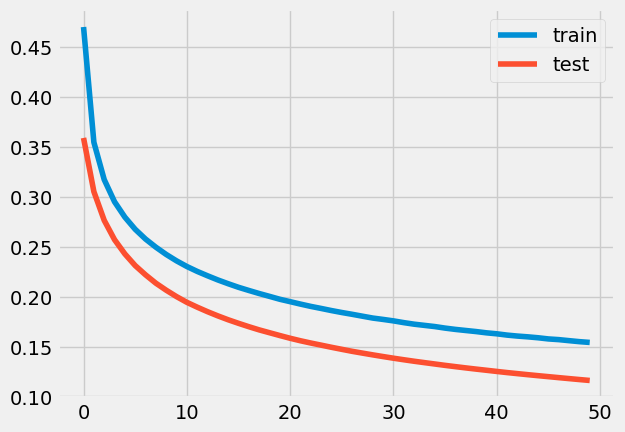

8.236369024898784e-75
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 126ms/step - loss: 0.2447 - accuracy: 0.0000e+00 - val_loss: 0.1384 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 83ms/step - loss: 0.1634 - accuracy: 0.0000e+00 - val_loss: 0.1043 - val_accuracy: 0.0000

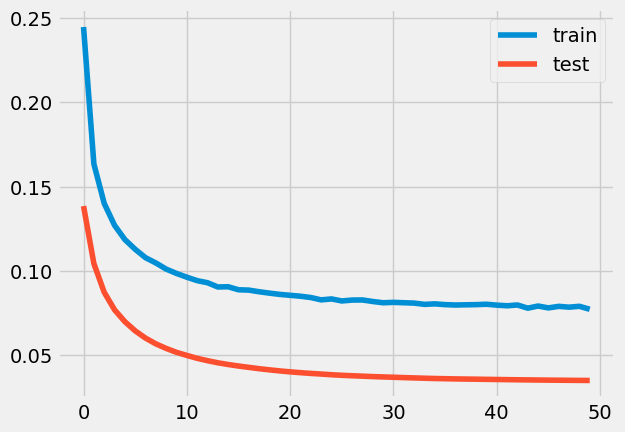

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 124ms/step - loss: 0.2046 - accuracy: 0.0000e+00 - val_loss: 0.1154 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 78ms/step - loss: 0.1479 - accuracy: 0.0000e+00 - val_loss: 0.0919 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 

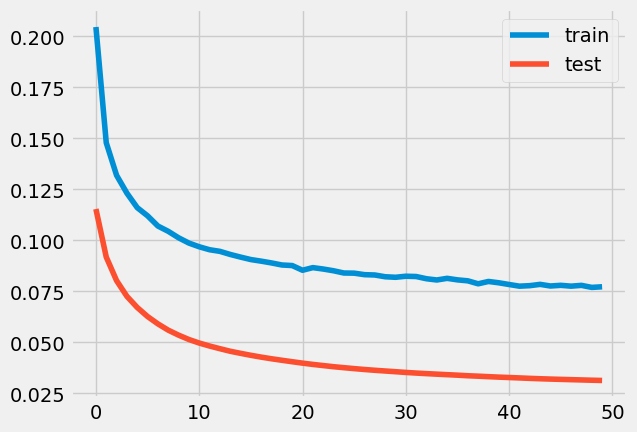

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 116ms/step - loss: 0.2110 - accuracy: 0.0000e+00 - val_loss: 0.1091 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 78ms/step - loss: 0.1372 - accuracy: 0.0000e+00 - val_loss: 0.0797 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 

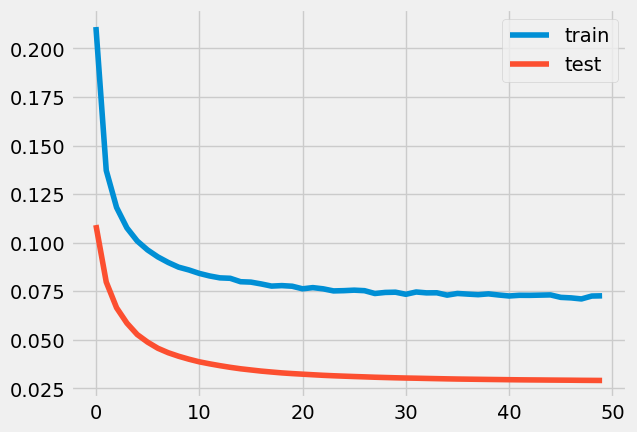

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 114ms/step - loss: 0.1687 - accuracy: 0.0000e+00 - val_loss: 0.0746 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 70ms/step - loss: 0.1103 - accuracy: 1.0861e-04 - val_loss: 0.0535 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 

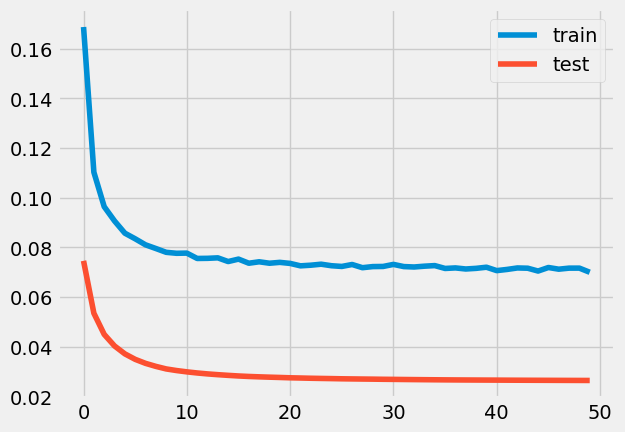

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 111ms/step - loss: 0.3252 - accuracy: 0.0000e+00 - val_loss: 0.2305 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 72ms/step - loss: 0.2468 - accuracy: 0.0000e+00 - val_loss: 0.1933 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 

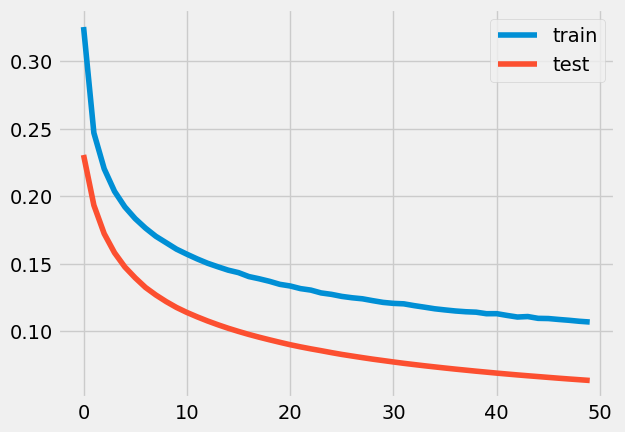

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 104ms/step - loss: 0.2892 - accuracy: 0.0000e+00 - val_loss: 0.1757 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 66ms/step - loss: 0.1944 - accuracy: 0.0000e+00 - val_loss: 0.1358 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 


loss: 3.77%



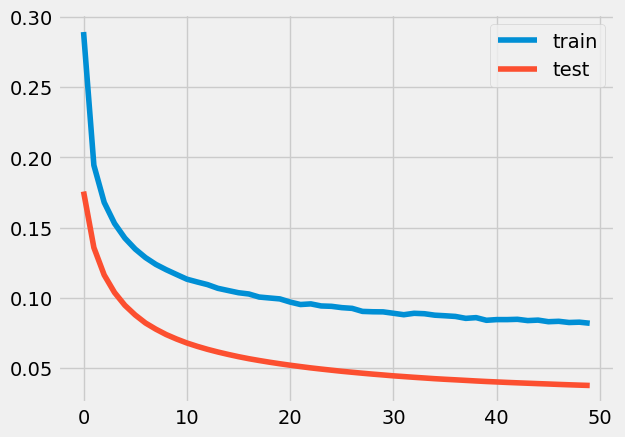

0.00015625
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 122ms/step - loss: 0.2526 - accuracy: 0.0000e+00 - val_loss: 0.1423 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 84ms/step - loss: 0.1662 - accuracy: 0.0000e+00 - val_loss: 0.1073 - val_accuracy: 0.0000e+00
Epoch 

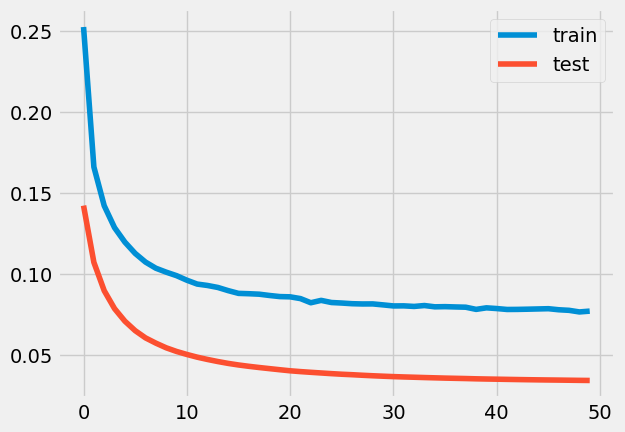

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 126ms/step - loss: 0.3389 - accuracy: 0.0000e+00 - val_loss: 0.2413 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 89ms/step - loss: 0.2558 - accuracy: 0.0000e+00 - val_loss: 0.2042 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 

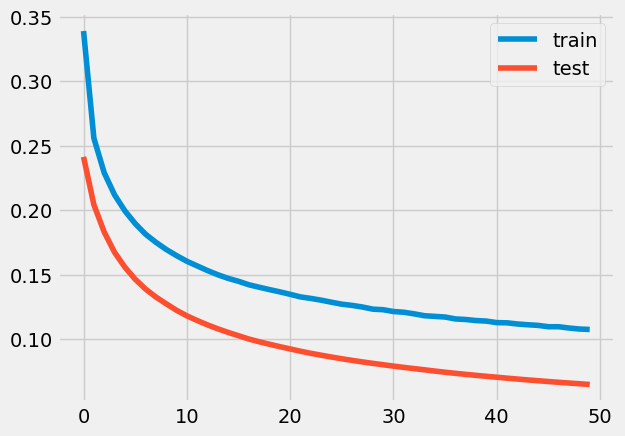

2.1623138290224244e-85
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 123ms/step - loss: 0.2550 - accuracy: 0.0000e+00 - val_loss: 0.1654 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 84ms/step - loss: 0.1917 - accuracy: 0.0000e+00 - val_loss: 0.1359 - val_accuracy: 0.000

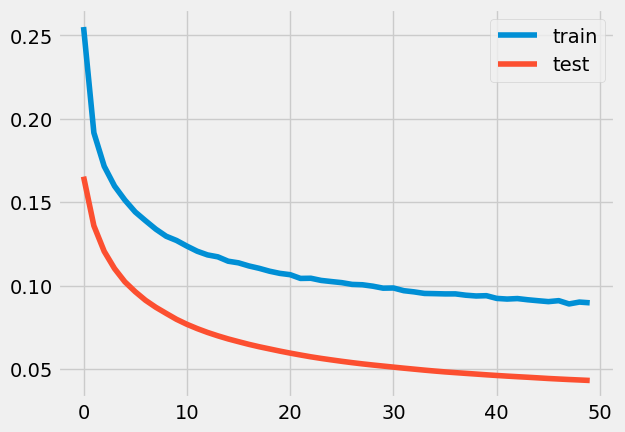

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 119ms/step - loss: 0.1747 - accuracy: 0.0000e+00 - val_loss: 0.0822 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 80ms/step - loss: 0.1170 - accuracy: 8.1967e-06 - val_loss: 0.0610 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 

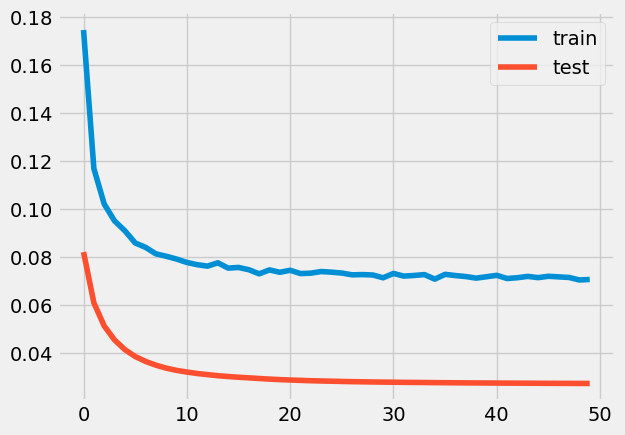

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 118ms/step - loss: 0.2419 - accuracy: 0.0000e+00 - val_loss: 0.1453 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 72ms/step - loss: 0.1724 - accuracy: 0.0000e+00 - val_loss: 0.1164 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 


loss: 3.55%



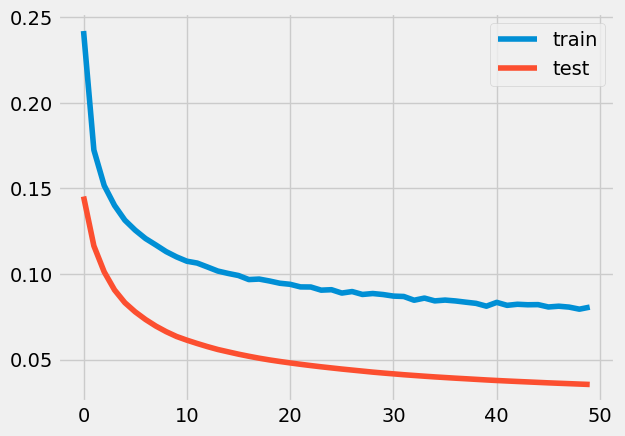

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 105ms/step - loss: 0.2324 - accuracy: 0.0000e+00 - val_loss: 0.1413 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 61ms/step - loss: 0.1692 - accuracy: 0.0000e+00 - val_loss: 0.1143 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 

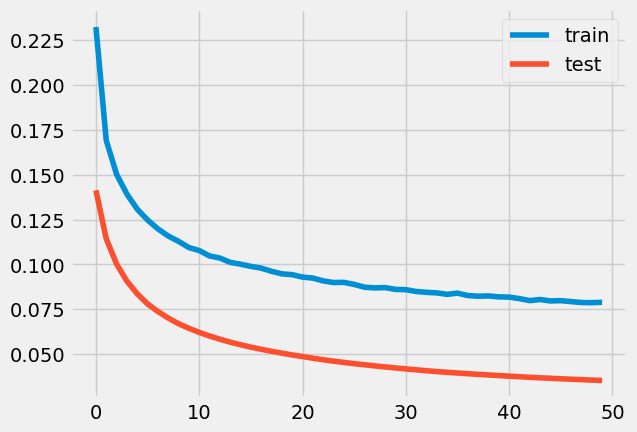

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 107ms/step - loss: 0.2908 - accuracy: 0.0000e+00 - val_loss: 0.1969 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 68ms/step - loss: 0.2187 - accuracy: 0.0000e+00 - val_loss: 0.1657 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 

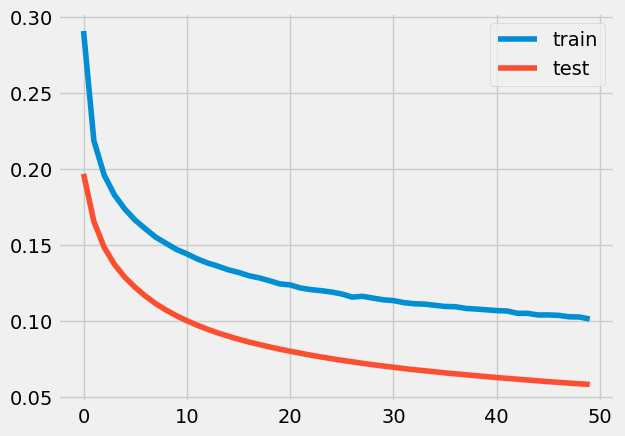

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 116ms/step - loss: 0.2228 - accuracy: 0.0000e+00 - val_loss: 0.1183 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 74ms/step - loss: 0.1466 - accuracy: 0.0000e+00 - val_loss: 0.0881 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 

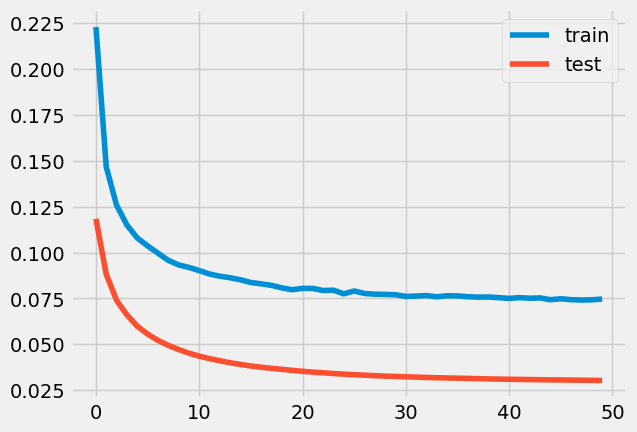

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 111ms/step - loss: 0.2021 - accuracy: 0.0000e+00 - val_loss: 0.1069 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 73ms/step - loss: 0.1374 - accuracy: 0.0000e+00 - val_loss: 0.0811 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 

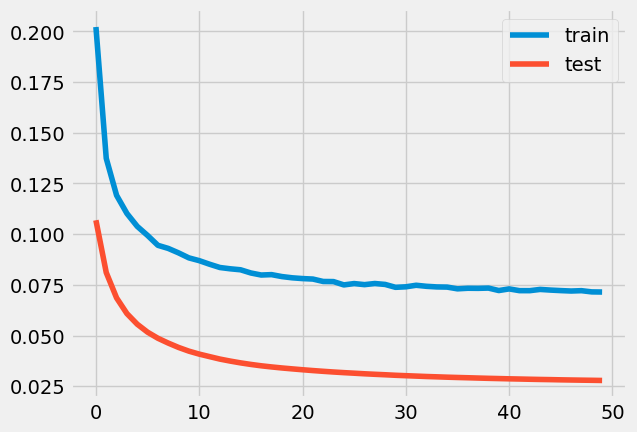

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 108ms/step - loss: 0.1917 - accuracy: 0.0000e+00 - val_loss: 0.1068 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 75ms/step - loss: 0.1413 - accuracy: 0.0000e+00 - val_loss: 0.0853 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 

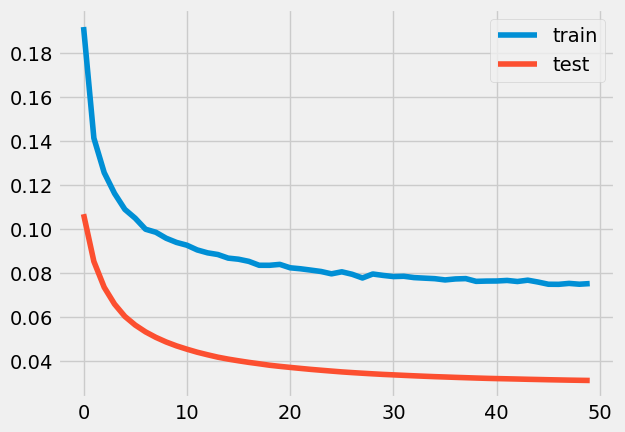

2.3946482136826244e-10
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 114ms/step - loss: 0.2410 - accuracy: 0.0000e+00 - val_loss: 0.1390 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 71ms/step - loss: 0.1649 - accuracy: 0.0000e+00 - val_loss: 0.1078 - val_accuracy: 0.000


loss: 3.23%



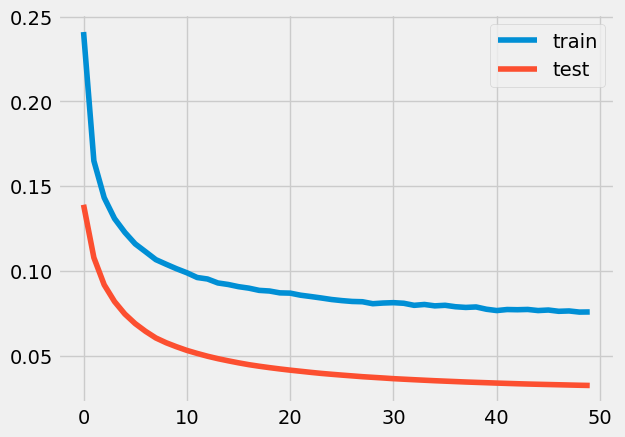

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 111ms/step - loss: 0.2109 - accuracy: 0.0000e+00 - val_loss: 0.1172 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 70ms/step - loss: 0.1466 - accuracy: 0.0000e+00 - val_loss: 0.0915 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 

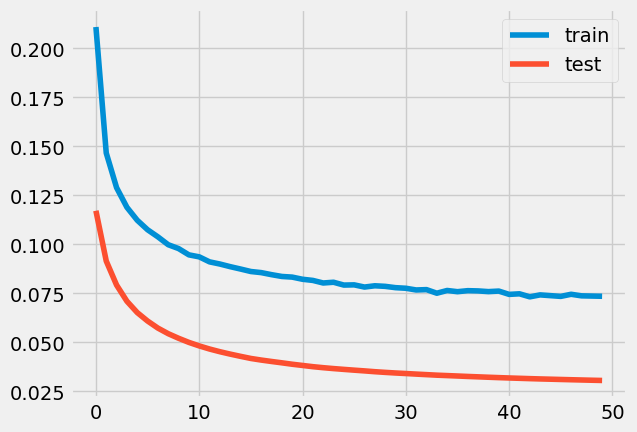

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 107ms/step - loss: 0.1884 - accuracy: 0.0000e+00 - val_loss: 0.0847 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 66ms/step - loss: 0.1179 - accuracy: 0.0000e+00 - val_loss: 0.0615 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 

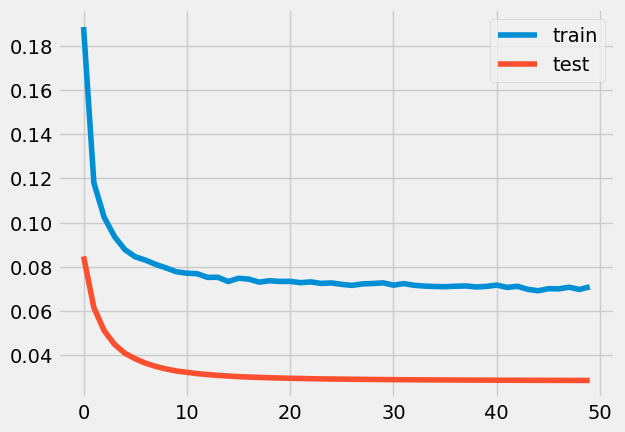

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 115ms/step - loss: 0.1623 - accuracy: 0.0000e+00 - val_loss: 0.0757 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 63ms/step - loss: 0.1148 - accuracy: 1.3115e-04 - val_loss: 0.0578 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 

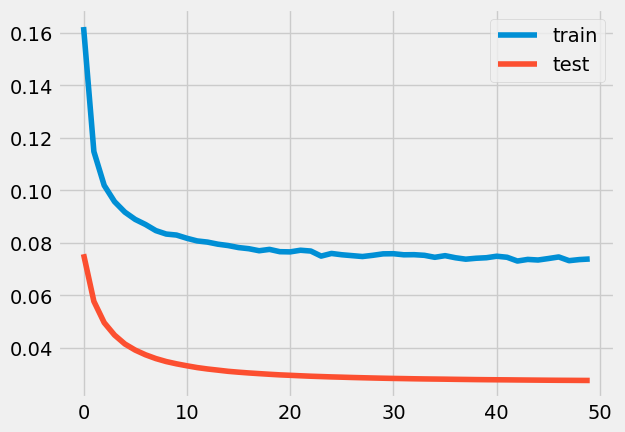

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 119ms/step - loss: 0.2091 - accuracy: 0.0000e+00 - val_loss: 0.1217 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 75ms/step - loss: 0.1524 - accuracy: 0.0000e+00 - val_loss: 0.0970 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 

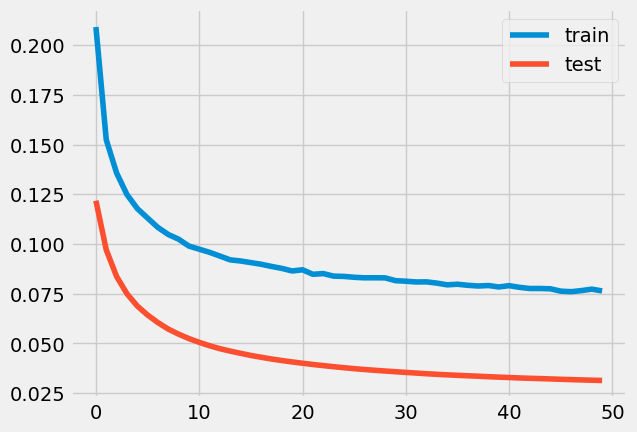

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 123ms/step - loss: 0.2555 - accuracy: 0.0000e+00 - val_loss: 0.1619 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 86ms/step - loss: 0.1857 - accuracy: 0.0000e+00 - val_loss: 0.1286 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 

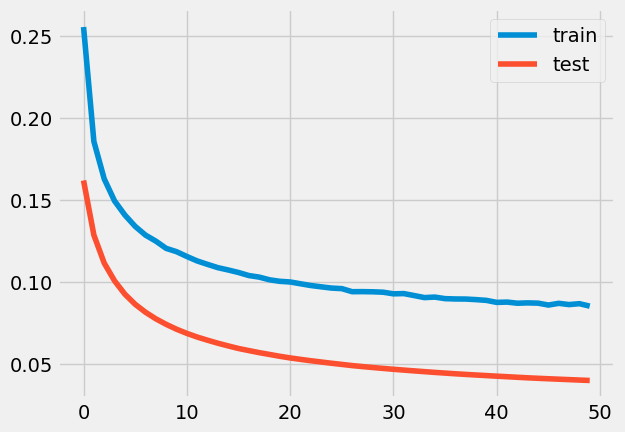

2.0002550236373403e-24
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 6s 136ms/step - loss: 0.1249 - accuracy: 4.3238e-04 - val_loss: 0.0461 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 88ms/step - loss: 0.0902 - accuracy: 0.0025 - val_loss: 0.0370 - val_accuracy: 0.0000e+0

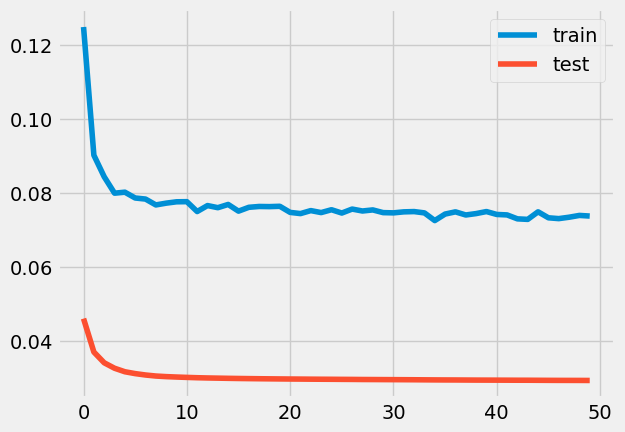

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 131ms/step - loss: 0.1387 - accuracy: 4.5082e-05 - val_loss: 0.0532 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 84ms/step - loss: 0.0941 - accuracy: 7.4180e-04 - val_loss: 0.0391 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 

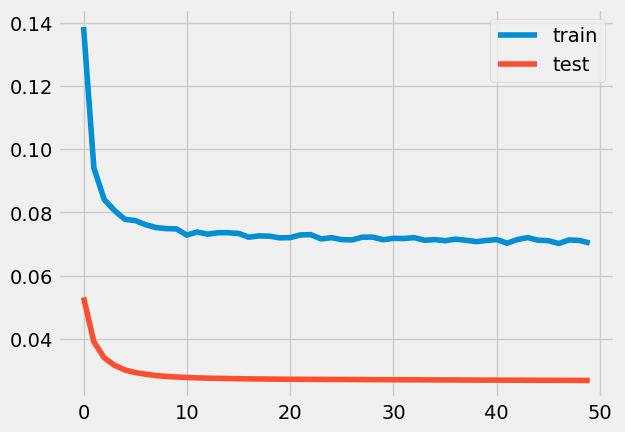

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 128ms/step - loss: 0.1661 - accuracy: 0.0000e+00 - val_loss: 0.0728 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 2s 81ms/step - loss: 0.1112 - accuracy: 1.6189e-04 - val_loss: 0.0548 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 

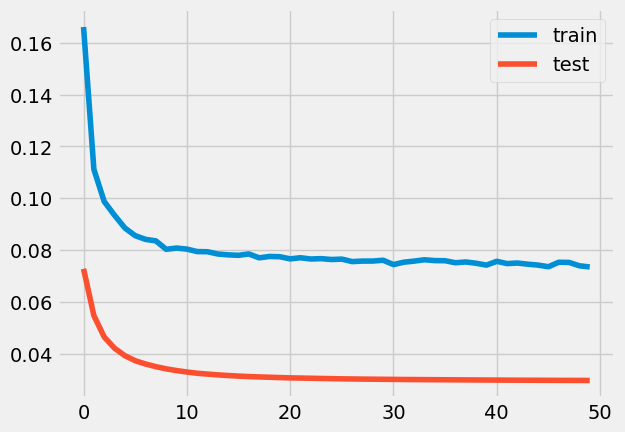

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 80ms/step - loss: 0.3447 - accuracy: 0.0000e+00 - val_loss: 0.2322 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 50ms/step - loss: 0.2445 - accuracy: 0.0000e+00 - val_loss: 0.1897 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

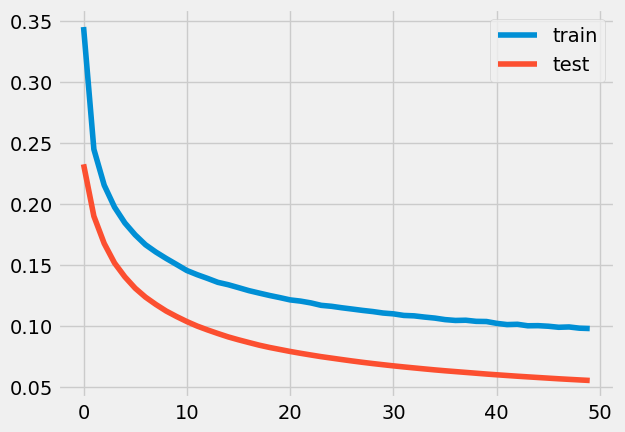

3.2330247656198413e-71
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 74ms/step - loss: 0.2250 - accuracy: 0.0000e+00 - val_loss: 0.1419 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 47ms/step - loss: 0.1737 - accuracy: 0.0000e+00 - val_loss: 0.1194 - val_accuracy: 0.0000

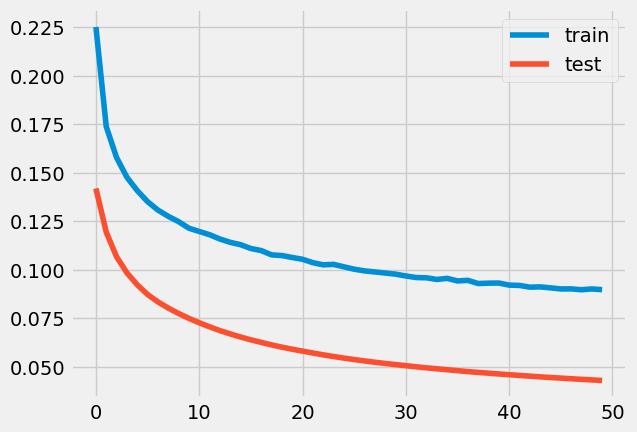

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 83ms/step - loss: 0.2008 - accuracy: 0.0000e+00 - val_loss: 0.1030 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 52ms/step - loss: 0.1353 - accuracy: 0.0000e+00 - val_loss: 0.0782 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

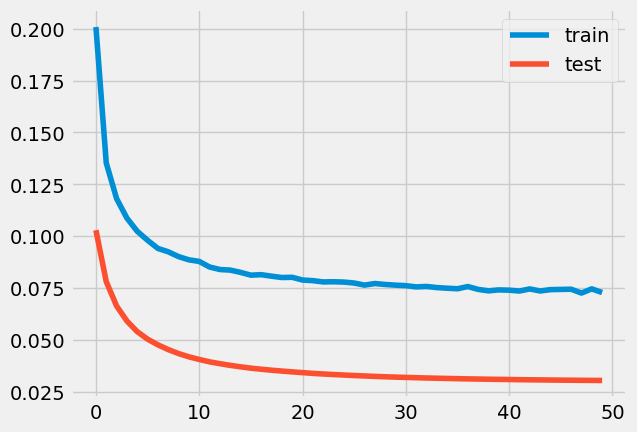

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 81ms/step - loss: 0.1780 - accuracy: 0.0000e+00 - val_loss: 0.0719 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 52ms/step - loss: 0.1075 - accuracy: 4.6107e-04 - val_loss: 0.0512 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

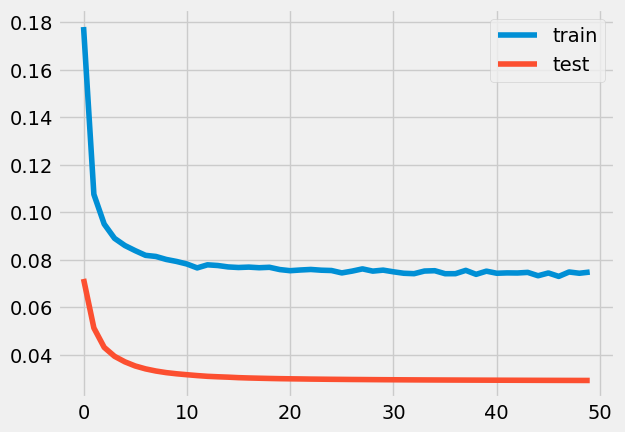

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 80ms/step - loss: 0.1190 - accuracy: 2.3361e-04 - val_loss: 0.0463 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 50ms/step - loss: 0.0918 - accuracy: 0.0012 - val_loss: 0.0375 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [====

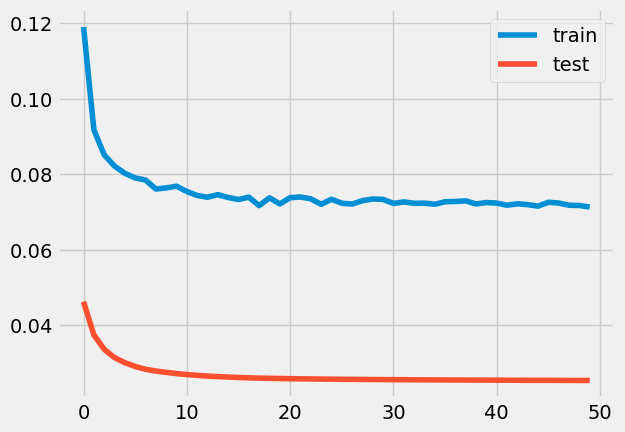

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 84ms/step - loss: 0.1617 - accuracy: 0.0000e+00 - val_loss: 0.0785 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 52ms/step - loss: 0.1156 - accuracy: 6.7623e-05 - val_loss: 0.0598 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

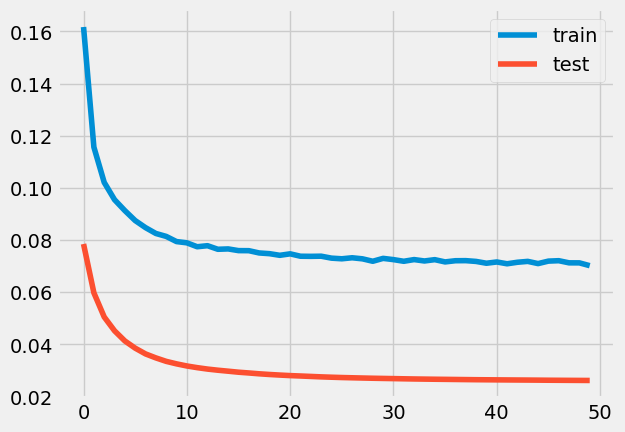

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 79ms/step - loss: 0.0925 - accuracy: 0.0013 - val_loss: 0.0273 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 52ms/step - loss: 0.0749 - accuracy: 0.0046 - val_loss: 0.0261 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

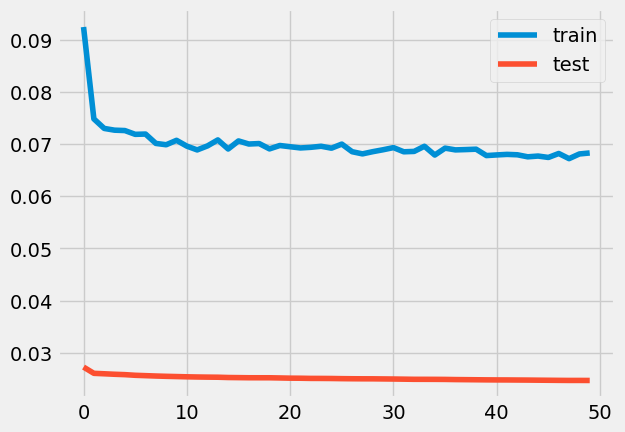

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 74ms/step - loss: 0.2057 - accuracy: 0.0000e+00 - val_loss: 0.1111 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 50ms/step - loss: 0.1423 - accuracy: 0.0000e+00 - val_loss: 0.0851 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

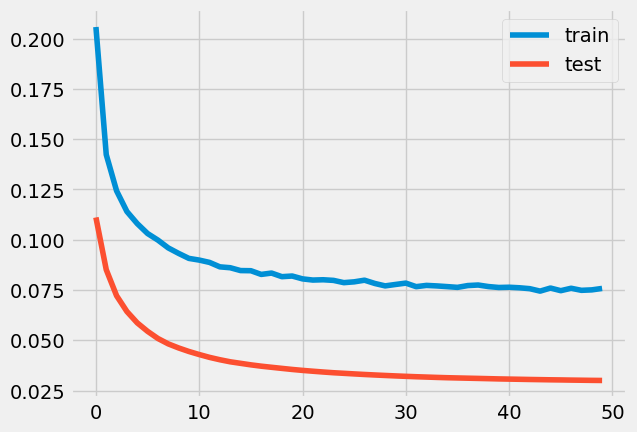

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 73ms/step - loss: 0.3489 - accuracy: 0.0000e+00 - val_loss: 0.2436 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 49ms/step - loss: 0.2539 - accuracy: 0.0000e+00 - val_loss: 0.1987 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

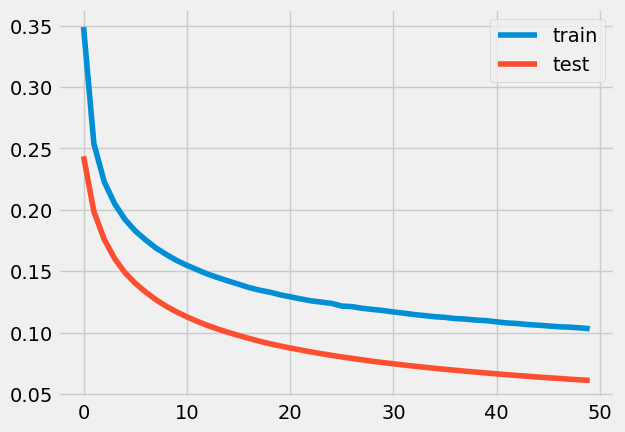

6.239858412876009e-87
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 78ms/step - loss: 0.1662 - accuracy: 0.0000e+00 - val_loss: 0.0739 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 49ms/step - loss: 0.1112 - accuracy: 7.3770e-05 - val_loss: 0.0550 - val_accuracy: 0.0000e

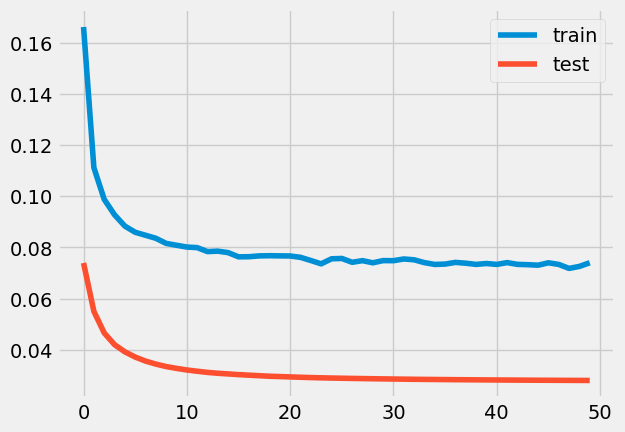

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 84ms/step - loss: 0.3157 - accuracy: 0.0000e+00 - val_loss: 0.2207 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 52ms/step - loss: 0.2389 - accuracy: 0.0000e+00 - val_loss: 0.1879 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

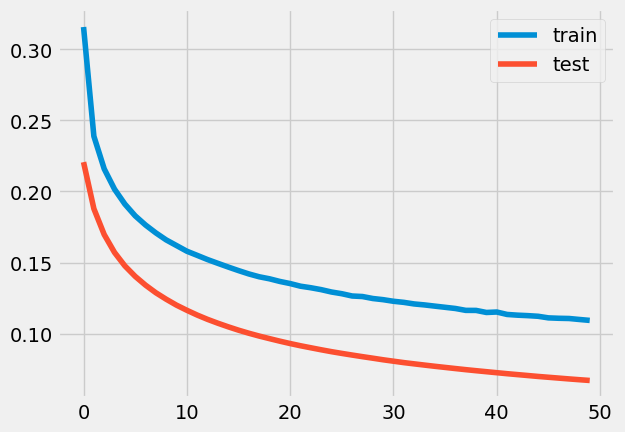

2.719551978495122e-109
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 76ms/step - loss: 0.1578 - accuracy: 0.0000e+00 - val_loss: 0.0671 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 50ms/step - loss: 0.1058 - accuracy: 7.7869e-04 - val_loss: 0.0495 - val_accuracy: 0.0000

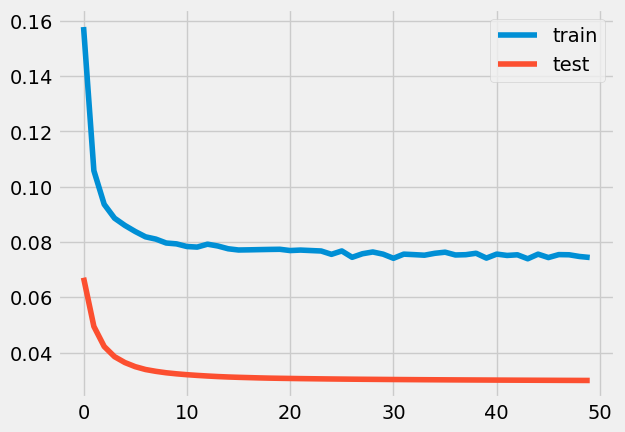

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 75ms/step - loss: 0.1461 - accuracy: 0.0000e+00 - val_loss: 0.0616 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 52ms/step - loss: 0.1024 - accuracy: 6.1270e-04 - val_loss: 0.0472 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

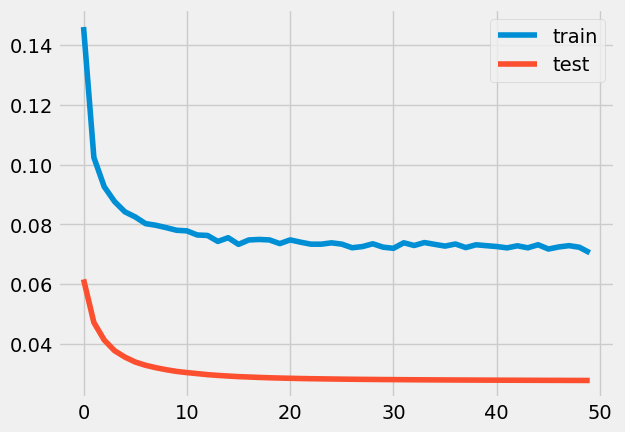

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 82ms/step - loss: 0.2252 - accuracy: 0.0000e+00 - val_loss: 0.1332 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 50ms/step - loss: 0.1634 - accuracy: 0.0000e+00 - val_loss: 0.1070 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [


loss: 3.56%



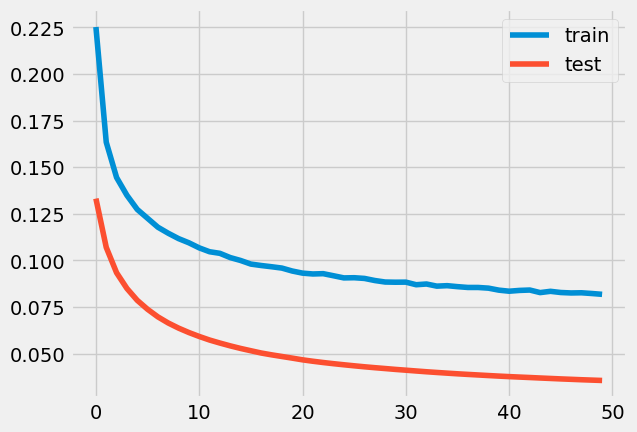

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 84ms/step - loss: 0.1951 - accuracy: 0.0000e+00 - val_loss: 0.1004 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 51ms/step - loss: 0.1326 - accuracy: 0.0000e+00 - val_loss: 0.0743 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

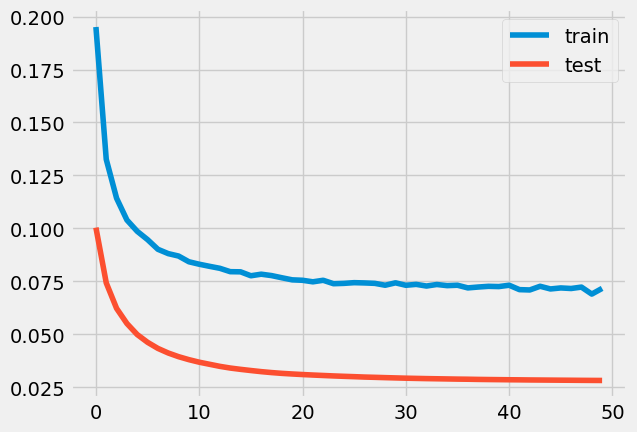

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 76ms/step - loss: 0.1888 - accuracy: 0.0000e+00 - val_loss: 0.0905 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 50ms/step - loss: 0.1245 - accuracy: 1.0246e-05 - val_loss: 0.0665 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

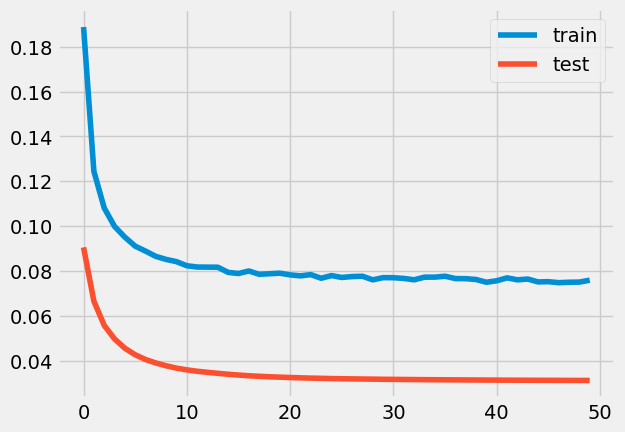

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 76ms/step - loss: 0.1384 - accuracy: 9.8361e-05 - val_loss: 0.0501 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 47ms/step - loss: 0.0918 - accuracy: 0.0023 - val_loss: 0.0388 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [====

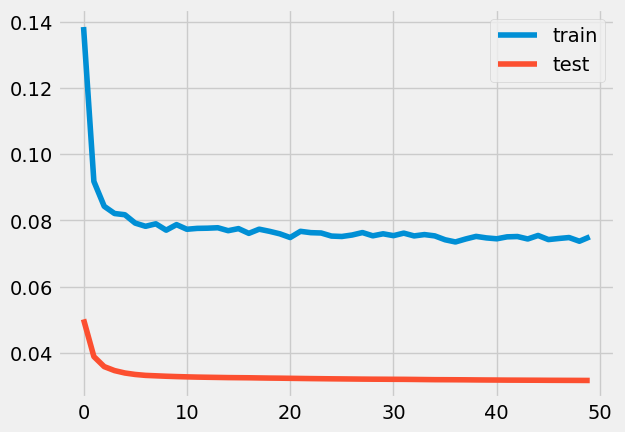

0.044469667971904187
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 75ms/step - loss: 0.1788 - accuracy: 0.0000e+00 - val_loss: 0.0974 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 47ms/step - loss: 0.1348 - accuracy: 0.0000e+00 - val_loss: 0.0785 - val_accuracy: 0.0000e+

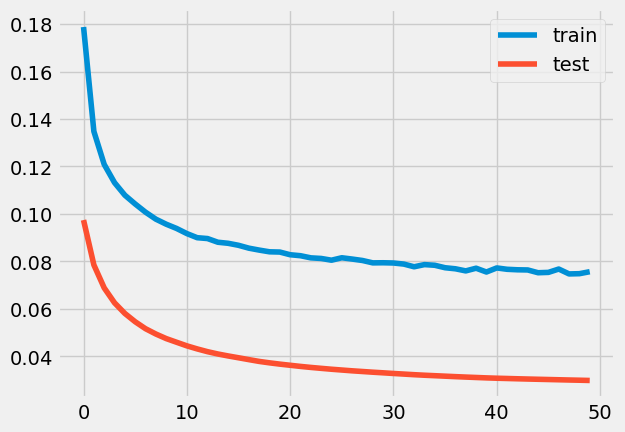

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 79ms/step - loss: 0.2681 - accuracy: 0.0000e+00 - val_loss: 0.1577 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 51ms/step - loss: 0.1783 - accuracy: 0.0000e+00 - val_loss: 0.1217 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [


loss: 3.11%



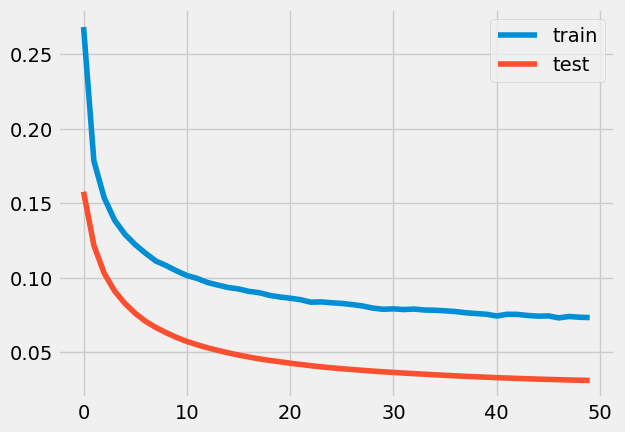

0.00031990154784544385
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 81ms/step - loss: 0.1779 - accuracy: 0.0000e+00 - val_loss: 0.0929 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 54ms/step - loss: 0.1293 - accuracy: 0.0000e+00 - val_loss: 0.0733 - val_accuracy: 0.0000

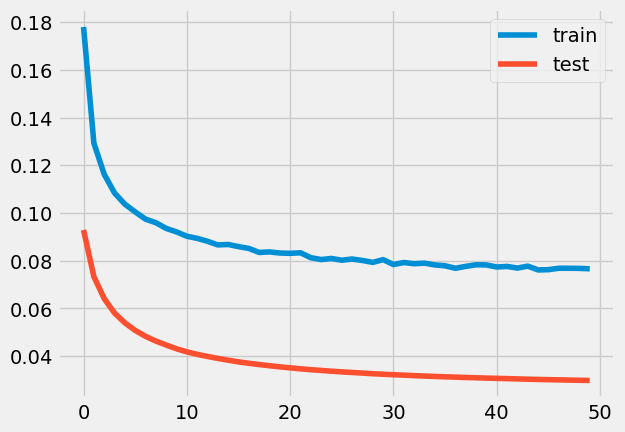

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 82ms/step - loss: 0.2206 - accuracy: 0.0000e+00 - val_loss: 0.1214 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 52ms/step - loss: 0.1514 - accuracy: 0.0000e+00 - val_loss: 0.0952 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

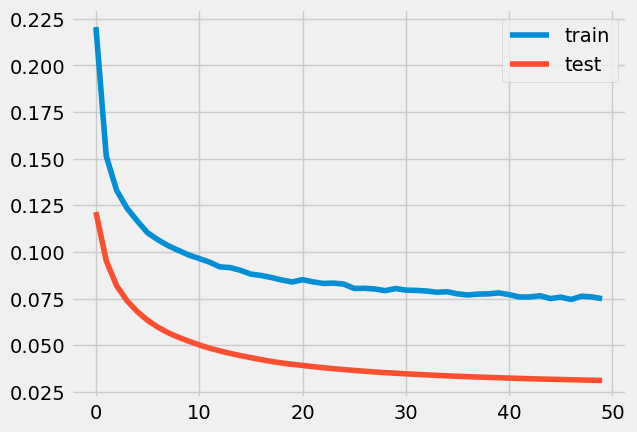

0.0003734138562189927
7.8125e-05
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 77ms/step - loss: 0.3232 - accuracy: 0.0000e+00 - val_loss: 0.2275 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.2452 - accuracy: 0.0000e+00 - val_loss: 0.1915 - val_accura

20/20 [==============================] - 1s 52ms/step - loss: 0.1118 - accuracy: 0.0000e+00 - val_loss: 0.0677 - val_accuracy: 0.0000e+00

loss: 6.77%



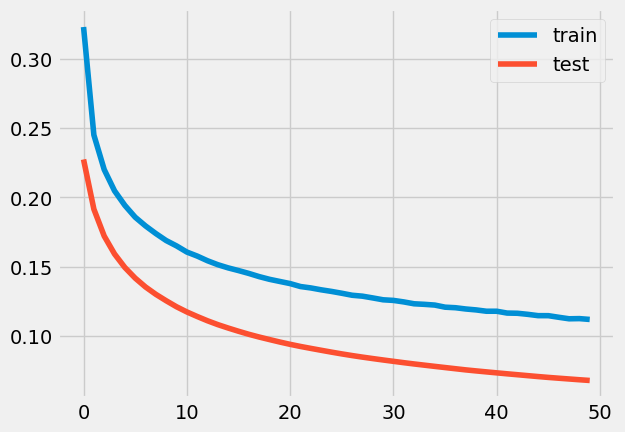

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 86ms/step - loss: 0.4076 - accuracy: 0.0000e+00 - val_loss: 0.2980 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 52ms/step - loss: 0.3016 - accuracy: 0.0000e+00 - val_loss: 0.2491 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

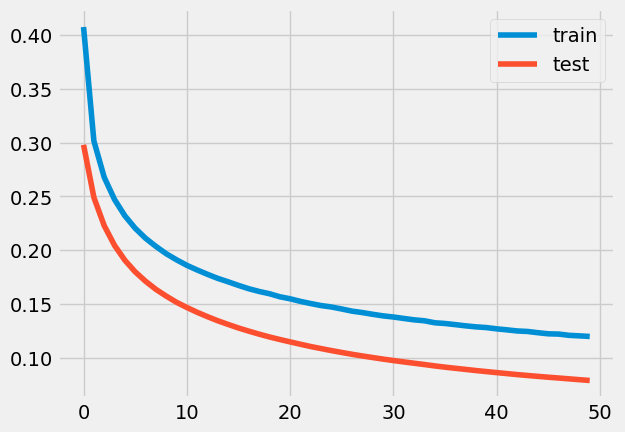

5.86780202311931e-63
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 78ms/step - loss: 0.1102 - accuracy: 4.8770e-04 - val_loss: 0.0386 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 51ms/step - loss: 0.0831 - accuracy: 0.0029 - val_loss: 0.0315 - val_accuracy: 0.0000e+00
E

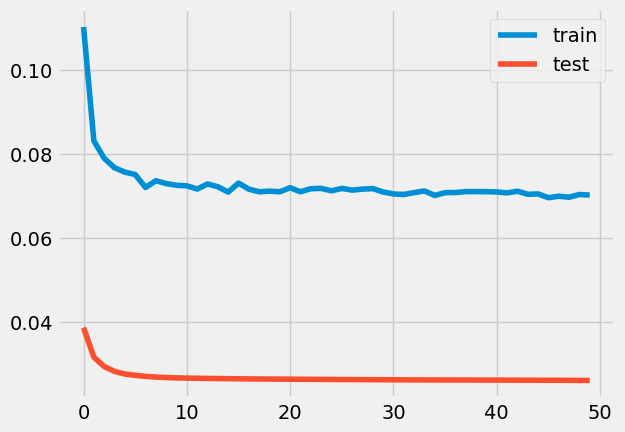

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 75ms/step - loss: 0.1636 - accuracy: 0.0000e+00 - val_loss: 0.0687 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 48ms/step - loss: 0.1051 - accuracy: 1.5574e-04 - val_loss: 0.0508 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

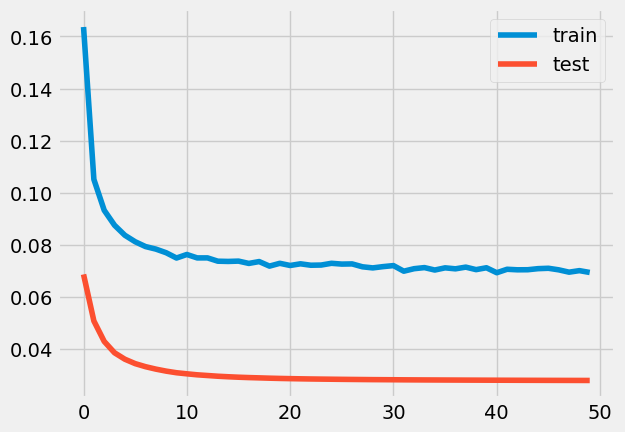

1.4529795986953341e-11
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 78ms/step - loss: 0.2316 - accuracy: 0.0000e+00 - val_loss: 0.1283 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 49ms/step - loss: 0.1568 - accuracy: 0.0000e+00 - val_loss: 0.1008 - val_accuracy: 0.0000


loss: 3.37%



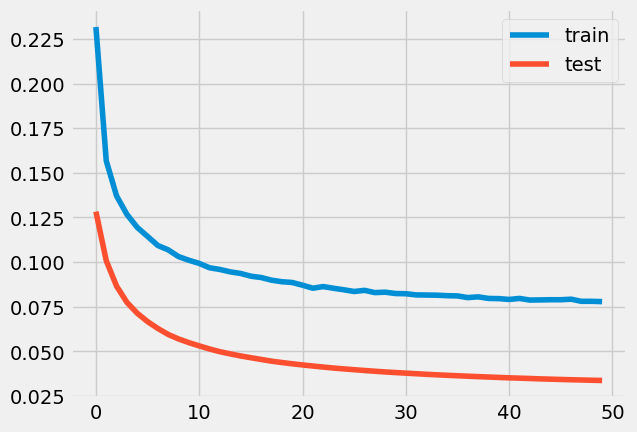

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 85ms/step - loss: 0.2422 - accuracy: 0.0000e+00 - val_loss: 0.1433 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 50ms/step - loss: 0.1695 - accuracy: 0.0000e+00 - val_loss: 0.1125 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [


loss: 3.47%



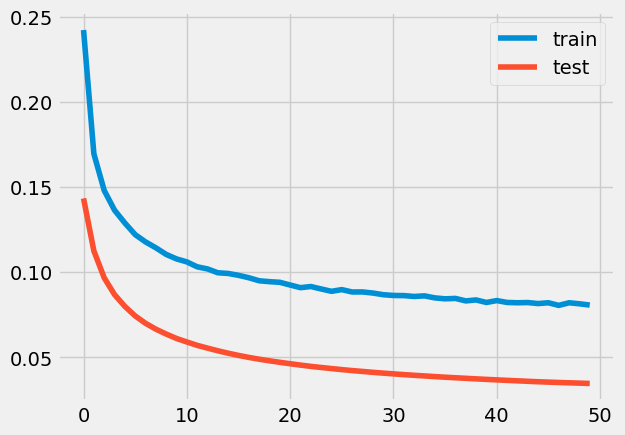

3.641630931872382e-06
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 80ms/step - loss: 0.2476 - accuracy: 0.0000e+00 - val_loss: 0.1582 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 54ms/step - loss: 0.1848 - accuracy: 0.0000e+00 - val_loss: 0.1289 - val_accuracy: 0.0000e

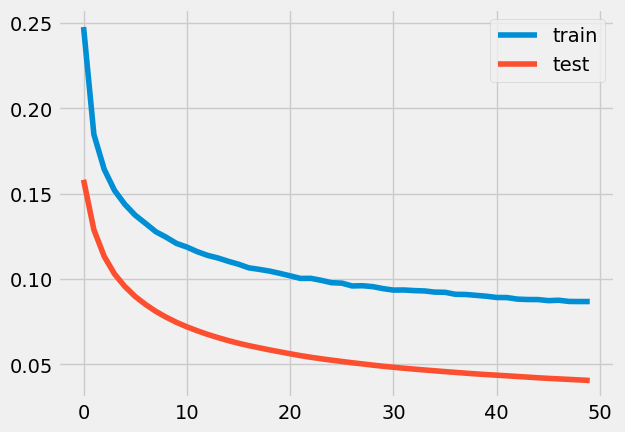

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 80ms/step - loss: 0.1892 - accuracy: 0.0000e+00 - val_loss: 0.0931 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 54ms/step - loss: 0.1268 - accuracy: 0.0000e+00 - val_loss: 0.0703 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

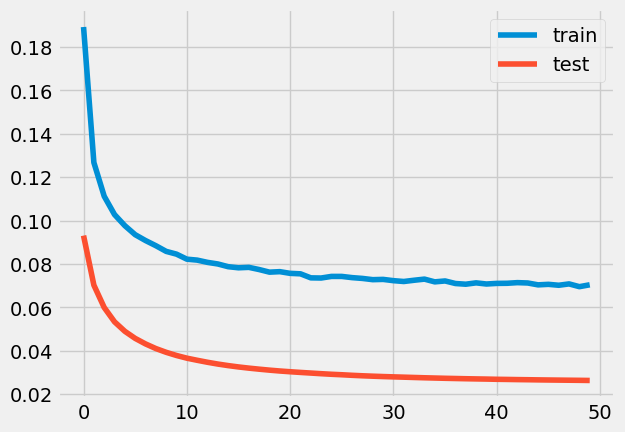

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 86ms/step - loss: 0.1565 - accuracy: 0.0000e+00 - val_loss: 0.0665 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.1069 - accuracy: 1.9672e-04 - val_loss: 0.0504 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

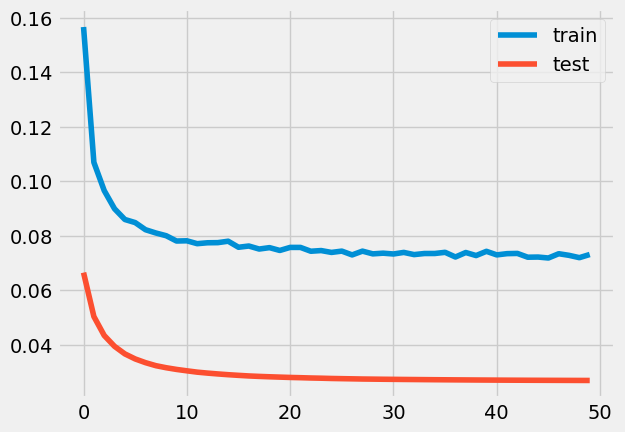

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 85ms/step - loss: 0.2218 - accuracy: 0.0000e+00 - val_loss: 0.1326 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 52ms/step - loss: 0.1625 - accuracy: 0.0000e+00 - val_loss: 0.1072 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

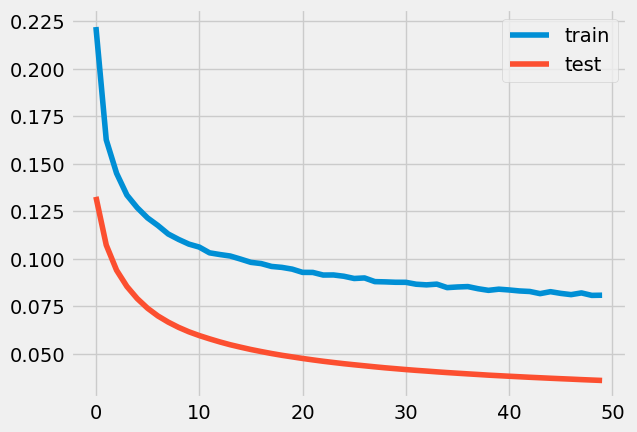

2.7529345607249354e-51
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 80ms/step - loss: 0.1829 - accuracy: 0.0000e+00 - val_loss: 0.0933 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 49ms/step - loss: 0.1292 - accuracy: 0.0000e+00 - val_loss: 0.0705 - val_accuracy: 0.0000

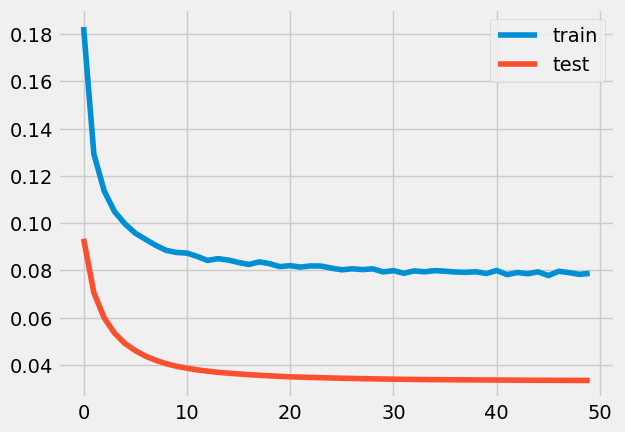

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 76ms/step - loss: 0.2676 - accuracy: 0.0000e+00 - val_loss: 0.1882 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 49ms/step - loss: 0.2169 - accuracy: 0.0000e+00 - val_loss: 0.1653 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

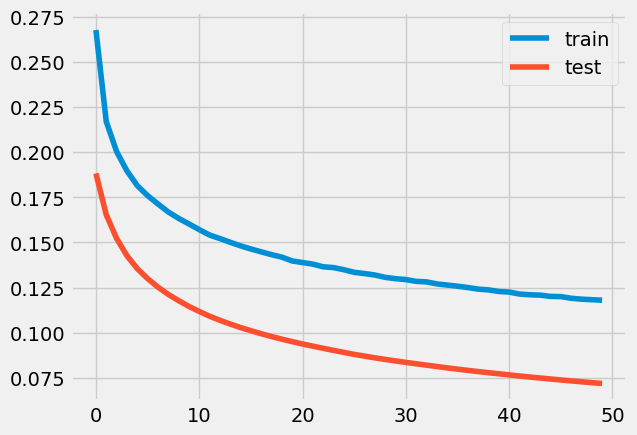

7.055228745837508e-215
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 79ms/step - loss: 0.1798 - accuracy: 0.0000e+00 - val_loss: 0.0901 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.1257 - accuracy: 0.0000e+00 - val_loss: 0.0690 - val_accuracy: 0.0000

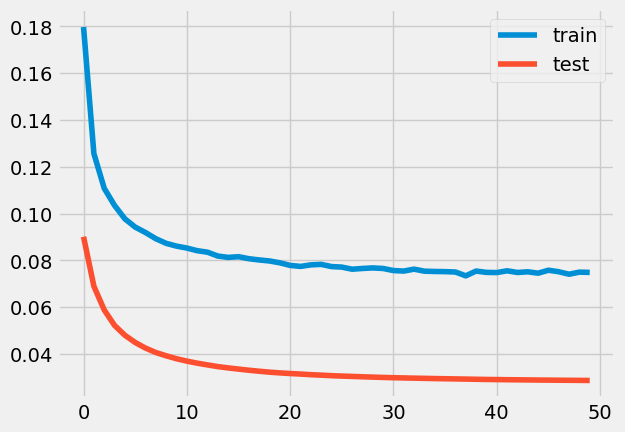

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 79ms/step - loss: 0.2354 - accuracy: 0.0000e+00 - val_loss: 0.1314 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.1558 - accuracy: 0.0000e+00 - val_loss: 0.0987 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

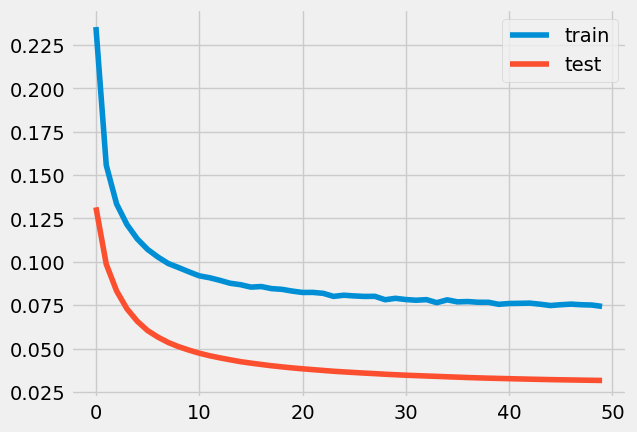

9.185529505399114e-17
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 76ms/step - loss: 0.1068 - accuracy: 0.0022 - val_loss: 0.0333 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 51ms/step - loss: 0.0795 - accuracy: 0.0035 - val_loss: 0.0287 - val_accuracy: 0.0000e+00
Epoc

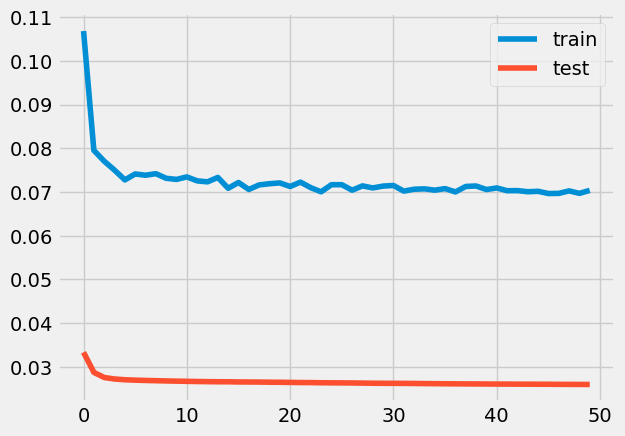

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 81ms/step - loss: 0.1745 - accuracy: 0.0000e+00 - val_loss: 0.0810 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 51ms/step - loss: 0.1178 - accuracy: 1.8443e-05 - val_loss: 0.0606 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

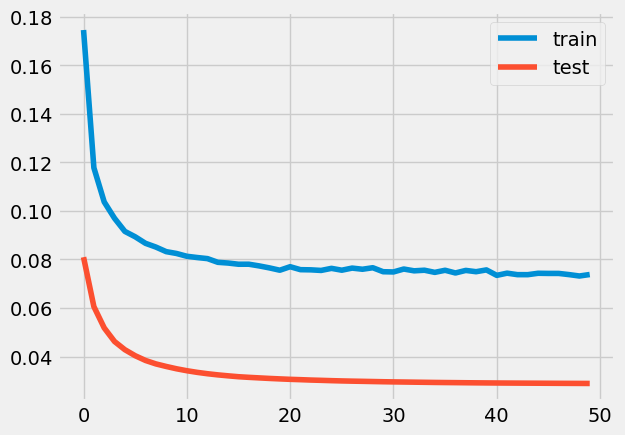

3.7012053360812967e-17
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 81ms/step - loss: 0.2281 - accuracy: 0.0000e+00 - val_loss: 0.1216 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 51ms/step - loss: 0.1483 - accuracy: 0.0000e+00 - val_loss: 0.0908 - val_accuracy: 0.0000

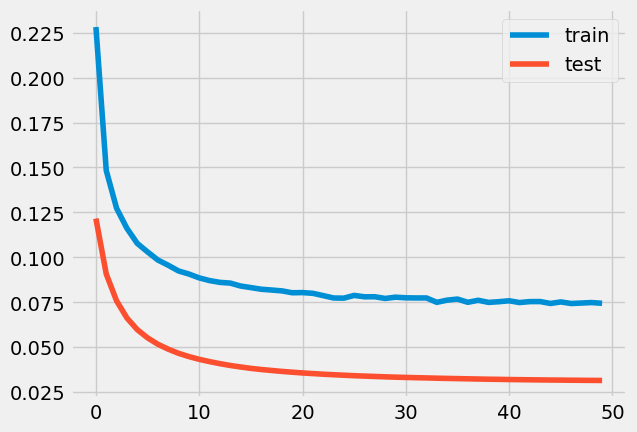

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 78ms/step - loss: 0.2004 - accuracy: 0.0000e+00 - val_loss: 0.1070 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 49ms/step - loss: 0.1405 - accuracy: 0.0000e+00 - val_loss: 0.0839 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

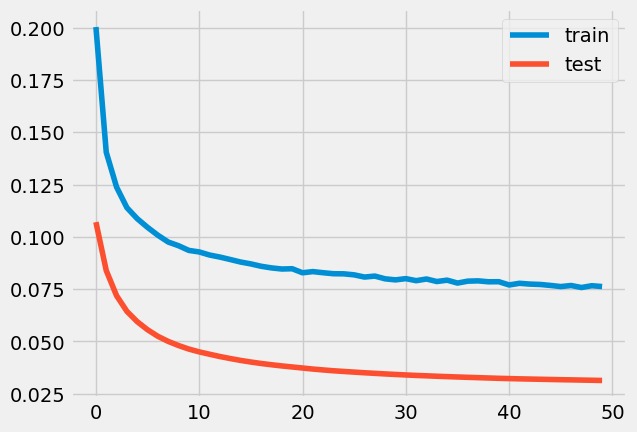

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 83ms/step - loss: 0.1755 - accuracy: 0.0000e+00 - val_loss: 0.0786 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 50ms/step - loss: 0.1122 - accuracy: 2.8689e-05 - val_loss: 0.0565 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

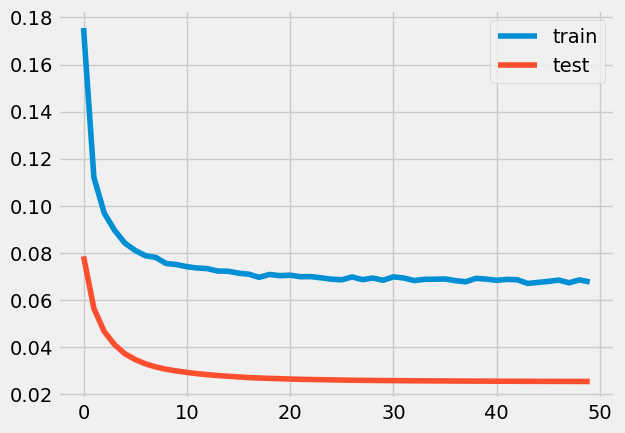

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 74ms/step - loss: 0.2697 - accuracy: 0.0000e+00 - val_loss: 0.1706 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 46ms/step - loss: 0.1931 - accuracy: 0.0000e+00 - val_loss: 0.1358 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [


loss: 4.32%



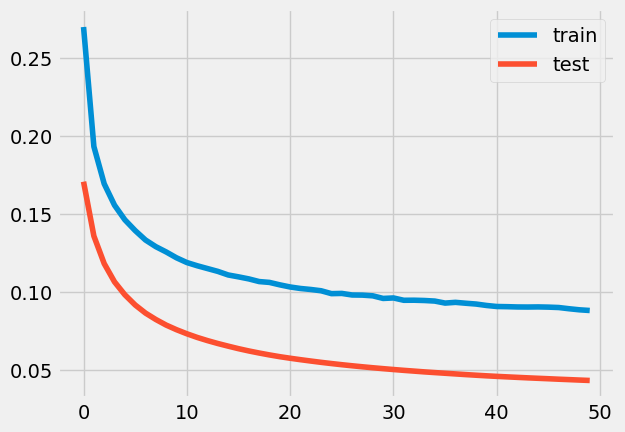

7.105776951768915e-99
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 85ms/step - loss: 0.2168 - accuracy: 0.0000e+00 - val_loss: 0.1270 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 50ms/step - loss: 0.1583 - accuracy: 0.0000e+00 - val_loss: 0.1021 - val_accuracy: 0.0000e


loss: 3.47%



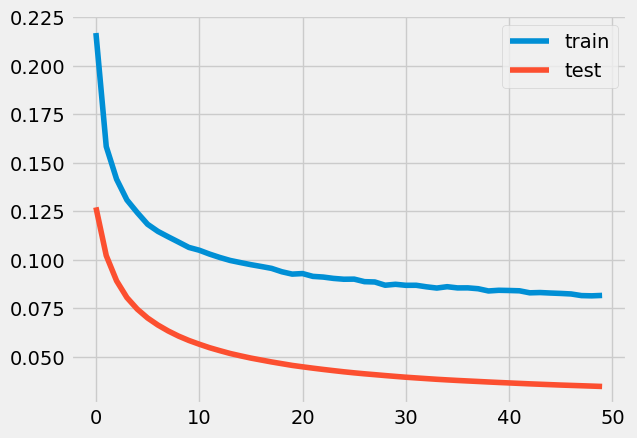

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 83ms/step - loss: 0.2153 - accuracy: 0.0000e+00 - val_loss: 0.1174 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.1492 - accuracy: 0.0000e+00 - val_loss: 0.0914 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

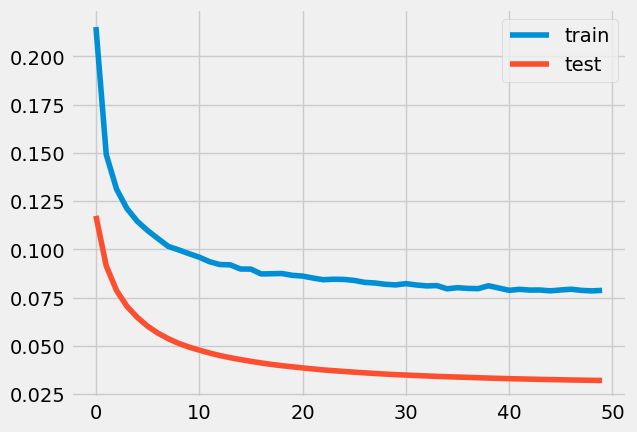

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 82ms/step - loss: 0.2010 - accuracy: 0.0000e+00 - val_loss: 0.1111 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 55ms/step - loss: 0.1444 - accuracy: 0.0000e+00 - val_loss: 0.0883 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

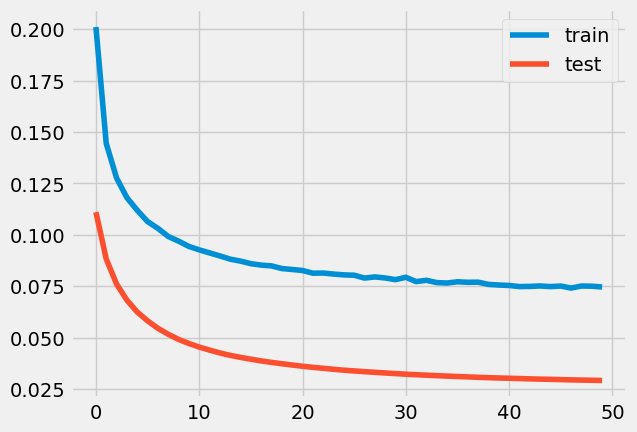

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 87ms/step - loss: 0.1106 - accuracy: 0.0013 - val_loss: 0.0358 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 54ms/step - loss: 0.0805 - accuracy: 0.0045 - val_loss: 0.0318 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

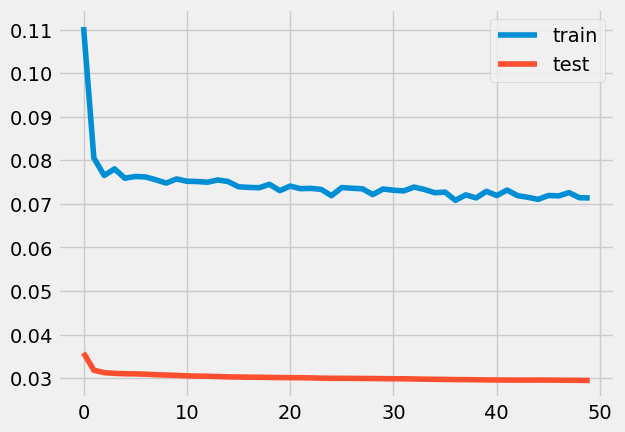

0.041531028002972634
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 80ms/step - loss: 0.3927 - accuracy: 0.0000e+00 - val_loss: 0.2802 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 52ms/step - loss: 0.2883 - accuracy: 0.0000e+00 - val_loss: 0.2369 - val_accuracy: 0.0000e+

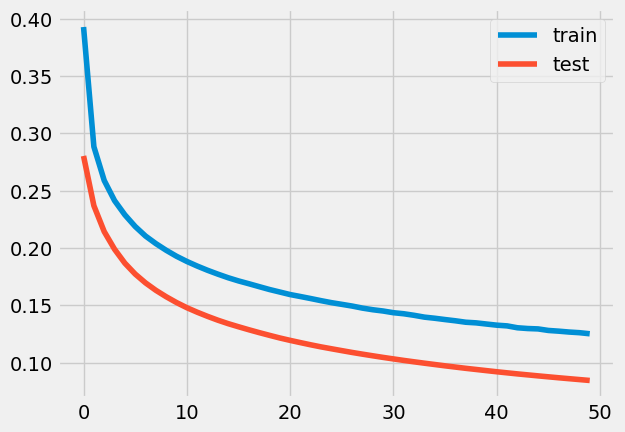

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 76ms/step - loss: 0.1486 - accuracy: 0.0000e+00 - val_loss: 0.0659 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 52ms/step - loss: 0.1068 - accuracy: 4.8770e-04 - val_loss: 0.0507 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

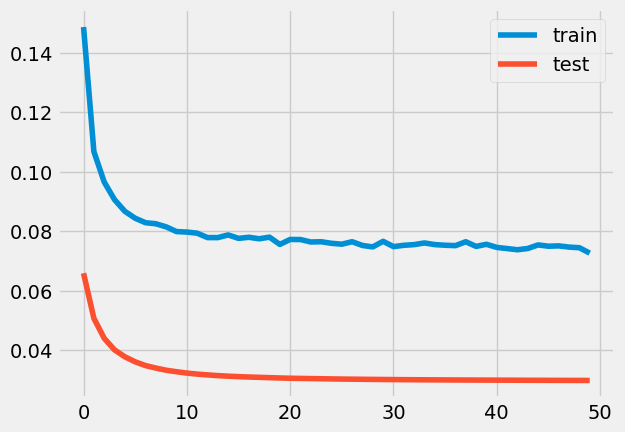

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 80ms/step - loss: 0.1736 - accuracy: 0.0000e+00 - val_loss: 0.0876 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 47ms/step - loss: 0.1240 - accuracy: 0.0000e+00 - val_loss: 0.0678 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

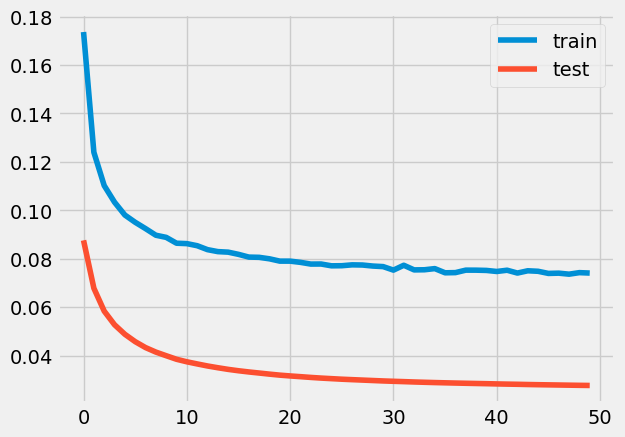

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 79ms/step - loss: 0.1613 - accuracy: 0.0000e+00 - val_loss: 0.0770 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 52ms/step - loss: 0.1136 - accuracy: 4.7131e-05 - val_loss: 0.0583 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

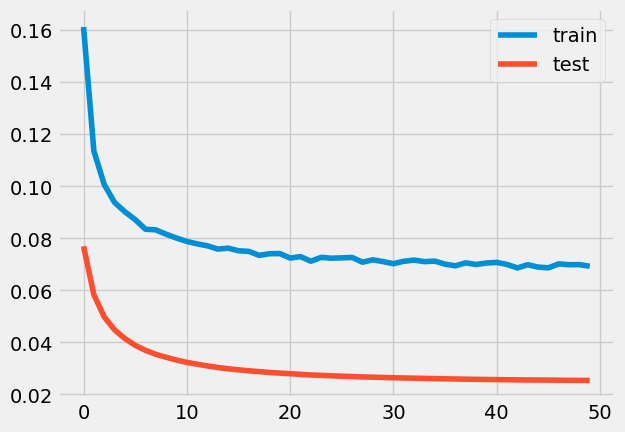

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 78ms/step - loss: 0.3456 - accuracy: 0.0000e+00 - val_loss: 0.2402 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 49ms/step - loss: 0.2536 - accuracy: 0.0000e+00 - val_loss: 0.1995 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

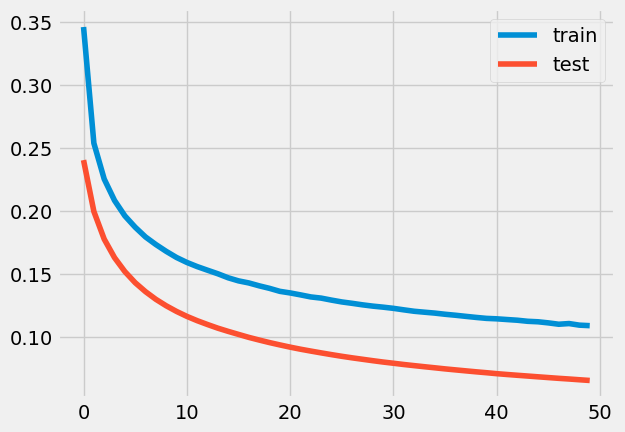

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 82ms/step - loss: 0.0925 - accuracy: 0.0018 - val_loss: 0.0295 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.0777 - accuracy: 0.0056 - val_loss: 0.0294 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

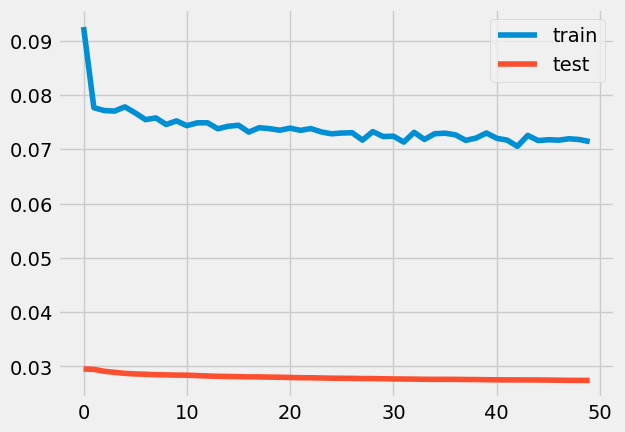

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 85ms/step - loss: 0.3236 - accuracy: 0.0000e+00 - val_loss: 0.2261 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 52ms/step - loss: 0.2417 - accuracy: 0.0000e+00 - val_loss: 0.1876 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

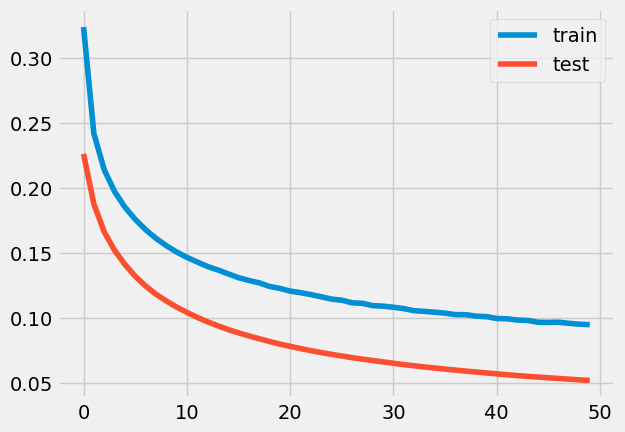

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 80ms/step - loss: 0.1311 - accuracy: 0.0000e+00 - val_loss: 0.0510 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 51ms/step - loss: 0.0937 - accuracy: 8.1352e-04 - val_loss: 0.0402 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

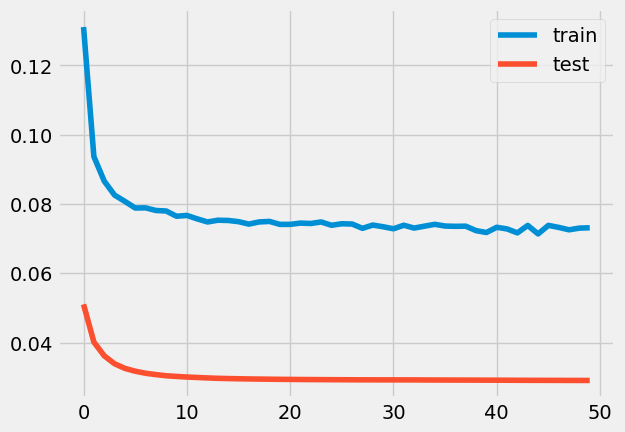

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 82ms/step - loss: 0.1977 - accuracy: 0.0000e+00 - val_loss: 0.0953 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 51ms/step - loss: 0.1265 - accuracy: 0.0000e+00 - val_loss: 0.0705 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

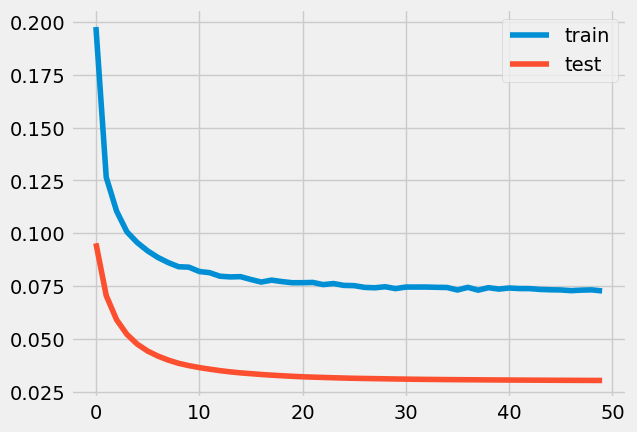

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 75ms/step - loss: 0.1436 - accuracy: 2.6639e-05 - val_loss: 0.0593 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 49ms/step - loss: 0.0988 - accuracy: 5.2459e-04 - val_loss: 0.0450 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

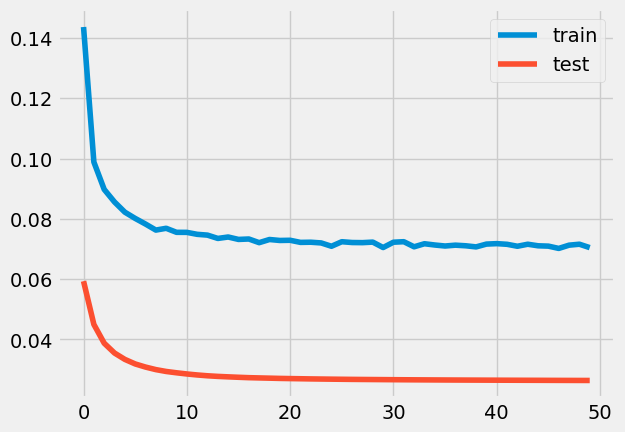

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 78ms/step - loss: 0.1603 - accuracy: 0.0000e+00 - val_loss: 0.0669 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 48ms/step - loss: 0.1034 - accuracy: 3.2377e-04 - val_loss: 0.0482 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

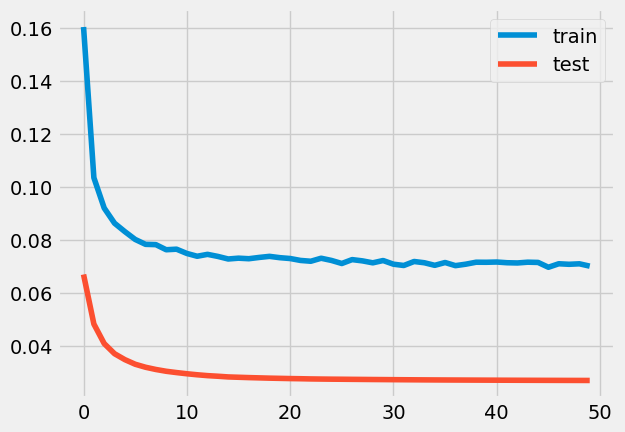

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 78ms/step - loss: 0.1436 - accuracy: 6.5574e-05 - val_loss: 0.0571 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.0962 - accuracy: 4.1803e-04 - val_loss: 0.0422 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

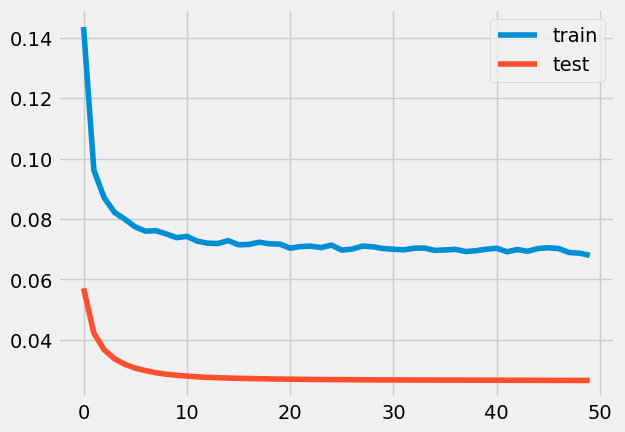

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 78ms/step - loss: 0.2484 - accuracy: 0.0000e+00 - val_loss: 0.1611 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 54ms/step - loss: 0.1884 - accuracy: 0.0000e+00 - val_loss: 0.1346 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

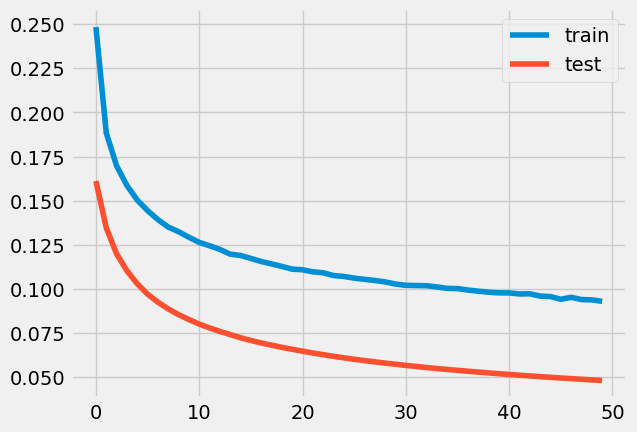

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 81ms/step - loss: 0.2523 - accuracy: 0.0000e+00 - val_loss: 0.1488 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 52ms/step - loss: 0.1722 - accuracy: 0.0000e+00 - val_loss: 0.1147 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

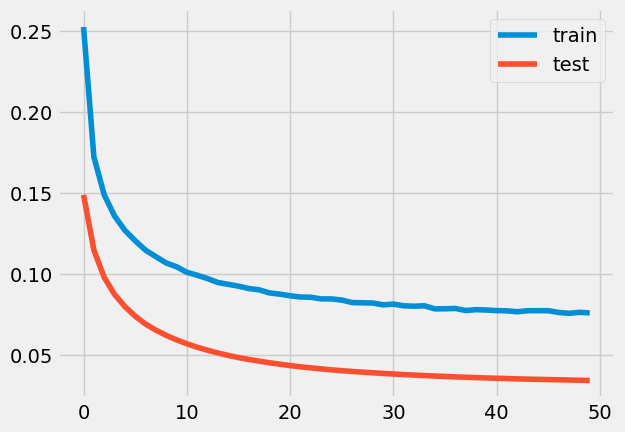

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 85ms/step - loss: 0.1934 - accuracy: 0.0000e+00 - val_loss: 0.1004 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 52ms/step - loss: 0.1343 - accuracy: 0.0000e+00 - val_loss: 0.0780 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

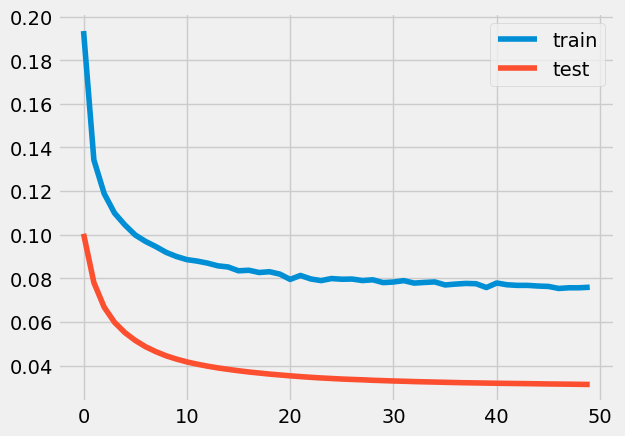

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 78ms/step - loss: 0.2095 - accuracy: 0.0000e+00 - val_loss: 0.1177 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.1484 - accuracy: 0.0000e+00 - val_loss: 0.0929 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

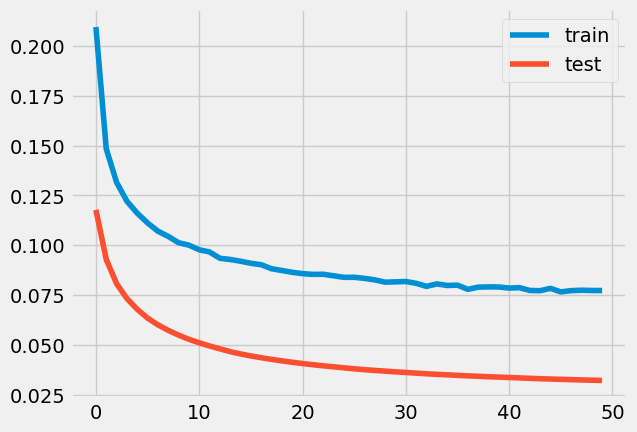

3.733641695139212e-05
3.90625e-05
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 79ms/step - loss: 0.2572 - accuracy: 0.0000e+00 - val_loss: 0.1702 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.1970 - accuracy: 0.0000e+00 - val_loss: 0.1427 - val_accur

20/20 [==============================] - 1s 52ms/step - loss: 0.0961 - accuracy: 6.4754e-04 - val_loss: 0.0504 - val_accuracy: 0.0000e+00

loss: 5.04%



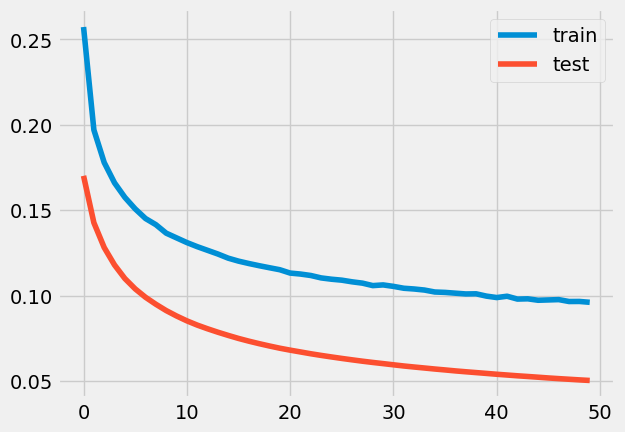

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 82ms/step - loss: 0.2340 - accuracy: 0.0000e+00 - val_loss: 0.1414 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 50ms/step - loss: 0.1703 - accuracy: 0.0000e+00 - val_loss: 0.1139 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

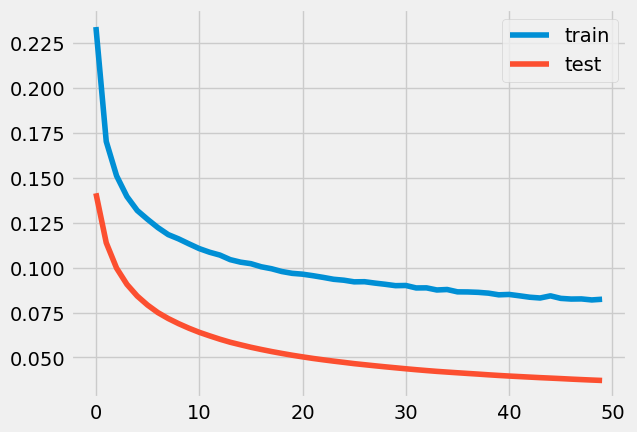

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 76ms/step - loss: 0.2547 - accuracy: 0.0000e+00 - val_loss: 0.1641 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 49ms/step - loss: 0.1882 - accuracy: 0.0000e+00 - val_loss: 0.1341 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

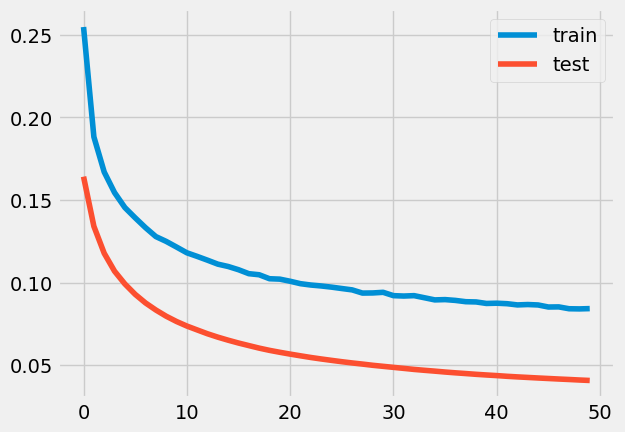

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 80ms/step - loss: 0.2442 - accuracy: 0.0000e+00 - val_loss: 0.1544 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 50ms/step - loss: 0.1821 - accuracy: 0.0000e+00 - val_loss: 0.1273 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

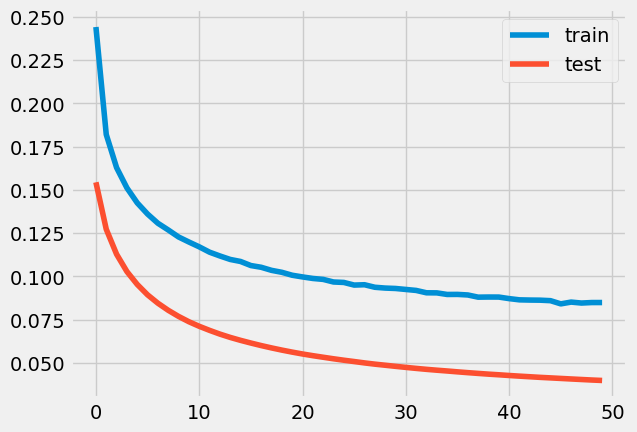

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 83ms/step - loss: 0.1810 - accuracy: 0.0000e+00 - val_loss: 0.0899 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 55ms/step - loss: 0.1246 - accuracy: 0.0000e+00 - val_loss: 0.0679 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

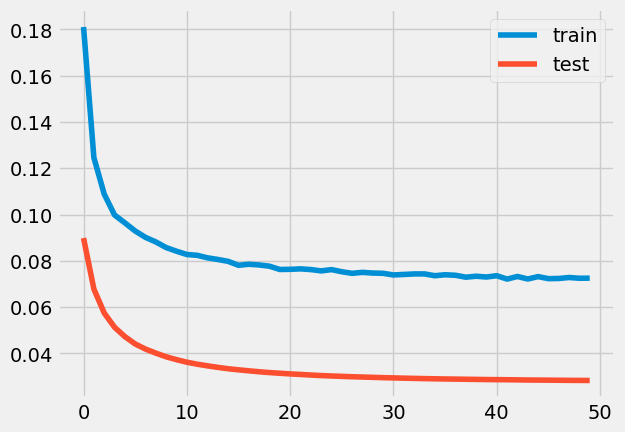

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 81ms/step - loss: 0.1127 - accuracy: 0.0011 - val_loss: 0.0365 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.0819 - accuracy: 0.0042 - val_loss: 0.0306 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

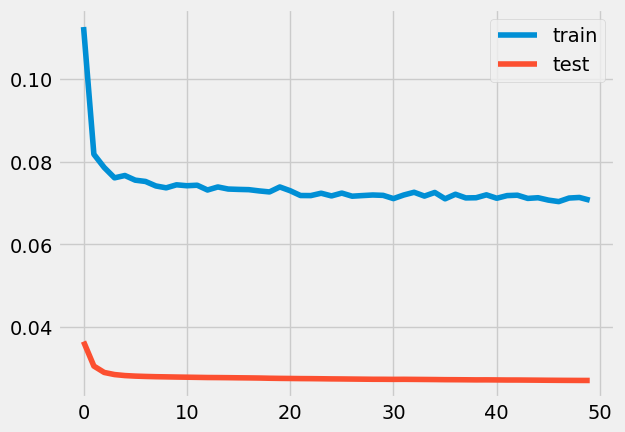

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 82ms/step - loss: 0.1460 - accuracy: 0.0000e+00 - val_loss: 0.0663 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 54ms/step - loss: 0.1074 - accuracy: 1.5574e-04 - val_loss: 0.0519 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

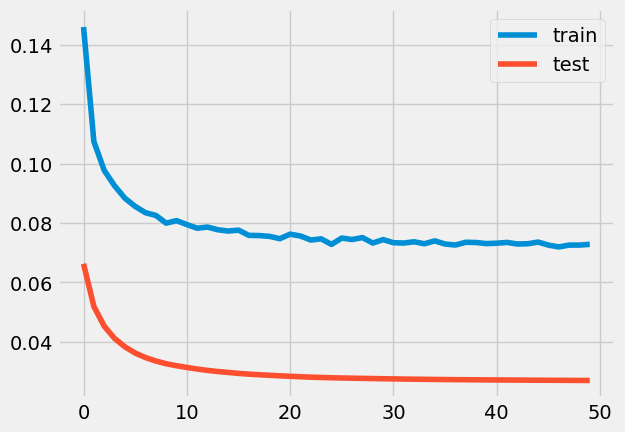

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 78ms/step - loss: 0.1663 - accuracy: 0.0000e+00 - val_loss: 0.0767 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 52ms/step - loss: 0.1142 - accuracy: 9.0164e-05 - val_loss: 0.0576 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

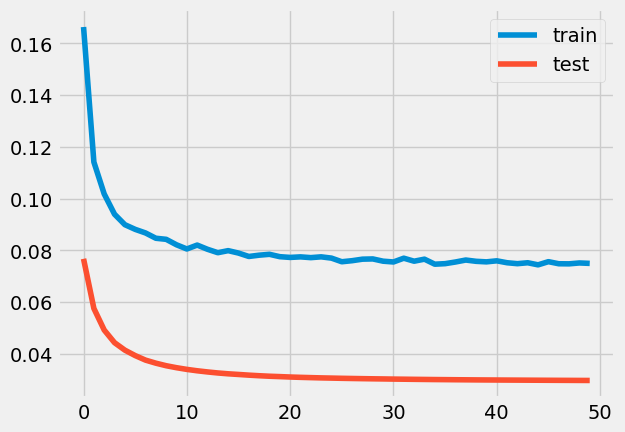

2.92993774408812e-31
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 80ms/step - loss: 0.2318 - accuracy: 0.0000e+00 - val_loss: 0.1342 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 52ms/step - loss: 0.1626 - accuracy: 0.0000e+00 - val_loss: 0.1042 - val_accuracy: 0.0000e+

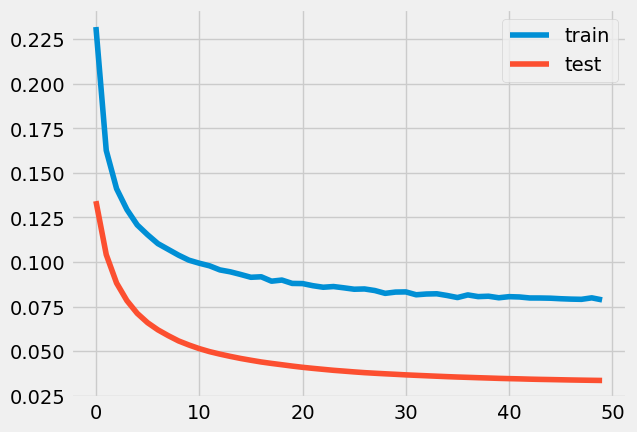

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 76ms/step - loss: 0.2650 - accuracy: 0.0000e+00 - val_loss: 0.1640 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 48ms/step - loss: 0.1860 - accuracy: 0.0000e+00 - val_loss: 0.1288 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [


loss: 3.65%



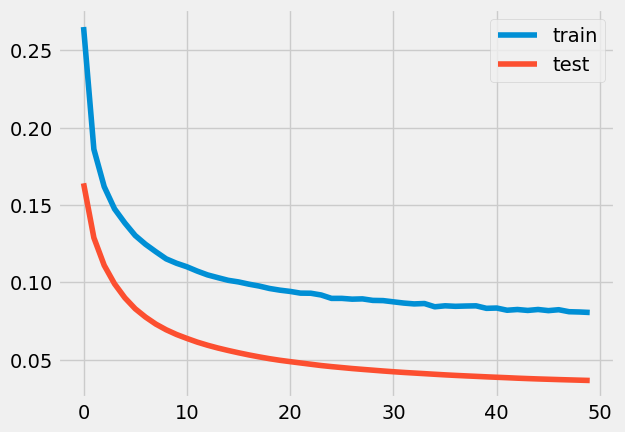

7.163917366895068e-34
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 80ms/step - loss: 0.1893 - accuracy: 0.0000e+00 - val_loss: 0.1031 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 47ms/step - loss: 0.1381 - accuracy: 0.0000e+00 - val_loss: 0.0820 - val_accuracy: 0.0000e


loss: 3.10%



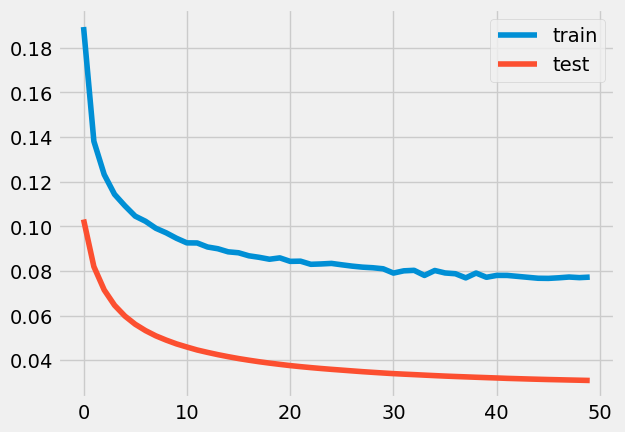

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 82ms/step - loss: 0.1396 - accuracy: 7.3770e-05 - val_loss: 0.0604 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 51ms/step - loss: 0.1020 - accuracy: 4.2418e-04 - val_loss: 0.0469 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

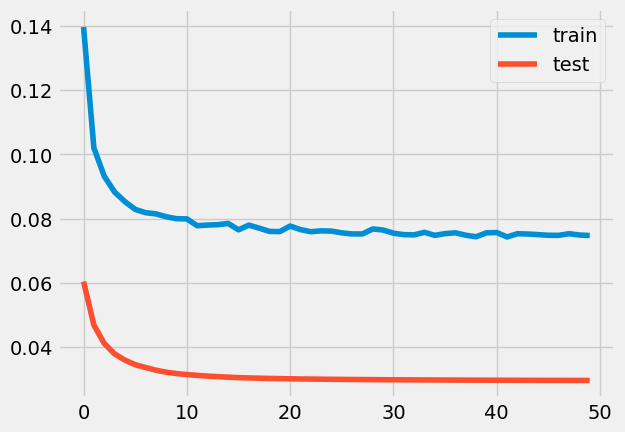

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 84ms/step - loss: 0.1533 - accuracy: 0.0000e+00 - val_loss: 0.0701 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 57ms/step - loss: 0.1092 - accuracy: 2.1721e-04 - val_loss: 0.0541 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

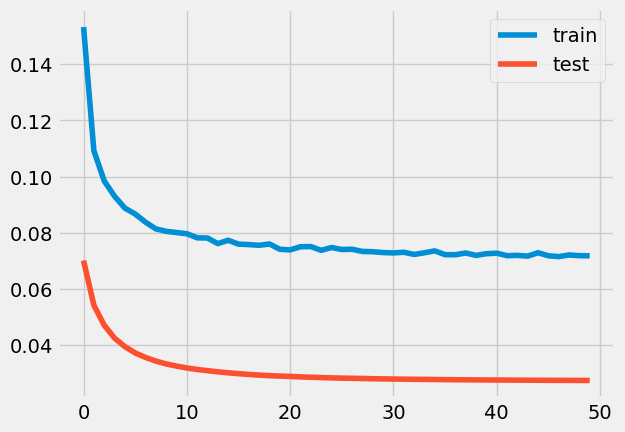

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 83ms/step - loss: 0.1113 - accuracy: 5.3893e-04 - val_loss: 0.0352 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 54ms/step - loss: 0.0824 - accuracy: 0.0028 - val_loss: 0.0301 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [====

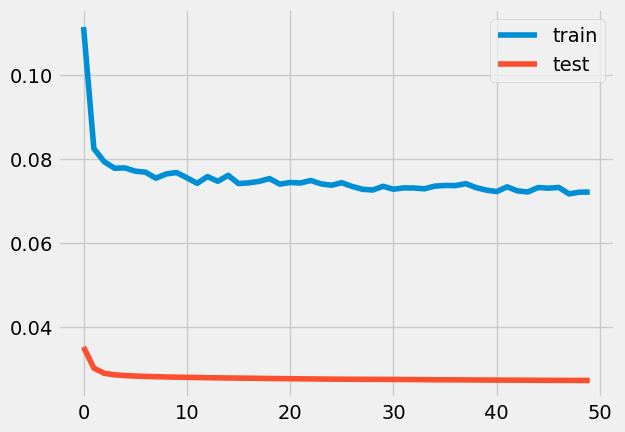

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 79ms/step - loss: 0.1408 - accuracy: 3.2787e-05 - val_loss: 0.0535 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 54ms/step - loss: 0.0939 - accuracy: 7.6434e-04 - val_loss: 0.0401 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

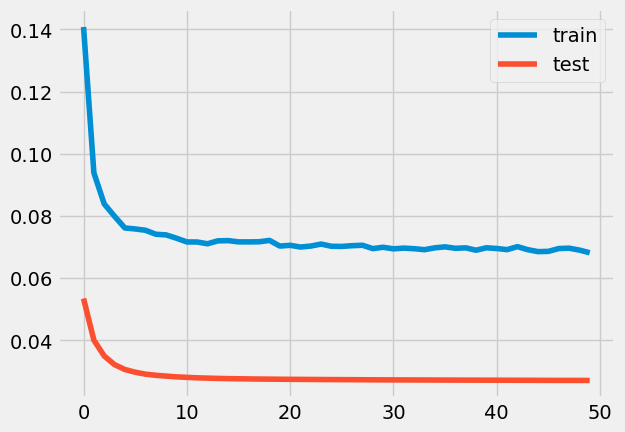

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 81ms/step - loss: 0.1916 - accuracy: 0.0000e+00 - val_loss: 0.0974 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 54ms/step - loss: 0.1327 - accuracy: 0.0000e+00 - val_loss: 0.0760 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

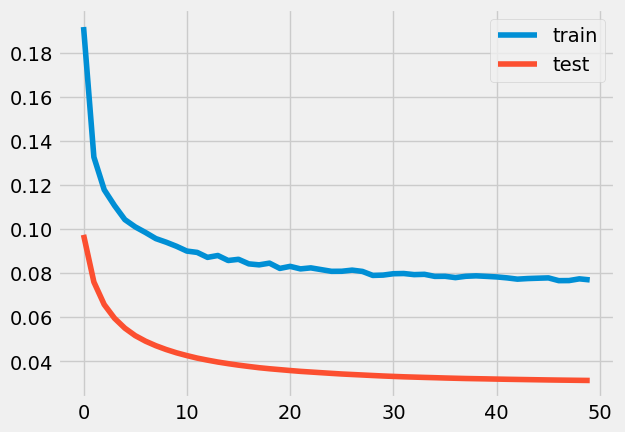

6.044547110004756e-48
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 79ms/step - loss: 0.1666 - accuracy: 0.0000e+00 - val_loss: 0.0760 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 50ms/step - loss: 0.1123 - accuracy: 1.1475e-04 - val_loss: 0.0564 - val_accuracy: 0.0000e

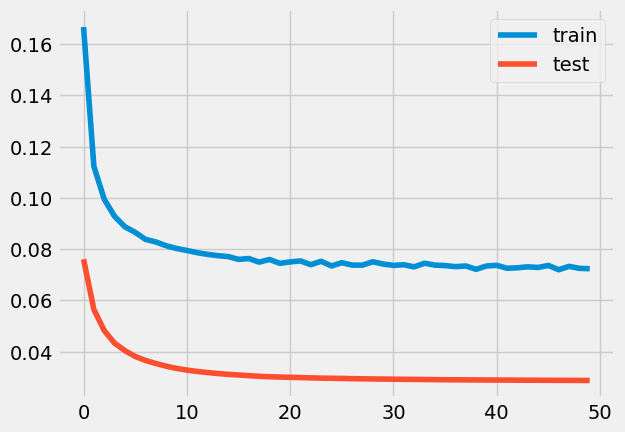

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 80ms/step - loss: 0.2872 - accuracy: 0.0000e+00 - val_loss: 0.1863 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 48ms/step - loss: 0.2058 - accuracy: 0.0000e+00 - val_loss: 0.1497 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

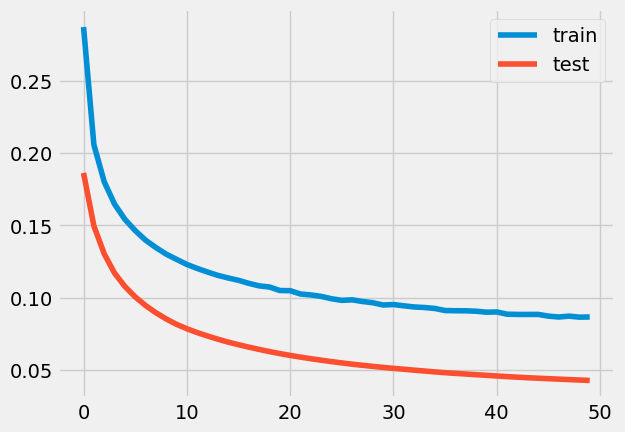

9.59426318688167e-158
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 81ms/step - loss: 0.1988 - accuracy: 0.0000e+00 - val_loss: 0.1089 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 50ms/step - loss: 0.1408 - accuracy: 0.0000e+00 - val_loss: 0.0849 - val_accuracy: 0.0000e

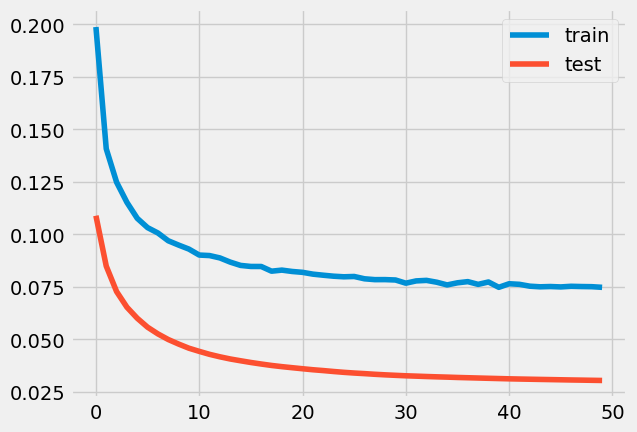

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 83ms/step - loss: 0.1204 - accuracy: 2.0492e-04 - val_loss: 0.0427 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.0863 - accuracy: 0.0019 - val_loss: 0.0339 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [====

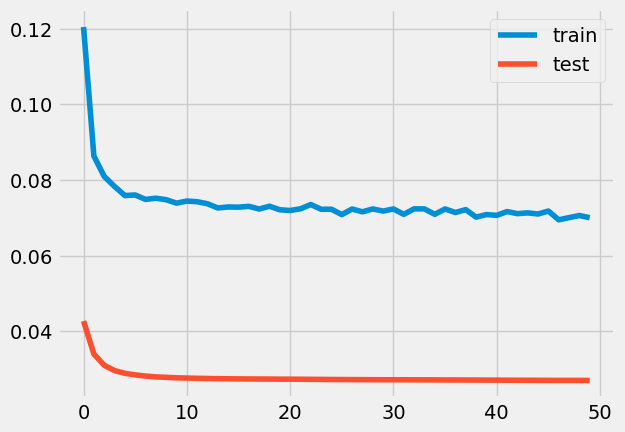

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 83ms/step - loss: 0.1429 - accuracy: 0.0000e+00 - val_loss: 0.0605 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.1002 - accuracy: 2.6434e-04 - val_loss: 0.0459 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

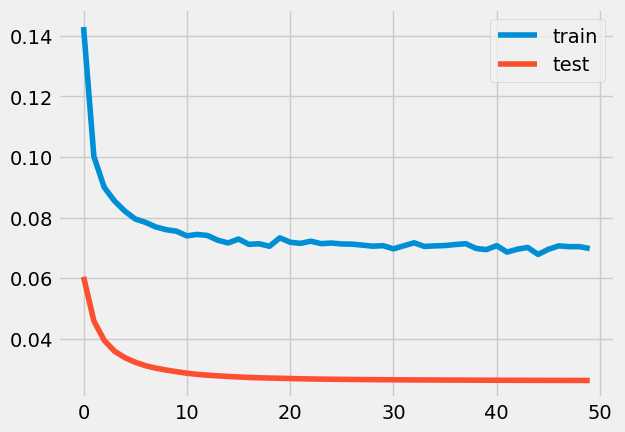

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 80ms/step - loss: 0.3226 - accuracy: 0.0000e+00 - val_loss: 0.2269 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 52ms/step - loss: 0.2440 - accuracy: 0.0000e+00 - val_loss: 0.1916 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

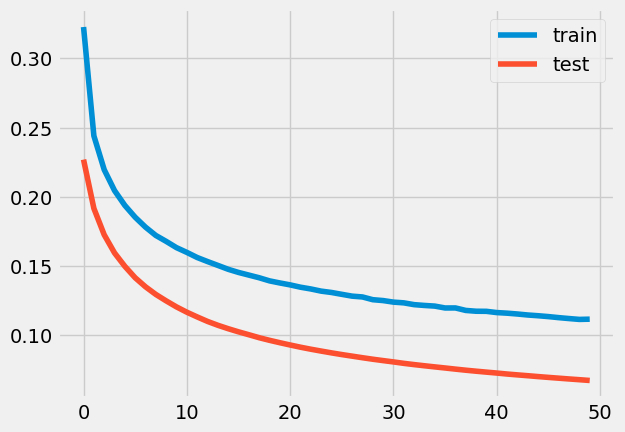

0.0
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 80ms/step - loss: 0.1551 - accuracy: 0.0000e+00 - val_loss: 0.0718 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.1108 - accuracy: 1.3320e-04 - val_loss: 0.0553 - val_accuracy: 0.0000e+00
Epoch 3/50
20/

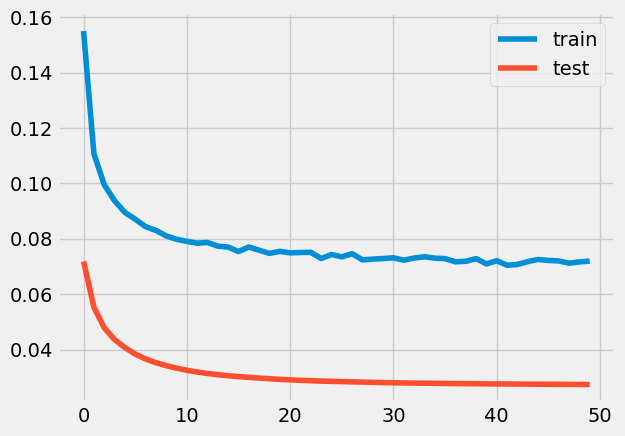

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 86ms/step - loss: 0.1438 - accuracy: 2.6639e-05 - val_loss: 0.0603 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.0997 - accuracy: 5.0410e-04 - val_loss: 0.0440 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

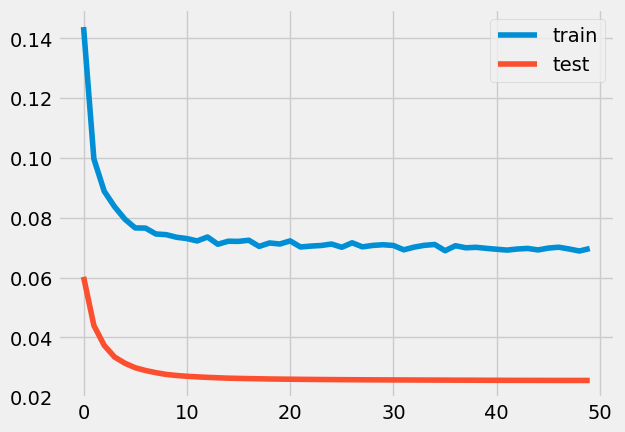

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 81ms/step - loss: 0.1712 - accuracy: 0.0000e+00 - val_loss: 0.0810 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 50ms/step - loss: 0.1178 - accuracy: 0.0000e+00 - val_loss: 0.0622 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

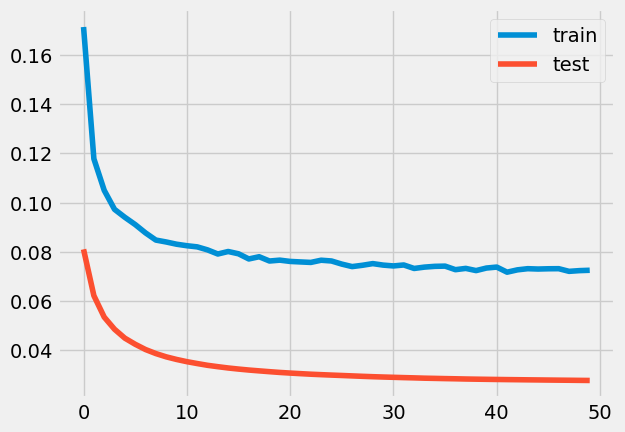

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 84ms/step - loss: 0.2160 - accuracy: 0.0000e+00 - val_loss: 0.1190 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 50ms/step - loss: 0.1465 - accuracy: 0.0000e+00 - val_loss: 0.0890 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

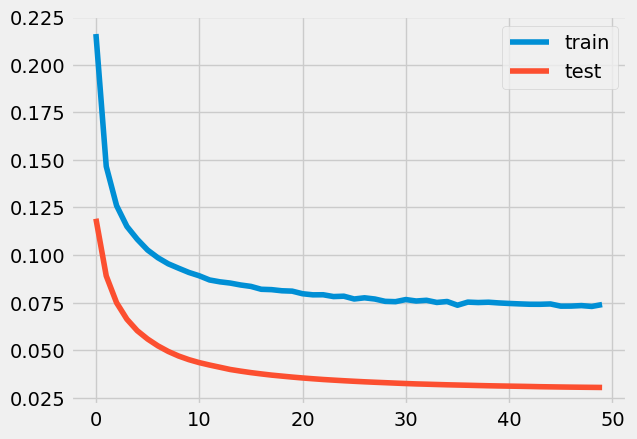

7.018243867497921e-30
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 86ms/step - loss: 0.3498 - accuracy: 0.0000e+00 - val_loss: 0.2506 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.2629 - accuracy: 0.0000e+00 - val_loss: 0.2104 - val_accuracy: 0.0000e

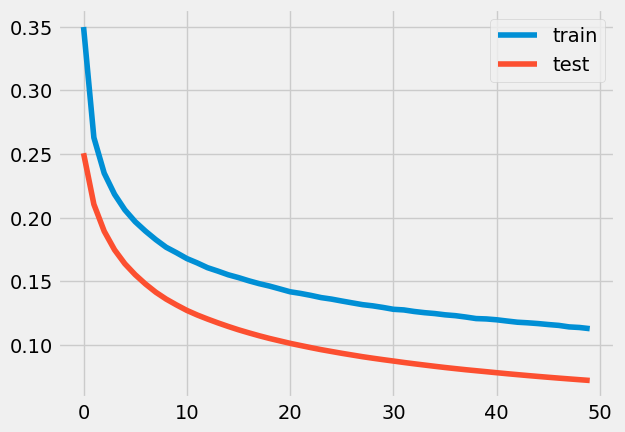

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 87ms/step - loss: 0.0890 - accuracy: 0.0049 - val_loss: 0.0309 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 55ms/step - loss: 0.0807 - accuracy: 0.0055 - val_loss: 0.0303 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

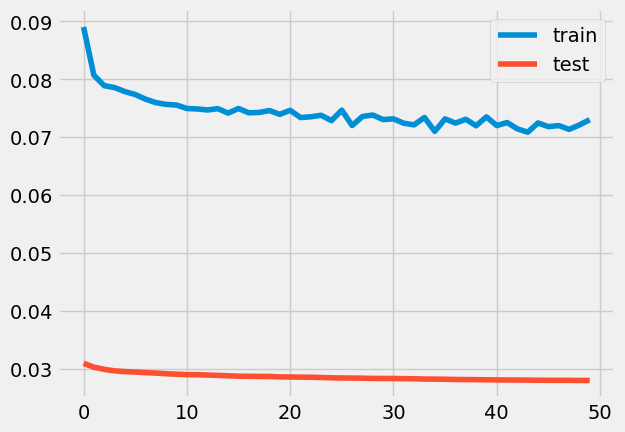

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 82ms/step - loss: 0.1511 - accuracy: 8.1967e-05 - val_loss: 0.0613 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 54ms/step - loss: 0.1017 - accuracy: 5.7787e-04 - val_loss: 0.0461 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

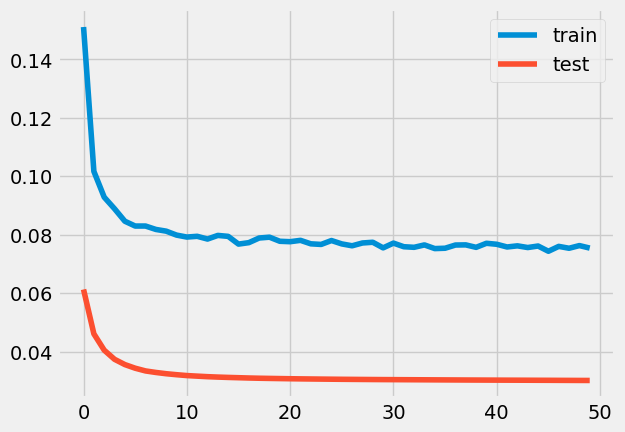

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 80ms/step - loss: 0.1946 - accuracy: 0.0000e+00 - val_loss: 0.1009 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 56ms/step - loss: 0.1330 - accuracy: 0.0000e+00 - val_loss: 0.0759 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

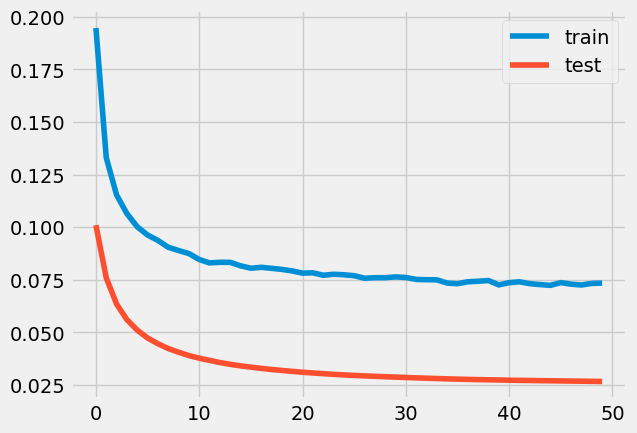

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 82ms/step - loss: 0.1049 - accuracy: 0.0027 - val_loss: 0.0344 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 55ms/step - loss: 0.0800 - accuracy: 0.0050 - val_loss: 0.0304 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

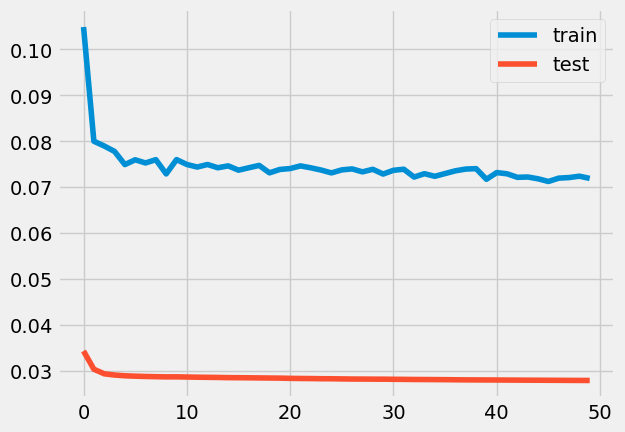

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 83ms/step - loss: 0.1086 - accuracy: 0.0011 - val_loss: 0.0360 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 52ms/step - loss: 0.0838 - accuracy: 0.0038 - val_loss: 0.0318 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

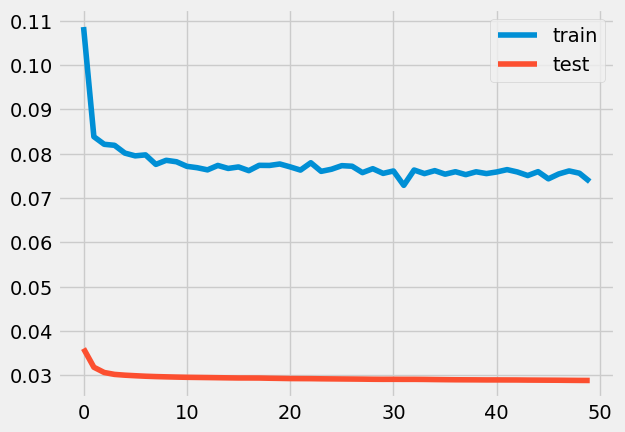

1.7429296802609538e-10
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 84ms/step - loss: 0.2773 - accuracy: 0.0000e+00 - val_loss: 0.1741 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 49ms/step - loss: 0.1950 - accuracy: 0.0000e+00 - val_loss: 0.1384 - val_accuracy: 0.0000

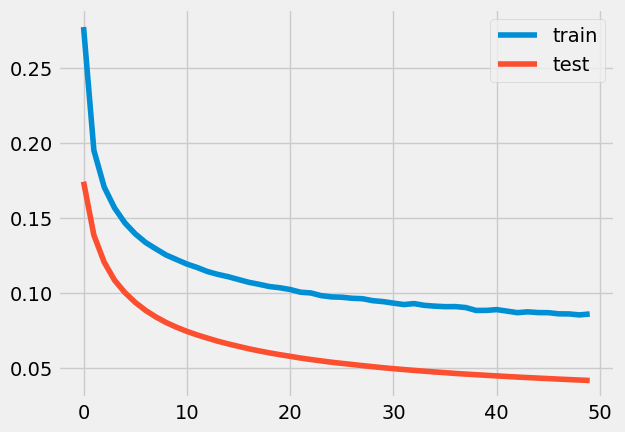

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 90ms/step - loss: 0.2145 - accuracy: 0.0000e+00 - val_loss: 0.1224 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 52ms/step - loss: 0.1538 - accuracy: 0.0000e+00 - val_loss: 0.0978 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

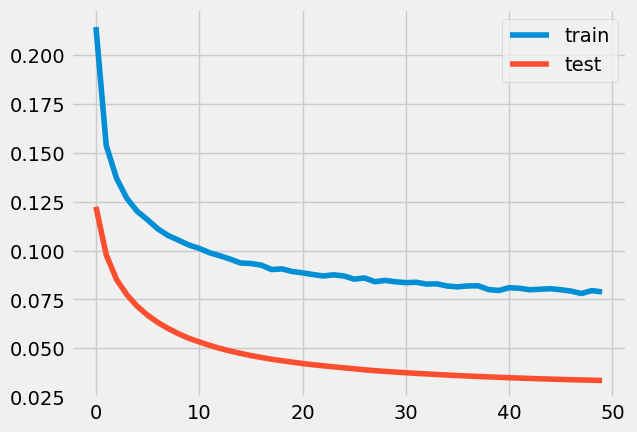

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 78ms/step - loss: 0.2049 - accuracy: 0.0000e+00 - val_loss: 0.0969 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 49ms/step - loss: 0.1296 - accuracy: 0.0000e+00 - val_loss: 0.0727 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

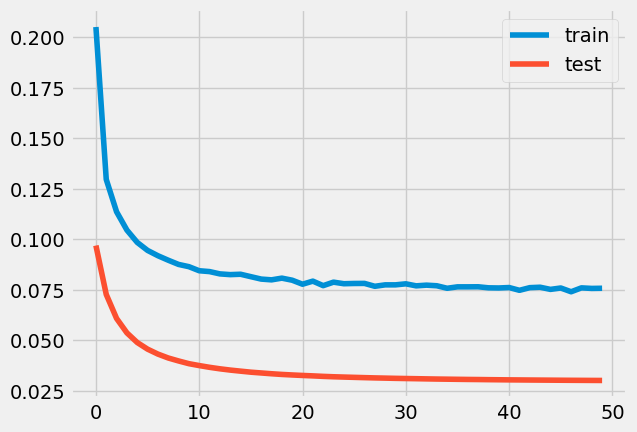

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 86ms/step - loss: 0.1733 - accuracy: 0.0000e+00 - val_loss: 0.0696 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 57ms/step - loss: 0.1037 - accuracy: 1.4754e-04 - val_loss: 0.0481 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

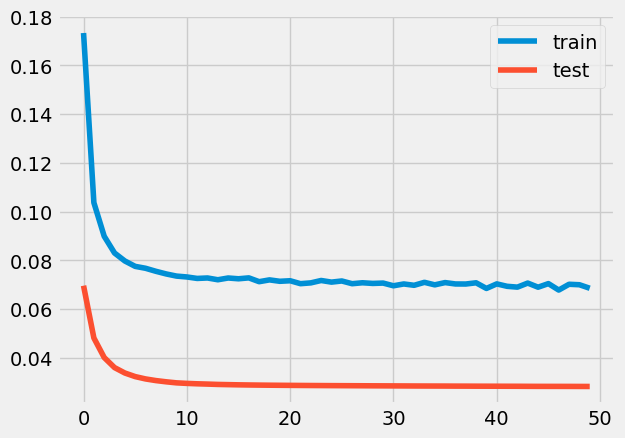

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 86ms/step - loss: 0.4415 - accuracy: 0.0000e+00 - val_loss: 0.3350 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 54ms/step - loss: 0.3358 - accuracy: 0.0000e+00 - val_loss: 0.2850 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

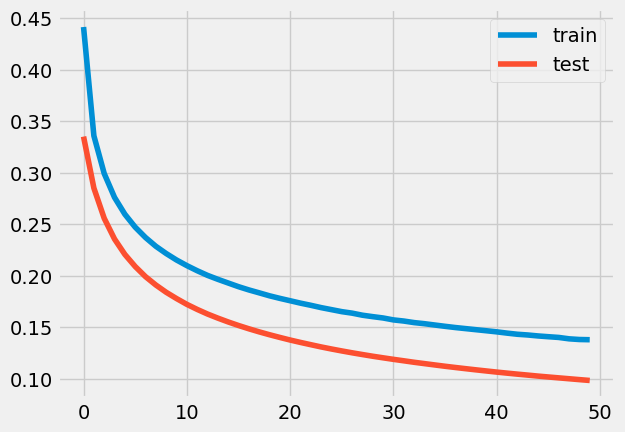

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 88ms/step - loss: 0.1430 - accuracy: 2.0492e-05 - val_loss: 0.0569 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 57ms/step - loss: 0.0975 - accuracy: 4.0779e-04 - val_loss: 0.0427 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

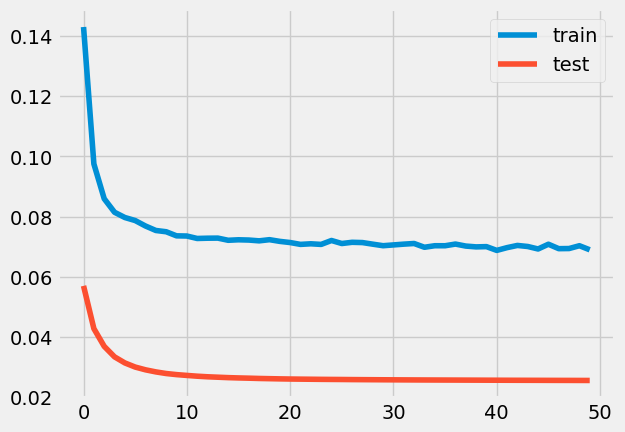

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 83ms/step - loss: 0.1602 - accuracy: 0.0000e+00 - val_loss: 0.0756 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.1135 - accuracy: 1.0656e-04 - val_loss: 0.0587 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

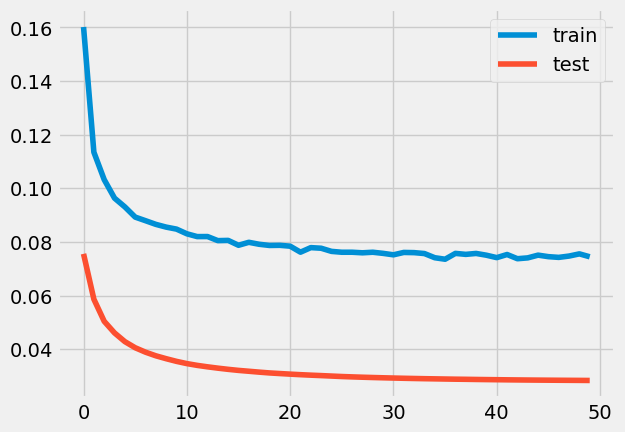

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 78ms/step - loss: 0.1939 - accuracy: 0.0000e+00 - val_loss: 0.1040 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 51ms/step - loss: 0.1364 - accuracy: 0.0000e+00 - val_loss: 0.0817 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

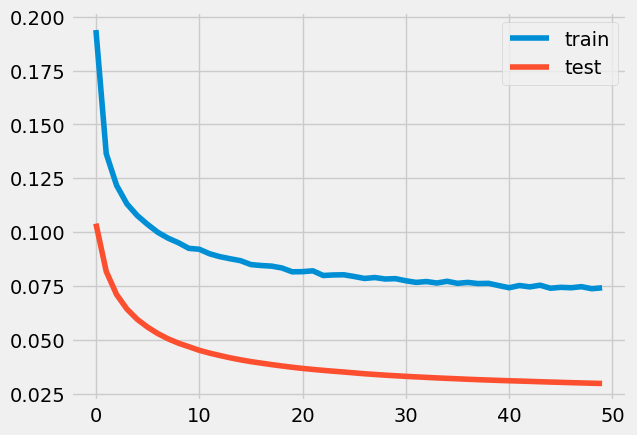

8.959412385062391e-16
1.953125e-05
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 76ms/step - loss: 0.2846 - accuracy: 0.0000e+00 - val_loss: 0.1582 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 46ms/step - loss: 0.1787 - accuracy: 0.0000e+00 - val_loss: 0.1190 - val_accu


loss: 3.53%



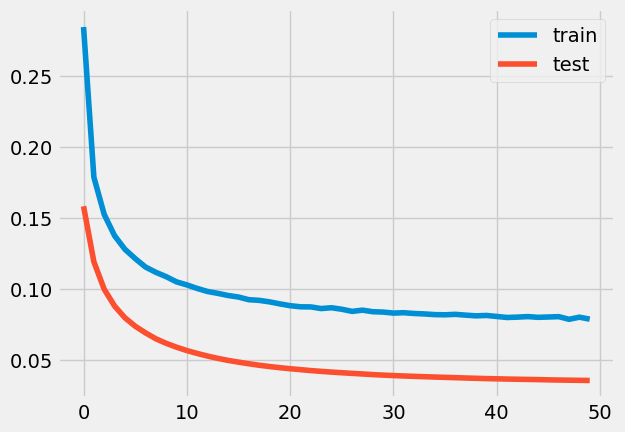

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 79ms/step - loss: 0.1398 - accuracy: 0.0000e+00 - val_loss: 0.0568 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 51ms/step - loss: 0.0975 - accuracy: 5.2664e-04 - val_loss: 0.0429 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

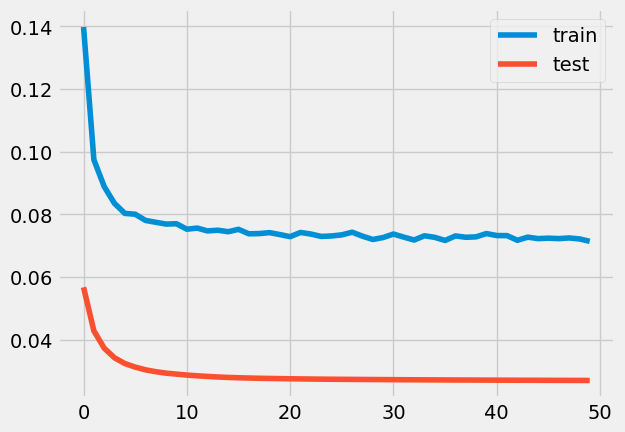

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 80ms/step - loss: 0.2382 - accuracy: 0.0000e+00 - val_loss: 0.1394 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.1659 - accuracy: 0.0000e+00 - val_loss: 0.1099 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [


loss: 3.34%



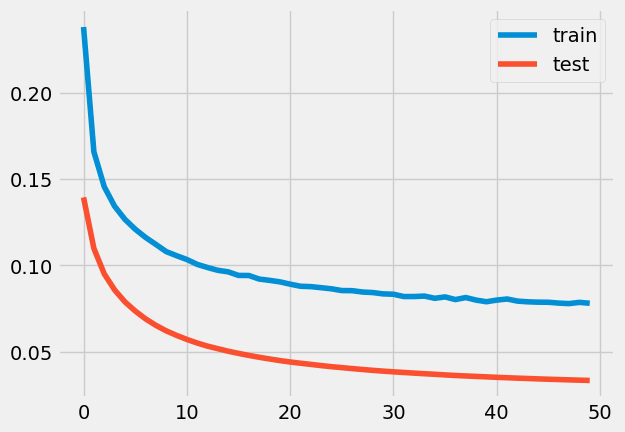

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 85ms/step - loss: 0.1110 - accuracy: 3.2787e-04 - val_loss: 0.0348 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 55ms/step - loss: 0.0811 - accuracy: 0.0027 - val_loss: 0.0291 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [====

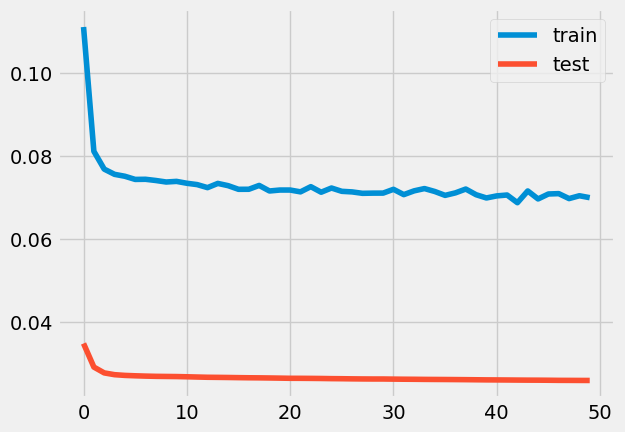

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 81ms/step - loss: 0.1898 - accuracy: 0.0000e+00 - val_loss: 0.1021 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 54ms/step - loss: 0.1360 - accuracy: 0.0000e+00 - val_loss: 0.0801 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

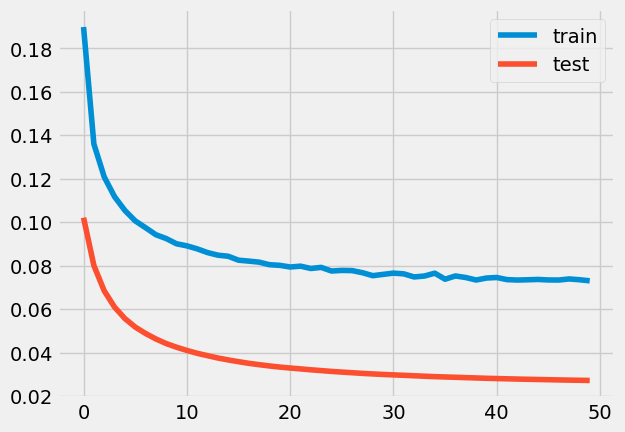

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 81ms/step - loss: 0.0944 - accuracy: 0.0032 - val_loss: 0.0291 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 54ms/step - loss: 0.0775 - accuracy: 0.0056 - val_loss: 0.0280 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

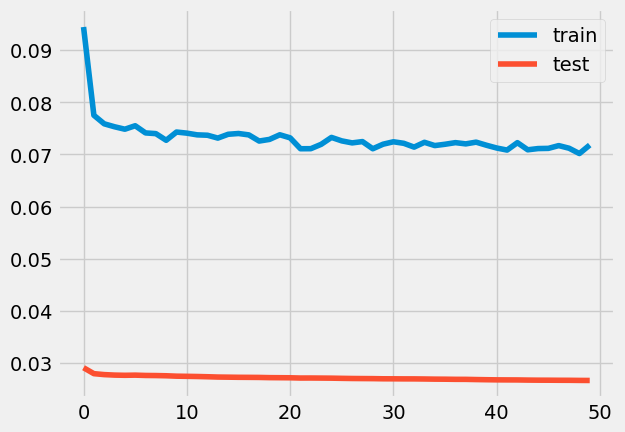

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 82ms/step - loss: 0.3149 - accuracy: 0.0000e+00 - val_loss: 0.2107 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.2254 - accuracy: 0.0000e+00 - val_loss: 0.1692 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

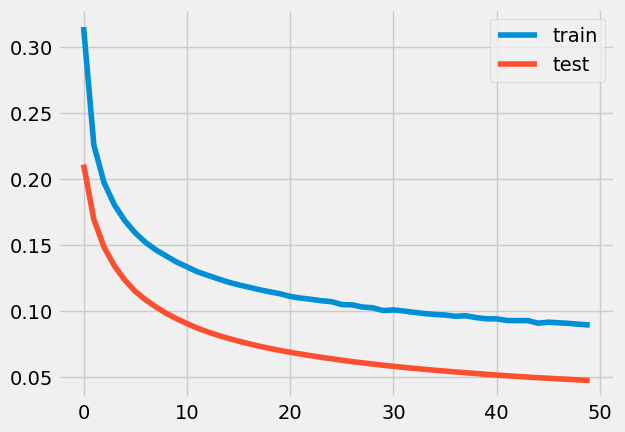

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 83ms/step - loss: 0.1475 - accuracy: 6.1475e-06 - val_loss: 0.0629 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 49ms/step - loss: 0.1033 - accuracy: 1.4549e-04 - val_loss: 0.0484 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

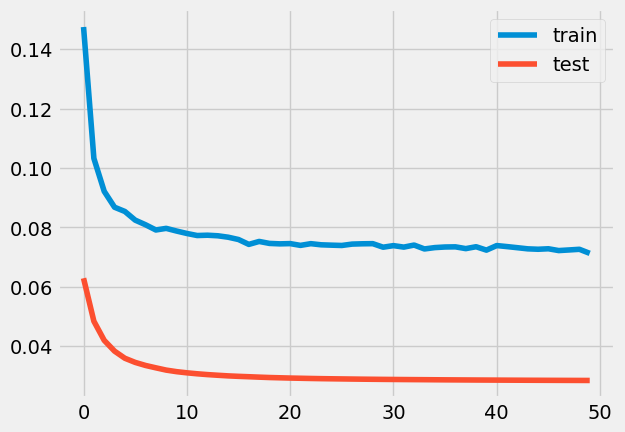

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 78ms/step - loss: 0.1559 - accuracy: 0.0000e+00 - val_loss: 0.0726 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 47ms/step - loss: 0.1112 - accuracy: 6.7623e-05 - val_loss: 0.0558 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

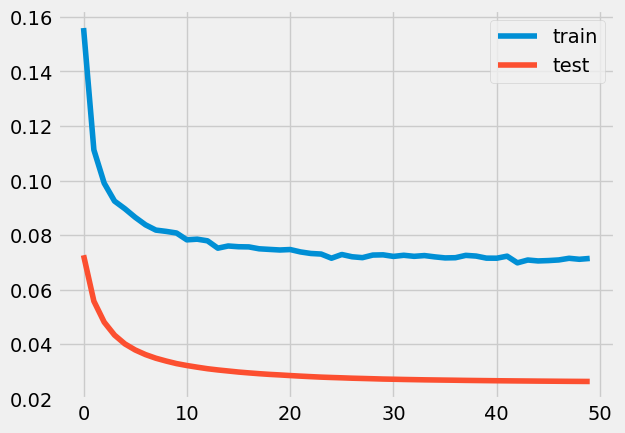

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 86ms/step - loss: 0.1657 - accuracy: 0.0000e+00 - val_loss: 0.0756 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 54ms/step - loss: 0.1118 - accuracy: 1.1475e-04 - val_loss: 0.0553 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

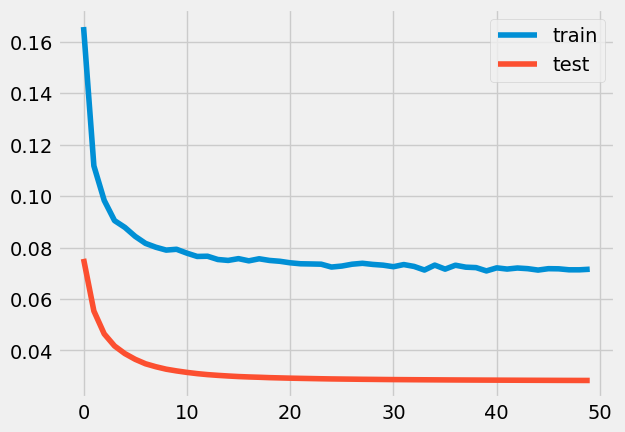

2.3874455590968847e-45
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 83ms/step - loss: 0.1814 - accuracy: 0.0000e+00 - val_loss: 0.0837 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 56ms/step - loss: 0.1181 - accuracy: 8.1967e-06 - val_loss: 0.0625 - val_accuracy: 0.0000

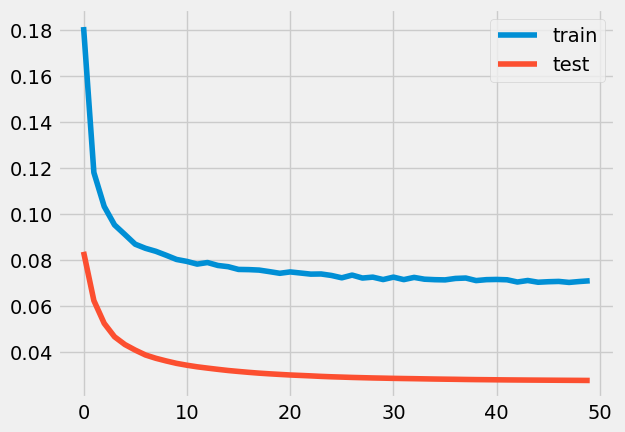

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 91ms/step - loss: 0.1268 - accuracy: 3.1967e-04 - val_loss: 0.0472 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 60ms/step - loss: 0.0904 - accuracy: 0.0012 - val_loss: 0.0362 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [====

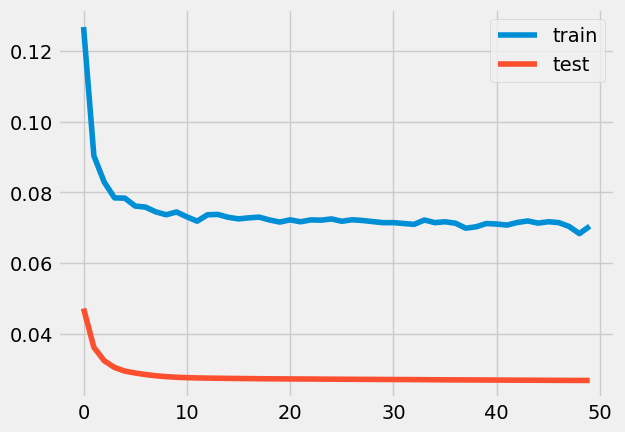

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 87ms/step - loss: 0.1412 - accuracy: 7.7869e-05 - val_loss: 0.0536 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 59ms/step - loss: 0.0942 - accuracy: 9.8361e-04 - val_loss: 0.0398 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

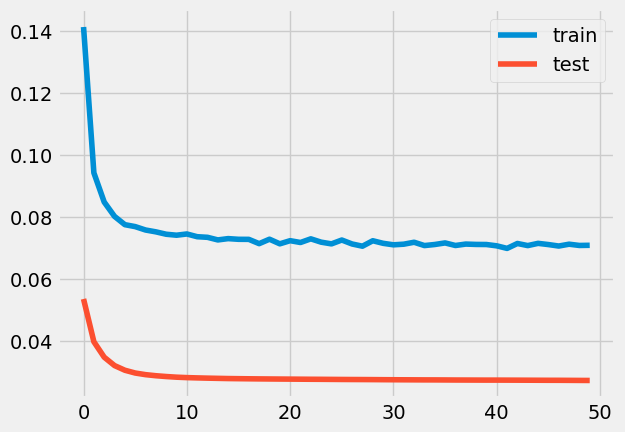

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 79ms/step - loss: 0.1921 - accuracy: 0.0000e+00 - val_loss: 0.1042 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 57ms/step - loss: 0.1393 - accuracy: 0.0000e+00 - val_loss: 0.0827 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

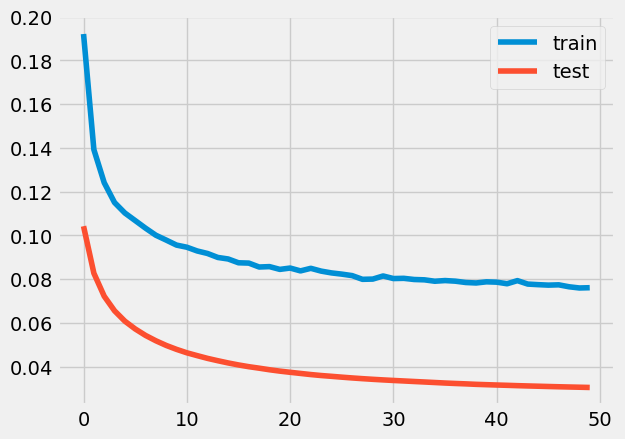

7.902678307715628e-71
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 82ms/step - loss: 0.2780 - accuracy: 0.0000e+00 - val_loss: 0.1829 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 55ms/step - loss: 0.2042 - accuracy: 0.0000e+00 - val_loss: 0.1477 - val_accuracy: 0.0000e

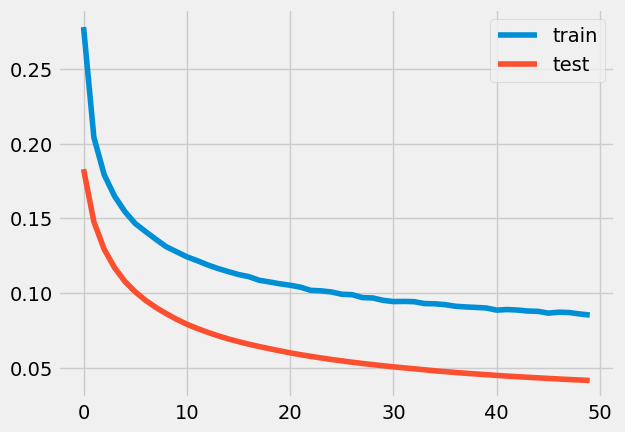

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 85ms/step - loss: 0.2670 - accuracy: 0.0000e+00 - val_loss: 0.1761 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 51ms/step - loss: 0.2008 - accuracy: 0.0000e+00 - val_loss: 0.1465 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

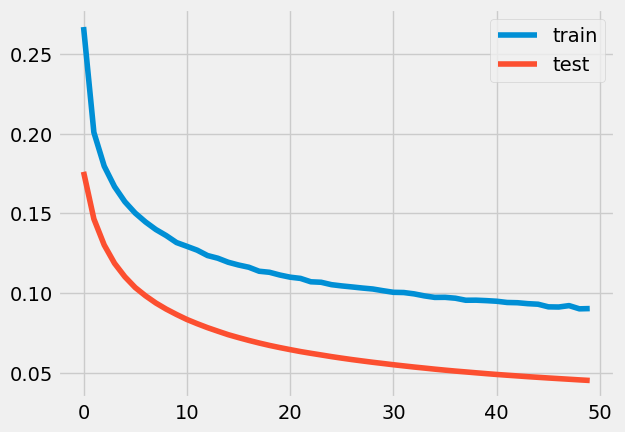

3.1257566973960813e-80
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 79ms/step - loss: 0.2709 - accuracy: 0.0000e+00 - val_loss: 0.1728 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 49ms/step - loss: 0.1967 - accuracy: 0.0000e+00 - val_loss: 0.1414 - val_accuracy: 0.0000

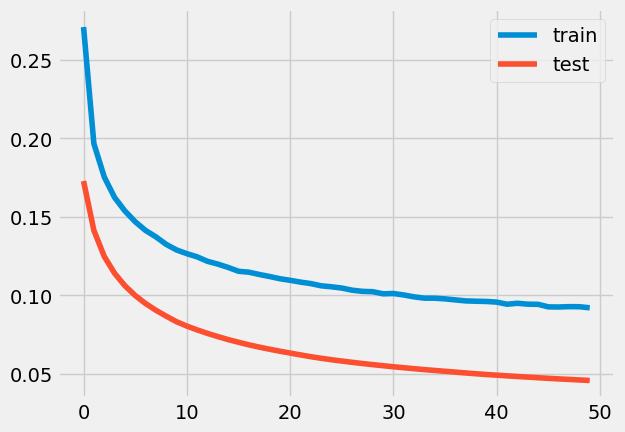

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 76ms/step - loss: 0.3919 - accuracy: 0.0000e+00 - val_loss: 0.2773 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.2831 - accuracy: 0.0000e+00 - val_loss: 0.2301 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

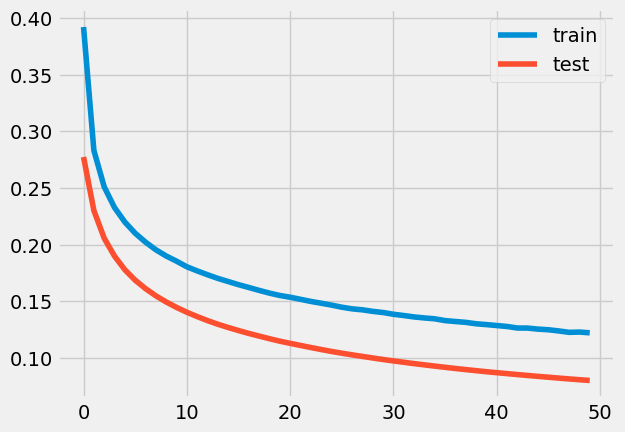

0.0
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 87ms/step - loss: 0.2387 - accuracy: 0.0000e+00 - val_loss: 0.1465 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 56ms/step - loss: 0.1745 - accuracy: 0.0000e+00 - val_loss: 0.1183 - val_accuracy: 0.0000e+00
Epoch 3/50
20/


loss: 3.69%



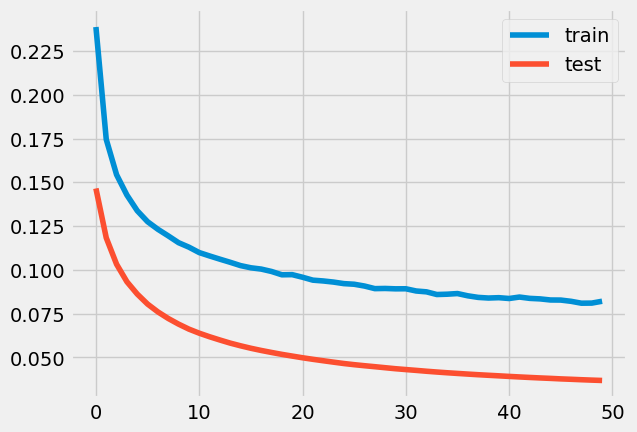

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 82ms/step - loss: 0.1152 - accuracy: 5.8607e-04 - val_loss: 0.0400 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 57ms/step - loss: 0.0852 - accuracy: 0.0019 - val_loss: 0.0322 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [====

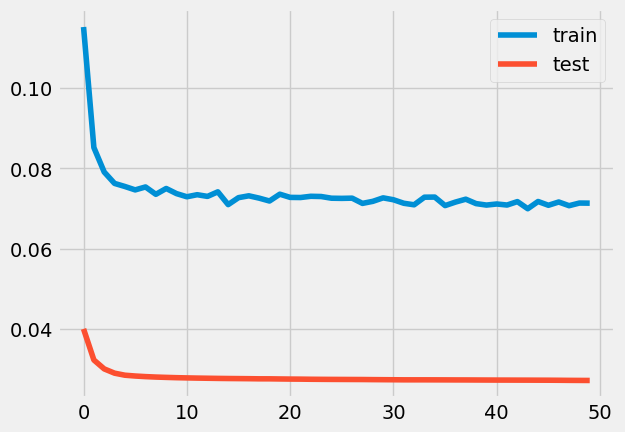

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 81ms/step - loss: 0.1710 - accuracy: 0.0000e+00 - val_loss: 0.0737 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 55ms/step - loss: 0.1107 - accuracy: 2.1926e-04 - val_loss: 0.0537 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

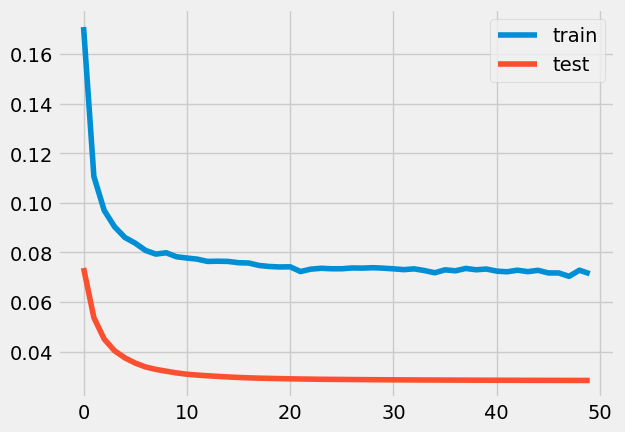

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 83ms/step - loss: 0.1857 - accuracy: 0.0000e+00 - val_loss: 0.0873 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 56ms/step - loss: 0.1205 - accuracy: 0.0000e+00 - val_loss: 0.0642 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

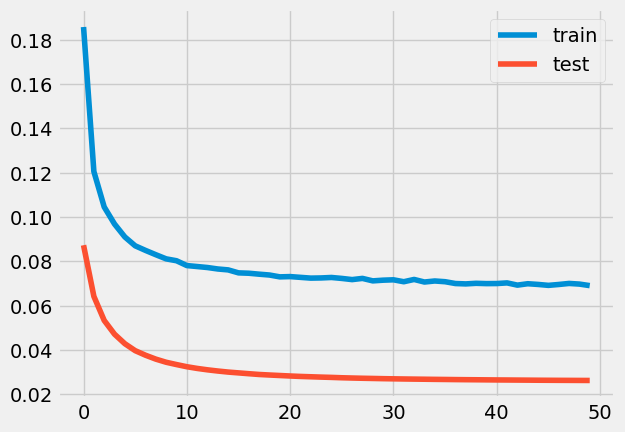

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 80ms/step - loss: 0.2061 - accuracy: 0.0000e+00 - val_loss: 0.1148 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 52ms/step - loss: 0.1462 - accuracy: 0.0000e+00 - val_loss: 0.0899 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

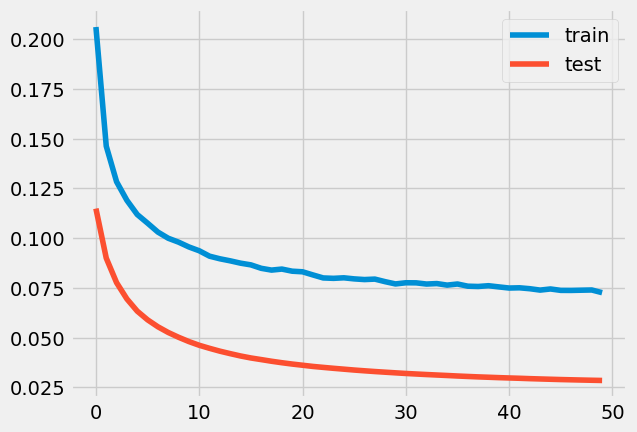

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 78ms/step - loss: 0.2157 - accuracy: 0.0000e+00 - val_loss: 0.1180 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 49ms/step - loss: 0.1474 - accuracy: 0.0000e+00 - val_loss: 0.0912 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

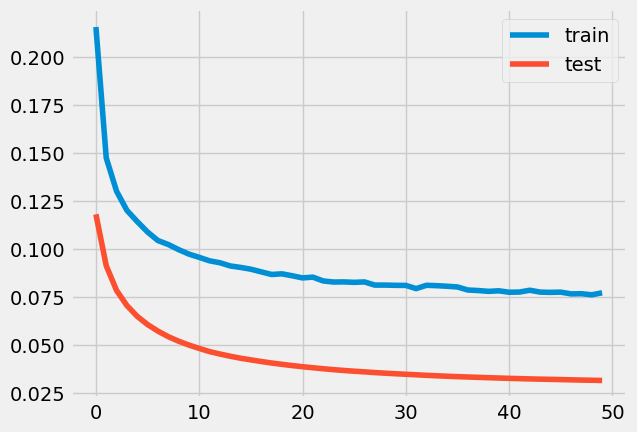

3.2770647496915774e-65
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 84ms/step - loss: 0.1390 - accuracy: 0.0000e+00 - val_loss: 0.0557 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 50ms/step - loss: 0.0966 - accuracy: 5.0000e-04 - val_loss: 0.0411 - val_accuracy: 0.0000

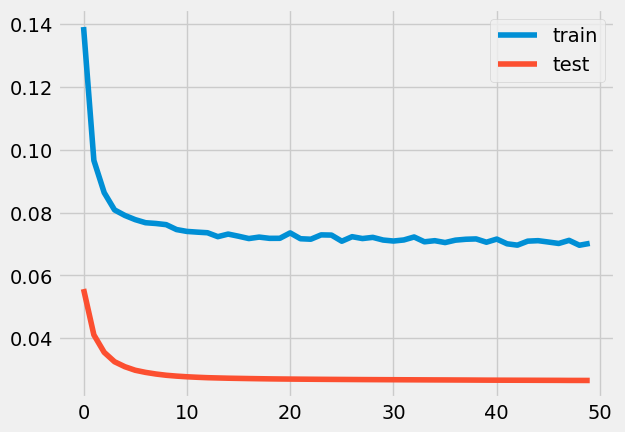

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 81ms/step - loss: 0.1520 - accuracy: 0.0000e+00 - val_loss: 0.0695 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 51ms/step - loss: 0.1069 - accuracy: 1.4549e-04 - val_loss: 0.0521 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

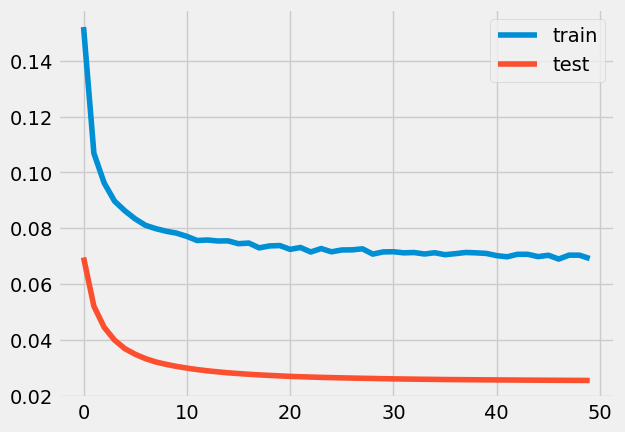

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 84ms/step - loss: 0.3419 - accuracy: 0.0000e+00 - val_loss: 0.2416 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 55ms/step - loss: 0.2557 - accuracy: 0.0000e+00 - val_loss: 0.2028 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

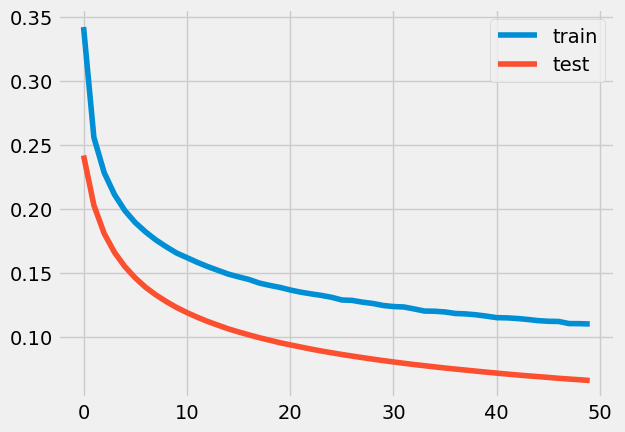

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 80ms/step - loss: 0.1555 - accuracy: 0.0000e+00 - val_loss: 0.0722 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 54ms/step - loss: 0.1114 - accuracy: 2.0492e-05 - val_loss: 0.0565 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

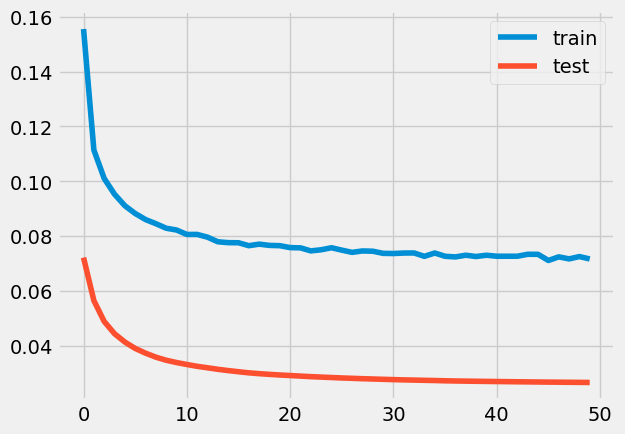

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 79ms/step - loss: 0.2539 - accuracy: 0.0000e+00 - val_loss: 0.1500 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 55ms/step - loss: 0.1723 - accuracy: 0.0000e+00 - val_loss: 0.1154 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

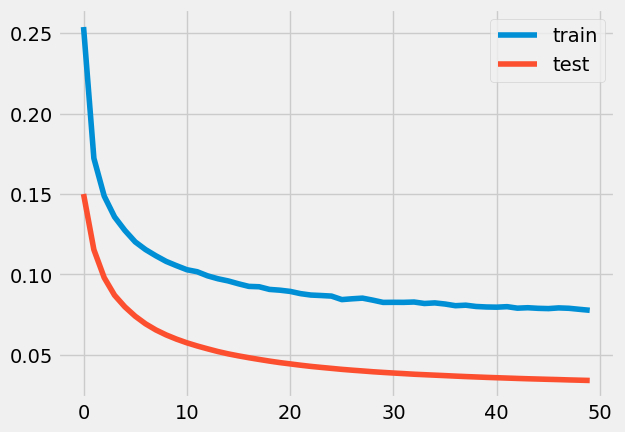

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 85ms/step - loss: 0.2228 - accuracy: 0.0000e+00 - val_loss: 0.1305 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 54ms/step - loss: 0.1606 - accuracy: 0.0000e+00 - val_loss: 0.1051 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [


loss: 3.51%



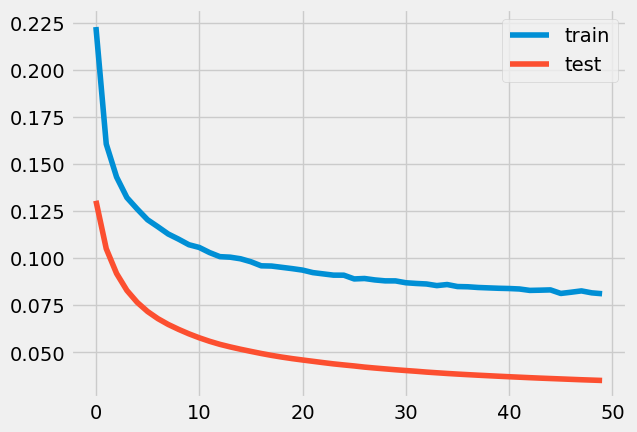

1.5447416275559742e-22
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 73ms/step - loss: 0.2353 - accuracy: 0.0000e+00 - val_loss: 0.1337 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 50ms/step - loss: 0.1605 - accuracy: 0.0000e+00 - val_loss: 0.1031 - val_accuracy: 0.0000


loss: 3.20%



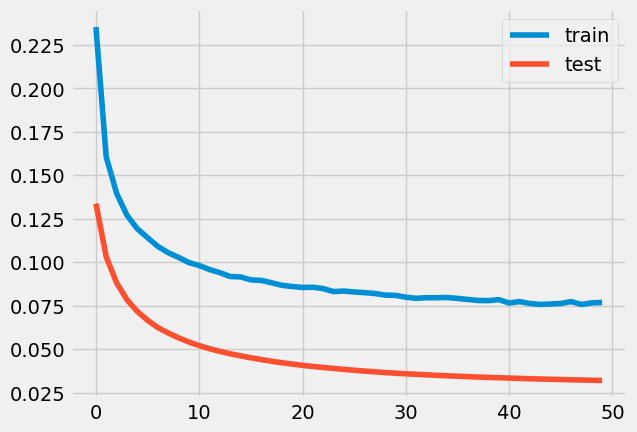

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 81ms/step - loss: 0.1907 - accuracy: 0.0000e+00 - val_loss: 0.0983 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 50ms/step - loss: 0.1320 - accuracy: 0.0000e+00 - val_loss: 0.0747 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

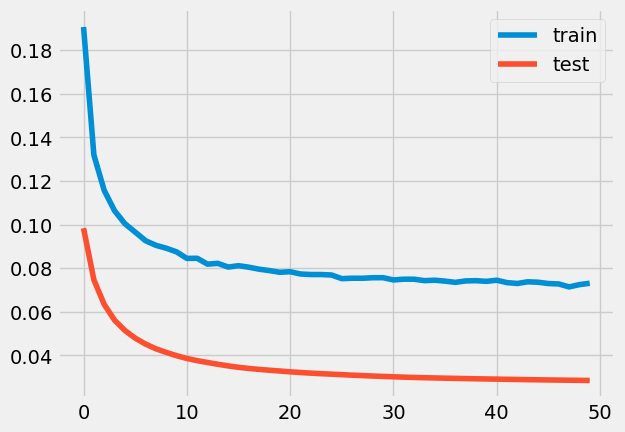

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 83ms/step - loss: 0.1558 - accuracy: 0.0000e+00 - val_loss: 0.0668 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 52ms/step - loss: 0.1043 - accuracy: 8.6066e-05 - val_loss: 0.0498 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

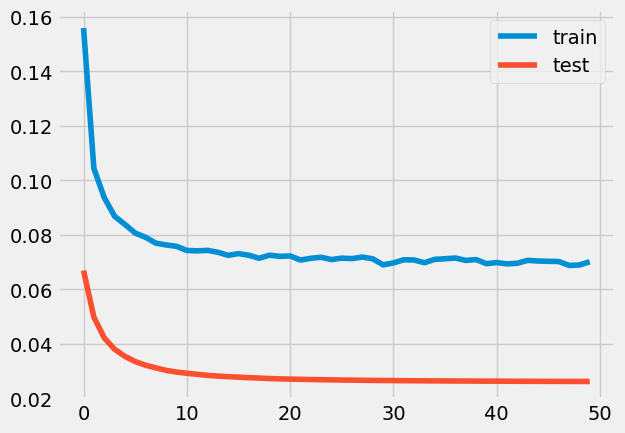

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 89ms/step - loss: 0.2668 - accuracy: 0.0000e+00 - val_loss: 0.1660 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 56ms/step - loss: 0.1901 - accuracy: 0.0000e+00 - val_loss: 0.1349 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

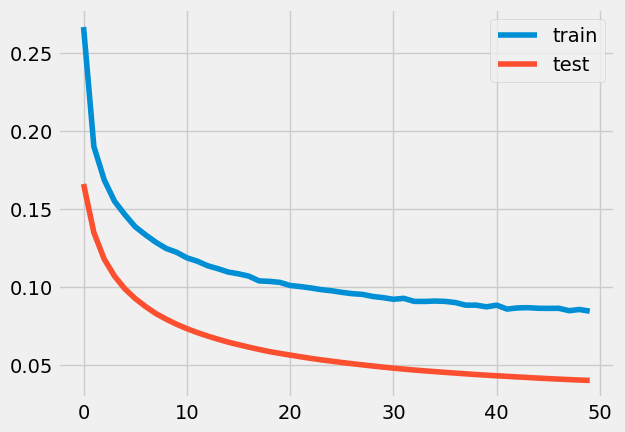

1.2349921326752383e-305
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 90ms/step - loss: 0.2140 - accuracy: 0.0000e+00 - val_loss: 0.1151 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 56ms/step - loss: 0.1441 - accuracy: 0.0000e+00 - val_loss: 0.0870 - val_accuracy: 0.000

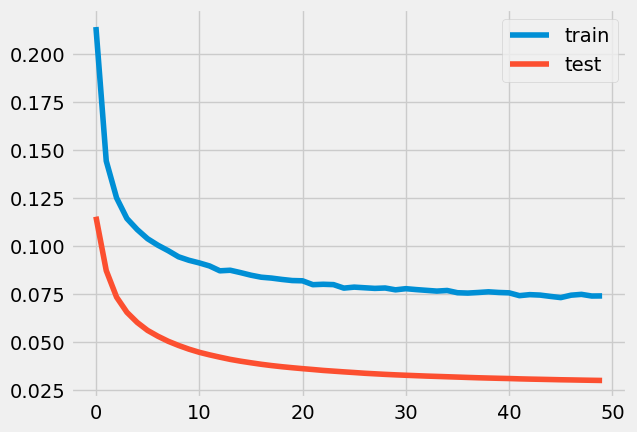

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 83ms/step - loss: 0.2619 - accuracy: 0.0000e+00 - val_loss: 0.1577 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 55ms/step - loss: 0.1789 - accuracy: 0.0000e+00 - val_loss: 0.1208 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [


loss: 3.33%



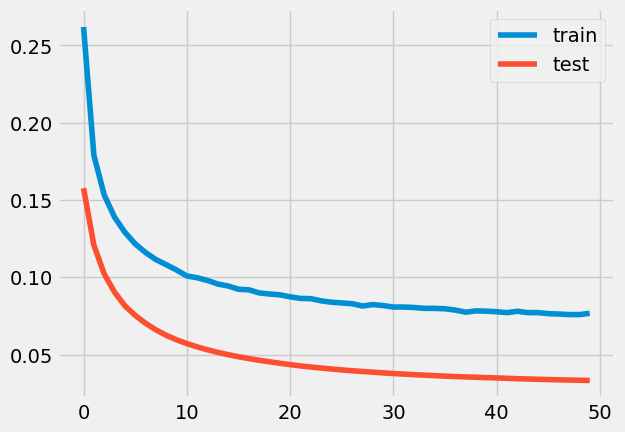

2.2568336577644863e-79
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 87ms/step - loss: 0.1841 - accuracy: 0.0000e+00 - val_loss: 0.0989 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 56ms/step - loss: 0.1345 - accuracy: 0.0000e+00 - val_loss: 0.0799 - val_accuracy: 0.0000

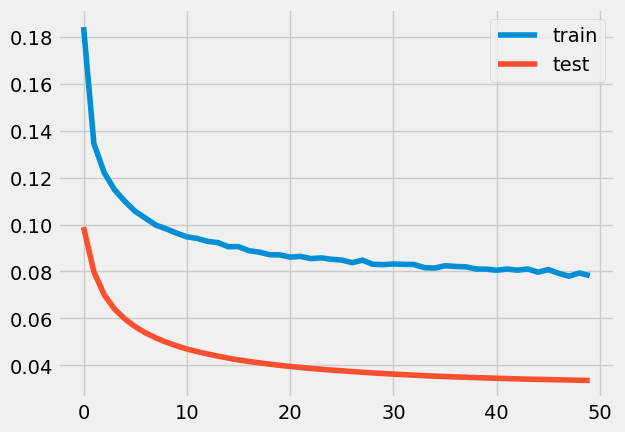

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 83ms/step - loss: 0.2754 - accuracy: 0.0000e+00 - val_loss: 0.1848 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.2073 - accuracy: 0.0000e+00 - val_loss: 0.1526 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

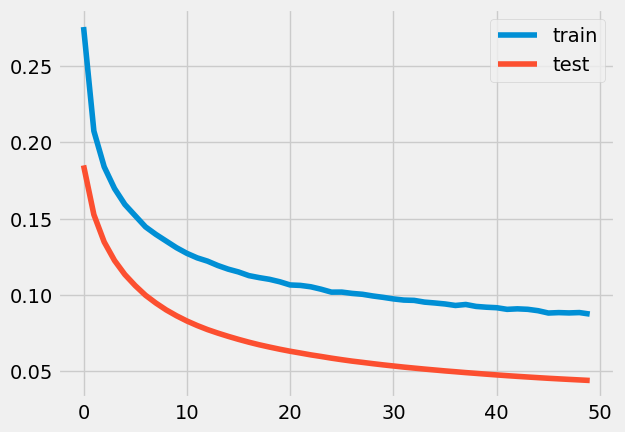

1.3946849054584447e-232
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 84ms/step - loss: 0.1826 - accuracy: 0.0000e+00 - val_loss: 0.0805 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 52ms/step - loss: 0.1160 - accuracy: 1.2295e-05 - val_loss: 0.0588 - val_accuracy: 0.000

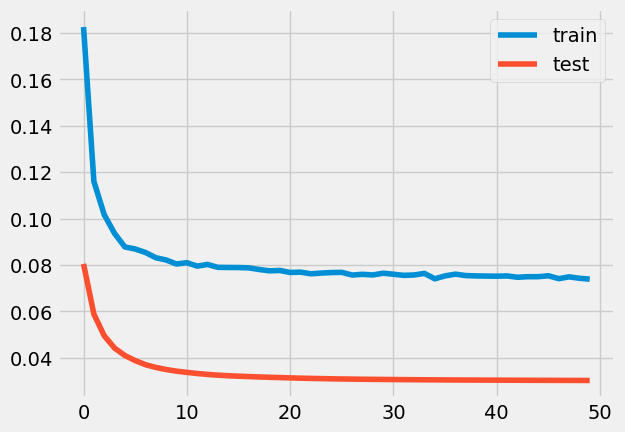

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 80ms/step - loss: 0.1067 - accuracy: 0.0022 - val_loss: 0.0344 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 51ms/step - loss: 0.0825 - accuracy: 0.0043 - val_loss: 0.0312 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

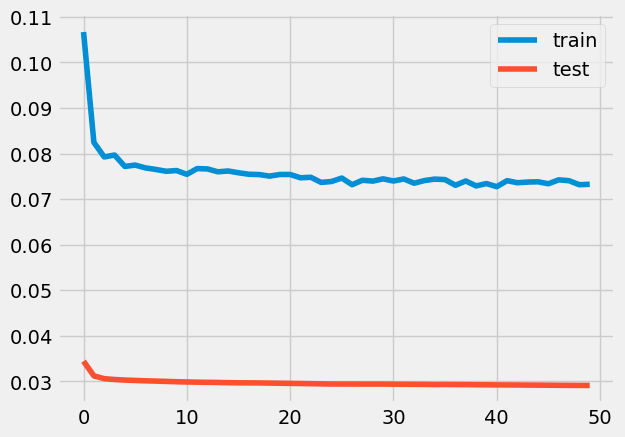

9.765625e-06
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 84ms/step - loss: 0.1470 - accuracy: 0.0000e+00 - val_loss: 0.0593 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 54ms/step - loss: 0.1004 - accuracy: 6.3115e-04 - val_loss: 0.0444 - val_accuracy: 0.0000e+00
Epoch

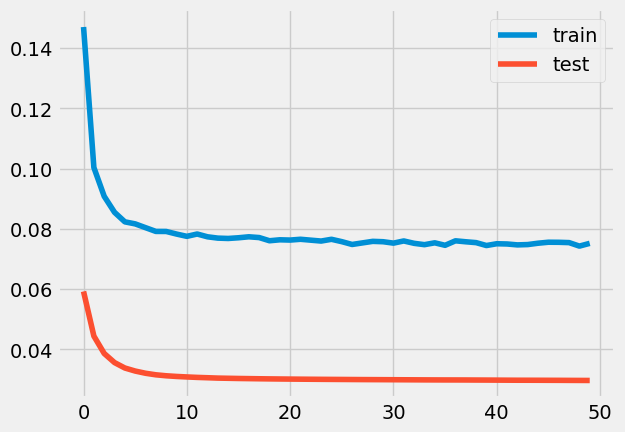

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 83ms/step - loss: 0.2586 - accuracy: 0.0000e+00 - val_loss: 0.1620 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 56ms/step - loss: 0.1879 - accuracy: 0.0000e+00 - val_loss: 0.1328 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

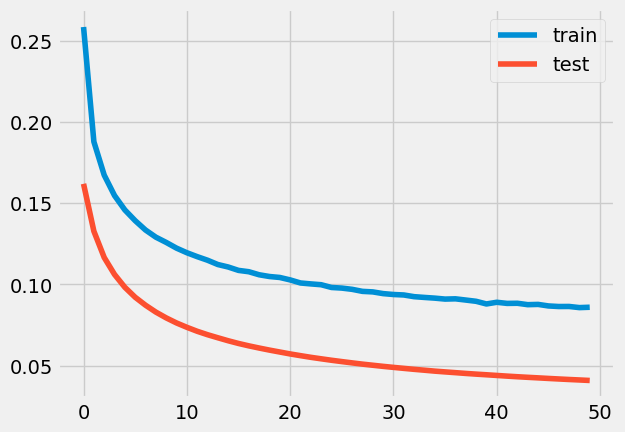

0.0
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 85ms/step - loss: 0.1540 - accuracy: 0.0000e+00 - val_loss: 0.0677 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 58ms/step - loss: 0.1066 - accuracy: 1.4754e-04 - val_loss: 0.0515 - val_accuracy: 0.0000e+00
Epoch 3/50
20/

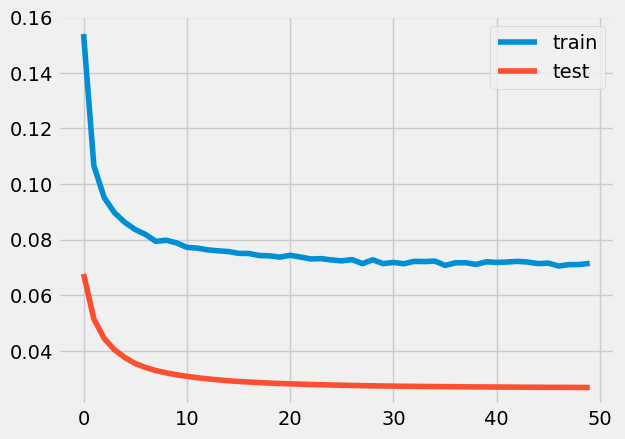

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 81ms/step - loss: 0.1590 - accuracy: 0.0000e+00 - val_loss: 0.0696 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 55ms/step - loss: 0.1089 - accuracy: 3.2172e-04 - val_loss: 0.0519 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

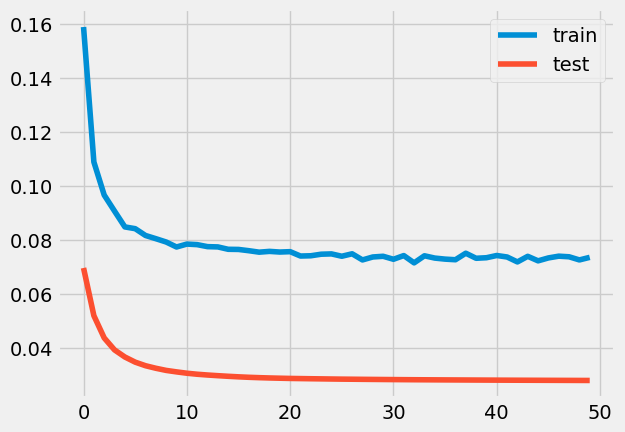

3.4914979377453935e-47
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 83ms/step - loss: 0.1472 - accuracy: 7.5820e-05 - val_loss: 0.0576 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 57ms/step - loss: 0.0985 - accuracy: 0.0012 - val_loss: 0.0431 - val_accuracy: 0.0000e+00

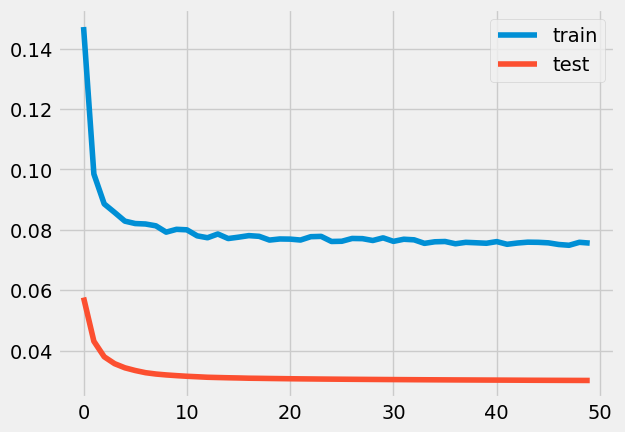

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 81ms/step - loss: 0.1851 - accuracy: 0.0000e+00 - val_loss: 0.0981 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 54ms/step - loss: 0.1331 - accuracy: 0.0000e+00 - val_loss: 0.0771 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

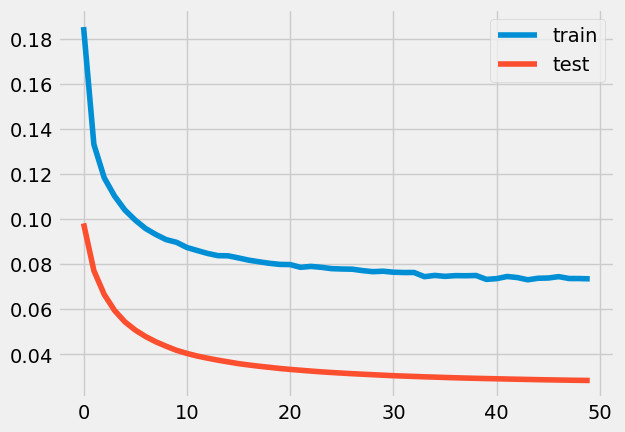

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 80ms/step - loss: 0.2788 - accuracy: 0.0000e+00 - val_loss: 0.1848 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 51ms/step - loss: 0.2083 - accuracy: 0.0000e+00 - val_loss: 0.1545 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

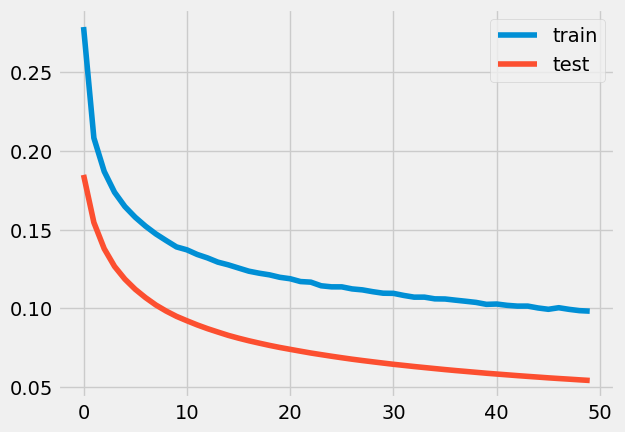

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 79ms/step - loss: 0.1639 - accuracy: 0.0000e+00 - val_loss: 0.0728 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 49ms/step - loss: 0.1083 - accuracy: 1.2910e-04 - val_loss: 0.0520 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

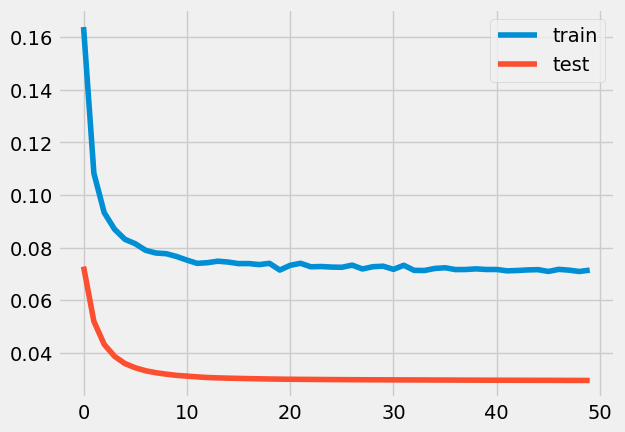

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 84ms/step - loss: 0.1395 - accuracy: 0.0000e+00 - val_loss: 0.0597 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 50ms/step - loss: 0.1010 - accuracy: 4.6926e-04 - val_loss: 0.0457 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

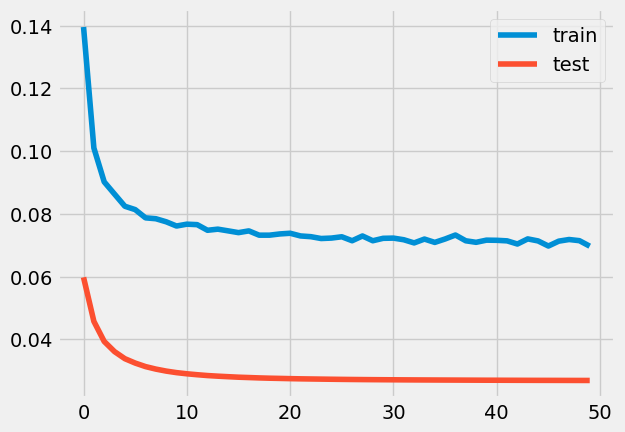

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 84ms/step - loss: 0.2214 - accuracy: 0.0000e+00 - val_loss: 0.1196 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 57ms/step - loss: 0.1479 - accuracy: 0.0000e+00 - val_loss: 0.0915 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

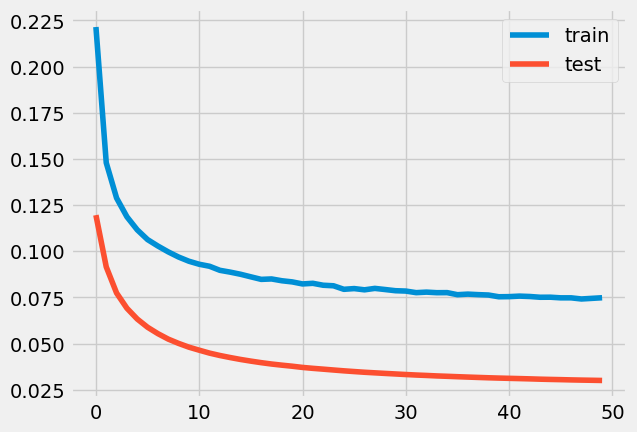

2.090056257867067e-141
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 90ms/step - loss: 0.2403 - accuracy: 0.0000e+00 - val_loss: 0.1304 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 56ms/step - loss: 0.1536 - accuracy: 0.0000e+00 - val_loss: 0.0945 - val_accuracy: 0.0000

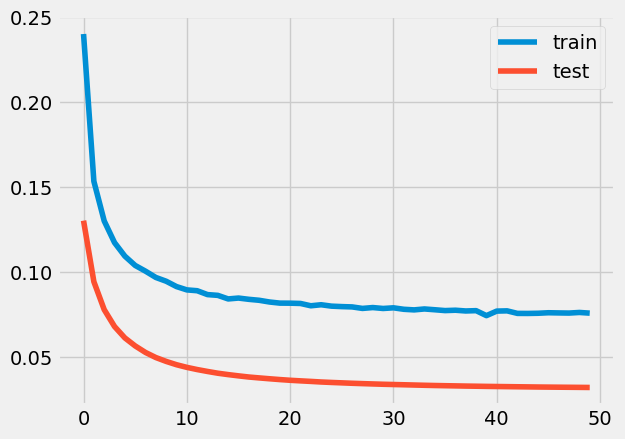

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 88ms/step - loss: 0.3959 - accuracy: 0.0000e+00 - val_loss: 0.2556 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 54ms/step - loss: 0.2584 - accuracy: 0.0000e+00 - val_loss: 0.1991 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

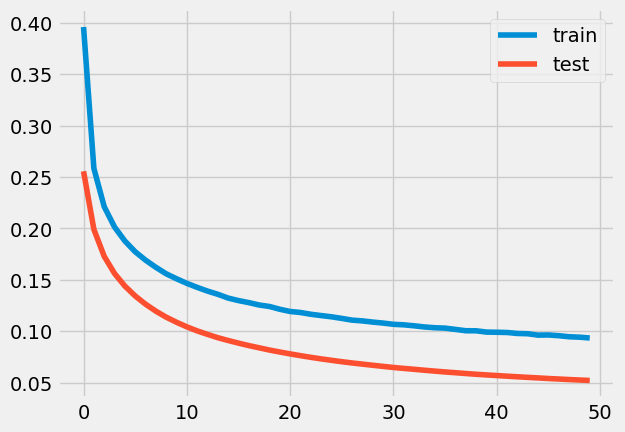

0.0
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 88ms/step - loss: 0.1119 - accuracy: 0.0018 - val_loss: 0.0357 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 55ms/step - loss: 0.0814 - accuracy: 0.0034 - val_loss: 0.0300 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [====

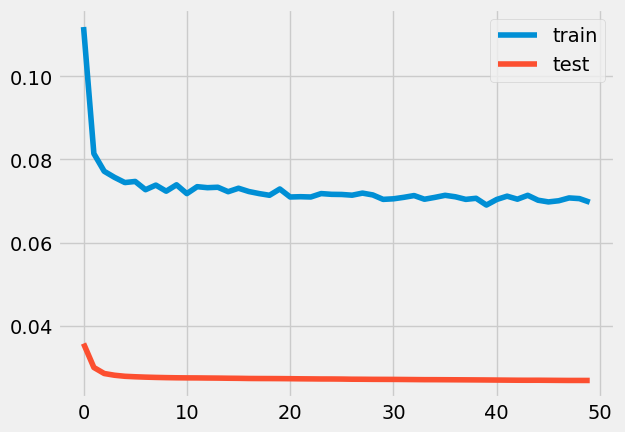

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 82ms/step - loss: 0.1179 - accuracy: 2.7869e-04 - val_loss: 0.0390 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 52ms/step - loss: 0.0830 - accuracy: 0.0035 - val_loss: 0.0316 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [====

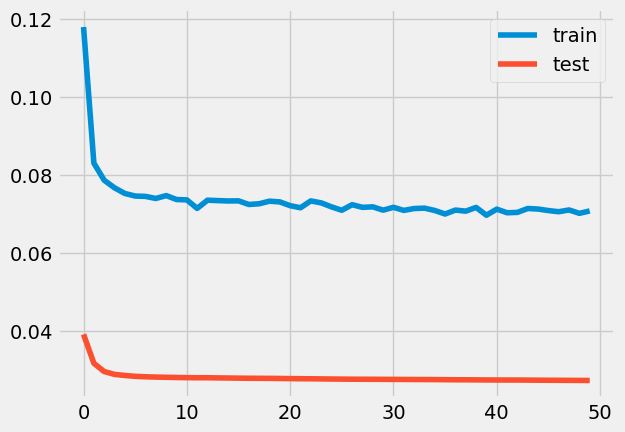

1.178175587558364e-15
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 82ms/step - loss: 0.1323 - accuracy: 8.1967e-05 - val_loss: 0.0543 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 48ms/step - loss: 0.0975 - accuracy: 5.5328e-04 - val_loss: 0.0426 - val_accuracy: 0.0000e

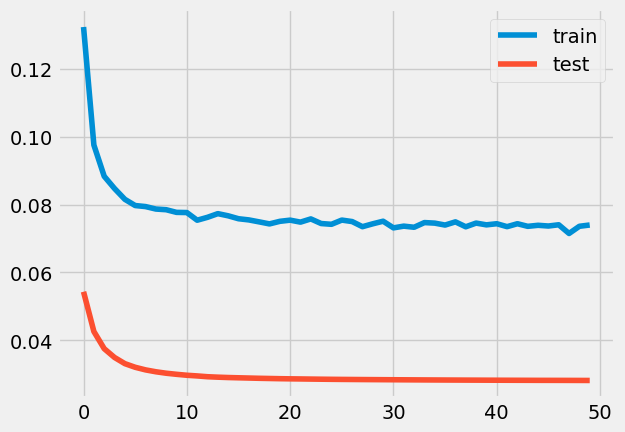

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 73ms/step - loss: 0.2280 - accuracy: 0.0000e+00 - val_loss: 0.1346 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 47ms/step - loss: 0.1620 - accuracy: 0.0000e+00 - val_loss: 0.1058 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [


loss: 3.44%



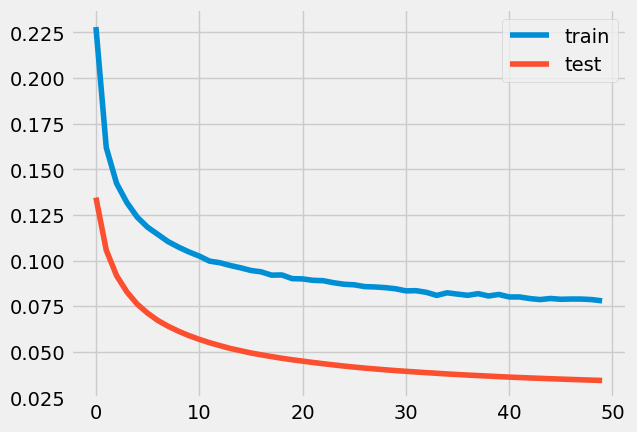

6.066702397925303e-276
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 78ms/step - loss: 0.1031 - accuracy: 8.0123e-04 - val_loss: 0.0303 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.0786 - accuracy: 0.0034 - val_loss: 0.0276 - val_accuracy: 0.0000e+00

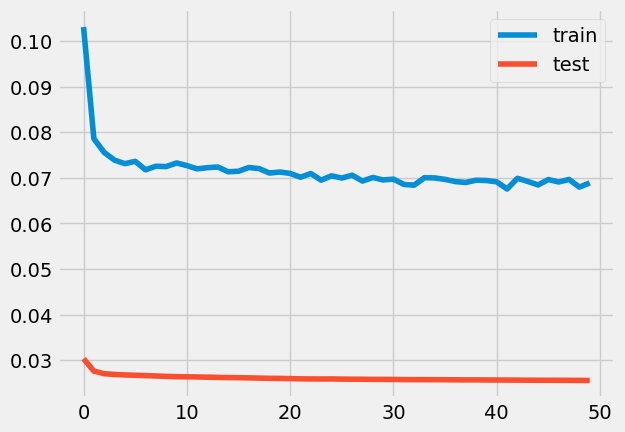

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 86ms/step - loss: 0.2044 - accuracy: 0.0000e+00 - val_loss: 0.1092 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.1412 - accuracy: 0.0000e+00 - val_loss: 0.0836 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

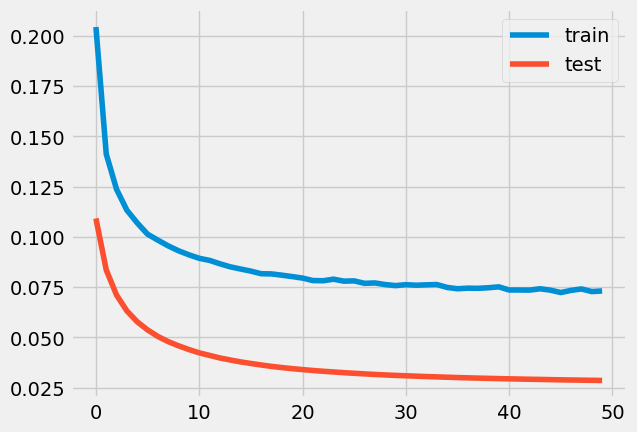

1.5878226302908309e-136
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 82ms/step - loss: 0.1353 - accuracy: 2.6639e-04 - val_loss: 0.0529 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 54ms/step - loss: 0.0973 - accuracy: 0.0010 - val_loss: 0.0415 - val_accuracy: 0.0000e+0

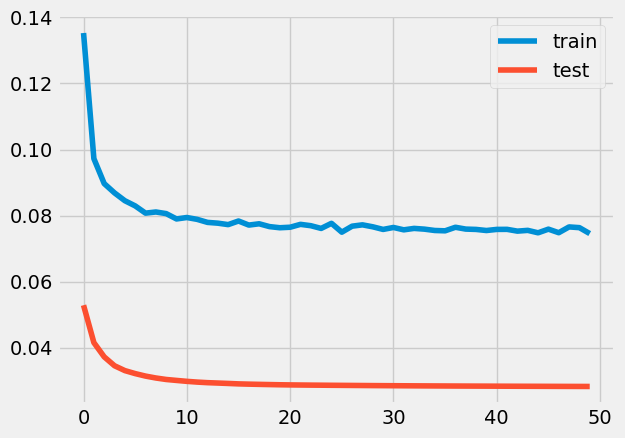

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 81ms/step - loss: 0.2274 - accuracy: 0.0000e+00 - val_loss: 0.1353 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 52ms/step - loss: 0.1649 - accuracy: 0.0000e+00 - val_loss: 0.1085 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [


loss: 3.52%



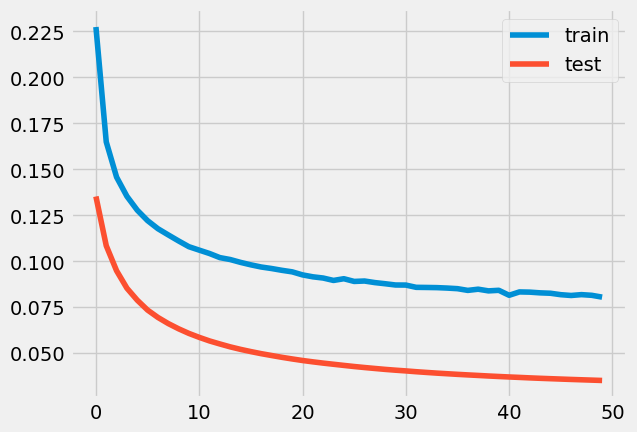

9.9694776574077e-311
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 85ms/step - loss: 0.1602 - accuracy: 0.0000e+00 - val_loss: 0.0794 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 52ms/step - loss: 0.1190 - accuracy: 3.8934e-05 - val_loss: 0.0633 - val_accuracy: 0.0000e+

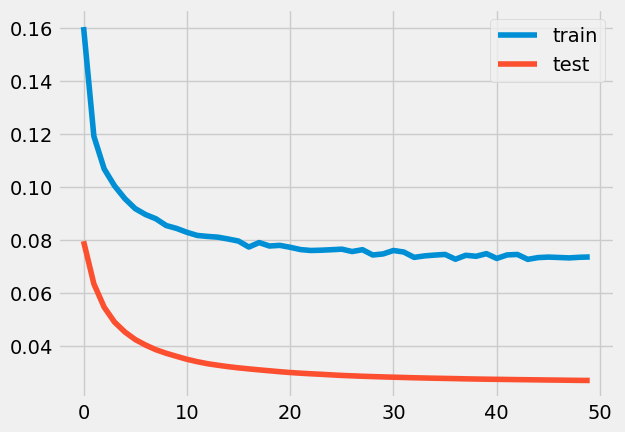

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 87ms/step - loss: 0.3016 - accuracy: 0.0000e+00 - val_loss: 0.2061 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.2253 - accuracy: 0.0000e+00 - val_loss: 0.1715 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

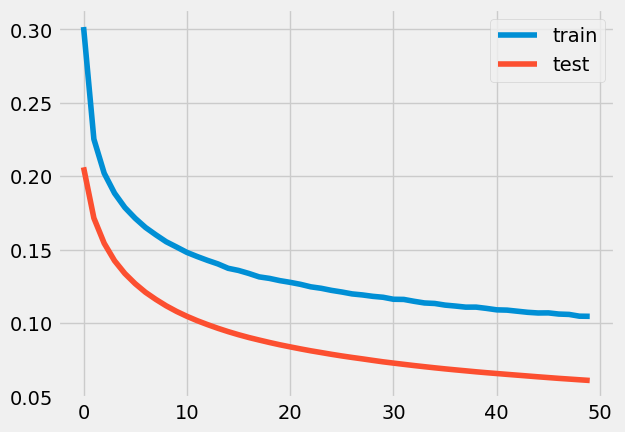

0.0
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 79ms/step - loss: 0.2902 - accuracy: 0.0000e+00 - val_loss: 0.1892 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 50ms/step - loss: 0.2080 - accuracy: 0.0000e+00 - val_loss: 0.1519 - val_accuracy: 0.0000e+00
Epoch 3/50
20/

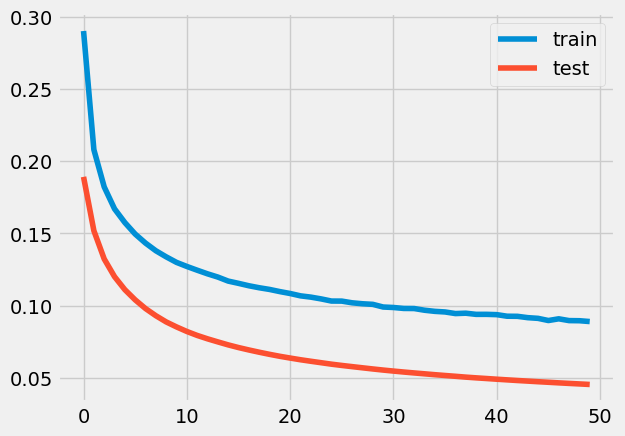

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 81ms/step - loss: 0.1726 - accuracy: 0.0000e+00 - val_loss: 0.0848 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 51ms/step - loss: 0.1211 - accuracy: 7.9918e-05 - val_loss: 0.0646 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

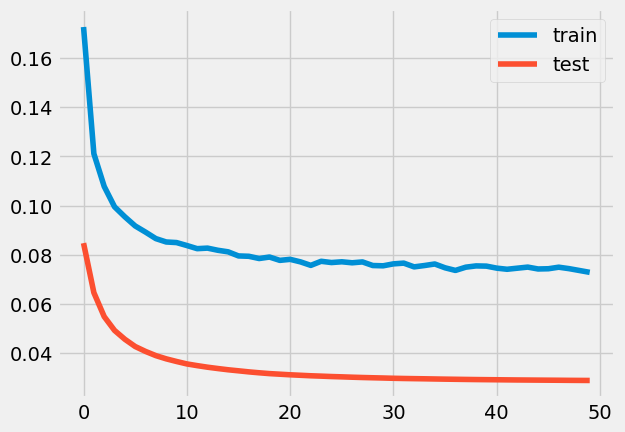

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 88ms/step - loss: 0.2138 - accuracy: 0.0000e+00 - val_loss: 0.1194 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 59ms/step - loss: 0.1483 - accuracy: 0.0000e+00 - val_loss: 0.0914 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

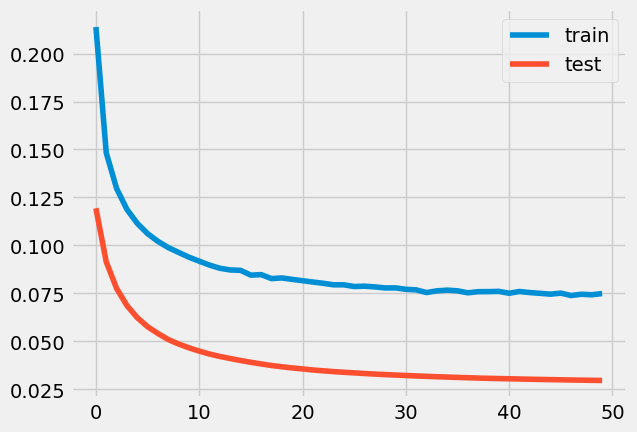

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 88ms/step - loss: 0.2812 - accuracy: 0.0000e+00 - val_loss: 0.1886 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 60ms/step - loss: 0.2112 - accuracy: 0.0000e+00 - val_loss: 0.1585 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

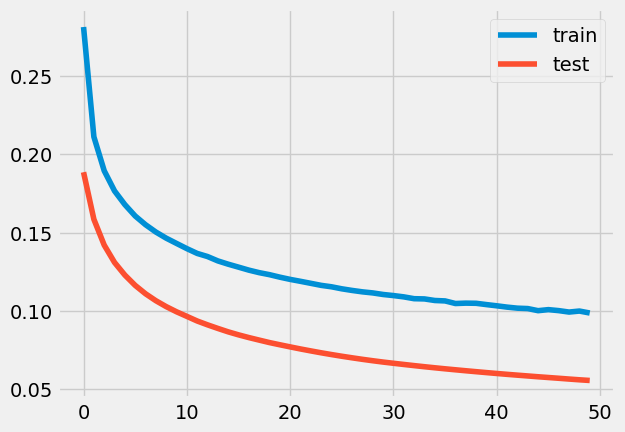

0.0
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 89ms/step - loss: 0.2955 - accuracy: 0.0000e+00 - val_loss: 0.1851 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 58ms/step - loss: 0.2034 - accuracy: 0.0000e+00 - val_loss: 0.1474 - val_accuracy: 0.0000e+00
Epoch 3/50
20/

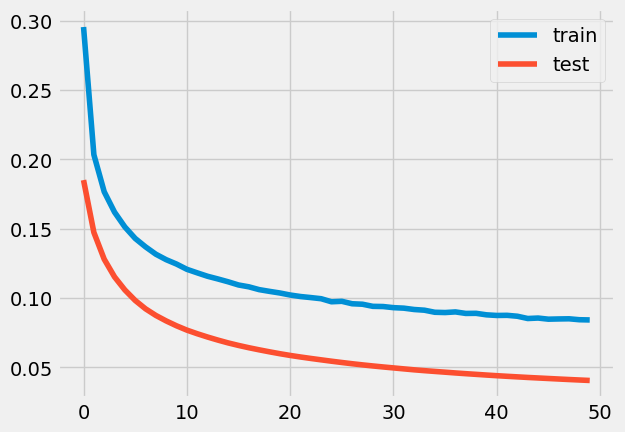

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 94ms/step - loss: 0.1991 - accuracy: 0.0000e+00 - val_loss: 0.1182 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 55ms/step - loss: 0.1524 - accuracy: 0.0000e+00 - val_loss: 0.0972 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [


loss: 3.37%



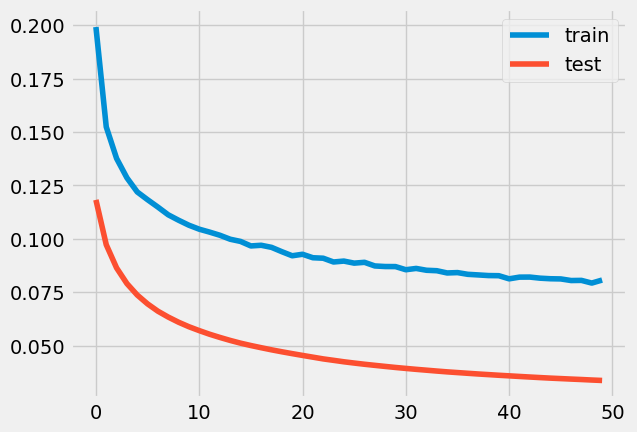

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 85ms/step - loss: 0.1744 - accuracy: 0.0000e+00 - val_loss: 0.0804 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.1157 - accuracy: 0.0000e+00 - val_loss: 0.0589 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

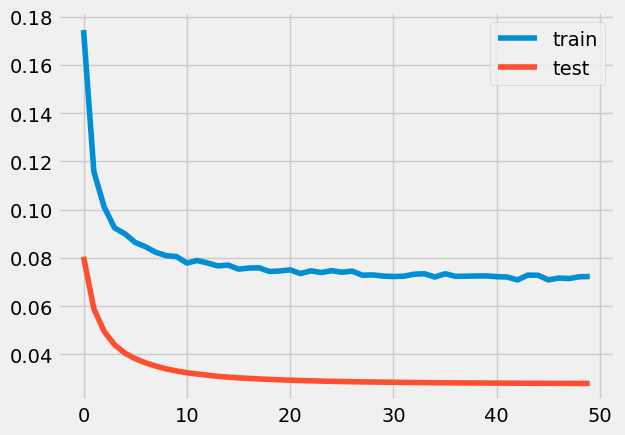

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 78ms/step - loss: 0.1808 - accuracy: 0.0000e+00 - val_loss: 0.0892 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 56ms/step - loss: 0.1230 - accuracy: 0.0000e+00 - val_loss: 0.0667 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

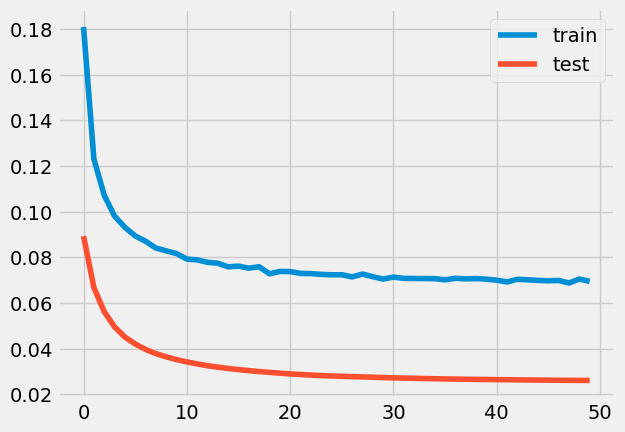

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 86ms/step - loss: 0.2190 - accuracy: 0.0000e+00 - val_loss: 0.1235 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.1539 - accuracy: 0.0000e+00 - val_loss: 0.0965 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

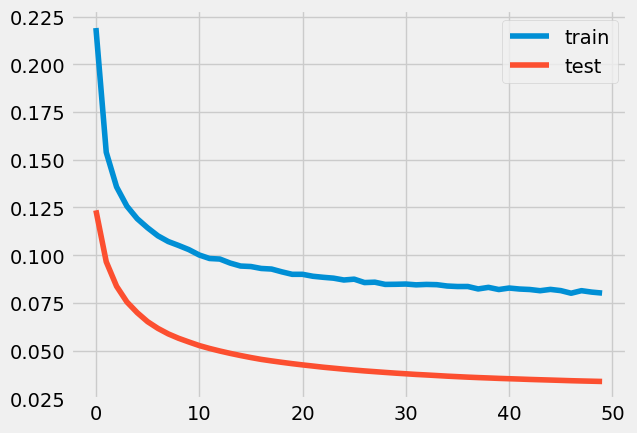

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 82ms/step - loss: 0.1210 - accuracy: 4.3033e-04 - val_loss: 0.0421 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 50ms/step - loss: 0.0841 - accuracy: 0.0023 - val_loss: 0.0335 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [====

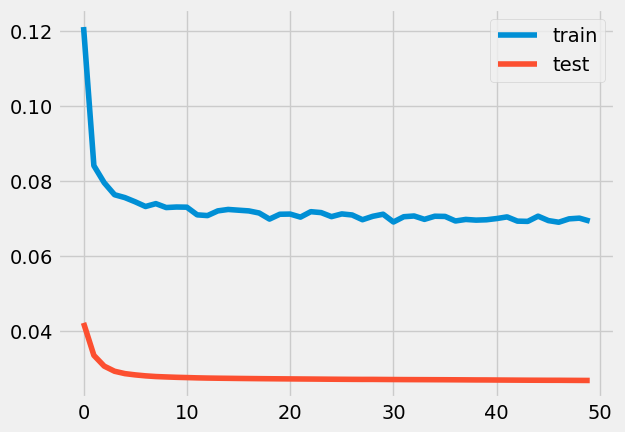

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 90ms/step - loss: 0.1783 - accuracy: 0.0000e+00 - val_loss: 0.0839 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 58ms/step - loss: 0.1185 - accuracy: 5.9426e-05 - val_loss: 0.0626 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

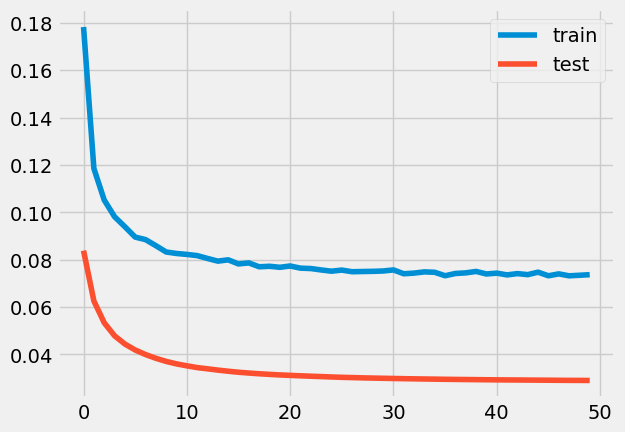

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 90ms/step - loss: 0.2008 - accuracy: 0.0000e+00 - val_loss: 0.1082 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 60ms/step - loss: 0.1417 - accuracy: 0.0000e+00 - val_loss: 0.0860 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

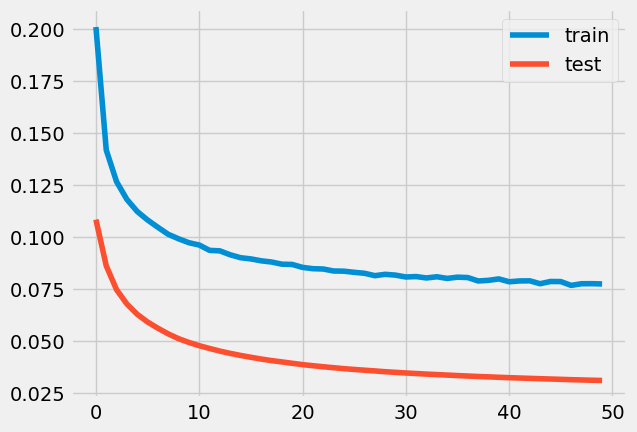

6.957423009358002e-80
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 87ms/step - loss: 0.2170 - accuracy: 0.0000e+00 - val_loss: 0.1185 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 58ms/step - loss: 0.1480 - accuracy: 0.0000e+00 - val_loss: 0.0898 - val_accuracy: 0.0000e

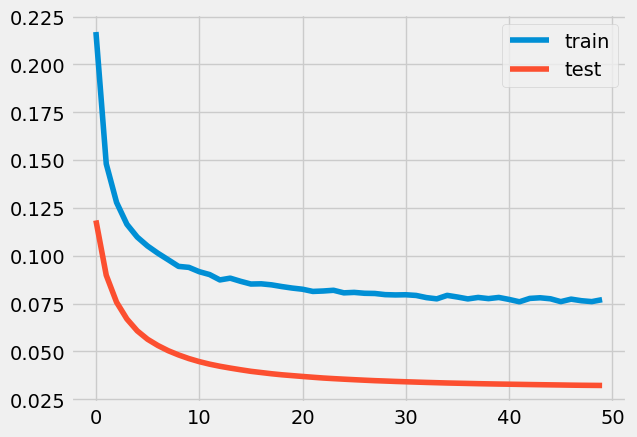

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 87ms/step - loss: 0.2147 - accuracy: 0.0000e+00 - val_loss: 0.1254 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 56ms/step - loss: 0.1567 - accuracy: 0.0000e+00 - val_loss: 0.1002 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

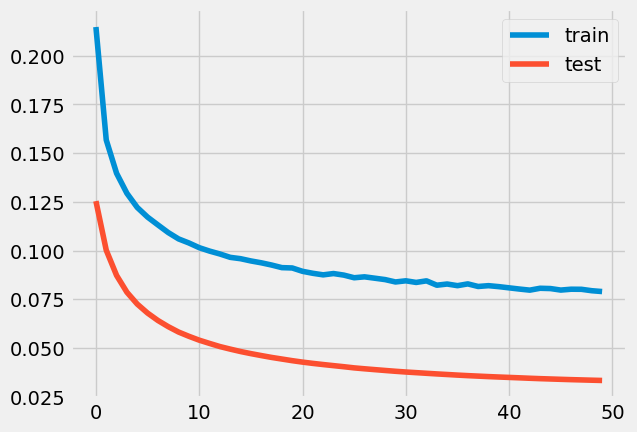

5.665112036151246e-50
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 83ms/step - loss: 0.2200 - accuracy: 0.0000e+00 - val_loss: 0.1272 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 55ms/step - loss: 0.1567 - accuracy: 0.0000e+00 - val_loss: 0.0991 - val_accuracy: 0.0000e

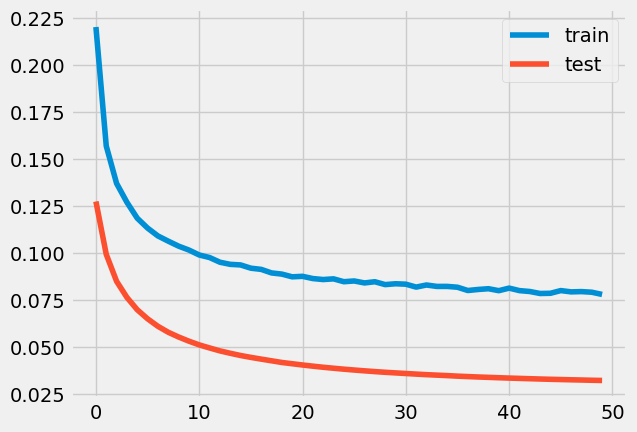

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 81ms/step - loss: 0.2729 - accuracy: 0.0000e+00 - val_loss: 0.1678 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 51ms/step - loss: 0.1903 - accuracy: 0.0000e+00 - val_loss: 0.1342 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

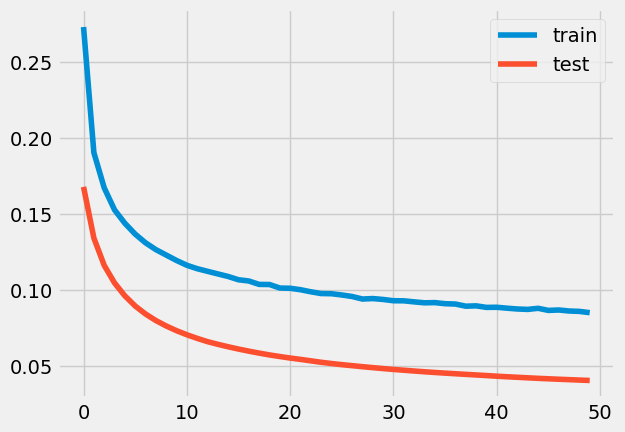

0.0
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 80ms/step - loss: 0.1300 - accuracy: 2.4795e-04 - val_loss: 0.0472 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 49ms/step - loss: 0.0903 - accuracy: 0.0011 - val_loss: 0.0359 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

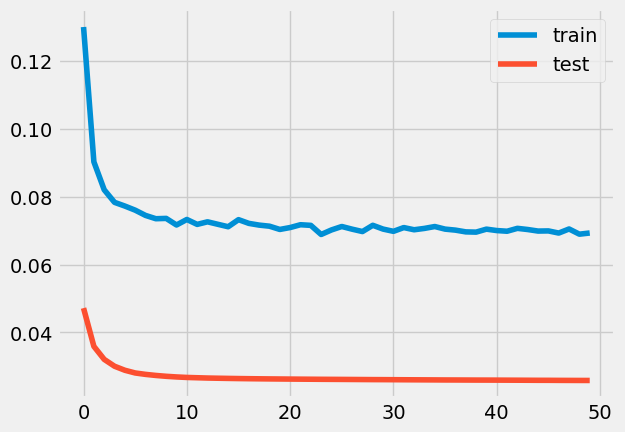

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 80ms/step - loss: 0.1414 - accuracy: 0.0000e+00 - val_loss: 0.0598 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 51ms/step - loss: 0.0996 - accuracy: 3.8730e-04 - val_loss: 0.0452 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

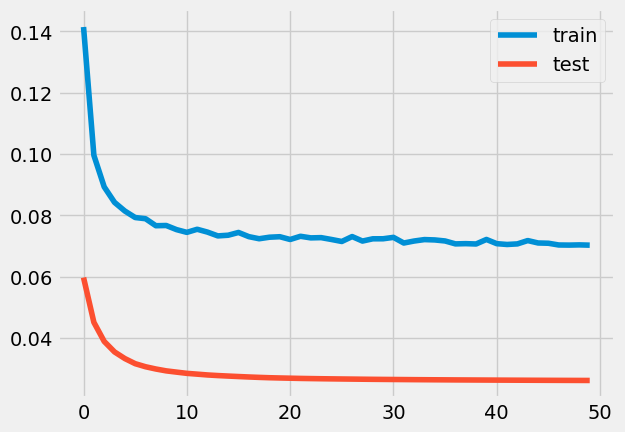

1.2292176576755451e-17
4.8828125e-06
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 78ms/step - loss: 0.2860 - accuracy: 0.0000e+00 - val_loss: 0.1780 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 57ms/step - loss: 0.1992 - accuracy: 0.0000e+00 - val_loss: 0.1414 - val_ac

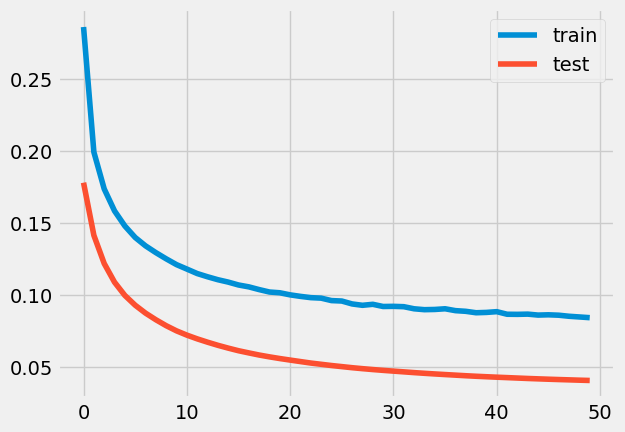

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 86ms/step - loss: 0.2252 - accuracy: 0.0000e+00 - val_loss: 0.1261 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 56ms/step - loss: 0.1544 - accuracy: 0.0000e+00 - val_loss: 0.0978 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

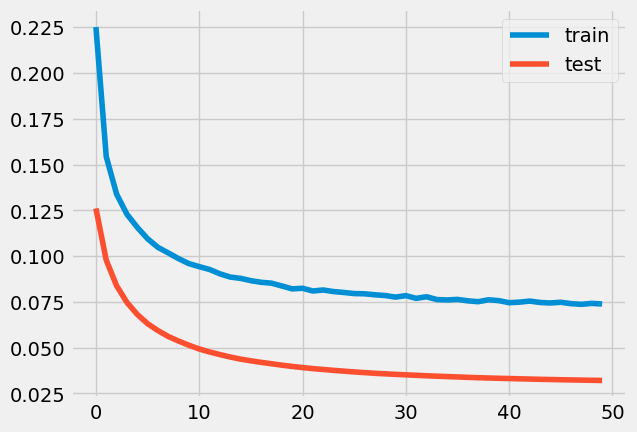

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 84ms/step - loss: 0.1465 - accuracy: 5.9426e-05 - val_loss: 0.0558 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.0942 - accuracy: 5.9221e-04 - val_loss: 0.0413 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

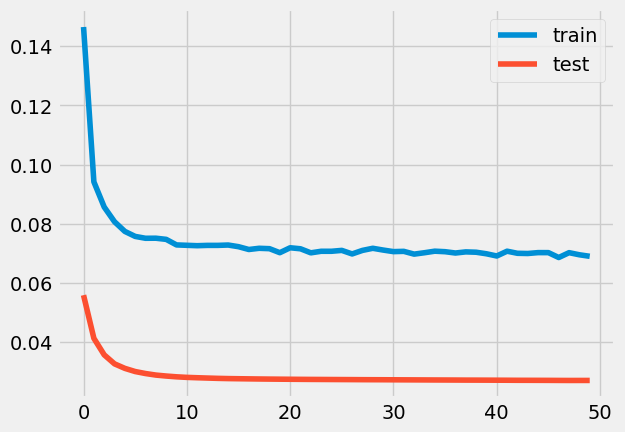

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 83ms/step - loss: 0.1249 - accuracy: 7.3770e-05 - val_loss: 0.0438 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.0860 - accuracy: 0.0022 - val_loss: 0.0335 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [====

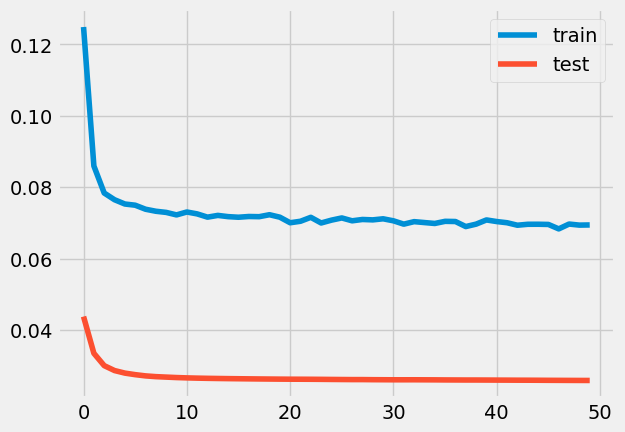

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 82ms/step - loss: 0.1607 - accuracy: 0.0000e+00 - val_loss: 0.0803 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 50ms/step - loss: 0.1190 - accuracy: 0.0000e+00 - val_loss: 0.0636 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

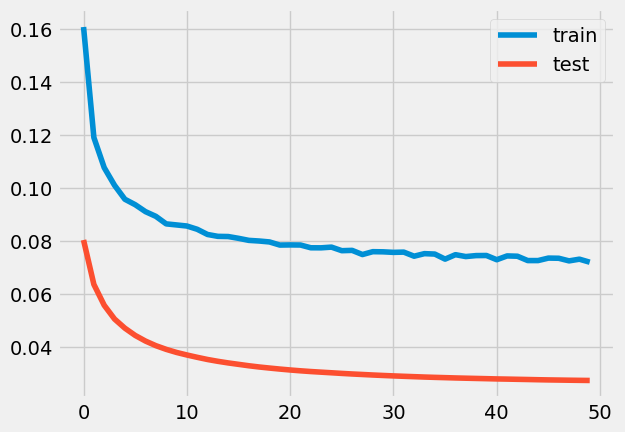

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 75ms/step - loss: 0.3260 - accuracy: 0.0000e+00 - val_loss: 0.2246 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 48ms/step - loss: 0.2398 - accuracy: 0.0000e+00 - val_loss: 0.1858 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

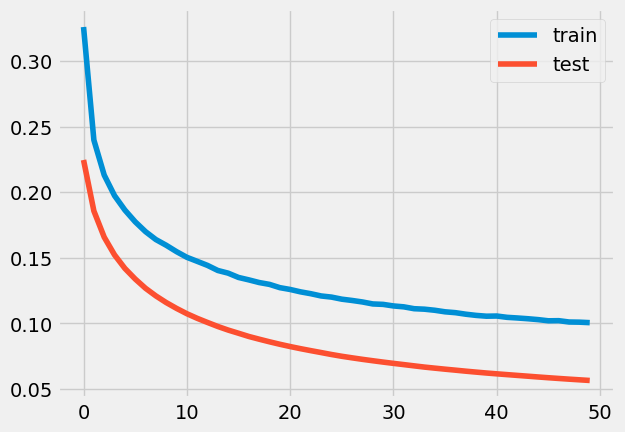

0.0
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 79ms/step - loss: 0.1988 - accuracy: 0.0000e+00 - val_loss: 0.0954 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 50ms/step - loss: 0.1265 - accuracy: 0.0000e+00 - val_loss: 0.0698 - val_accuracy: 0.0000e+00
Epoch 3/50
20/

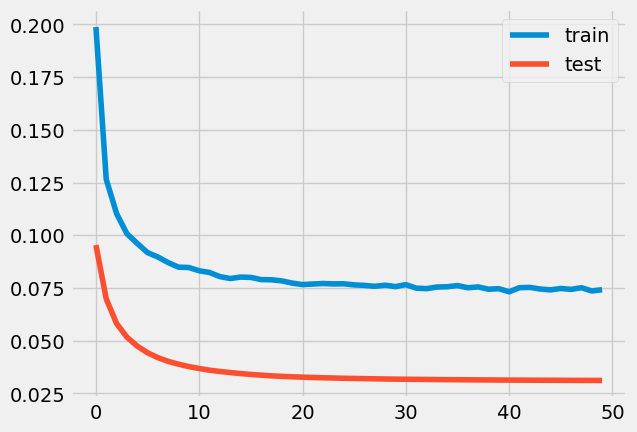

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 80ms/step - loss: 0.0883 - accuracy: 0.0051 - val_loss: 0.0285 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.0789 - accuracy: 0.0049 - val_loss: 0.0285 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

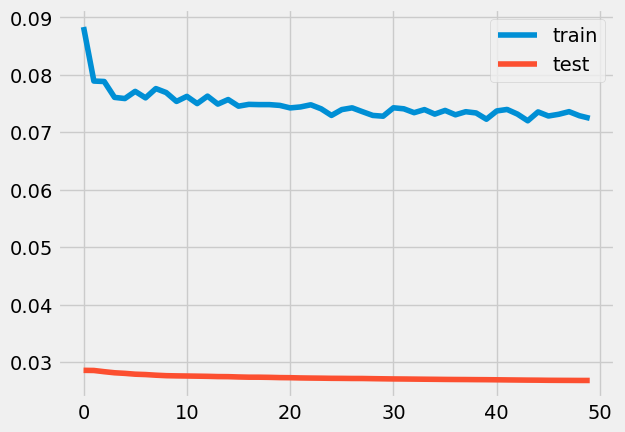

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 82ms/step - loss: 0.2305 - accuracy: 0.0000e+00 - val_loss: 0.1294 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.1557 - accuracy: 0.0000e+00 - val_loss: 0.0986 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

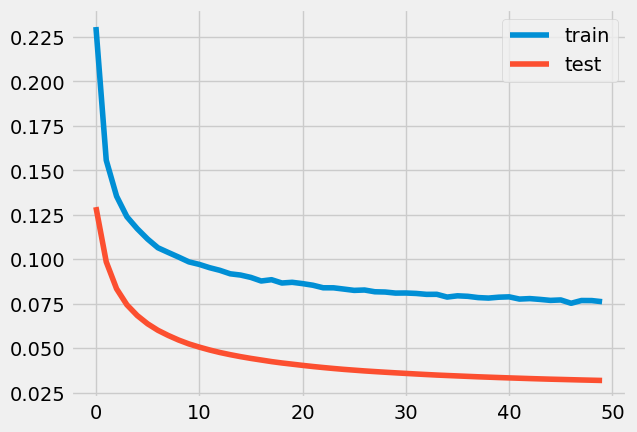

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 82ms/step - loss: 0.0971 - accuracy: 0.0019 - val_loss: 0.0327 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.0812 - accuracy: 0.0030 - val_loss: 0.0300 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

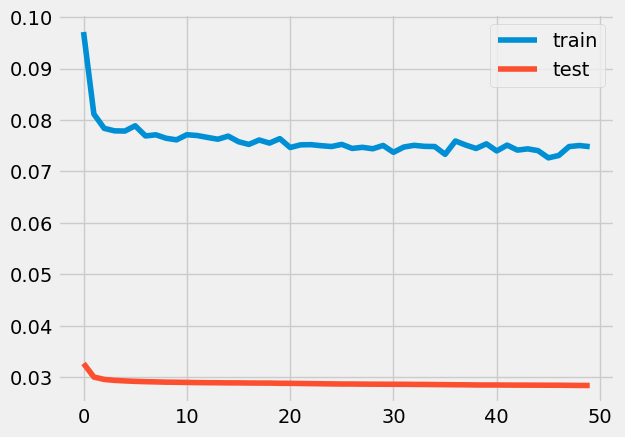

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 86ms/step - loss: 0.2208 - accuracy: 0.0000e+00 - val_loss: 0.1253 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 57ms/step - loss: 0.1549 - accuracy: 0.0000e+00 - val_loss: 0.0981 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

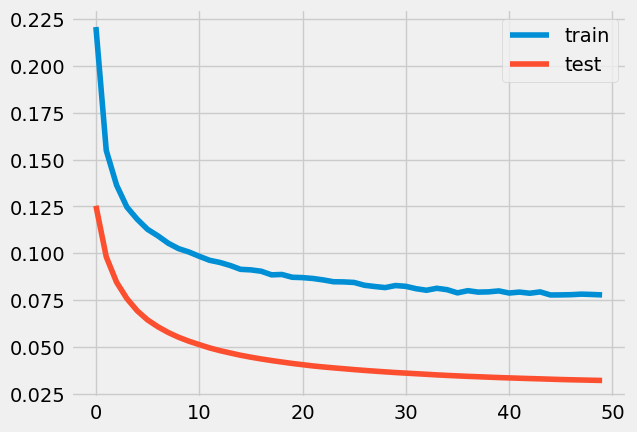

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 86ms/step - loss: 0.3197 - accuracy: 0.0000e+00 - val_loss: 0.2231 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.2416 - accuracy: 0.0000e+00 - val_loss: 0.1878 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

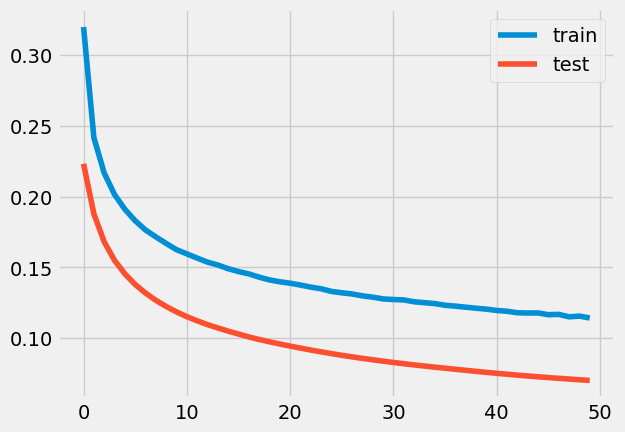

0.0
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 78ms/step - loss: 0.1615 - accuracy: 0.0000e+00 - val_loss: 0.0779 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 49ms/step - loss: 0.1157 - accuracy: 2.8893e-04 - val_loss: 0.0596 - val_accuracy: 0.0000e+00
Epoch 3/50
20/

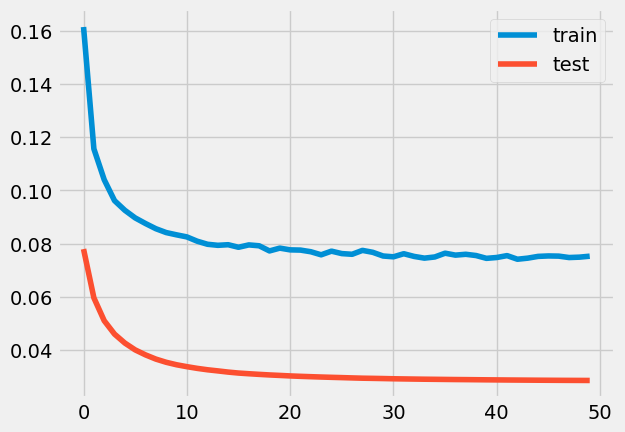

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 78ms/step - loss: 0.3256 - accuracy: 0.0000e+00 - val_loss: 0.2124 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 45ms/step - loss: 0.2277 - accuracy: 0.0000e+00 - val_loss: 0.1711 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

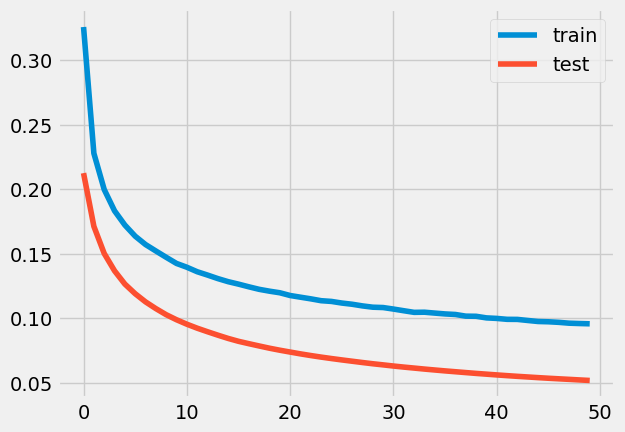

0.0
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 73ms/step - loss: 0.1221 - accuracy: 1.2910e-04 - val_loss: 0.0431 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 51ms/step - loss: 0.0870 - accuracy: 0.0016 - val_loss: 0.0336 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

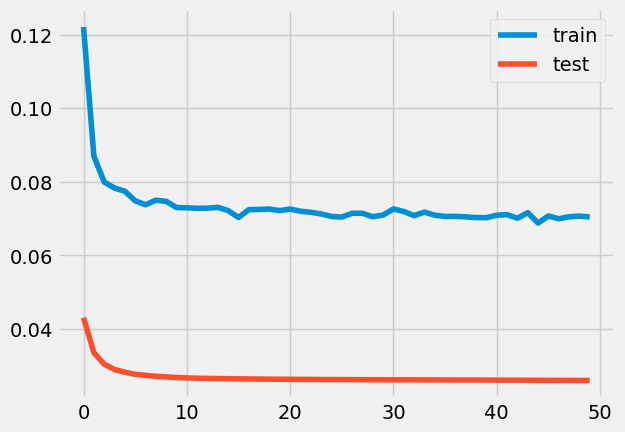

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 83ms/step - loss: 0.1257 - accuracy: 1.6598e-04 - val_loss: 0.0442 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 55ms/step - loss: 0.0887 - accuracy: 0.0027 - val_loss: 0.0357 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [====

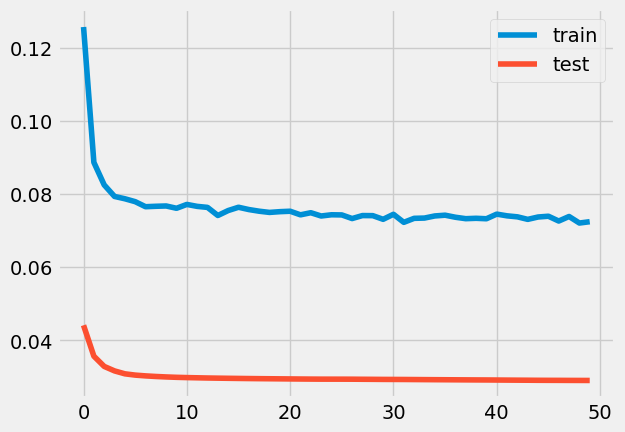

7.972538590931619e-272
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 78ms/step - loss: 0.2147 - accuracy: 0.0000e+00 - val_loss: 0.1249 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 55ms/step - loss: 0.1547 - accuracy: 0.0000e+00 - val_loss: 0.0994 - val_accuracy: 0.0000


loss: 3.30%



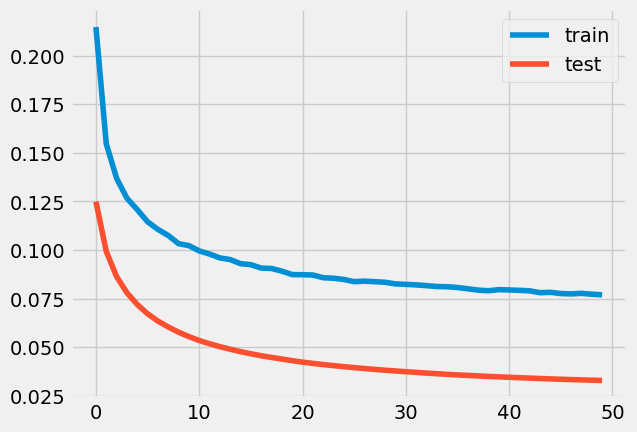

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 82ms/step - loss: 0.1738 - accuracy: 0.0000e+00 - val_loss: 0.0866 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 54ms/step - loss: 0.1237 - accuracy: 1.0246e-05 - val_loss: 0.0664 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

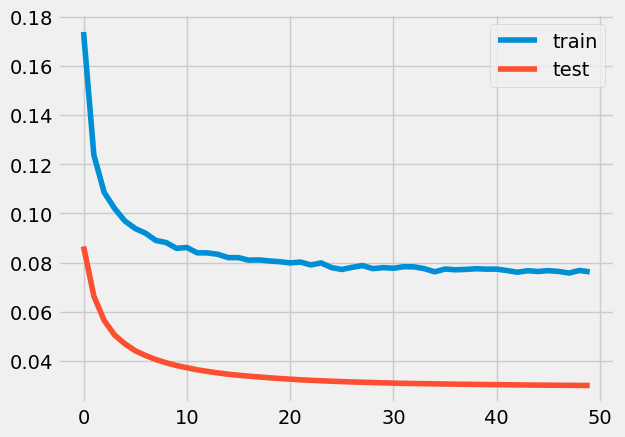

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 86ms/step - loss: 0.1790 - accuracy: 0.0000e+00 - val_loss: 0.0861 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 55ms/step - loss: 0.1231 - accuracy: 0.0000e+00 - val_loss: 0.0668 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

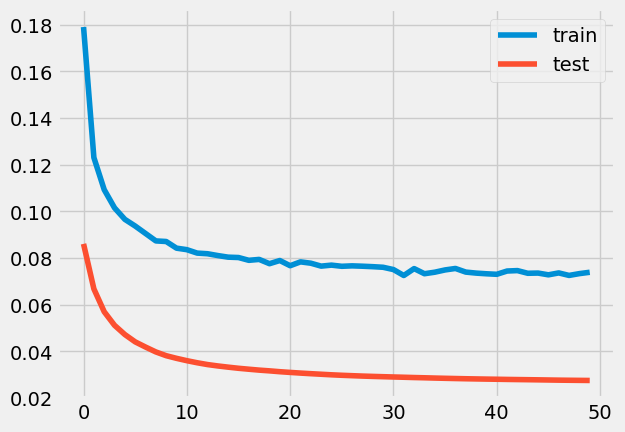

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 84ms/step - loss: 0.3138 - accuracy: 0.0000e+00 - val_loss: 0.2062 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.2216 - accuracy: 0.0000e+00 - val_loss: 0.1669 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

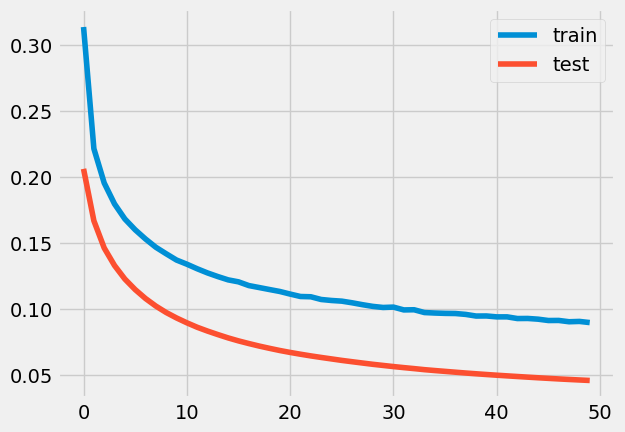

0.0
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 76ms/step - loss: 0.2709 - accuracy: 0.0000e+00 - val_loss: 0.1647 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 50ms/step - loss: 0.1856 - accuracy: 0.0000e+00 - val_loss: 0.1294 - val_accuracy: 0.0000e+00
Epoch 3/50
20/

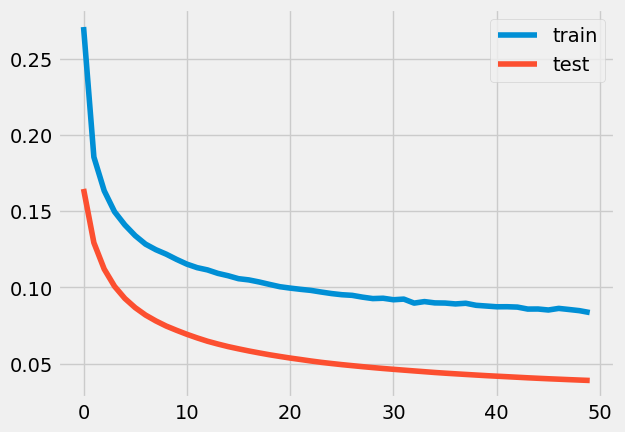

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 78ms/step - loss: 0.1507 - accuracy: 0.0000e+00 - val_loss: 0.0643 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 50ms/step - loss: 0.1041 - accuracy: 3.1967e-04 - val_loss: 0.0485 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

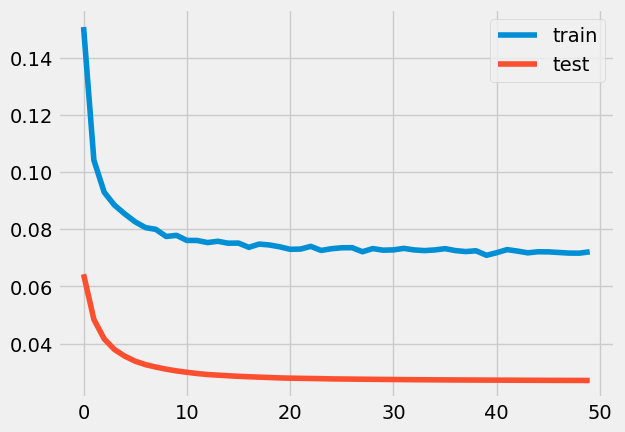

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 81ms/step - loss: 0.2743 - accuracy: 0.0000e+00 - val_loss: 0.1811 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 48ms/step - loss: 0.2056 - accuracy: 0.0000e+00 - val_loss: 0.1526 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

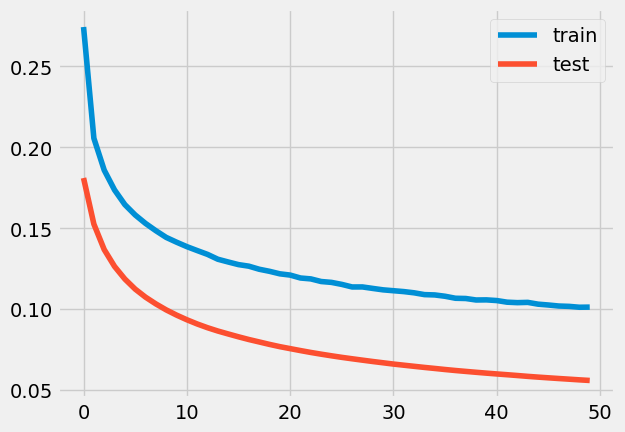

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 88ms/step - loss: 0.2974 - accuracy: 0.0000e+00 - val_loss: 0.1924 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 56ms/step - loss: 0.2117 - accuracy: 0.0000e+00 - val_loss: 0.1544 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

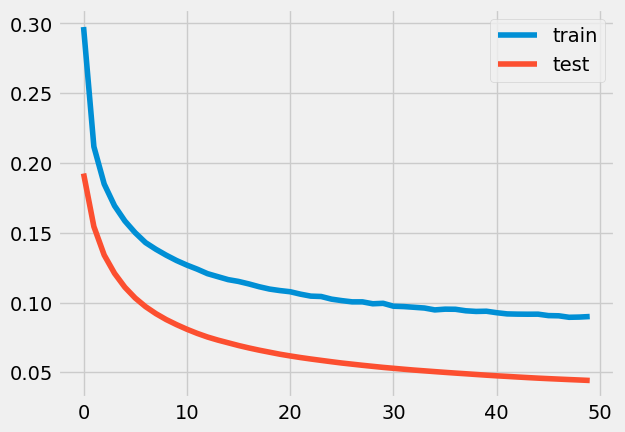

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 86ms/step - loss: 0.3745 - accuracy: 0.0000e+00 - val_loss: 0.2855 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 56ms/step - loss: 0.2975 - accuracy: 0.0000e+00 - val_loss: 0.2488 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

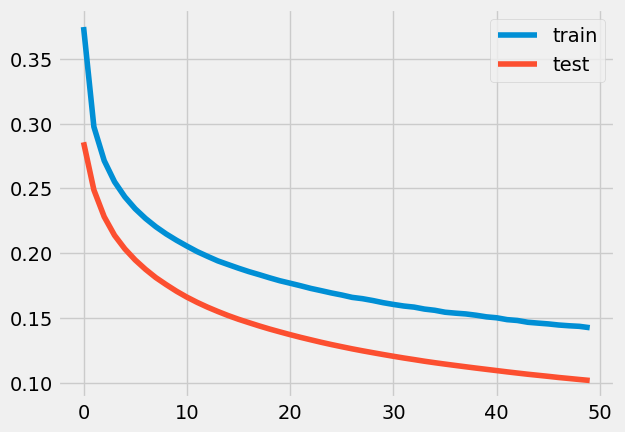

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 90ms/step - loss: 0.1531 - accuracy: 0.0000e+00 - val_loss: 0.0655 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 54ms/step - loss: 0.1038 - accuracy: 4.1393e-04 - val_loss: 0.0499 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

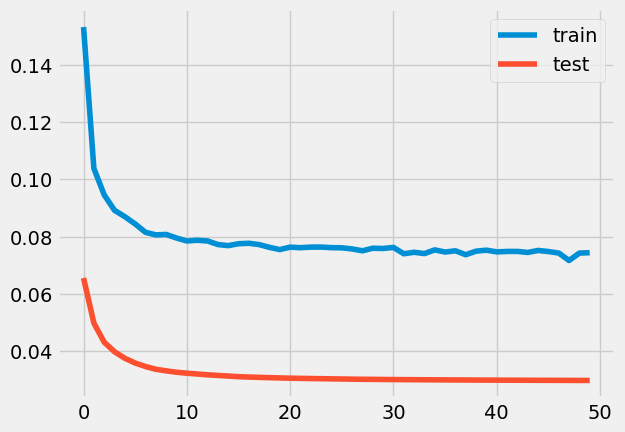

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 85ms/step - loss: 0.3484 - accuracy: 0.0000e+00 - val_loss: 0.2367 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 56ms/step - loss: 0.2450 - accuracy: 0.0000e+00 - val_loss: 0.1876 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

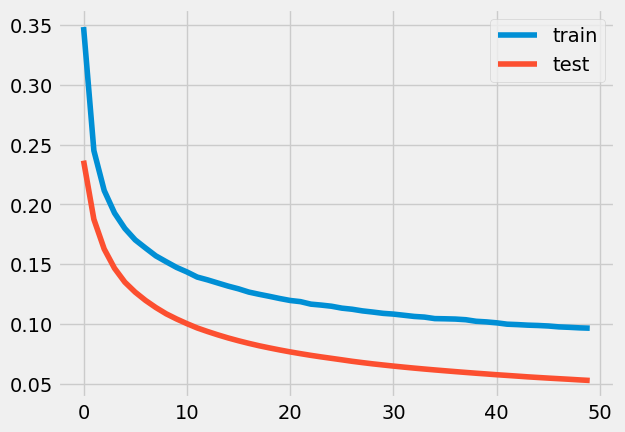

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 83ms/step - loss: 0.1686 - accuracy: 0.0000e+00 - val_loss: 0.0700 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.1055 - accuracy: 2.6434e-04 - val_loss: 0.0505 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

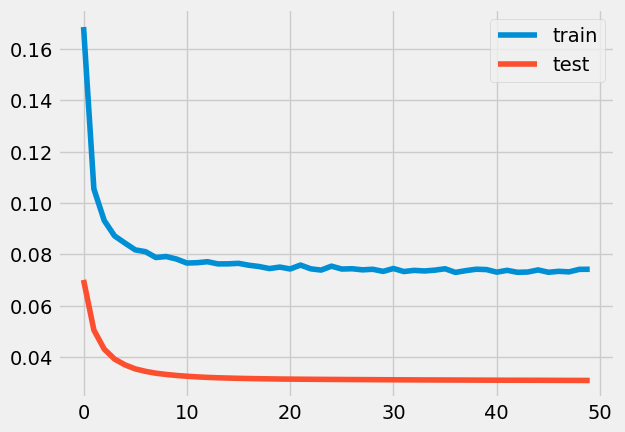

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 85ms/step - loss: 0.2425 - accuracy: 0.0000e+00 - val_loss: 0.1423 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 49ms/step - loss: 0.1677 - accuracy: 0.0000e+00 - val_loss: 0.1117 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [


loss: 3.26%



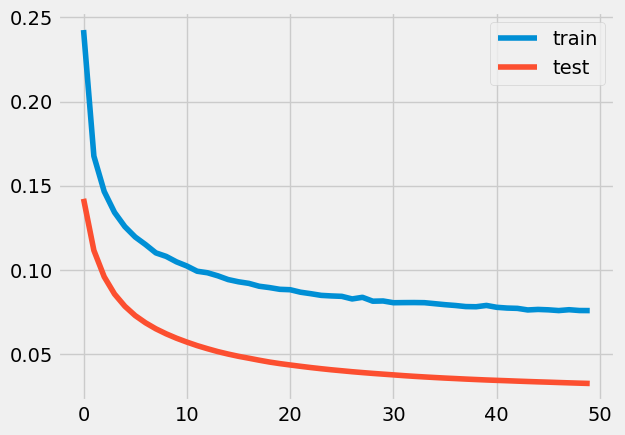

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 77ms/step - loss: 0.1450 - accuracy: 0.0000e+00 - val_loss: 0.0575 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 46ms/step - loss: 0.0997 - accuracy: 5.5943e-04 - val_loss: 0.0438 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

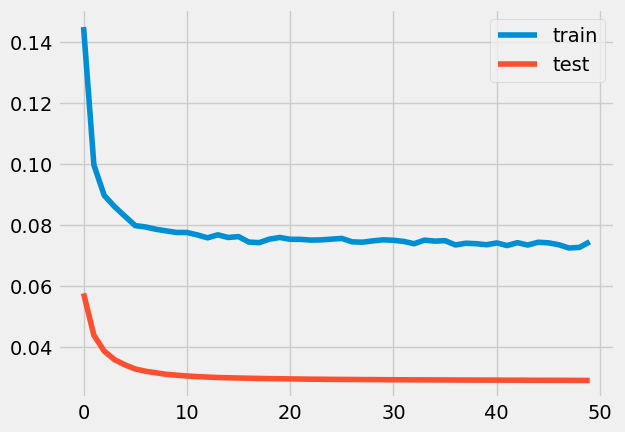

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 77ms/step - loss: 0.1582 - accuracy: 0.0000e+00 - val_loss: 0.0727 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 51ms/step - loss: 0.1110 - accuracy: 1.6393e-05 - val_loss: 0.0549 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

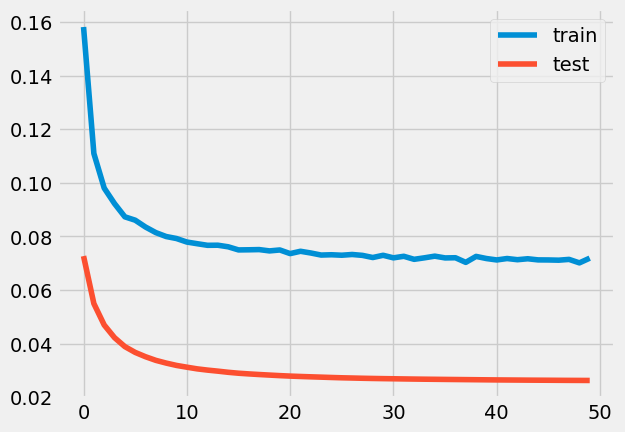

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 86ms/step - loss: 0.1550 - accuracy: 0.0000e+00 - val_loss: 0.0617 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 54ms/step - loss: 0.0988 - accuracy: 5.7787e-04 - val_loss: 0.0455 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

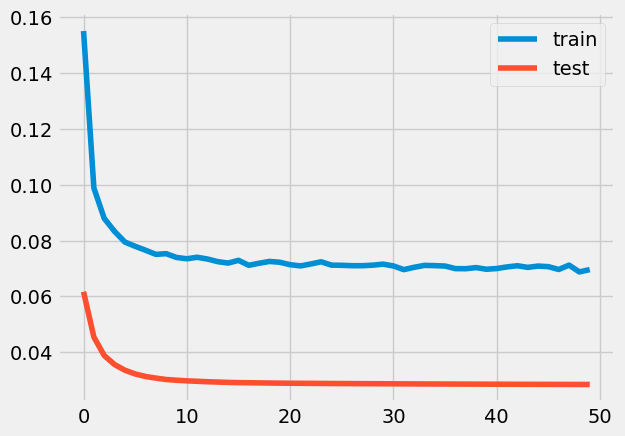

1.268229107770331e-202
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 78ms/step - loss: 0.2177 - accuracy: 0.0000e+00 - val_loss: 0.1255 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 52ms/step - loss: 0.1558 - accuracy: 0.0000e+00 - val_loss: 0.1002 - val_accuracy: 0.0000


loss: 3.42%



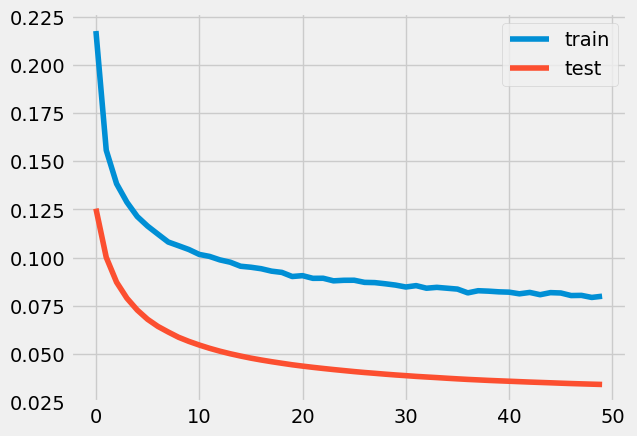

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 82ms/step - loss: 0.1382 - accuracy: 1.0246e-05 - val_loss: 0.0642 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 51ms/step - loss: 0.1073 - accuracy: 2.6639e-04 - val_loss: 0.0519 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

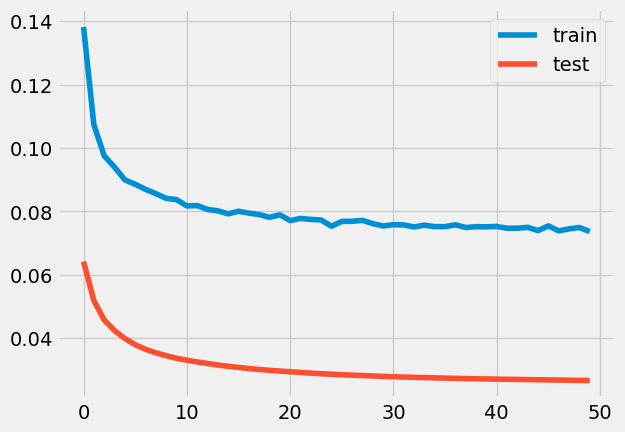

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 78ms/step - loss: 0.1607 - accuracy: 0.0000e+00 - val_loss: 0.0698 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 52ms/step - loss: 0.1076 - accuracy: 9.8361e-05 - val_loss: 0.0521 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

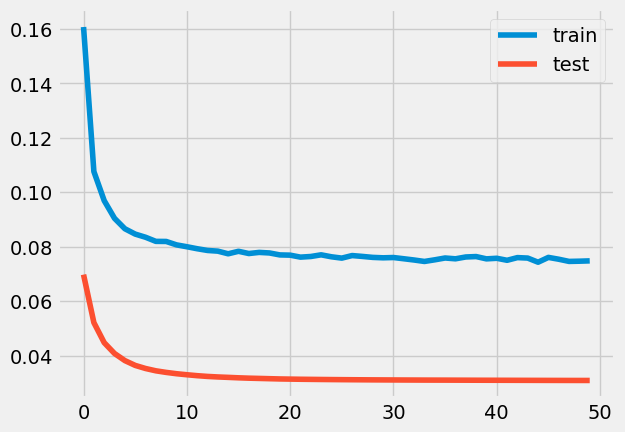

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 77ms/step - loss: 0.2396 - accuracy: 0.0000e+00 - val_loss: 0.1443 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 48ms/step - loss: 0.1728 - accuracy: 0.0000e+00 - val_loss: 0.1168 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [


loss: 3.79%



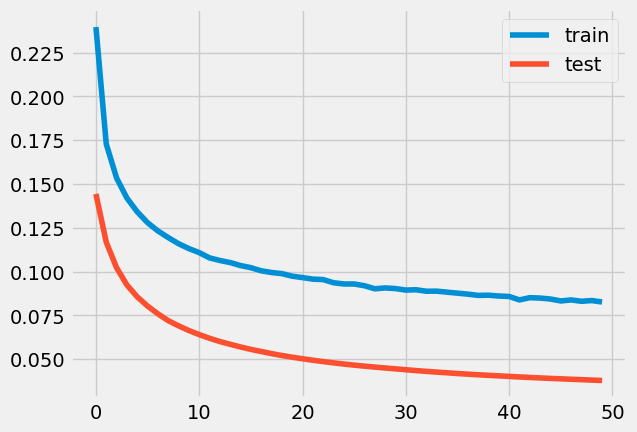

0.0
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 78ms/step - loss: 0.2362 - accuracy: 0.0000e+00 - val_loss: 0.1449 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 46ms/step - loss: 0.1733 - accuracy: 0.0000e+00 - val_loss: 0.1190 - val_accuracy: 0.0000e+00
Epoch 3/50
20/

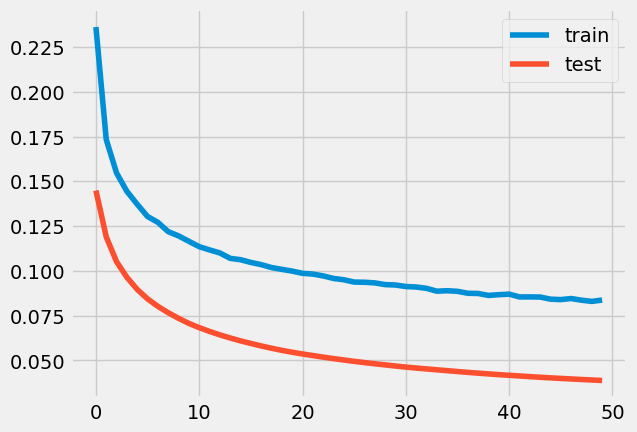

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 79ms/step - loss: 0.2756 - accuracy: 0.0000e+00 - val_loss: 0.1602 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 50ms/step - loss: 0.1817 - accuracy: 0.0000e+00 - val_loss: 0.1238 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [


loss: 3.37%



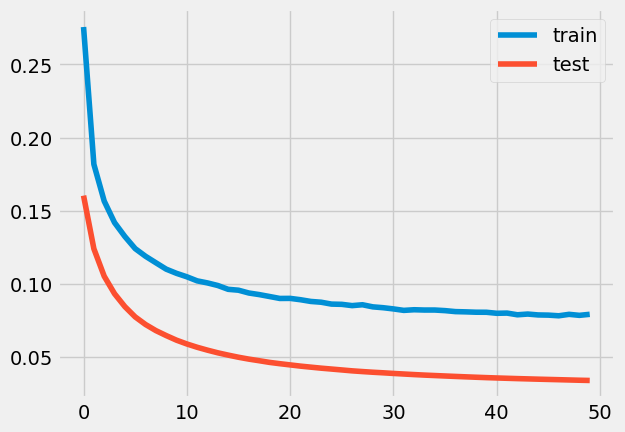

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 86ms/step - loss: 0.3280 - accuracy: 0.0000e+00 - val_loss: 0.2419 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 58ms/step - loss: 0.2594 - accuracy: 0.0000e+00 - val_loss: 0.2075 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

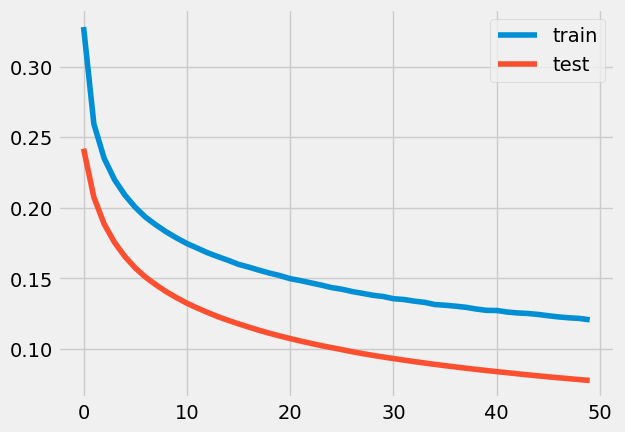

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 82ms/step - loss: 0.1542 - accuracy: 0.0000e+00 - val_loss: 0.0670 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 55ms/step - loss: 0.1059 - accuracy: 1.9467e-04 - val_loss: 0.0502 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

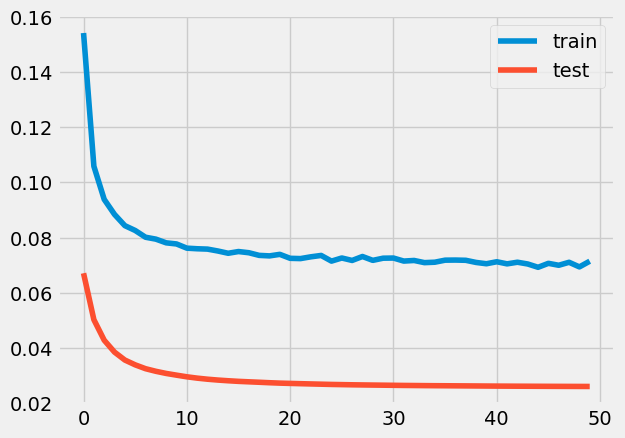

2.44140625e-06
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 86ms/step - loss: 0.0887 - accuracy: 0.0028 - val_loss: 0.0274 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 56ms/step - loss: 0.0756 - accuracy: 0.0053 - val_loss: 0.0273 - val_accuracy: 0.0000e+00
Epoch 3/50


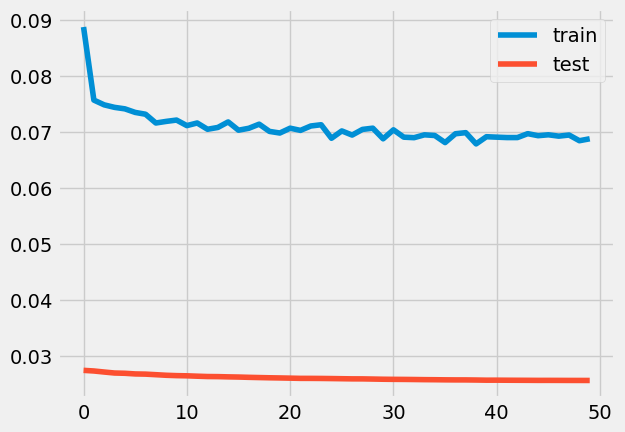

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 80ms/step - loss: 0.1726 - accuracy: 0.0000e+00 - val_loss: 0.0833 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.1181 - accuracy: 0.0000e+00 - val_loss: 0.0629 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

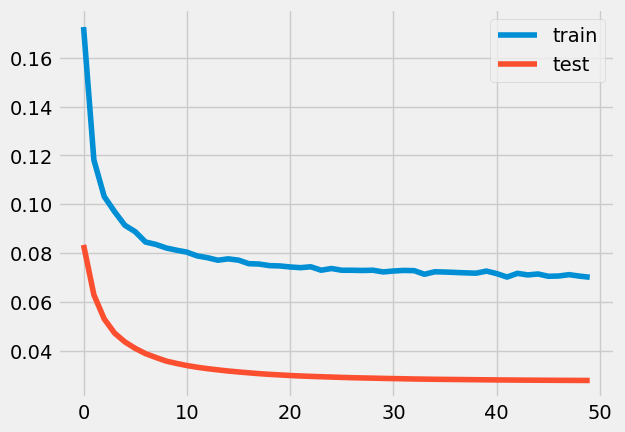

0.0
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 82ms/step - loss: 0.1253 - accuracy: 3.6475e-04 - val_loss: 0.0445 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.0881 - accuracy: 0.0014 - val_loss: 0.0346 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

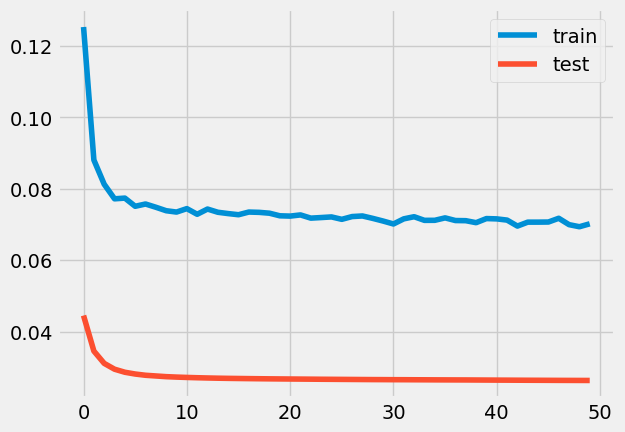

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 78ms/step - loss: 0.3060 - accuracy: 0.0000e+00 - val_loss: 0.1965 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 51ms/step - loss: 0.2136 - accuracy: 0.0000e+00 - val_loss: 0.1549 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

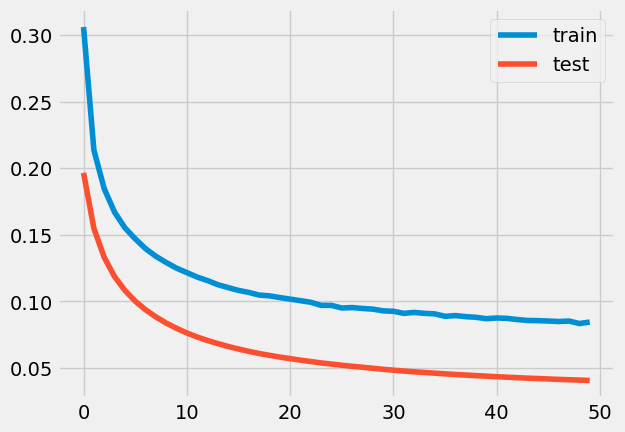

0.0
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 81ms/step - loss: 0.2569 - accuracy: 0.0000e+00 - val_loss: 0.1505 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 52ms/step - loss: 0.1714 - accuracy: 0.0000e+00 - val_loss: 0.1146 - val_accuracy: 0.0000e+00
Epoch 3/50
20/


loss: 3.06%



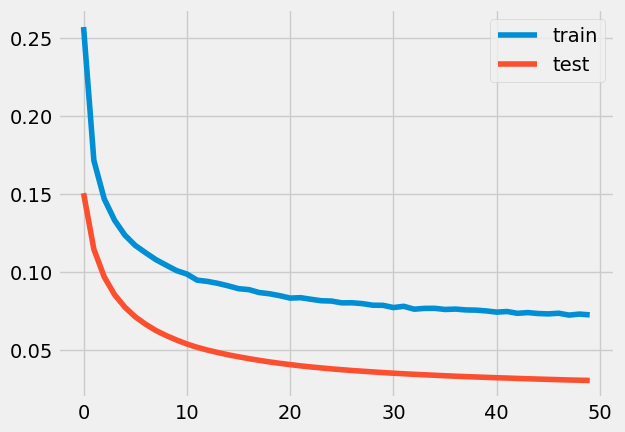

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 86ms/step - loss: 0.2216 - accuracy: 0.0000e+00 - val_loss: 0.1243 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 54ms/step - loss: 0.1544 - accuracy: 0.0000e+00 - val_loss: 0.0967 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

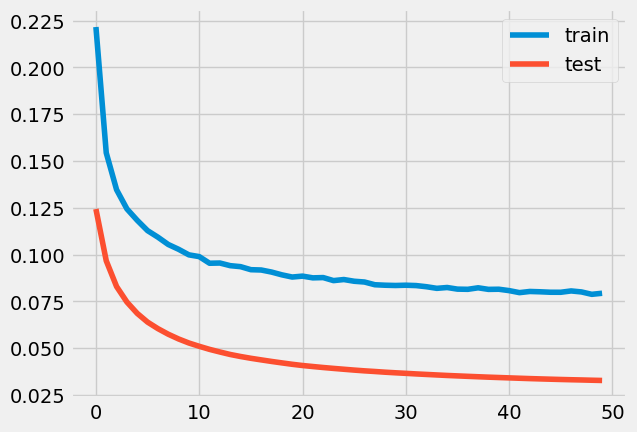

0.0
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 86ms/step - loss: 0.1922 - accuracy: 0.0000e+00 - val_loss: 0.1003 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 58ms/step - loss: 0.1329 - accuracy: 0.0000e+00 - val_loss: 0.0770 - val_accuracy: 0.0000e+00
Epoch 3/50
20/

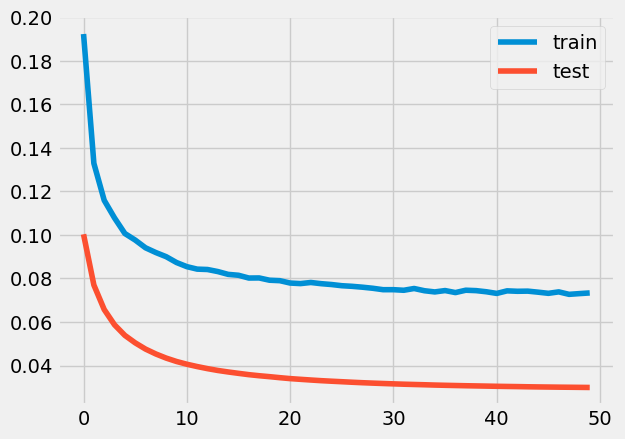

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 87ms/step - loss: 0.1845 - accuracy: 0.0000e+00 - val_loss: 0.0955 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 57ms/step - loss: 0.1324 - accuracy: 0.0000e+00 - val_loss: 0.0761 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

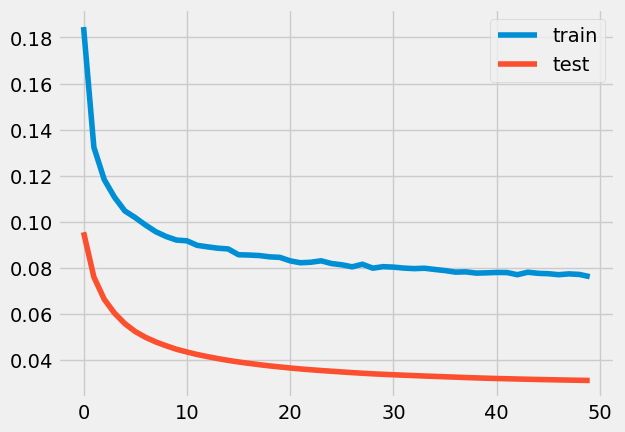

1.156282327524653e-233
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 88ms/step - loss: 0.2181 - accuracy: 0.0000e+00 - val_loss: 0.1241 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 57ms/step - loss: 0.1529 - accuracy: 0.0000e+00 - val_loss: 0.0972 - val_accuracy: 0.0000


loss: 3.05%



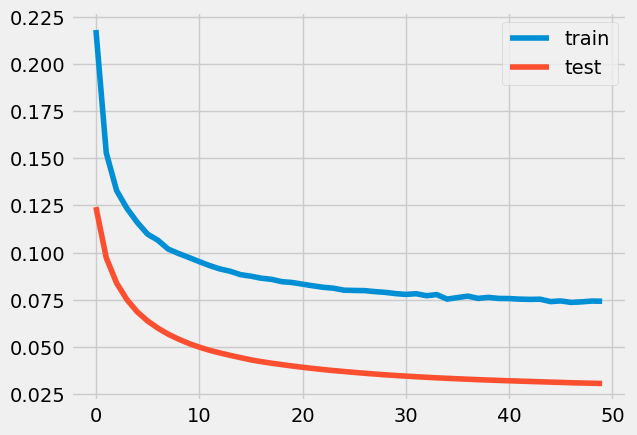

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 91ms/step - loss: 0.2824 - accuracy: 0.0000e+00 - val_loss: 0.1880 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 56ms/step - loss: 0.2115 - accuracy: 0.0000e+00 - val_loss: 0.1568 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

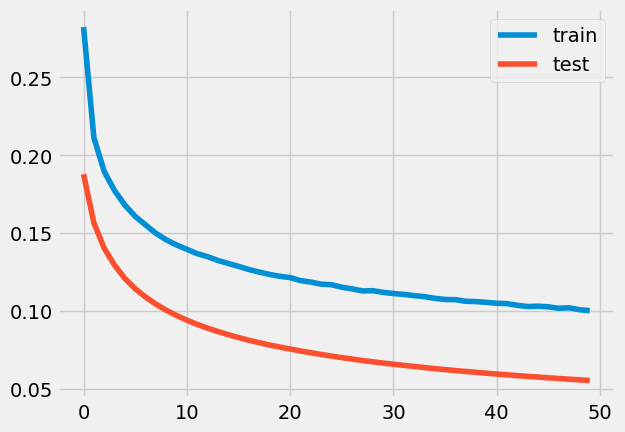

0.0
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 83ms/step - loss: 0.1902 - accuracy: 0.0000e+00 - val_loss: 0.0936 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 55ms/step - loss: 0.1260 - accuracy: 0.0000e+00 - val_loss: 0.0693 - val_accuracy: 0.0000e+00
Epoch 3/50
20/

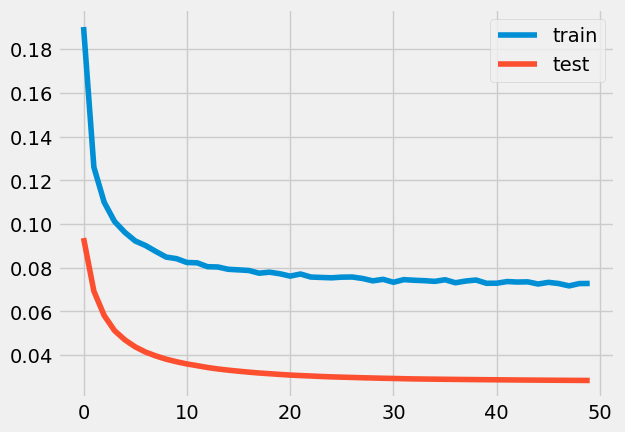

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 79ms/step - loss: 0.2448 - accuracy: 0.0000e+00 - val_loss: 0.1504 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 52ms/step - loss: 0.1773 - accuracy: 0.0000e+00 - val_loss: 0.1200 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

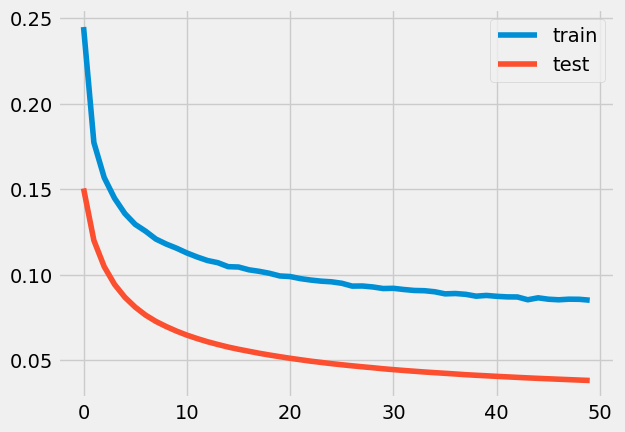

0.0
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 81ms/step - loss: 0.2708 - accuracy: 0.0000e+00 - val_loss: 0.1688 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 49ms/step - loss: 0.1893 - accuracy: 0.0000e+00 - val_loss: 0.1332 - val_accuracy: 0.0000e+00
Epoch 3/50
20/

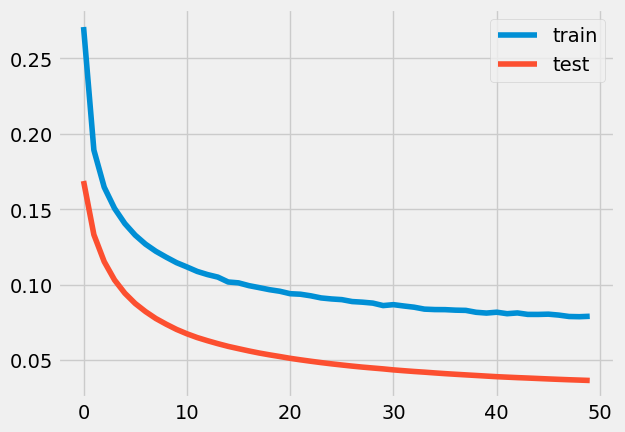

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 85ms/step - loss: 0.2716 - accuracy: 0.0000e+00 - val_loss: 0.1678 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 52ms/step - loss: 0.1902 - accuracy: 0.0000e+00 - val_loss: 0.1332 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

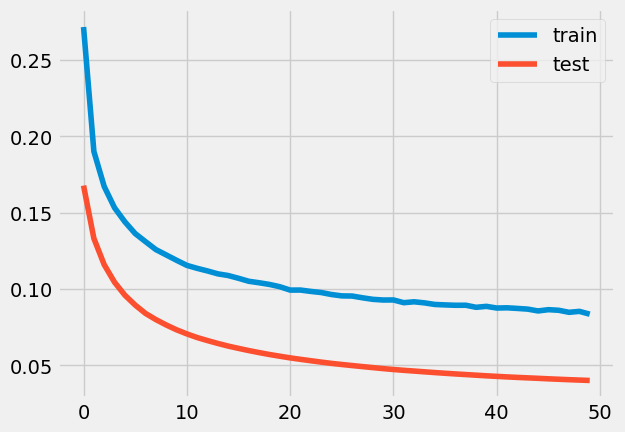

0.0
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 90ms/step - loss: 0.1341 - accuracy: 9.6311e-05 - val_loss: 0.0504 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 61ms/step - loss: 0.0926 - accuracy: 0.0014 - val_loss: 0.0386 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

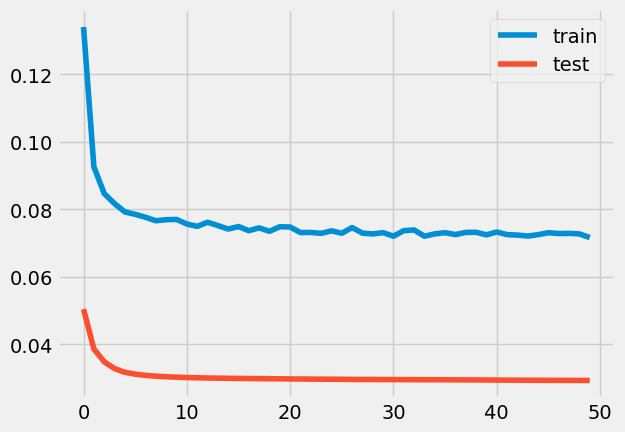

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 98ms/step - loss: 0.1660 - accuracy: 0.0000e+00 - val_loss: 0.0728 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 63ms/step - loss: 0.1093 - accuracy: 1.6393e-04 - val_loss: 0.0538 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

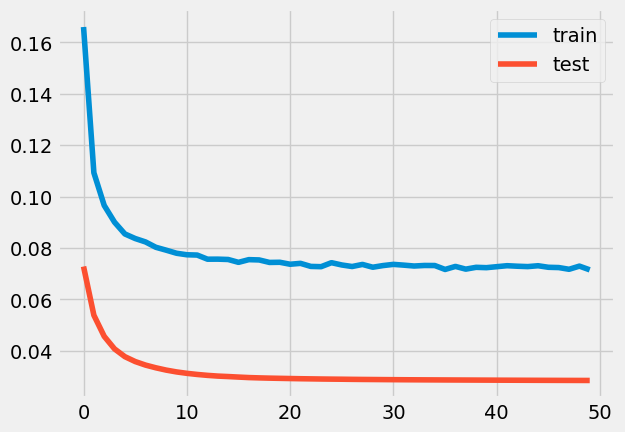

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 92ms/step - loss: 0.2777 - accuracy: 0.0000e+00 - val_loss: 0.1739 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 60ms/step - loss: 0.1945 - accuracy: 0.0000e+00 - val_loss: 0.1372 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

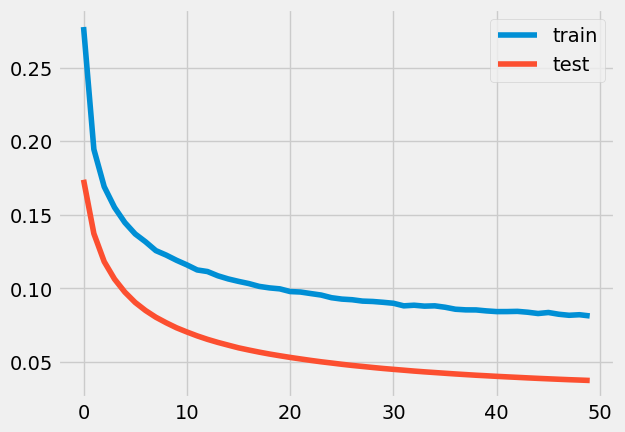

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 84ms/step - loss: 0.1812 - accuracy: 0.0000e+00 - val_loss: 0.0988 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 59ms/step - loss: 0.1339 - accuracy: 0.0000e+00 - val_loss: 0.0794 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

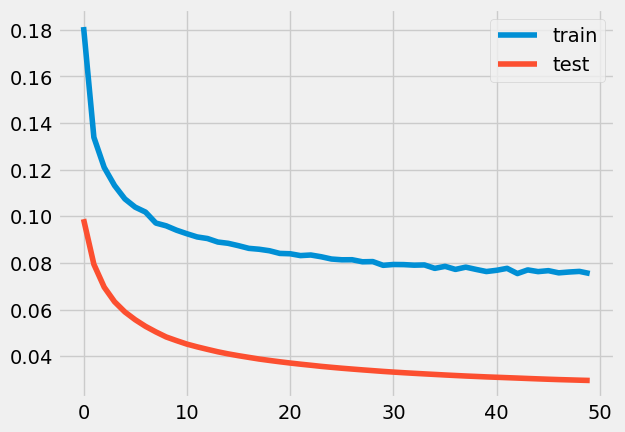

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 87ms/step - loss: 0.2340 - accuracy: 0.0000e+00 - val_loss: 0.1322 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.1610 - accuracy: 0.0000e+00 - val_loss: 0.1049 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [


loss: 3.31%



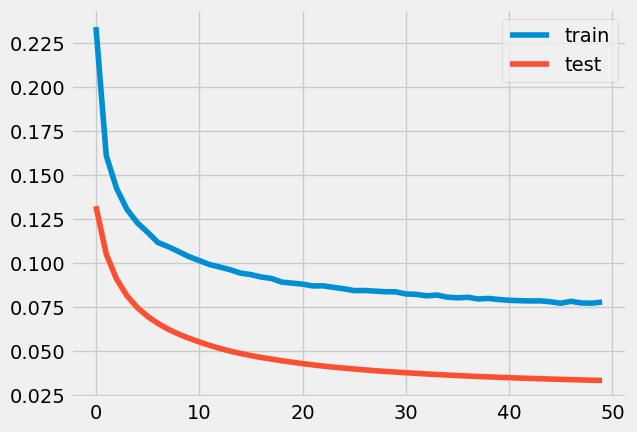

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 83ms/step - loss: 0.1080 - accuracy: 5.1844e-04 - val_loss: 0.0345 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 50ms/step - loss: 0.0797 - accuracy: 0.0044 - val_loss: 0.0291 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [====

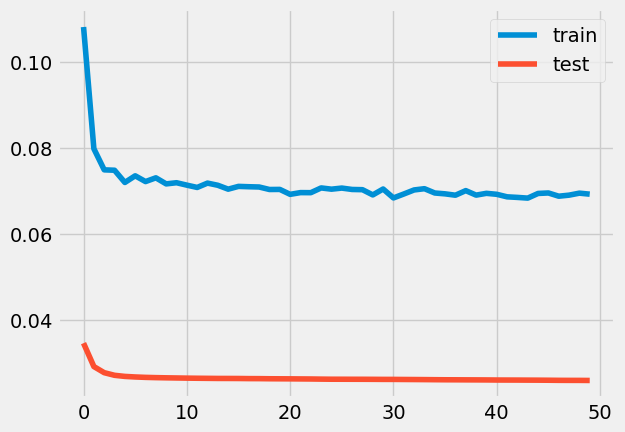

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 73ms/step - loss: 0.1017 - accuracy: 0.0010 - val_loss: 0.0305 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 48ms/step - loss: 0.0787 - accuracy: 0.0038 - val_loss: 0.0287 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

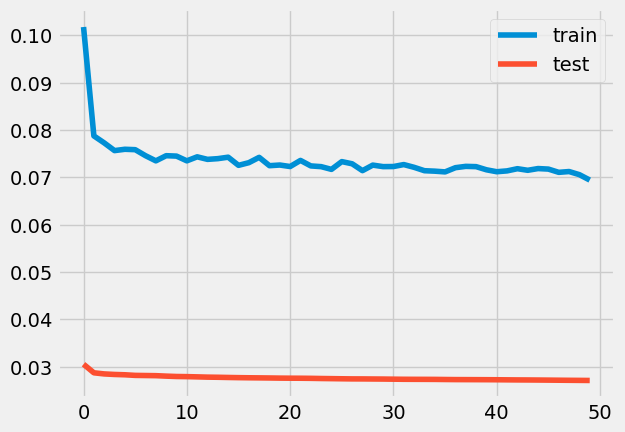

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 91ms/step - loss: 0.1994 - accuracy: 0.0000e+00 - val_loss: 0.1115 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 49ms/step - loss: 0.1443 - accuracy: 0.0000e+00 - val_loss: 0.0878 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

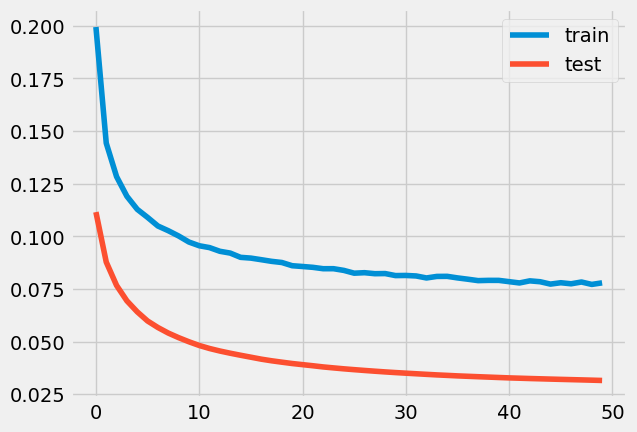

0.0
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 82ms/step - loss: 0.2924 - accuracy: 0.0000e+00 - val_loss: 0.1949 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 55ms/step - loss: 0.2145 - accuracy: 0.0000e+00 - val_loss: 0.1586 - val_accuracy: 0.0000e+00
Epoch 3/50
20/

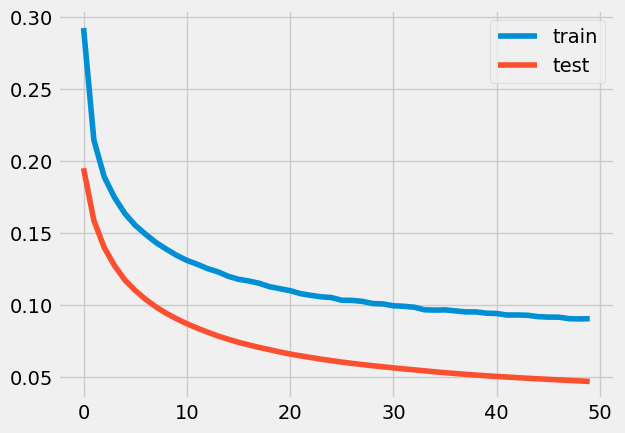

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 84ms/step - loss: 0.1198 - accuracy: 7.1311e-04 - val_loss: 0.0417 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 54ms/step - loss: 0.0852 - accuracy: 0.0029 - val_loss: 0.0329 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [====

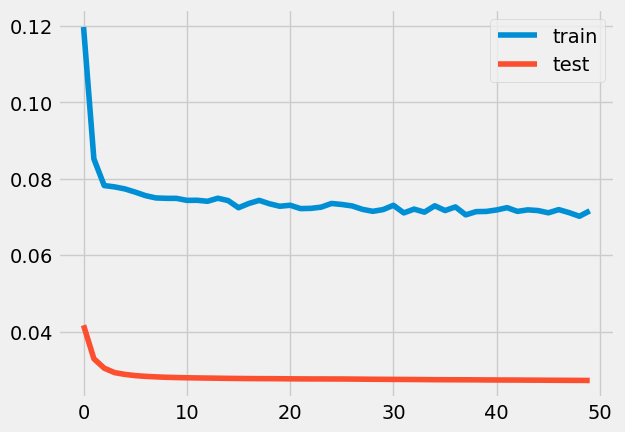

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 79ms/step - loss: 0.1549 - accuracy: 0.0000e+00 - val_loss: 0.0658 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 54ms/step - loss: 0.1029 - accuracy: 1.9672e-04 - val_loss: 0.0482 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

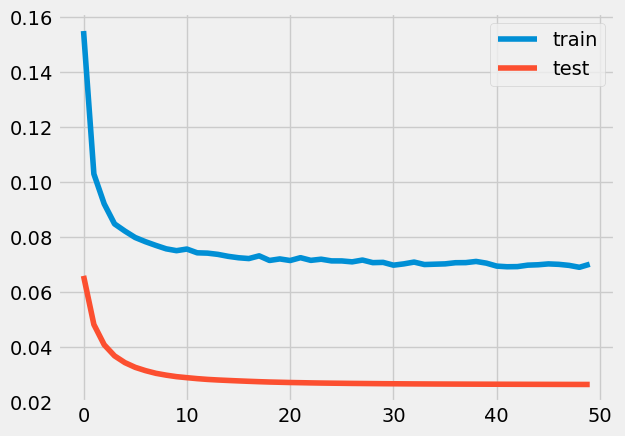

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 83ms/step - loss: 0.2755 - accuracy: 0.0000e+00 - val_loss: 0.1741 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 54ms/step - loss: 0.1964 - accuracy: 0.0000e+00 - val_loss: 0.1407 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

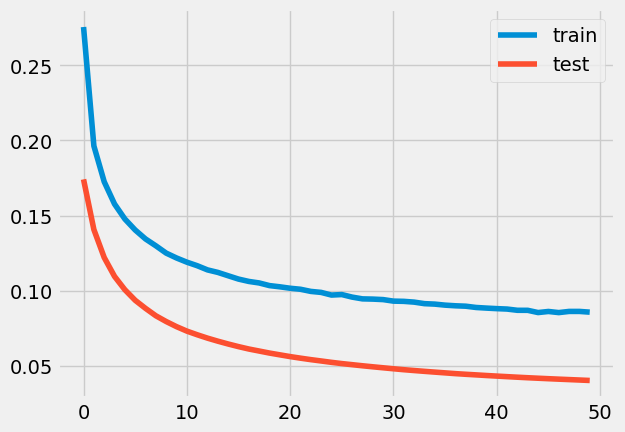

0.0
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 81ms/step - loss: 0.2080 - accuracy: 0.0000e+00 - val_loss: 0.1080 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 52ms/step - loss: 0.1386 - accuracy: 0.0000e+00 - val_loss: 0.0820 - val_accuracy: 0.0000e+00
Epoch 3/50
20/

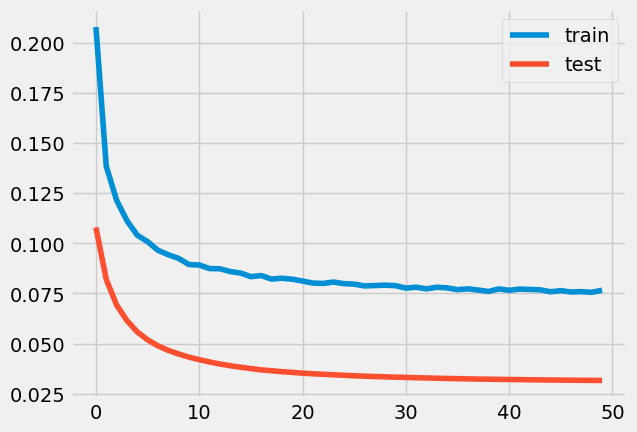

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 82ms/step - loss: 0.1108 - accuracy: 0.0011 - val_loss: 0.0348 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 50ms/step - loss: 0.0805 - accuracy: 0.0033 - val_loss: 0.0282 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

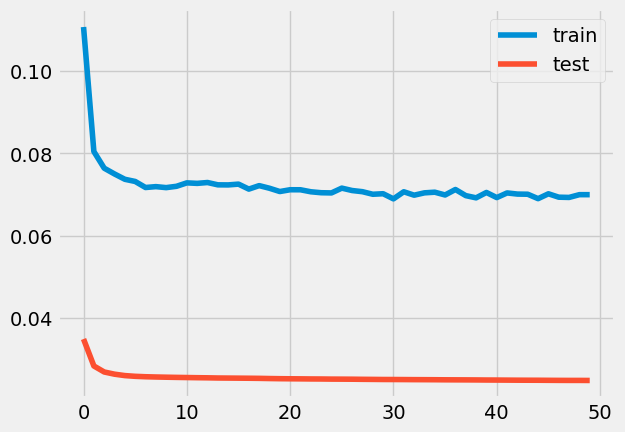

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 83ms/step - loss: 0.1492 - accuracy: 0.0000e+00 - val_loss: 0.0622 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.1025 - accuracy: 6.8648e-04 - val_loss: 0.0470 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

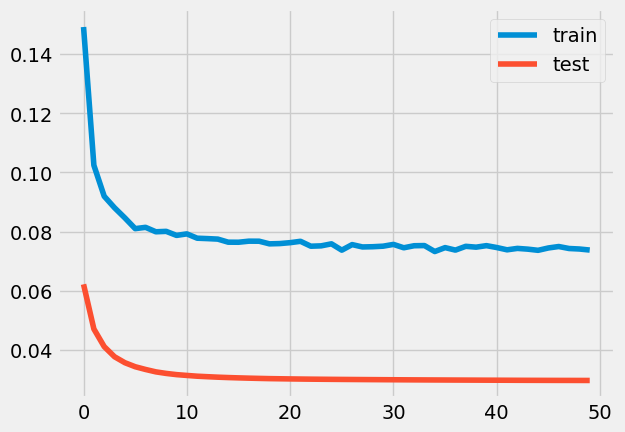

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 84ms/step - loss: 0.2312 - accuracy: 0.0000e+00 - val_loss: 0.1447 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 55ms/step - loss: 0.1751 - accuracy: 0.0000e+00 - val_loss: 0.1209 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

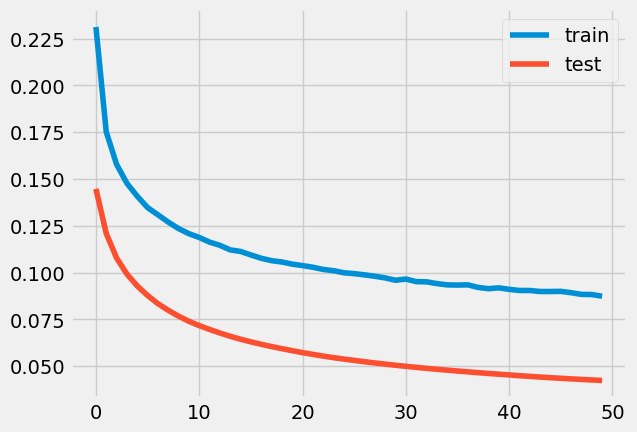

0.0
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 87ms/step - loss: 0.2009 - accuracy: 0.0000e+00 - val_loss: 0.1085 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 55ms/step - loss: 0.1404 - accuracy: 0.0000e+00 - val_loss: 0.0841 - val_accuracy: 0.0000e+00
Epoch 3/50
20/

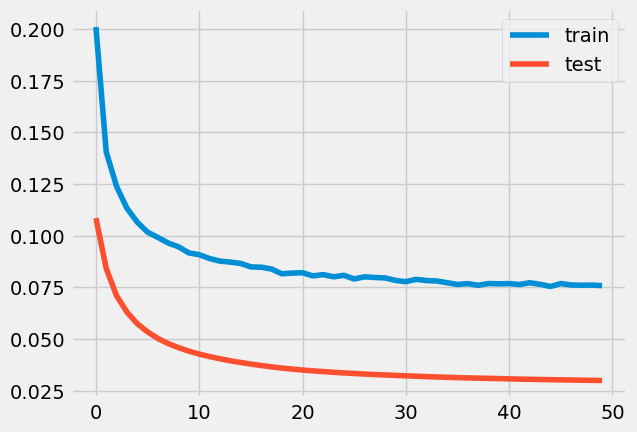

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 83ms/step - loss: 0.2283 - accuracy: 0.0000e+00 - val_loss: 0.1355 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 56ms/step - loss: 0.1663 - accuracy: 0.0000e+00 - val_loss: 0.1107 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

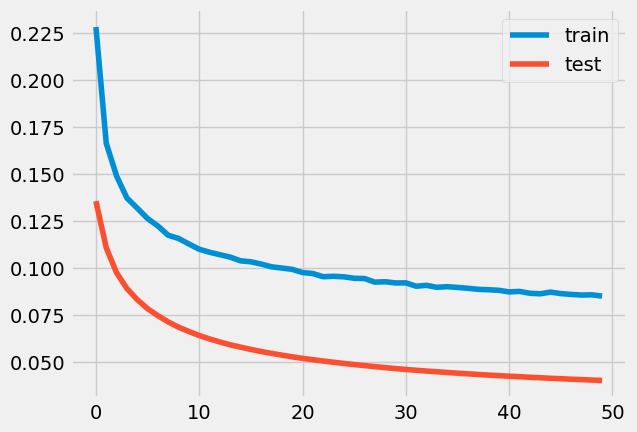

0.0
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 82ms/step - loss: 0.0821 - accuracy: 0.0048 - val_loss: 0.0302 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 54ms/step - loss: 0.0780 - accuracy: 0.0054 - val_loss: 0.0293 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [====

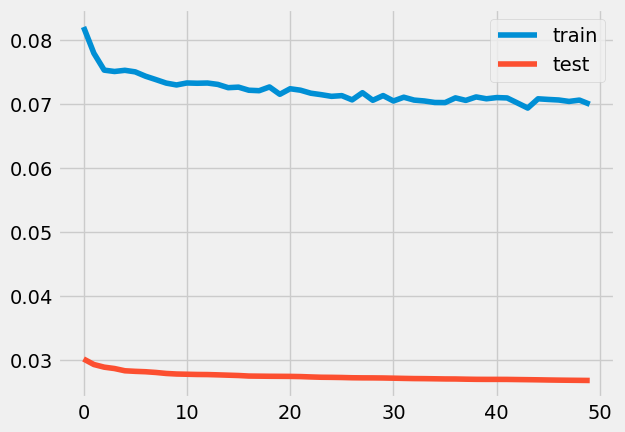

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 82ms/step - loss: 0.2154 - accuracy: 0.0000e+00 - val_loss: 0.1133 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 52ms/step - loss: 0.1417 - accuracy: 0.0000e+00 - val_loss: 0.0848 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

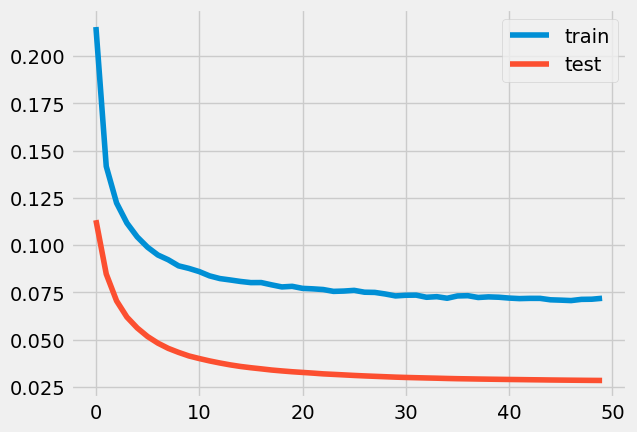

9.77066529994625e-285
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 85ms/step - loss: 0.2093 - accuracy: 0.0000e+00 - val_loss: 0.1105 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 49ms/step - loss: 0.1419 - accuracy: 0.0000e+00 - val_loss: 0.0843 - val_accuracy: 0.0000e

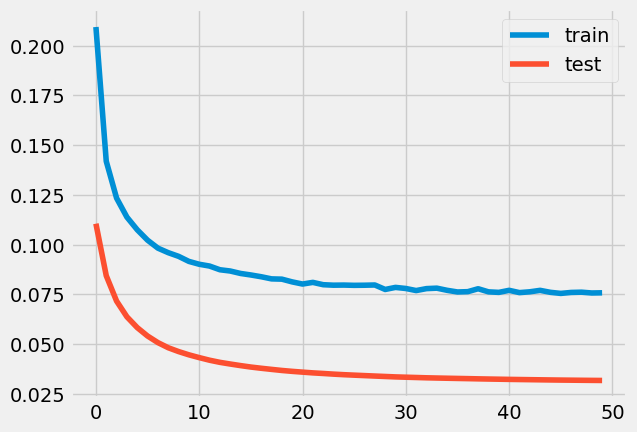

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 75ms/step - loss: 0.1225 - accuracy: 5.1434e-04 - val_loss: 0.0440 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 50ms/step - loss: 0.0882 - accuracy: 0.0026 - val_loss: 0.0348 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [====

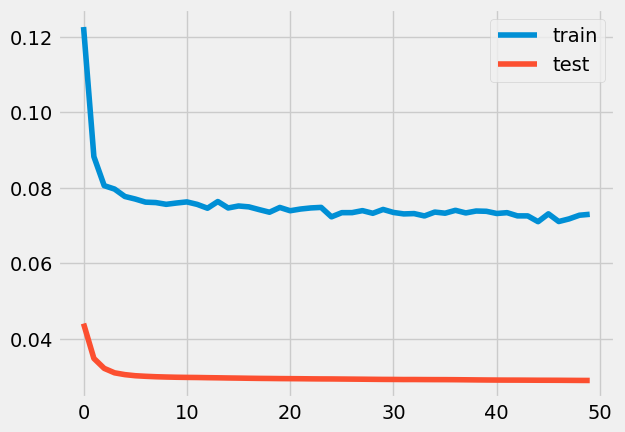

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 88ms/step - loss: 0.1095 - accuracy: 5.2869e-04 - val_loss: 0.0344 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 55ms/step - loss: 0.0792 - accuracy: 0.0030 - val_loss: 0.0281 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [====

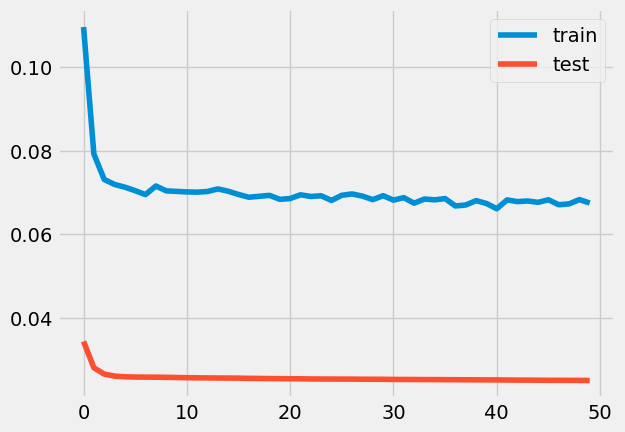

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 87ms/step - loss: 0.1486 - accuracy: 3.2787e-05 - val_loss: 0.0599 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 61ms/step - loss: 0.1001 - accuracy: 6.7623e-04 - val_loss: 0.0448 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

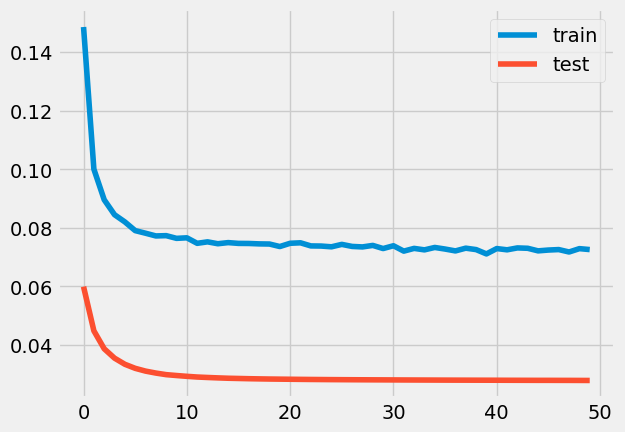

0.0
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 89ms/step - loss: 0.1898 - accuracy: 0.0000e+00 - val_loss: 0.0885 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 58ms/step - loss: 0.1215 - accuracy: 2.0492e-06 - val_loss: 0.0637 - val_accuracy: 0.0000e+00
Epoch 3/50
20/

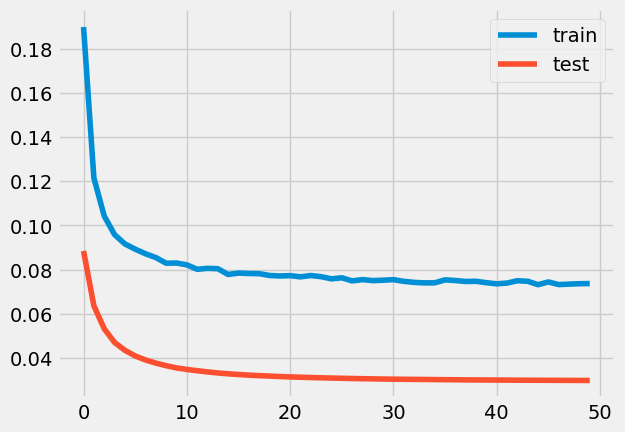

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 86ms/step - loss: 0.3524 - accuracy: 0.0000e+00 - val_loss: 0.2371 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 59ms/step - loss: 0.2482 - accuracy: 0.0000e+00 - val_loss: 0.1916 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

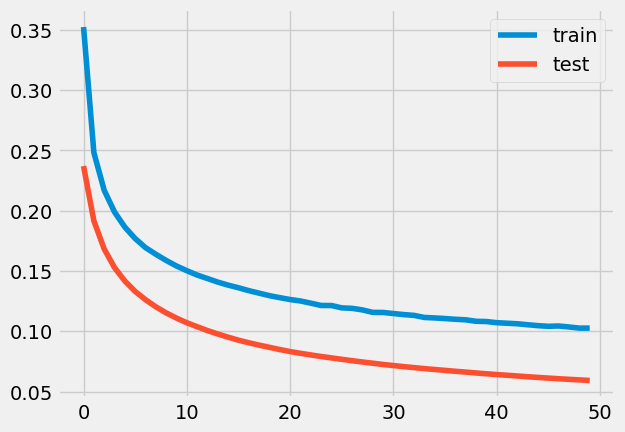

0.0
1.220703125e-06
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 88ms/step - loss: 0.4286 - accuracy: 0.0000e+00 - val_loss: 0.3161 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 59ms/step - loss: 0.3156 - accuracy: 0.0000e+00 - val_loss: 0.2640 - val_accuracy: 0.0000e+0

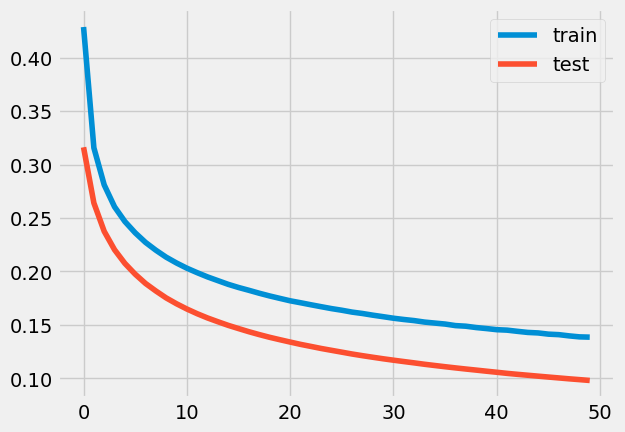

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 90ms/step - loss: 0.0818 - accuracy: 0.0030 - val_loss: 0.0297 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 56ms/step - loss: 0.0751 - accuracy: 0.0054 - val_loss: 0.0290 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

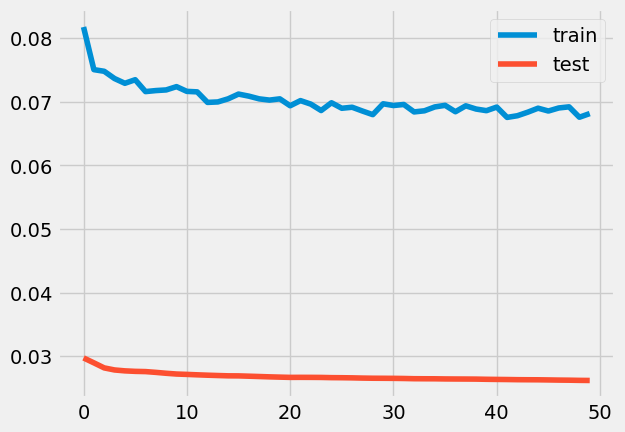

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 80ms/step - loss: 0.1530 - accuracy: 0.0000e+00 - val_loss: 0.0746 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 52ms/step - loss: 0.1147 - accuracy: 9.0164e-05 - val_loss: 0.0592 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

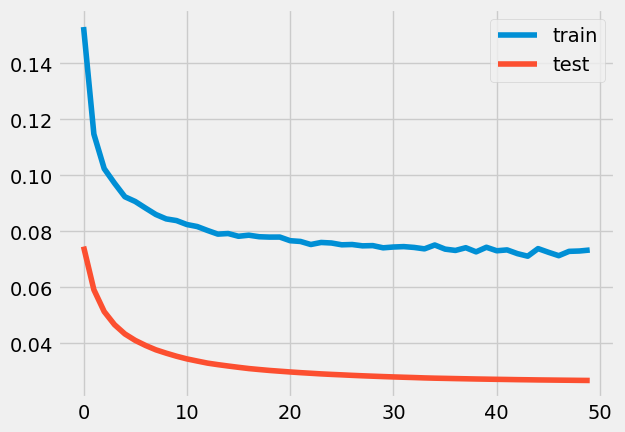

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 80ms/step - loss: 0.2554 - accuracy: 0.0000e+00 - val_loss: 0.1529 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 51ms/step - loss: 0.1770 - accuracy: 0.0000e+00 - val_loss: 0.1193 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [


loss: 3.70%



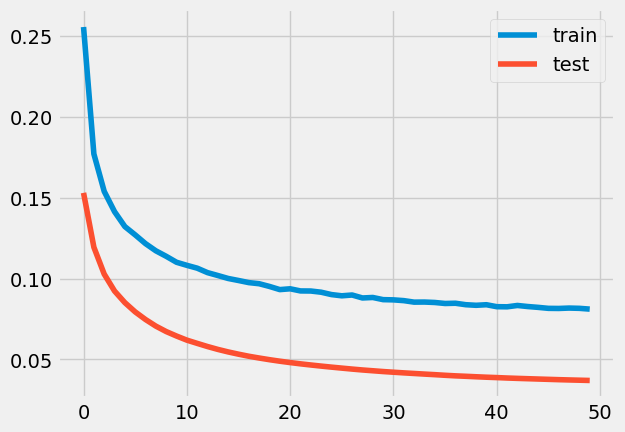

0.0
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 82ms/step - loss: 0.1540 - accuracy: 0.0000e+00 - val_loss: 0.0632 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 52ms/step - loss: 0.0996 - accuracy: 3.4016e-04 - val_loss: 0.0457 - val_accuracy: 0.0000e+00
Epoch 3/50
20/

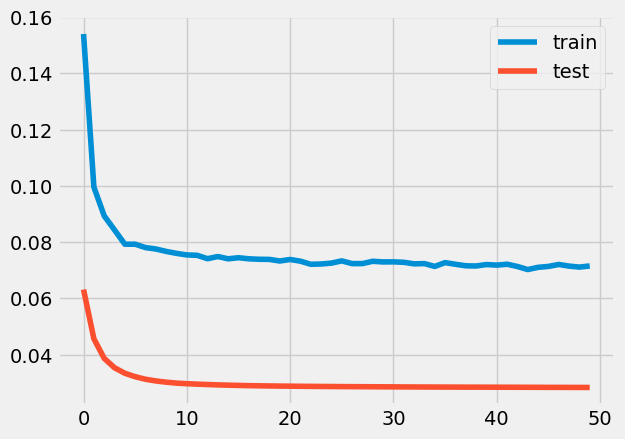

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 83ms/step - loss: 0.2173 - accuracy: 0.0000e+00 - val_loss: 0.1219 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 59ms/step - loss: 0.1524 - accuracy: 0.0000e+00 - val_loss: 0.0949 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

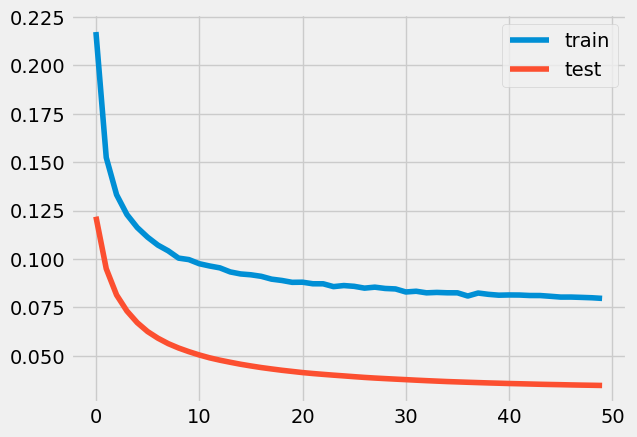

0.0
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 86ms/step - loss: 0.1736 - accuracy: 0.0000e+00 - val_loss: 0.0786 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 59ms/step - loss: 0.1120 - accuracy: 1.1885e-04 - val_loss: 0.0575 - val_accuracy: 0.0000e+00
Epoch 3/50
20/

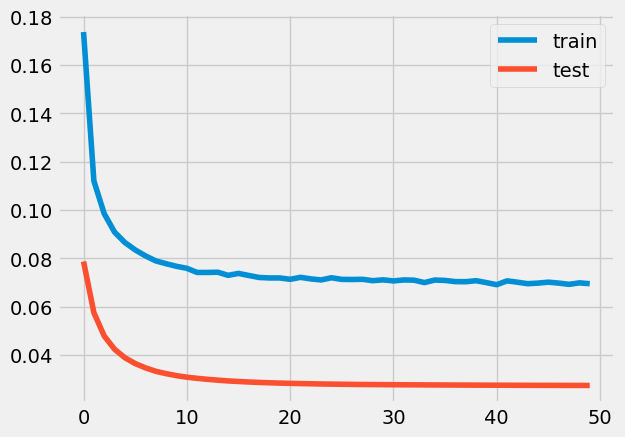

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 95ms/step - loss: 0.2042 - accuracy: 0.0000e+00 - val_loss: 0.1127 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 58ms/step - loss: 0.1455 - accuracy: 0.0000e+00 - val_loss: 0.0895 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

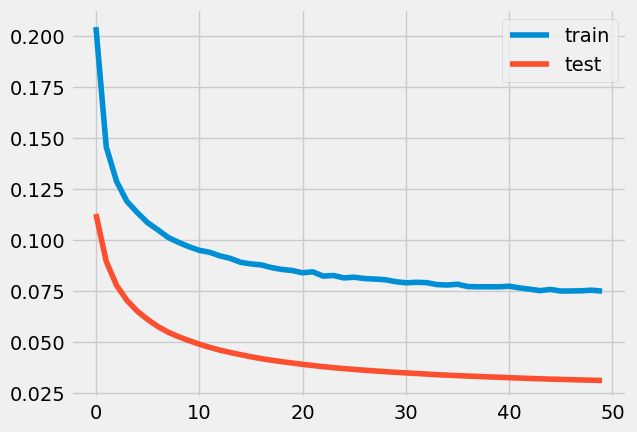

0.0
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 86ms/step - loss: 0.1821 - accuracy: 0.0000e+00 - val_loss: 0.0931 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 55ms/step - loss: 0.1272 - accuracy: 0.0000e+00 - val_loss: 0.0709 - val_accuracy: 0.0000e+00
Epoch 3/50
20/

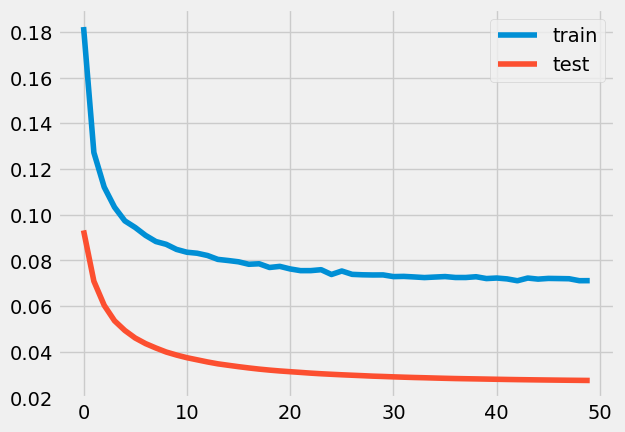

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 81ms/step - loss: 0.2423 - accuracy: 0.0000e+00 - val_loss: 0.1631 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 54ms/step - loss: 0.1940 - accuracy: 0.0000e+00 - val_loss: 0.1404 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

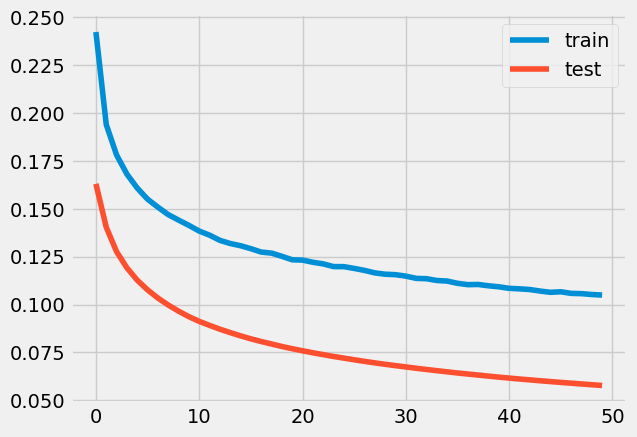

0.0
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 80ms/step - loss: 0.2299 - accuracy: 0.0000e+00 - val_loss: 0.1317 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 49ms/step - loss: 0.1596 - accuracy: 0.0000e+00 - val_loss: 0.1041 - val_accuracy: 0.0000e+00
Epoch 3/50
20/


loss: 3.22%



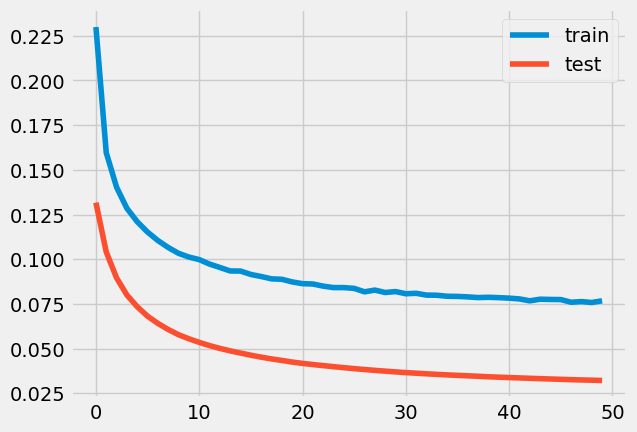

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 86ms/step - loss: 0.1646 - accuracy: 0.0000e+00 - val_loss: 0.0751 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 54ms/step - loss: 0.1113 - accuracy: 7.3770e-05 - val_loss: 0.0561 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

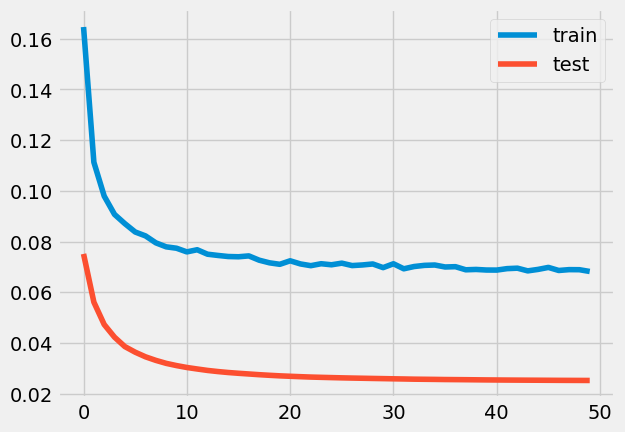

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 83ms/step - loss: 0.2728 - accuracy: 0.0000e+00 - val_loss: 0.1836 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 55ms/step - loss: 0.2051 - accuracy: 0.0000e+00 - val_loss: 0.1518 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

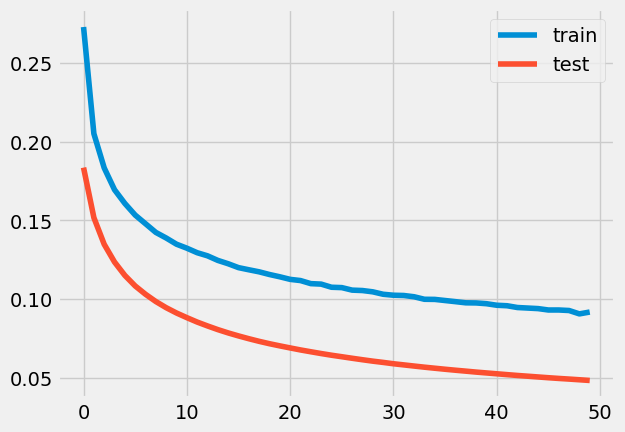

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 84ms/step - loss: 0.1594 - accuracy: 0.0000e+00 - val_loss: 0.0716 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 57ms/step - loss: 0.1093 - accuracy: 1.0041e-04 - val_loss: 0.0537 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

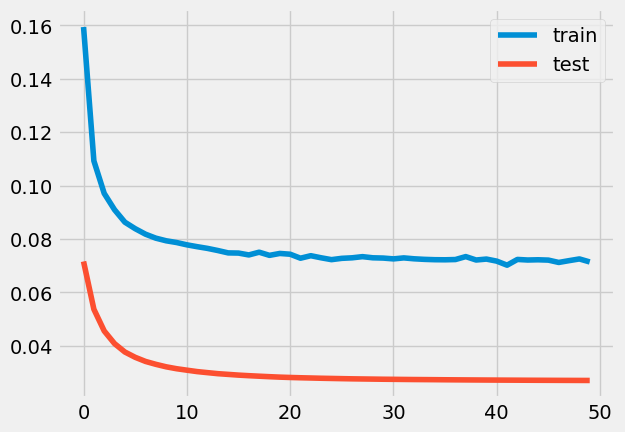

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 83ms/step - loss: 0.1813 - accuracy: 0.0000e+00 - val_loss: 0.0873 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 56ms/step - loss: 0.1227 - accuracy: 1.6393e-05 - val_loss: 0.0649 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

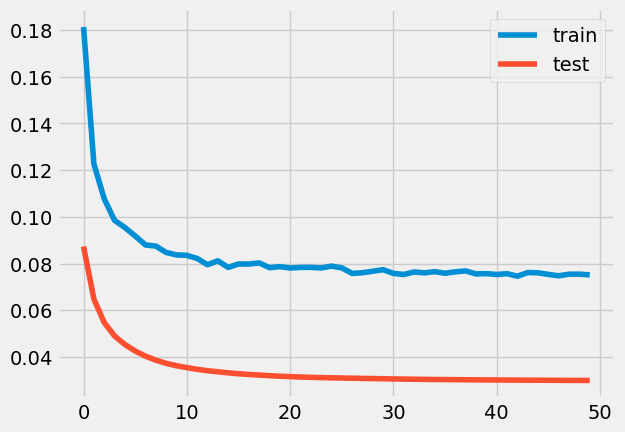

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 90ms/step - loss: 0.2555 - accuracy: 0.0000e+00 - val_loss: 0.1564 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 54ms/step - loss: 0.1797 - accuracy: 0.0000e+00 - val_loss: 0.1232 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [


loss: 3.54%



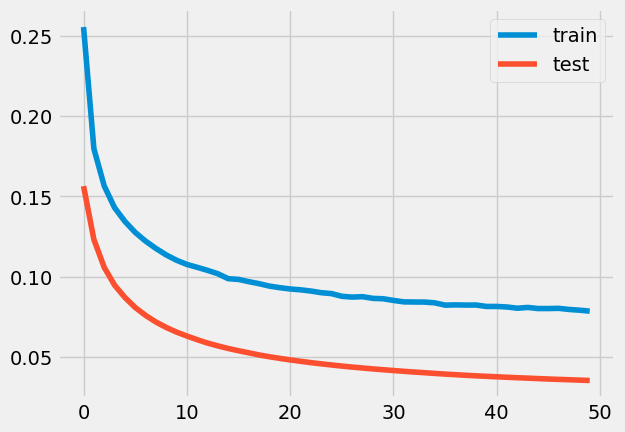

0.0
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 82ms/step - loss: 0.1971 - accuracy: 0.0000e+00 - val_loss: 0.1037 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.1332 - accuracy: 0.0000e+00 - val_loss: 0.0765 - val_accuracy: 0.0000e+00
Epoch 3/50
20/

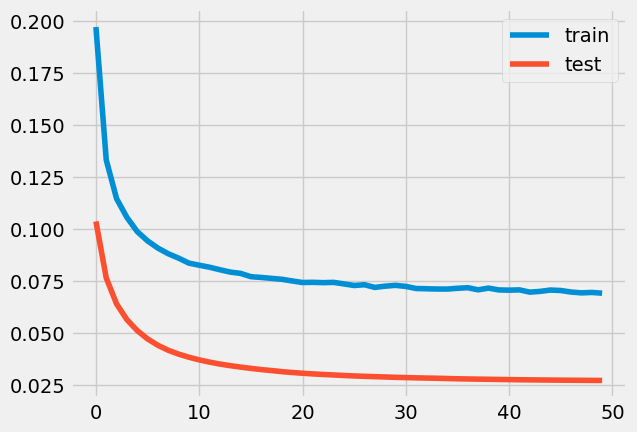

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 80ms/step - loss: 0.3500 - accuracy: 0.0000e+00 - val_loss: 0.2544 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 52ms/step - loss: 0.2704 - accuracy: 0.0000e+00 - val_loss: 0.2201 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

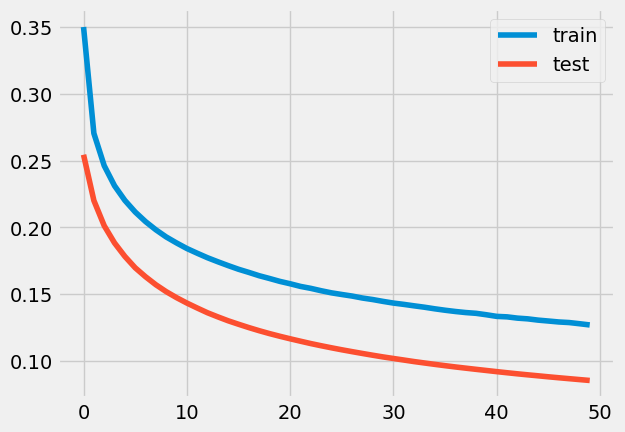

0.0
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 3s 78ms/step - loss: 0.1812 - accuracy: 0.0000e+00 - val_loss: 0.0897 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 48ms/step - loss: 0.1260 - accuracy: 0.0000e+00 - val_loss: 0.0694 - val_accuracy: 0.0000e+00
Epoch 3/50
20/

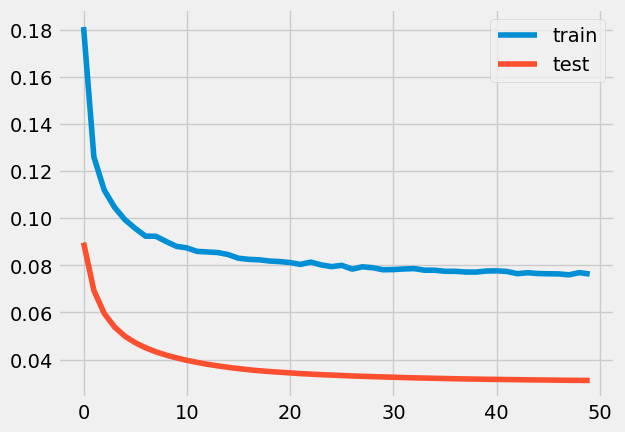

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 82ms/step - loss: 0.0972 - accuracy: 7.1926e-04 - val_loss: 0.0283 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 52ms/step - loss: 0.0763 - accuracy: 0.0046 - val_loss: 0.0266 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [====

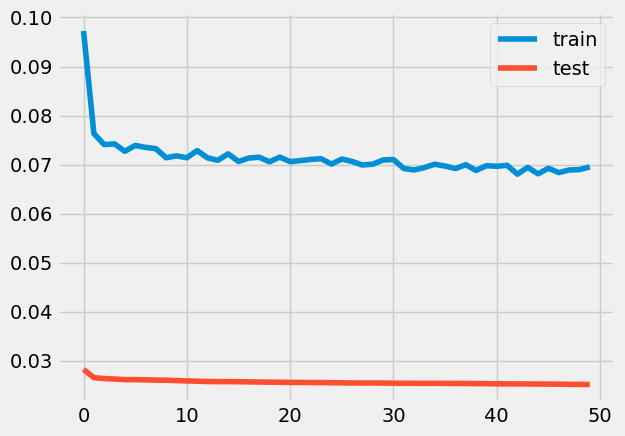

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 88ms/step - loss: 0.1890 - accuracy: 0.0000e+00 - val_loss: 0.0902 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 57ms/step - loss: 0.1232 - accuracy: 6.1475e-06 - val_loss: 0.0650 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

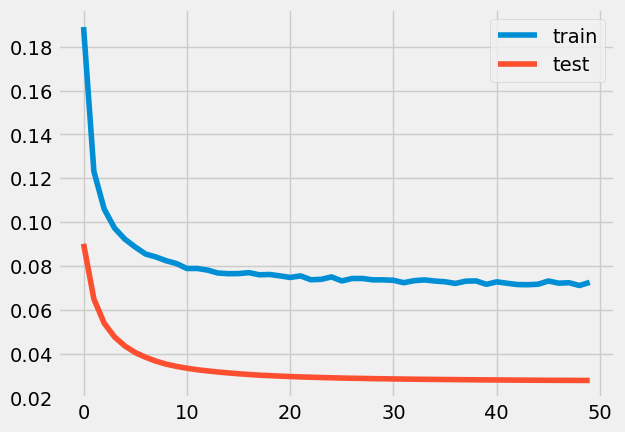

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 82ms/step - loss: 0.2609 - accuracy: 0.0000e+00 - val_loss: 0.1649 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 58ms/step - loss: 0.1896 - accuracy: 0.0000e+00 - val_loss: 0.1343 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

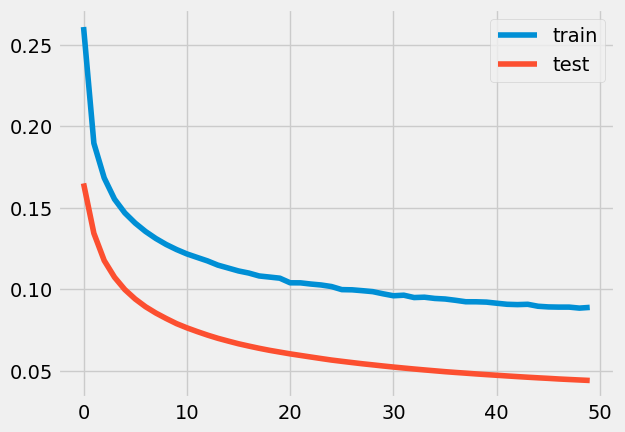

0.0
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 91ms/step - loss: 0.2163 - accuracy: 0.0000e+00 - val_loss: 0.1215 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 57ms/step - loss: 0.1502 - accuracy: 0.0000e+00 - val_loss: 0.0948 - val_accuracy: 0.0000e+00
Epoch 3/50
20/

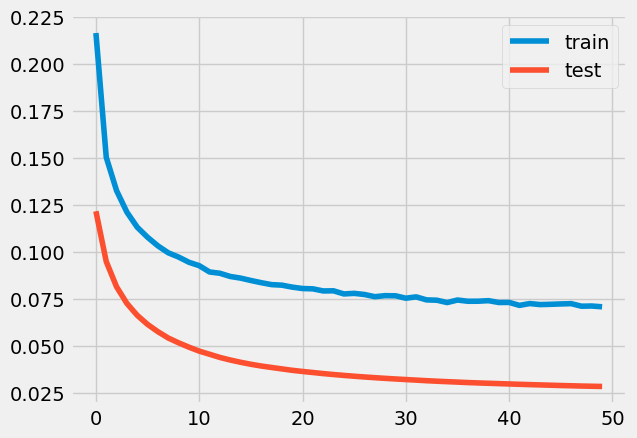

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 84ms/step - loss: 0.2251 - accuracy: 0.0000e+00 - val_loss: 0.1395 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 56ms/step - loss: 0.1685 - accuracy: 0.0000e+00 - val_loss: 0.1138 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

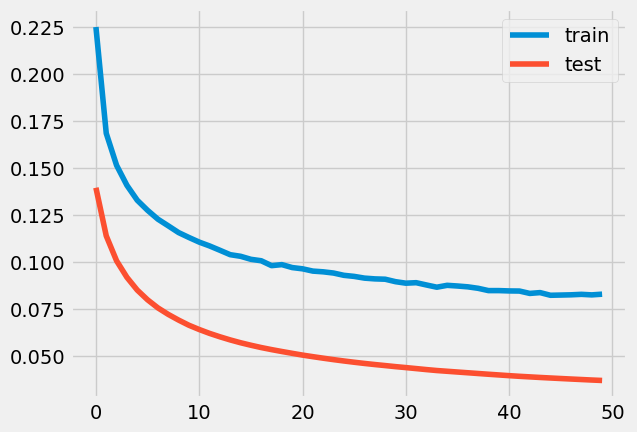

0.0
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 80ms/step - loss: 0.1487 - accuracy: 0.0000e+00 - val_loss: 0.0594 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 57ms/step - loss: 0.0983 - accuracy: 3.8934e-04 - val_loss: 0.0432 - val_accuracy: 0.0000e+00
Epoch 3/50
20/

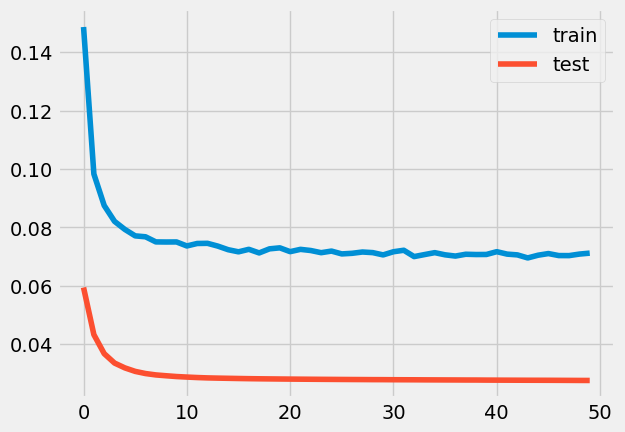

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 86ms/step - loss: 0.1580 - accuracy: 0.0000e+00 - val_loss: 0.0636 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.1017 - accuracy: 2.0697e-04 - val_loss: 0.0468 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

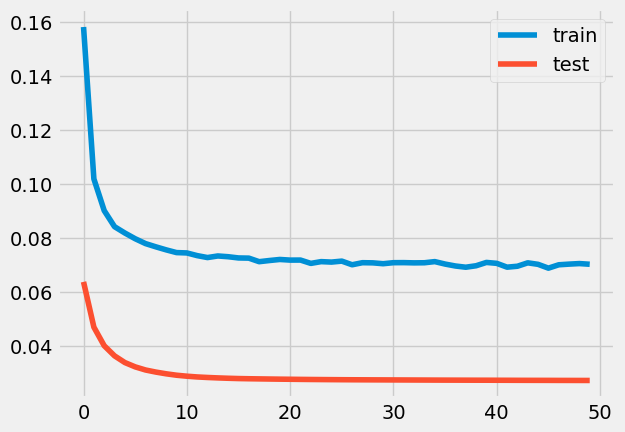

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 83ms/step - loss: 0.1941 - accuracy: 0.0000e+00 - val_loss: 0.1025 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 50ms/step - loss: 0.1351 - accuracy: 0.0000e+00 - val_loss: 0.0781 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

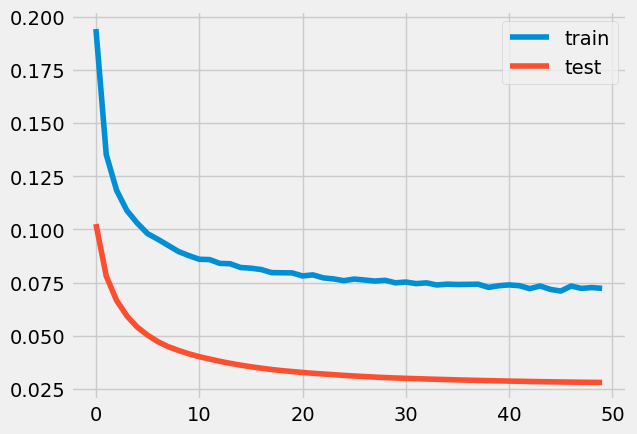

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 83ms/step - loss: 0.1941 - accuracy: 0.0000e+00 - val_loss: 0.0885 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 52ms/step - loss: 0.1209 - accuracy: 1.4139e-04 - val_loss: 0.0630 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

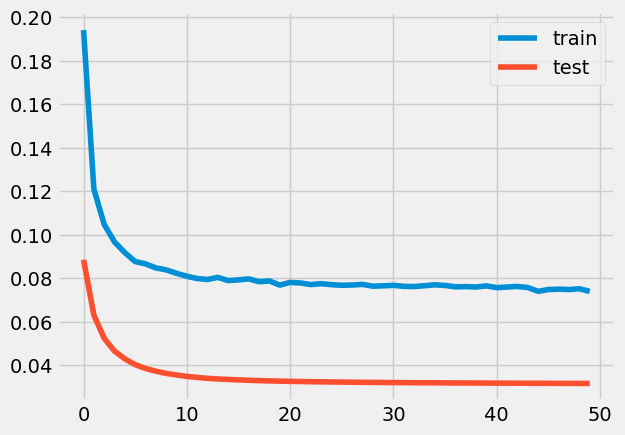

0.0
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 90ms/step - loss: 0.2857 - accuracy: 0.0000e+00 - val_loss: 0.1810 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 59ms/step - loss: 0.2014 - accuracy: 0.0000e+00 - val_loss: 0.1454 - val_accuracy: 0.0000e+00
Epoch 3/50
20/

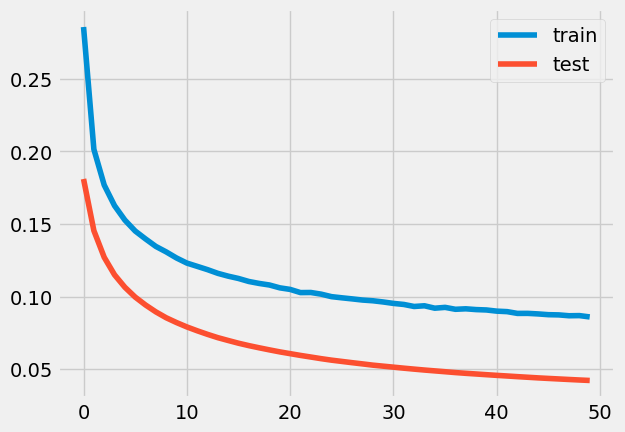

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 92ms/step - loss: 0.3729 - accuracy: 0.0000e+00 - val_loss: 0.2588 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 61ms/step - loss: 0.2663 - accuracy: 0.0000e+00 - val_loss: 0.2125 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

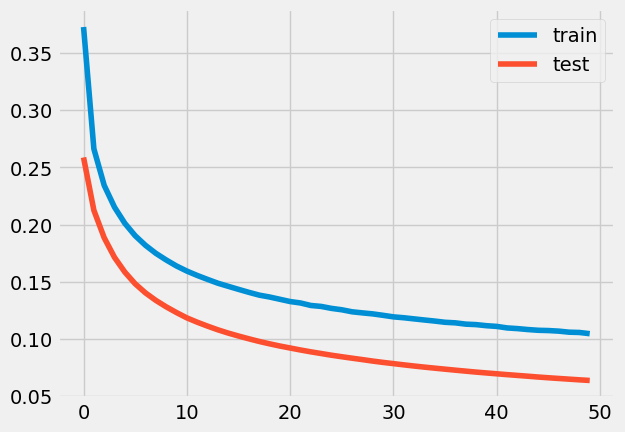

0.0
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 86ms/step - loss: 0.2190 - accuracy: 0.0000e+00 - val_loss: 0.1275 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 58ms/step - loss: 0.1569 - accuracy: 0.0000e+00 - val_loss: 0.1021 - val_accuracy: 0.0000e+00
Epoch 3/50
20/


loss: 3.35%



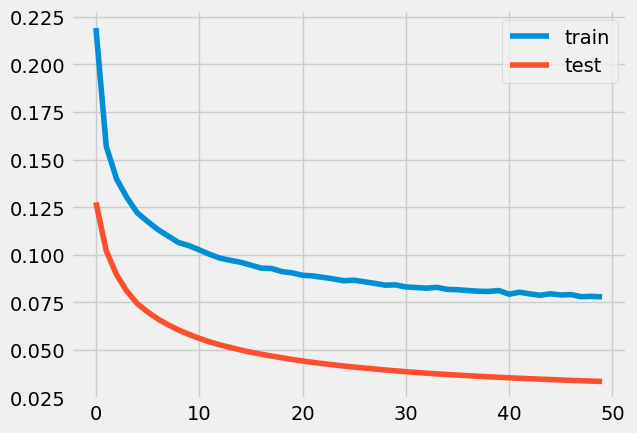

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 89ms/step - loss: 0.1898 - accuracy: 0.0000e+00 - val_loss: 0.0927 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 59ms/step - loss: 0.1274 - accuracy: 0.0000e+00 - val_loss: 0.0701 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

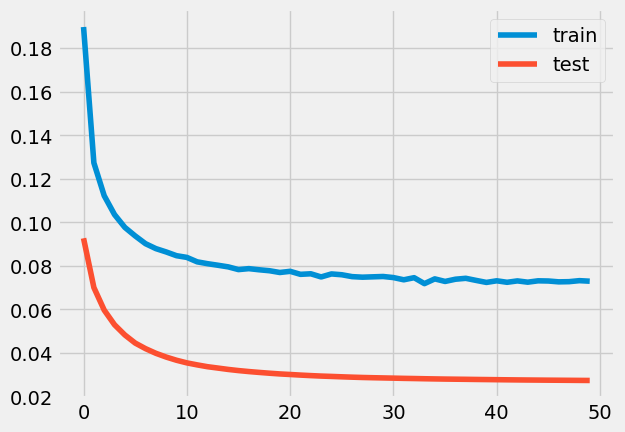

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 85ms/step - loss: 0.2650 - accuracy: 0.0000e+00 - val_loss: 0.1774 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 55ms/step - loss: 0.2029 - accuracy: 0.0000e+00 - val_loss: 0.1486 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

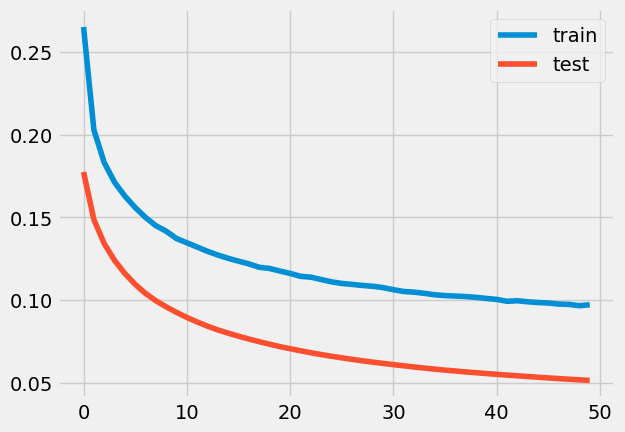

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 85ms/step - loss: 0.0941 - accuracy: 0.0027 - val_loss: 0.0301 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 50ms/step - loss: 0.0793 - accuracy: 0.0046 - val_loss: 0.0303 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [========

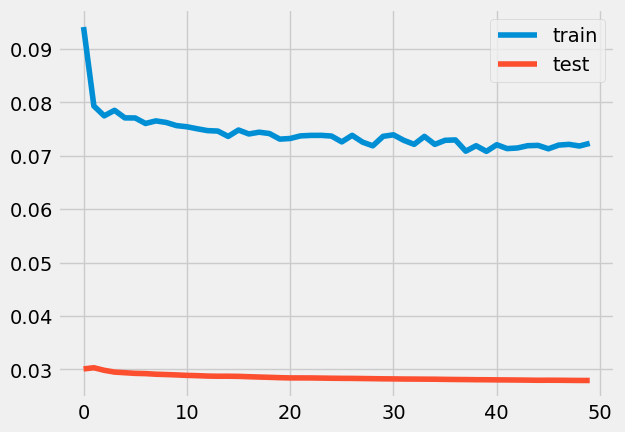

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 80ms/step - loss: 0.2144 - accuracy: 0.0000e+00 - val_loss: 0.1328 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 51ms/step - loss: 0.1656 - accuracy: 0.0000e+00 - val_loss: 0.1111 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

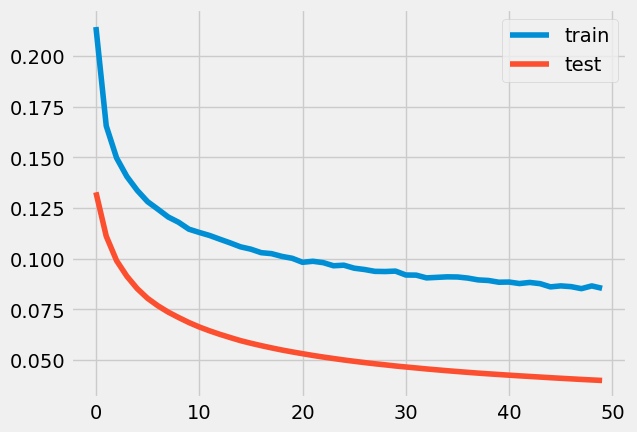

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 86ms/step - loss: 0.1859 - accuracy: 0.0000e+00 - val_loss: 0.0928 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 54ms/step - loss: 0.1245 - accuracy: 0.0000e+00 - val_loss: 0.0685 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

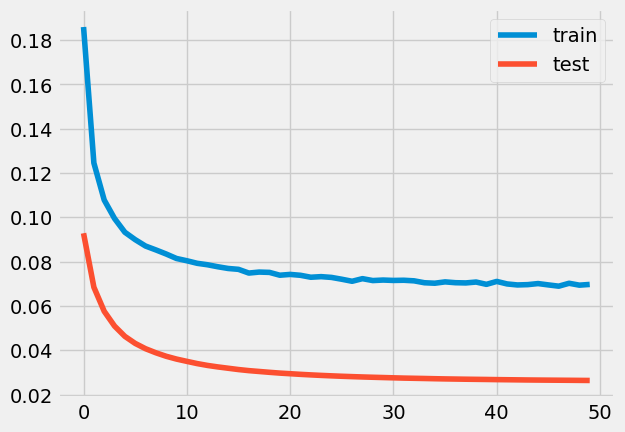

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 5s 88ms/step - loss: 0.1242 - accuracy: 2.6434e-04 - val_loss: 0.0485 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 58ms/step - loss: 0.0929 - accuracy: 0.0016 - val_loss: 0.0389 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [====

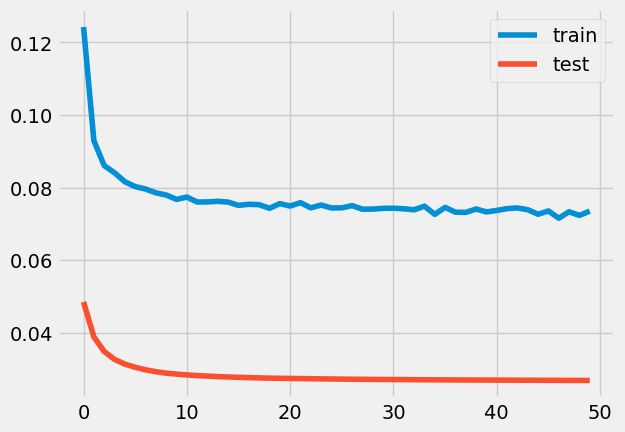

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 87ms/step - loss: 0.1646 - accuracy: 0.0000e+00 - val_loss: 0.0646 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 57ms/step - loss: 0.1013 - accuracy: 3.8320e-04 - val_loss: 0.0459 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

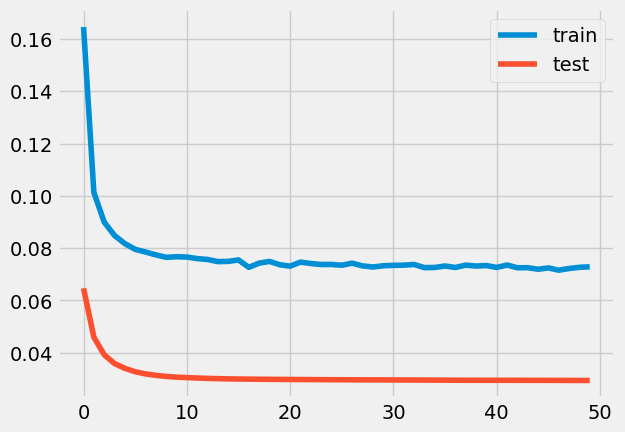

0.0
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 88ms/step - loss: 0.2689 - accuracy: 0.0000e+00 - val_loss: 0.1685 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 55ms/step - loss: 0.1913 - accuracy: 0.0000e+00 - val_loss: 0.1355 - val_accuracy: 0.0000e+00
Epoch 3/50
20/

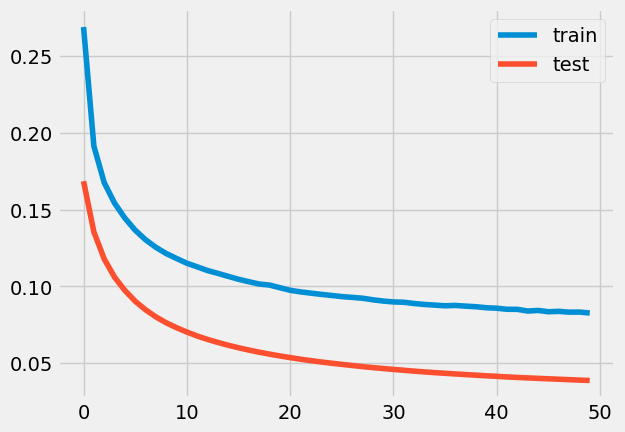

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 82ms/step - loss: 0.3132 - accuracy: 0.0000e+00 - val_loss: 0.2179 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 57ms/step - loss: 0.2353 - accuracy: 0.0000e+00 - val_loss: 0.1812 - val_accuracy: 0.0000e+00
Epoch 3/50
20/20 [

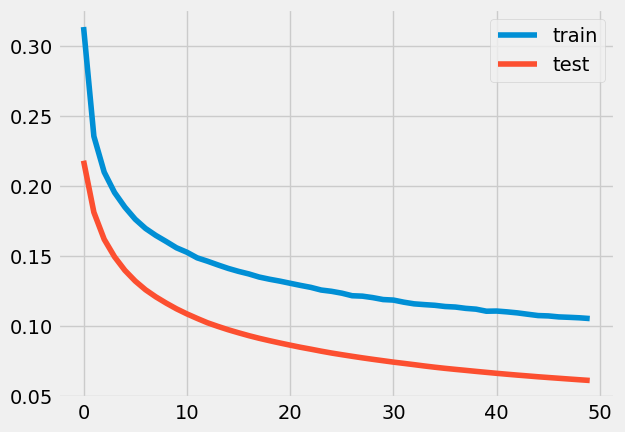

0.0
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 64)           16896     
                                                                 
 dense (Dense)               (None, 100, 32)           2080      
                                                                 
 dense_1 (Dense)             (None, 100, 1)            33        
                                                                 
Total params: 19,009
Trainable params: 19,009
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50
20/20 [==============================] - 4s 85ms/step - loss: 0.2284 - accuracy: 0.0000e+00 - val_loss: 0.1217 - val_accuracy: 0.0000e+00
Epoch 2/50
20/20 [==============================] - 1s 53ms/step - loss: 0.1473 - accuracy: 0.0000e+00 - val_loss: 0.0900 - val_accuracy: 0.0000e+00
Epoch 3/50
20/

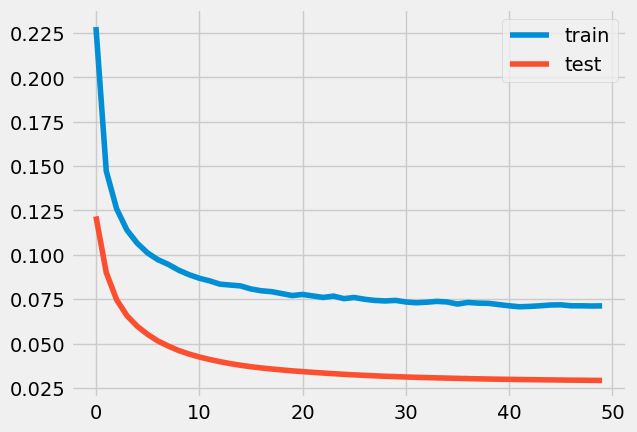

0.9242461402242185 0.029170997440814972
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213,

In [21]:
T =0.01 # initiate temperature
Tmin =0.000001 # minimum value of terperature
x = np.random.uniform(low=0.9, high=0.99)  # initiate x
k = 20  # times of internal circulation
y = 0  # initiate result
t = 0  # time

history = {'y': [], 'iteration': [], 'x': [], 'p': []}

while T >= Tmin:
    print(T)
    for i in range(k):
        history["iteration"].append(t)
        # calculate y
        y = fitness(x)
        history["y"].append(y)
        # generate a new x in the neighboorhood of x by transform function
        xNew = np.abs(x + np.random.uniform(low=-0.005, high=0.005))
        if (0.9 <= xNew and xNew <= 0.99):
            yNew = fitness(xNew)
            if yNew - y < 0:
                x = xNew
                history["x"].append(x)
            else:
                # metropolis principle
                p = math.exp(-(yNew - y) / T)
                print(p)
                history["p"].append(p)
                r = np.random.uniform(low=0, high=1)
                if r < p:
                    x = xNew
        t += 1
    T = 0.5*T  

print(x,fitness(x))  

print(history["iteration"])
print(history["y"])
print(history["x"])



In [22]:
history

{'y': [0.027388572692871094,
  0.029796240851283073,
  0.02630559168756008,
  0.03131534531712532,
  0.04308220371603966,
  0.025647373870015144,
  0.04999130964279175,
  0.025620240718126297,
  0.030262541025877,
  0.025055693462491035,
  0.02659735269844532,
  0.032105423510074615,
  0.054628971964120865,
  0.024746298789978027,
  0.03511358052492142,
  0.03239719569683075,
  0.0450277179479599,
  0.027287155389785767,
  0.05942263454198837,
  0.02582552842795849,
  0.033764589577913284,
  0.02631169743835926,
  0.026545077562332153,
  0.09079737961292267,
  0.03691193461418152,
  0.06621616333723068,
  0.029742198064923286,
  0.026861639693379402,
  0.037141334265470505,
  0.02845076657831669,
  0.02689994126558304,
  0.027591384947299957,
  0.03512527421116829,
  0.032192327082157135,
  0.0275210402905941,
  0.05103961005806923,
  0.0347575880587101,
  0.03125186637043953,
  0.028058931231498718,
  0.031014561653137207,
  0.050526589155197144,
  0.03313300013542175,
  0.02850240841

In [23]:
output = pd.DataFrame(history['y'],history['iteration'])
output.to_csv('SA_de.csv', index = None, encoding = "utf-8_sig", header = None)

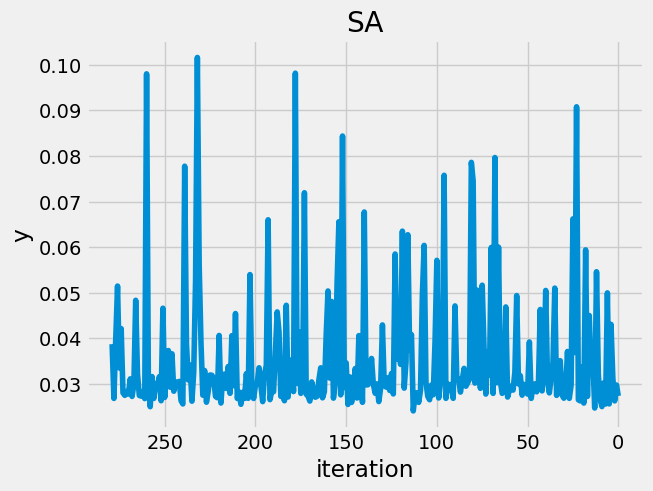

In [24]:
plt.plot(history['iteration'], history['y'])
plt.title('SA')
plt.xlabel('iteration')
plt.ylabel('y')
plt.gca().invert_xaxis()
plt.show()